<a href="https://www.kaggle.com/code/iasonasxrist/attentionunet-brain-tumour-segmentation?scriptVersionId=107338970" target="_blank"><img align="left" alt="Kaggle" title="Open in Kaggle" src="https://kaggle.com/static/images/open-in-kaggle.svg"></a>

In [1]:
# This Python 3 environment comes with many helpful analytics libraries installed
# It is defined by the kaggle/python Docker image: https://github.com/kaggle/docker-python
# For example, here's several helpful packages to load

import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)
import os
# Input data files are available in the read-only "../input/" directory
# For example, running this (by clicking run or pressing Shift+Enter) will list all files under the input directory



In [2]:
import pandas as pd
import random
import seaborn as sns
import matplotlib.pyplot as plt
# plt.style.use("ggplot")
%matplotlib inline

import cv2
from itertools import chain
from tqdm import tqdm_notebook,tnrange
from glob import glob
from skimage.io import imread, imshow,concatenate_images
from skimage.transform import resize
from skimage.morphology import label
from sklearn.model_selection import train_test_split

import tensorflow as tf
from skimage.color import rgb2gray
from tensorflow.keras.models import Model, load_model, save_model
from tensorflow.keras.layers import Input, Activation, BatchNormalization, Dropout, Lambda, Conv2D, Conv2DTranspose, MaxPooling2D, concatenate, UpSampling2D
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.callbacks import EarlyStopping, ModelCheckpoint, ReduceLROnPlateau

from tensorflow.keras import backend as K
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.callbacks import EarlyStopping, ModelCheckpoint

In [3]:
DataPath = '/kaggle/input/lgg-mri-segmentation/kaggle_3m/'


dirs = []
images = []
masks = []
for dirname, _, filenames in os.walk(DataPath):
    for filename in filenames:
        if 'mask'in filename:
            dirs.append(dirname.replace(DataPath, ''))
            masks.append(filename)
            images.append(filename.replace('_mask', ''))

In [4]:
imagePath_df = pd.DataFrame({'directory':dirs, 'images':images,'masks':masks})

In [5]:
def print_imShape():

    idx = random.randint(0,len(dirs))
    imagePath = os.path.join(DataPath,imagePath_df['directory'].iloc[idx],  imagePath_df['images'].iloc[idx])
    maskPath = os.path.join(DataPath, imagePath_df['directory'].iloc[idx],  imagePath_df['masks'].iloc[idx])
    
    image = cv2.imread(imagePath)
    mask = cv2.imread(maskPath)
    
    print(image.shape)
    print(mask.shape)
    

In [6]:
for i in range(5):
    print_imShape()

(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)


In [7]:
def plot_images():
    
    idx = random.randint(0,len(imagePath_df))
    
    imagePath = os.path.join(DataPath,imagePath_df['directory'].iloc[idx],  imagePath_df['images'].iloc[idx])
    maskPath = os.path.join(DataPath,imagePath_df['directory'].iloc[idx],  imagePath_df['masks'].iloc[idx])
    
    image = cv2.imread(imagePath)
    mask = cv2.imread(maskPath)
    
    fig, axs = plt.subplots(1,3, figsize=[13,15])
    
    axs[0].imshow(image)
    axs[0].set_title("Brain MRI Slice")
    
    plt.grid(False)
    
    axs[1].imshow(mask)
    axs[1].set_title('Mask')
    
    plt.grid(False)
    
    axs[2].imshow(image)
    axs[2].imshow(mask, alpha=0.3)
    axs[2].set_title('MRI with mask')
    
    plt.grid(False)
    plt.show()

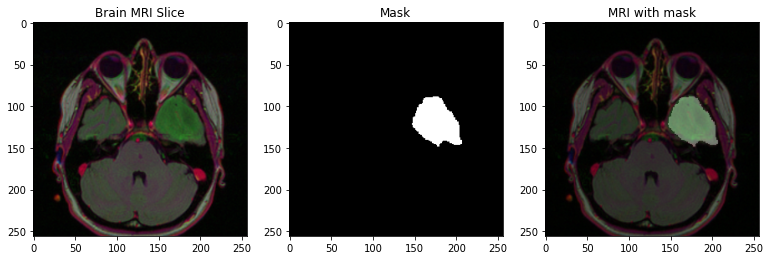

In [8]:
plot_images()

## Config

In [9]:
imagePath_df['image-path'] = DataPath + imagePath_df['directory'] + '/' + imagePath_df['images']
imagePath_df['mask-path'] = DataPath + imagePath_df['directory'] + '/' + imagePath_df['masks'] 


In [10]:
train, test = train_test_split(imagePath_df,test_size=0.25, random_state=21)

In [11]:
EPOCHS = 100
BATCH_SIZE = 32
ImgHeight = 256
ImgWidth = 256
Channels = 3

## Data Generator

In [12]:
data_augmentation = dict(rotation_range = 0.2,
                        width_shift_range=0.05,
                        height_shift_range=0.05,
                        shear_range=0.05,
                        zoom_range=0.05,
                        horizontal_flip=True,
                        fill_mode='nearest')

In [13]:
#image generator task
imagegen = ImageDataGenerator(rescale=1./255., **data_augmentation)
maskgen = ImageDataGenerator(rescale=1./255., **data_augmentation)

#  train generator

timage_generator = imagegen.flow_from_dataframe(dataframe=train,
                                            x_col="image-path",
                                            batch_size= BATCH_SIZE,
                                            seed=42,
                                            class_mode=None,
                                            target_size=(ImgHeight,ImgWidth),
                                            color_mode='rgb')

tmask_generator = maskgen.flow_from_dataframe(dataframe=train,
                                            x_col="mask-path",
                                            batch_size=BATCH_SIZE,
                                            seed=42,
                                            class_mode=None,
                                            target_size=(ImgHeight,ImgWidth),
                                            color_mode='grayscale')     
    


Found 2946 validated image filenames.
Found 2946 validated image filenames.


## Validation

In [14]:
# image generator
imagegen = ImageDataGenerator(rescale=1./255.)
maskgen = ImageDataGenerator(rescale=1./255.)

#train generator
vimage_generator = imagegen.flow_from_dataframe(dataframe=test,
                                             x_col = "image-path",
                                             batch_size = BATCH_SIZE,
                                             seed=42,
                                             class_mode=None,
                                             target_size = (ImgHeight,ImgWidth),
                                             color_mode='rgb')
# validation data generator
vmask_generator = maskgen.flow_from_dataframe(dataframe=test,
                                             x_col = "mask-path",
                                             batch_size = BATCH_SIZE,
                                             seed=42,
                                             class_mode=None,
                                             target_size = (ImgHeight,ImgWidth),
                                             color_mode='grayscale')

Found 983 validated image filenames.
Found 983 validated image filenames.


In [15]:
def data_iterator(image_gen,mask_gen):
    for img, mask in zip(image_gen,mask_gen):
        yield img, mask

In [16]:
train_gen = data_iterator(timage_generator, tmask_generator)
val_gen = data_iterator(vimage_generator,vmask_generator)

In [17]:
def iou(ytrue, ypred):
    smoothing_factor=0.1
    #y_true_f=K.flatten(y_true)
    #y_pred_f=K.flatten(y_pred)
    intersection = K.sum(ytrue*ypred)
    combined_area = K.sum(ytrue+ypred)
    union_area = combined_area - intersection
    iou = (intersection+smoothing_factor)/(union_area+smoothing_factor)
    return iou

# def iou(y_true, y_pred):
#     intersection = K.sum(y_true * y_pred)
#     sum_ = K.sum(y_true + y_pred)
#     jac = (intersection + smooth) / (sum_ - intersection + smooth)

def jac_distance(y_true, y_pred):
    y_true = K.flatten(y_true)
    y_pred = K.flatten(y_pred)
    
    return -iou(y_true, y_pred)

# Dice Sorenson
def dice_coef(ytrue, ypred):
    smoothing_factor=0.1
    ytrue_f = K.flatten(ytrue)
    ypred_f = K.flatten(ypred)
    intersection = K.sum(ytrue*ypred)
    ytrue_area = K.sum(ytrue)
    ypred_area = K.sum(ypred)
    combined_area = ytrue_area + ypred_area
    dice = 2*((intersection+smoothing_factor)/(combined_area+smoothing_factor))
    return dice

def dice_coef_loss(y_true, y_pred):
    return -dice_coef(y_true, y_pred)


## Model

In [18]:
def conv_block(inp,filters):
    x=Conv2D(filters,(3,3),padding='same',activation='relu')(inp)
    x=Conv2D(filters,(3,3),padding='same')(x)
    x=BatchNormalization(axis=3)(x)
    x=Activation('relu')(x)
    return x

def encoder_block(inp,filters,dropout):
    x=conv_block(inp,filters)
    p=MaxPooling2D(pool_size=(2,2))(x)
    p=Dropout(dropout)(p)
    return x,p

def attention_block(l_layer,h_layer): #Attention Block
    phi=Conv2D(h_layer.shape[-1],(1,1),padding='same')(l_layer)
    theta=Conv2D(h_layer.shape[-1],(1,1),strides=(2,2),padding='same')(h_layer)
    x=tf.keras.layers.add([phi,theta])
    x=Activation('relu')(x)
    x=Conv2D(1,(1,1),padding='same',activation='sigmoid')(x)
    x=UpSampling2D(size=(2,2))(x)
    x=tf.keras.layers.multiply([h_layer,x])
    x=BatchNormalization(axis=3)(x)
    return x
    
def decoder_block(inp,filters,concat_layer,dropout):
    x=Conv2DTranspose(filters,(2,2),strides=(2,2),padding='same')(inp)
    concat_layer=attention_block(inp,concat_layer)
    x=concatenate([x,concat_layer])
    x=Dropout(dropout)(x)
    x=conv_block(x,filters)
    return x

In [19]:
input_img = Input((ImgHeight,ImgWidth,3), name='img')
d1,p1=encoder_block(input_img,64,0.1)
d2,p2=encoder_block(p1,128,0.1)
d3,p3=encoder_block(p2,256,0.1)
d4,p4=encoder_block(p3,512,0.1)
b1=conv_block(p4,1024)
e2=decoder_block(b1,512,d4,0.1)
e3=decoder_block(e2,256,d3,0.1)
e4=decoder_block(e3,128,d2,0.1)
e5=decoder_block(e4,64,d1,0.1)
outputs = Conv2D(1, (1,1),activation="sigmoid")(e5)
model=Model(inputs=[input_img], outputs=[outputs],name='AttentionUnet')

2022-10-06 11:45:23.286733: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:937] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2022-10-06 11:45:23.396431: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:937] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2022-10-06 11:45:23.397430: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:937] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2022-10-06 11:45:23.398767: I tensorflow/core/platform/cpu_feature_guard.cc:142] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  AVX2 AVX512F FMA
To enable them in other operations, rebuild TensorFlow with the appropriate compil

In [20]:
model.summary()

Model: "AttentionUnet"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
img (InputLayer)                [(None, 256, 256, 3) 0                                            
__________________________________________________________________________________________________
conv2d (Conv2D)                 (None, 256, 256, 64) 1792        img[0][0]                        
__________________________________________________________________________________________________
conv2d_1 (Conv2D)               (None, 256, 256, 64) 36928       conv2d[0][0]                     
__________________________________________________________________________________________________
batch_normalization (BatchNorma (None, 256, 256, 64) 256         conv2d_1[0][0]                   
______________________________________________________________________________________

In [21]:
model.compile(optimizer=Adam(), loss="binary_crossentropy", 
             metrics=["accuracy", iou, dice_coef,tf.keras.metrics.Precision()])
callbacks = [
    EarlyStopping(patience=10, verbose=1),
    ReduceLROnPlateau(factor=0.1, patience=5, min_lr=1e-5, verbose=1),
    ModelCheckpoint('attUNET-brain-mriv5.h5', verbose=1, save_best_only=True)
]


In [22]:
STEP_SIZE_TRAIN = timage_generator.n/BATCH_SIZE
STEP_SIZE_VALID = vimage_generator.n/BATCH_SIZE


In [23]:
results = model.fit(train_gen,
                    steps_per_epoch=STEP_SIZE_TRAIN,
                    batch_size=BATCH_SIZE,
                    epochs=EPOCHS,
                    callbacks=callbacks,
                    validation_data=val_gen,
                   validation_steps=STEP_SIZE_VALID)


2022-10-06 11:45:28.560010: I tensorflow/compiler/mlir/mlir_graph_optimization_pass.cc:185] None of the MLIR Optimization Passes are enabled (registered 2)


Epoch 1/100


2022-10-06 11:45:34.156253: I tensorflow/stream_executor/cuda/cuda_dnn.cc:369] Loaded cuDNN version 8005
2022-10-06 11:45:45.840128: W tensorflow/core/common_runtime/bfc_allocator.cc:272] Allocator (GPU_0_bfc) ran out of memory trying to allocate 2.27GiB with freed_by_count=0. The caller indicates that this is not a failure, but may mean that there could be performance gains if more memory were available.
2022-10-06 11:45:46.028411: W tensorflow/core/common_runtime/bfc_allocator.cc:272] Allocator (GPU_0_bfc) ran out of memory trying to allocate 1.02GiB with freed_by_count=0. The caller indicates that this is not a failure, but may mean that there could be performance gains if more memory were available.
2022-10-06 11:45:46.110039: W tensorflow/core/common_runtime/bfc_allocator.cc:272] Allocator (GPU_0_bfc) ran out of memory trying to allocate 3.39GiB with freed_by_count=0. The caller indicates that this is not a failure, but may mean that there could be performance gains if more memory

92/92 [==============================] - 166s 2s/step - loss: 0.1091 - accuracy: 0.9817 - iou: 0.0509 - dice_coef: 0.0954 - precision: 0.2349 - val_loss: 0.1610 - val_accuracy: 0.9900 - val_iou: 0.0102 - val_dice_coef: 0.0201 - val_precision: 0.0000e+00

Epoch 00001: val_loss improved from inf to 0.16100, saving model to attUNET-brain-mriv5.h5


/opt/conda/lib/python3.7/site-packages/keras/utils/generic_utils.py:497: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  category=CustomMaskWarning)


Epoch 2/100
92/92 [==============================] - 107s 1s/step - loss: 0.0493 - accuracy: 0.9896 - iou: 0.0870 - dice_coef: 0.1566 - precision: 0.5911 - val_loss: 0.0644 - val_accuracy: 0.9900 - val_iou: 0.0128 - val_dice_coef: 0.0253 - val_precision: 0.0000e+00

Epoch 00002: val_loss improved from 0.16100 to 0.06443, saving model to attUNET-brain-mriv5.h5
Epoch 3/100
92/92 [==============================] - 106s 1s/step - loss: 0.0351 - accuracy: 0.9904 - iou: 0.1496 - dice_coef: 0.2563 - precision: 0.6685 - val_loss: 0.0402 - val_accuracy: 0.9905 - val_iou: 0.0690 - val_dice_coef: 0.1282 - val_precision: 0.8710

Epoch 00003: val_loss improved from 0.06443 to 0.04017, saving model to attUNET-brain-mriv5.h5
Epoch 4/100
92/92 [==============================] - 108s 1s/step - loss: 0.0289 - accuracy: 0.9914 - iou: 0.2052 - dice_coef: 0.3353 - precision: 0.7536 - val_loss: 0.0415 - val_accuracy: 0.9903 - val_iou: 0.0352 - val_dice_coef: 0.0675 - val_precision: 1.0000

Epoch 00004: val_

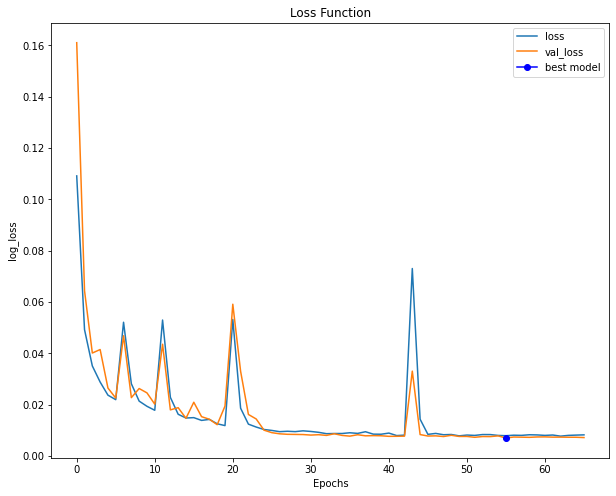

In [24]:
plt.figure(figsize=[10,8])
plt.title("Loss Function")
plt.plot(results.history["loss"], label="loss")
plt.plot(results.history["val_loss"], label="val_loss")

plt.plot( np.argmin(results.history["val_loss"]), np.min(results.history["val_loss"]), marker="o", color="b", label="best model")
plt.xlabel("Epochs")
plt.ylabel("log_loss")
plt.legend()
# plt.grid(False)
plt.show()


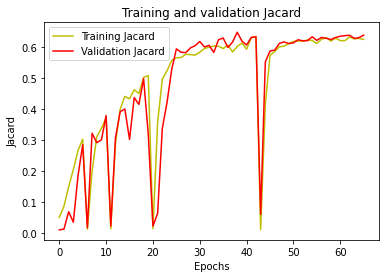

In [25]:
plt.title("Loss Function")

plt.title('Training and validation Jacard')
plt.plot(results.history["iou"], 'y', label='Training Jacard')
plt.plot(results.history['val_iou'], 'r', label='Validation Jacard')

plt.xlabel('Epochs')
plt.ylabel('Jacard')
plt.legend()
plt.show()

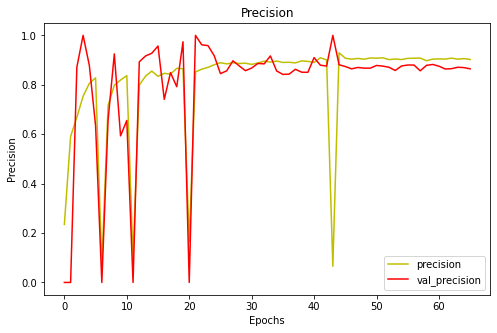

In [26]:
plt.figure(figsize=[8,5])
plt.title("Precision")
plt.plot(results.history["precision"],'y', label = "precision")
plt.plot(results.history["val_precision"], 'r', label='val_precision')
plt.xlabel("Epochs")
plt.ylabel("Precision")
plt.legend()
# plt.grid(False)
plt.show()

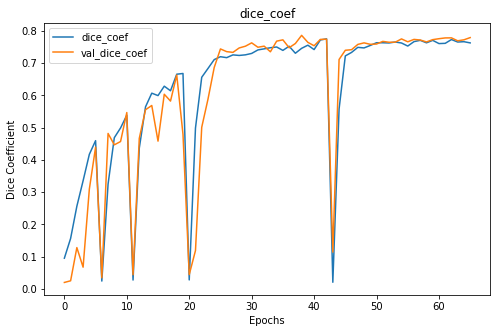

In [27]:
plt.figure(figsize=[8,5])
plt.title("dice_coef")
plt.plot(results.history["dice_coef"], label = "dice_coef")
plt.plot(results.history["val_dice_coef"], label = "val_dice_coef")
plt.xlabel("Epochs")
plt.ylabel("Dice Coefficient")
plt.legend()
# plt.grid(False)
plt.show()

In [28]:
model.load_weights('attUNET-brain-mriv5.h5')
# model =models.load_model('unet_brain_mri_seg.hdf5', custom_objects={'dice_coef_loss': dice_coef_loss, 'iou': iou, 'dice_coef': dice_coef})

In [29]:
eval_results = model.evaluate(val_gen, steps=STEP_SIZE_VALID, verbose=1)


30/30 [==============================] - 8s 265ms/step - loss: 0.0075 - accuracy: 0.9973 - iou: 0.6232 - dice_coef: 0.7656 - precision: 0.8875


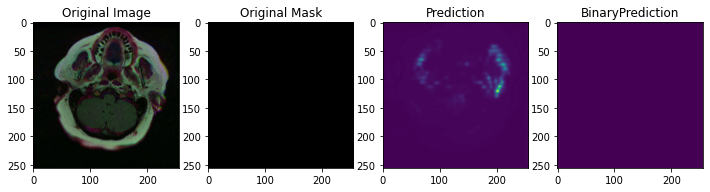

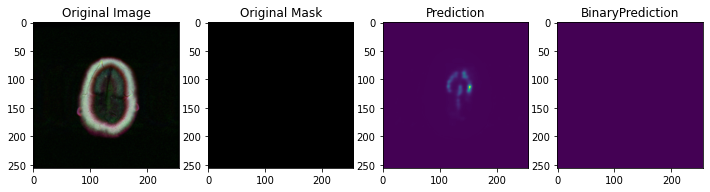

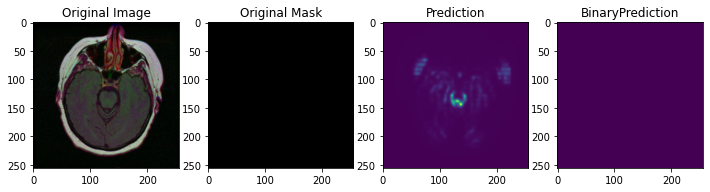

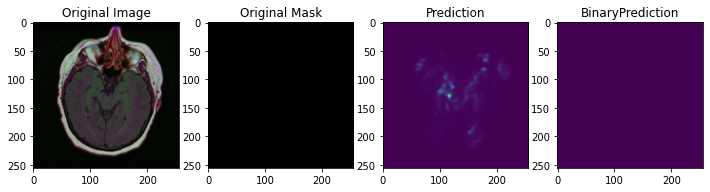

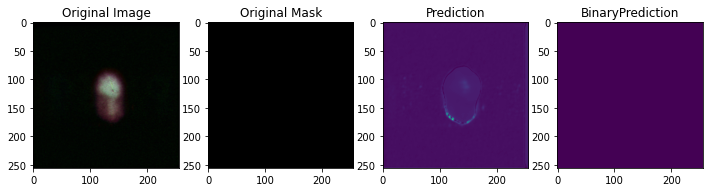

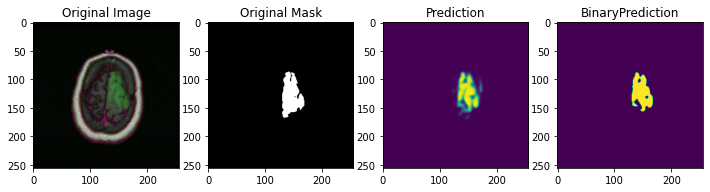

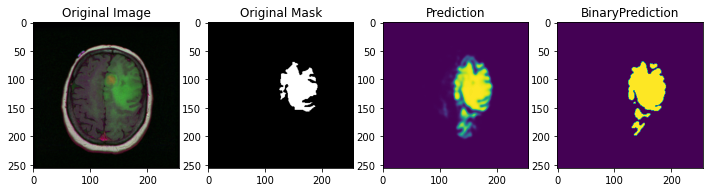

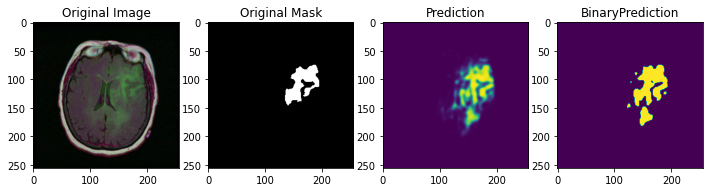

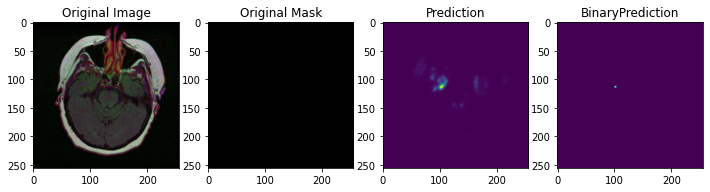

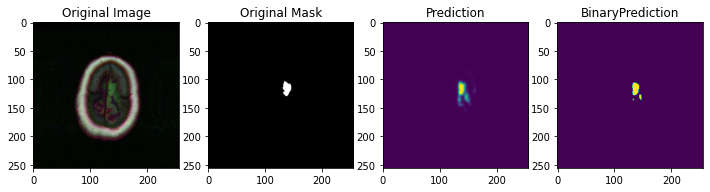

In [30]:
for i in range(10):
    idx = random.randint(0,len(vmask_generator))
    
    imagePath = os.path.join(DataPath, imagePath_df['directory'].iloc[idx], imagePath_df['images'].iloc[idx])
    maskPath = os.path.join(DataPath, imagePath_df['directory'].iloc[idx], imagePath_df['masks'].iloc[idx])
    
    image = cv2.imread(imagePath)
    mask = cv2.imread(maskPath)
    
    img = cv2.resize(image,(ImgHeight,ImgWidth))
    img = img/255
    img = img[np.newaxis,:,:,:]
    pred=model.predict(img)
    
    plt.figure(figsize=(12,12))
    plt.subplot(1,4,1)
    plt.imshow(np.squeeze(img))
    plt.title('Original Image')
    plt.subplot(1,4,2)
    plt.imshow(mask)
    plt.title('Original Mask')
    plt.subplot(1,4,3)
    plt.imshow(np.squeeze(pred))
    plt.title('Prediction')
    plt.subplot(1,4,4)
    plt.imshow(np.squeeze(pred) > 0.5)
    plt.title('BinaryPrediction')
    plt.show()


In [31]:
def intersection_mats(mask, bpred):
    
    intersection = np.sum(np.logical_and(mask,bpred))

    union = np.sum(np.logical_or(mask,bpred))
#     smooth = .00001
    mask_sum = (np.sum(np.abs(mask)) + np.sum(np.abs(bpred)))

    print(mask_sum)
    iou = (intersection) / (union)
    dice = 2 * ((intersection)/(mask_sum))

    iou = np.mean(iou)
    dice = np.mean(dice)
    iou = round(iou,2)
    dice = round(dice,2)
    

#     dice2 = (2*tp)/(2*tp+fp+fn)
    return iou,dice

In [32]:
from sklearn.metrics import accuracy_score,confusion_matrix
    
def confusion_matrs(mask,bpred):

    mask = mask.flatten()
    bpred = bpred.flatten()  
      
    a = confusion_matrix(mask, bpred)
    
    return a
# return accu,a

In [33]:
import random
import cv2
import matplotlib.pyplot as plt

def plots():
    plt.figure(figsize=(12,12))
    plt.subplot(1,4,1)
    plt.imshow(np.squeeze(img),cmap = plt.cm.gray)
    plt.title('Original Image')
    plt.subplot(1,4,2)
    plt.imshow(mask)
    plt.title('Original Mask')
    plt.subplot(1,4,3)
    plt.imshow(np.squeeze(pred), cmap = plt.cm.gray)
    plt.title('Prediction')
    plt.subplot(1,4,4)
    plt.imshow(bpred,cmap = plt.cm.gray)
    plt.title('BinaryPrediction')
    plt.show()
    print("Pred Shape :",np.squeeze(pred).shape )
    
def prints():
    print("Mask Shape :",mask.shape )
    print("Pred after squeeze Shape :",pred.shape)
    print("Mask After rgb2gray Shape :",mask.shape )

/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:7: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  import sys
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:8: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional informatio

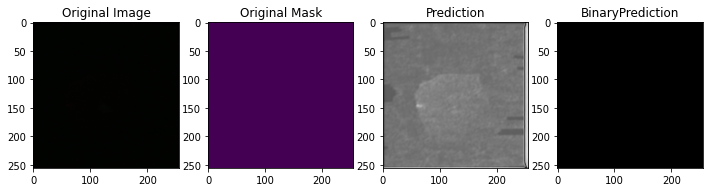

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


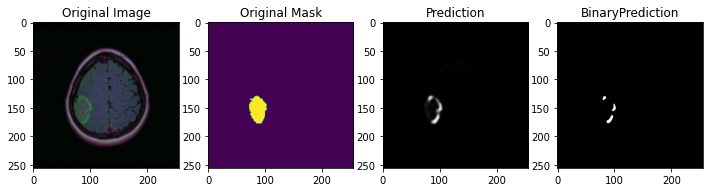

Pred Shape : (256, 256)
1251.0
152 945 64437 2
confusion matrix: [[64437     2]
 [  945   152]]


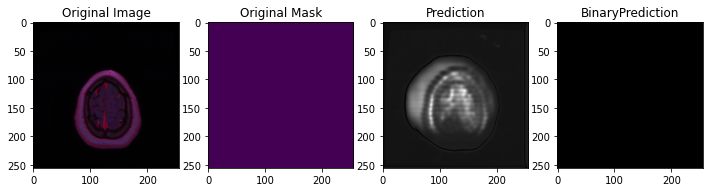

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


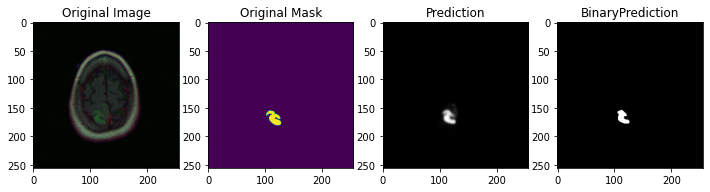

Pred Shape : (256, 256)
686.0
272 110 65122 32
confusion matrix: [[65122    32]
 [  110   272]]


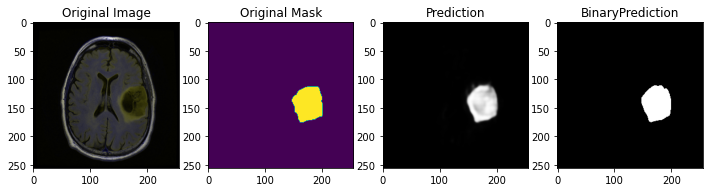

Pred Shape : (256, 256)
5214.0
2497 133 62819 87
confusion matrix: [[62819    87]
 [  133  2497]]


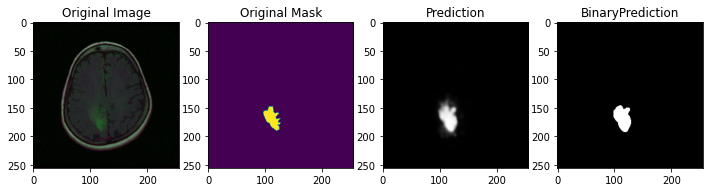

Pred Shape : (256, 256)
1705.0
673 24 64504 335
confusion matrix: [[64504   335]
 [   24   673]]


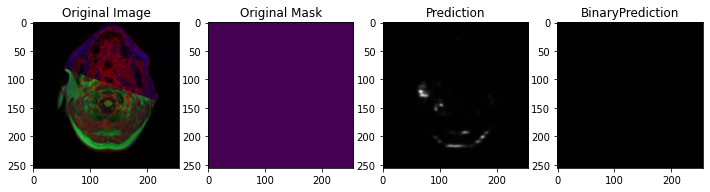

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


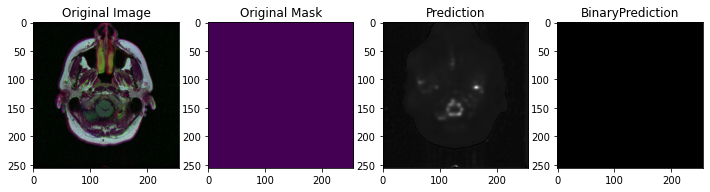

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


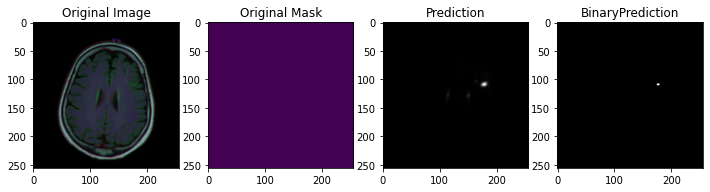

Pred Shape : (256, 256)
15.0
0 0 65521 15
confusion matrix: [[65521    15]
 [    0     0]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:78: RuntimeWarning: invalid value encountered in long_scalars


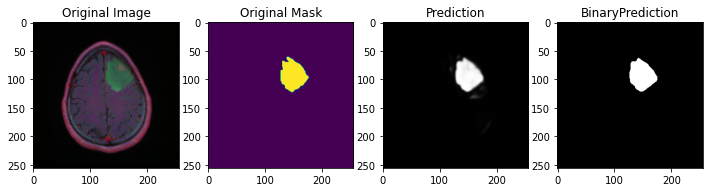

Pred Shape : (256, 256)
3913.0
1883 97 63506 50
confusion matrix: [[63506    50]
 [   97  1883]]


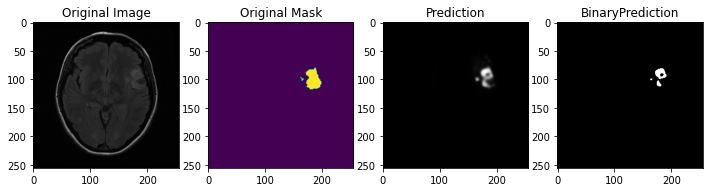

Pred Shape : (256, 256)
1049.0
291 443 64778 24
confusion matrix: [[64778    24]
 [  443   291]]


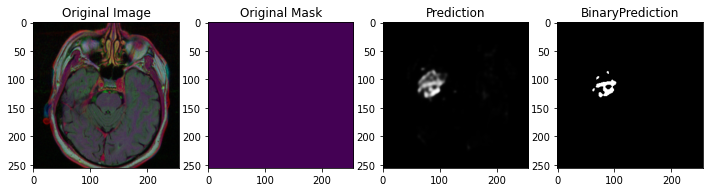

Pred Shape : (256, 256)
571.0
0 0 64965 571
confusion matrix: [[64965   571]
 [    0     0]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:78: RuntimeWarning: invalid value encountered in long_scalars


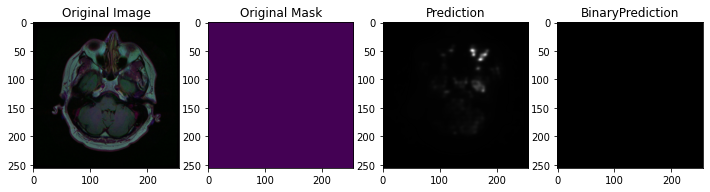

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


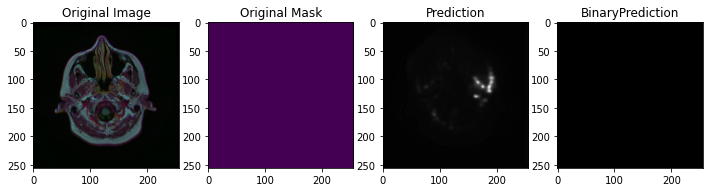

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


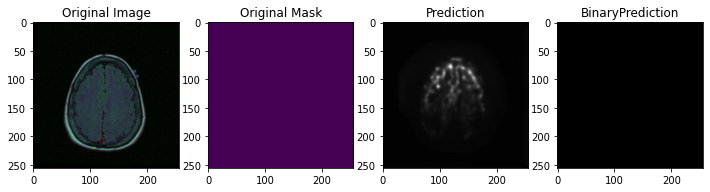

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


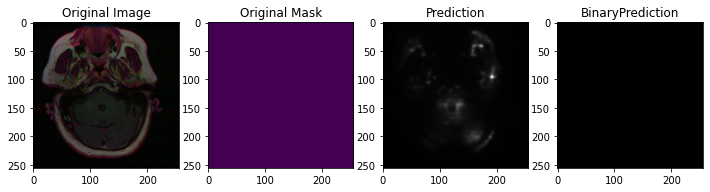

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


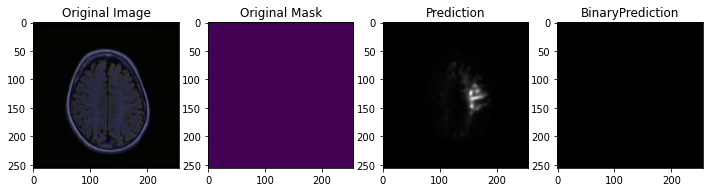

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


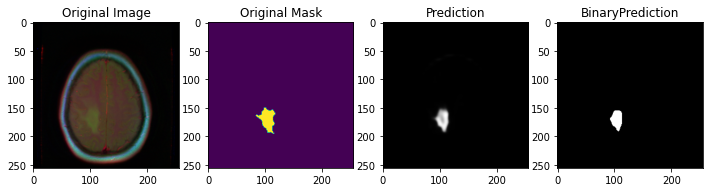

Pred Shape : (256, 256)
1342.0
538 266 64732 0
confusion matrix: [[64732     0]
 [  266   538]]


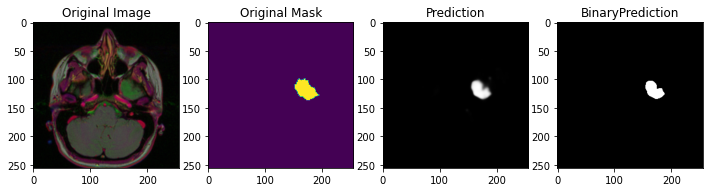

Pred Shape : (256, 256)
1648.0
686 275 64574 1
confusion matrix: [[64574     1]
 [  275   686]]


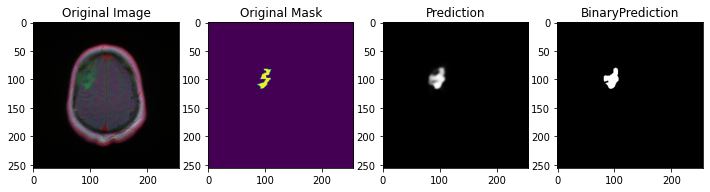

Pred Shape : (256, 256)
887.0
312 31 64961 232
confusion matrix: [[64961   232]
 [   31   312]]


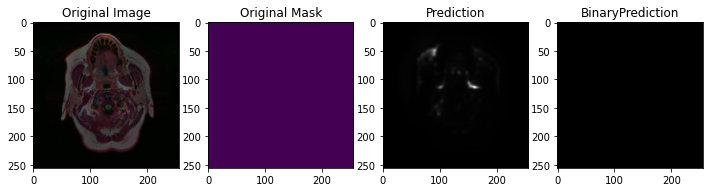

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


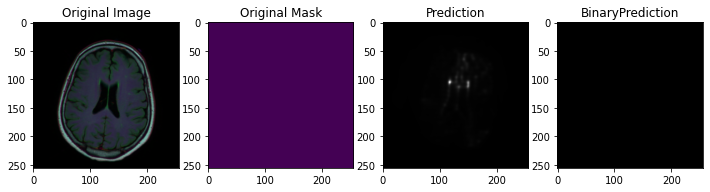

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


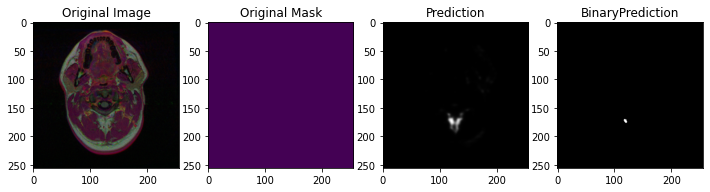

Pred Shape : (256, 256)
27.0
0 0 65509 27
confusion matrix: [[65509    27]
 [    0     0]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:78: RuntimeWarning: invalid value encountered in long_scalars


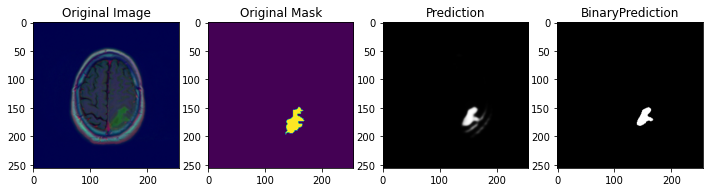

Pred Shape : (256, 256)
1308.0
445 363 64673 55
confusion matrix: [[64673    55]
 [  363   445]]


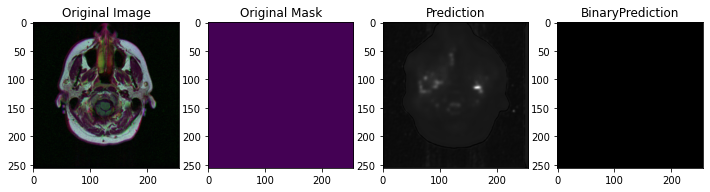

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


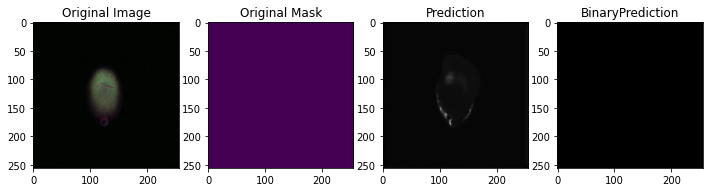

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


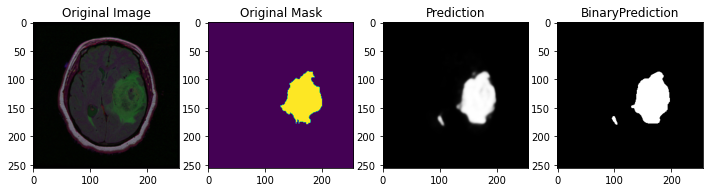

Pred Shape : (256, 256)
8196.0
3851 196 61191 298
confusion matrix: [[61191   298]
 [  196  3851]]


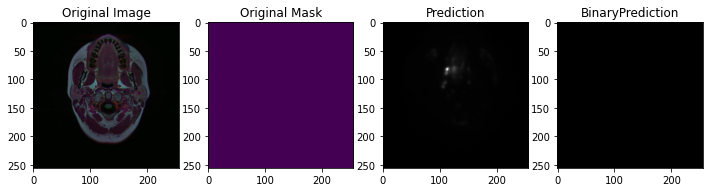

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


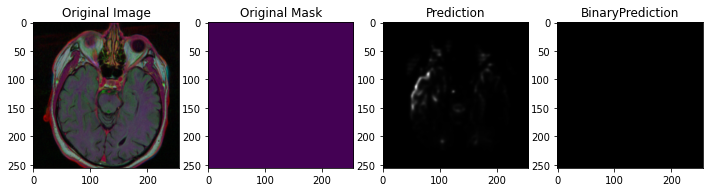

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


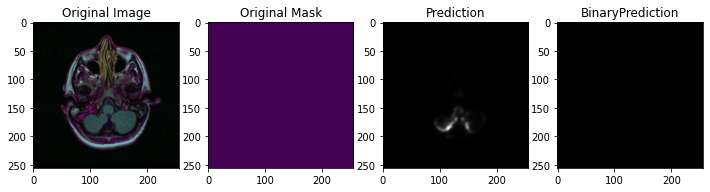

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


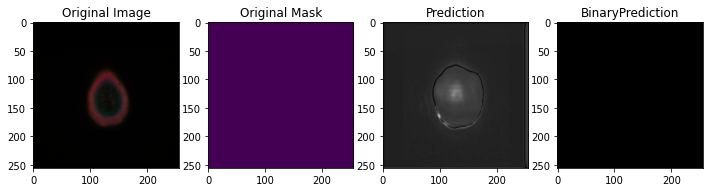

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


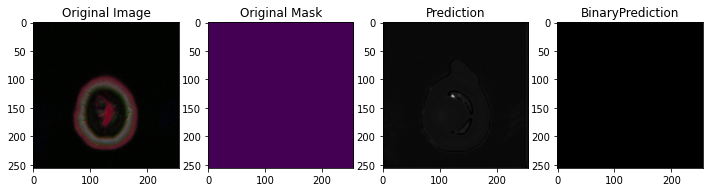

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


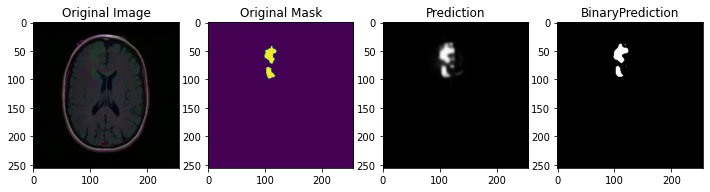

Pred Shape : (256, 256)
1218.0
498 73 64816 149
confusion matrix: [[64816   149]
 [   73   498]]


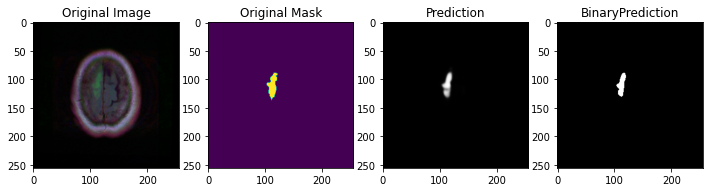

Pred Shape : (256, 256)
878.0
375 120 65033 8
confusion matrix: [[65033     8]
 [  120   375]]


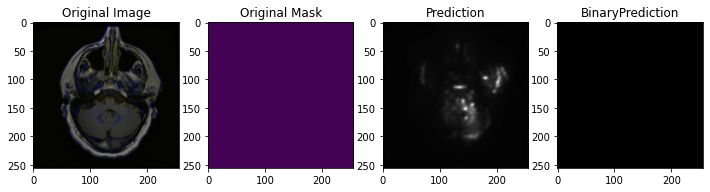

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


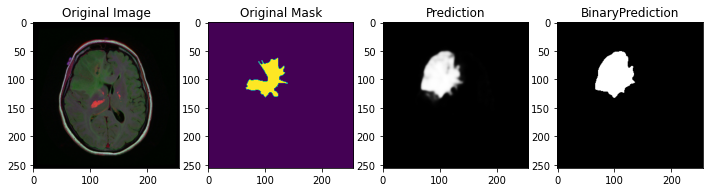

Pred Shape : (256, 256)
5949.0
2110 84 61697 1645
confusion matrix: [[61697  1645]
 [   84  2110]]


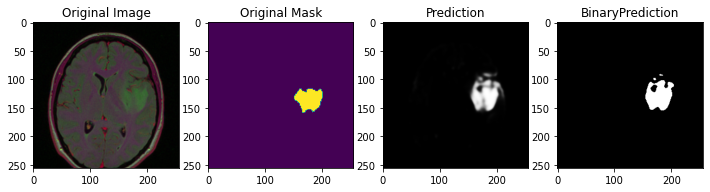

Pred Shape : (256, 256)
3323.0
1338 133 63551 514
confusion matrix: [[63551   514]
 [  133  1338]]


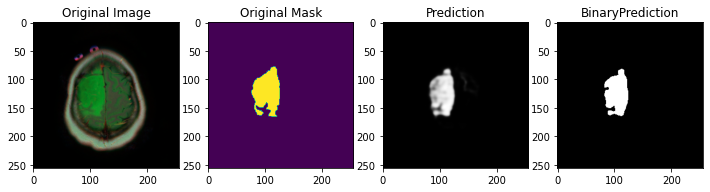

Pred Shape : (256, 256)
5496.0
2376 603 62416 141
confusion matrix: [[62416   141]
 [  603  2376]]


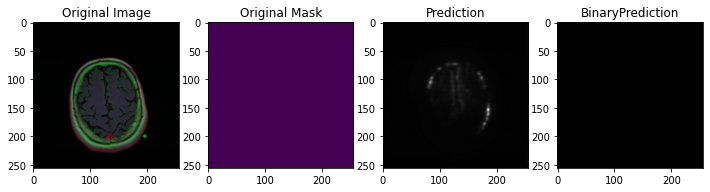

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


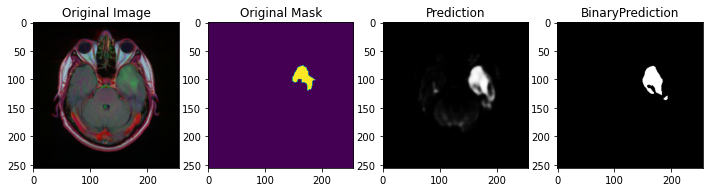

Pred Shape : (256, 256)
2003.0
750 72 64283 431
confusion matrix: [[64283   431]
 [   72   750]]


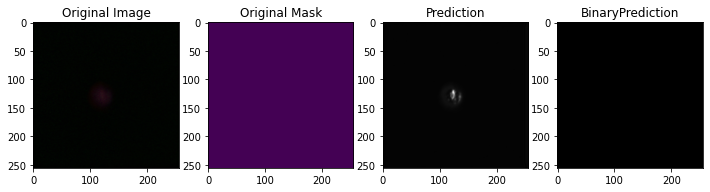

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


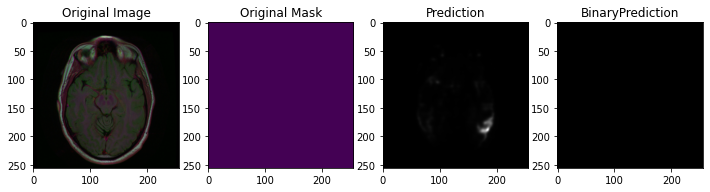

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


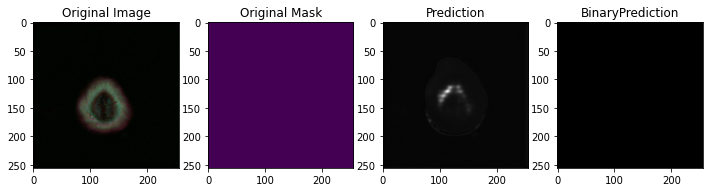

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


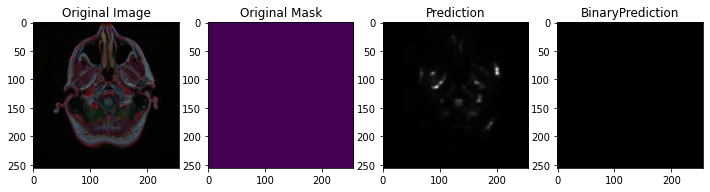

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


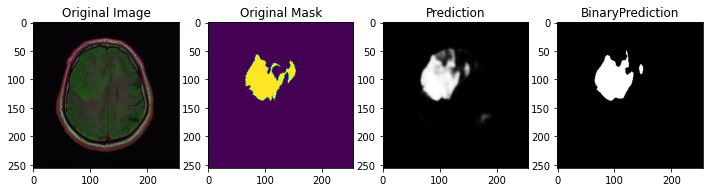

Pred Shape : (256, 256)
7225.0
3172 370 61483 511
confusion matrix: [[61483   511]
 [  370  3172]]


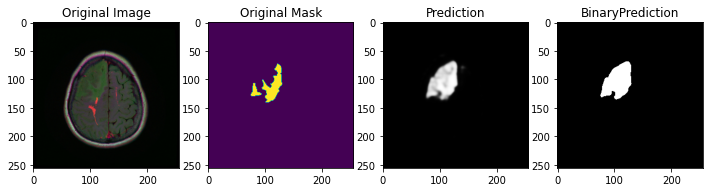

Pred Shape : (256, 256)
3602.0
1143 125 63077 1191
confusion matrix: [[63077  1191]
 [  125  1143]]


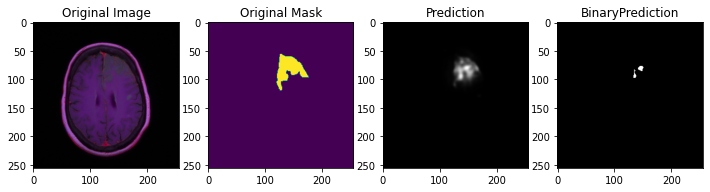

Pred Shape : (256, 256)
1715.0
102 1511 63923 0
confusion matrix: [[63923     0]
 [ 1511   102]]


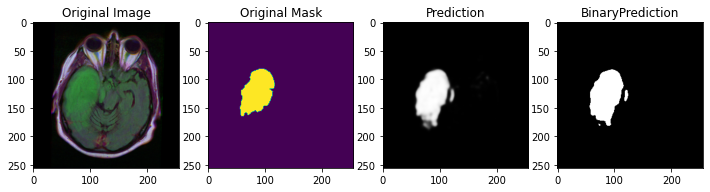

Pred Shape : (256, 256)
7458.0
3293 135 61371 737
confusion matrix: [[61371   737]
 [  135  3293]]


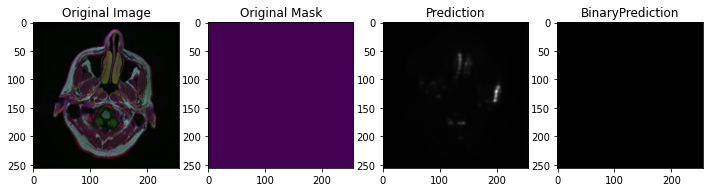

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


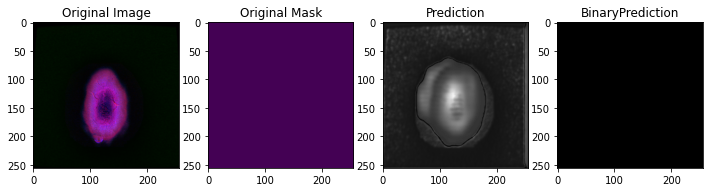

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


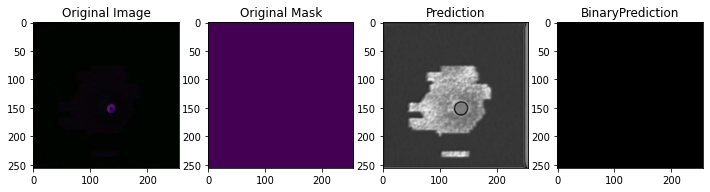

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


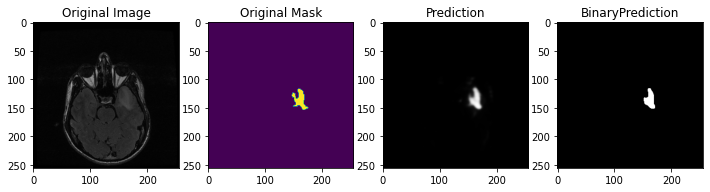

Pred Shape : (256, 256)
914.0
368 116 64990 62
confusion matrix: [[64990    62]
 [  116   368]]


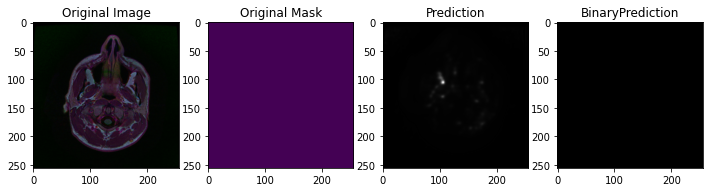

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


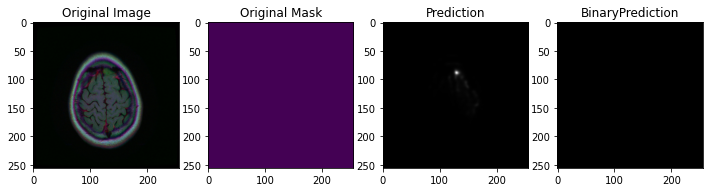

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


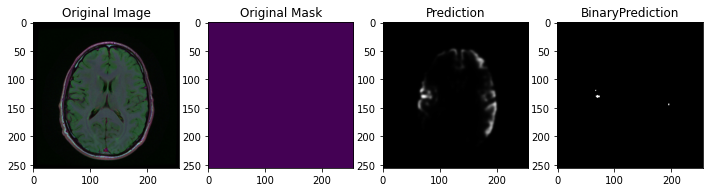

Pred Shape : (256, 256)
33.0
0 0 65503 33
confusion matrix: [[65503    33]
 [    0     0]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:78: RuntimeWarning: invalid value encountered in long_scalars


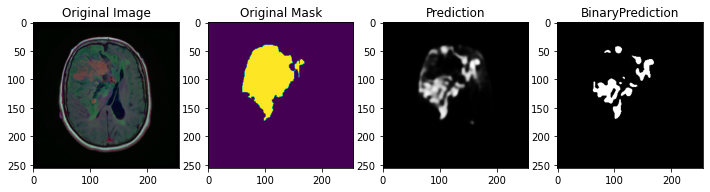

Pred Shape : (256, 256)
9915.0
2300 5105 57921 210
confusion matrix: [[57921   210]
 [ 5105  2300]]


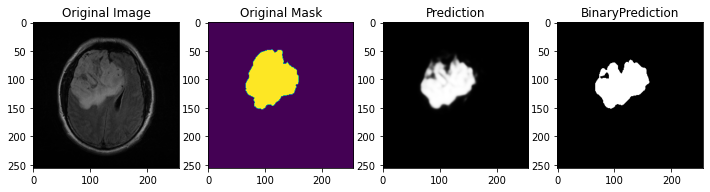

Pred Shape : (256, 256)
11710.0
5061 1481 58887 107
confusion matrix: [[58887   107]
 [ 1481  5061]]


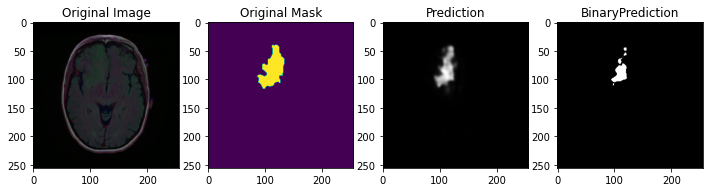

Pred Shape : (256, 256)
2595.0
646 1303 63587 0
confusion matrix: [[63587     0]
 [ 1303   646]]


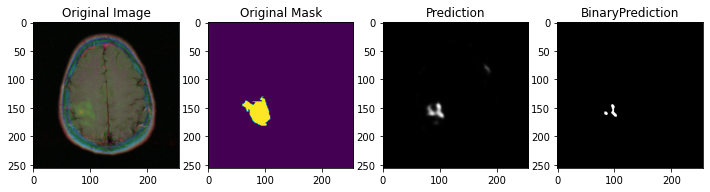

Pred Shape : (256, 256)
1538.0
137 1264 64135 0
confusion matrix: [[64135     0]
 [ 1264   137]]


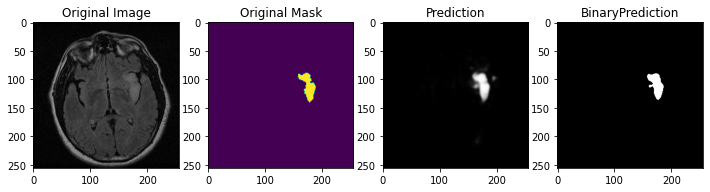

Pred Shape : (256, 256)
1542.0
659 115 64653 109
confusion matrix: [[64653   109]
 [  115   659]]


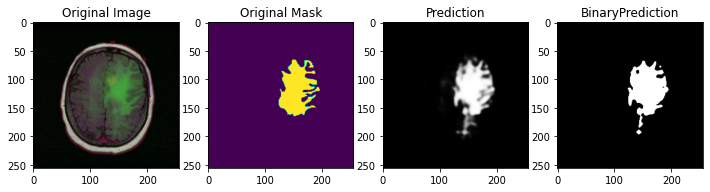

Pred Shape : (256, 256)
8708.0
3647 480 60475 934
confusion matrix: [[60475   934]
 [  480  3647]]


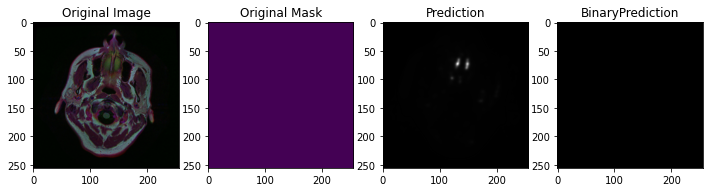

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


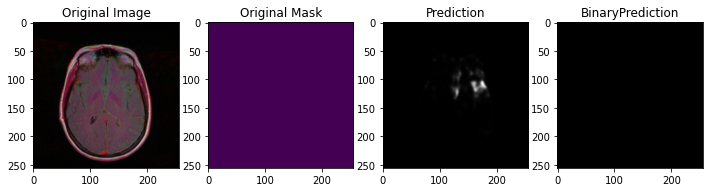

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


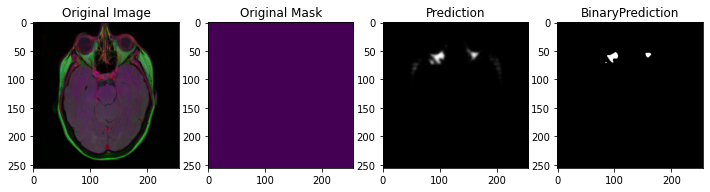

Pred Shape : (256, 256)
245.0
0 0 65291 245
confusion matrix: [[65291   245]
 [    0     0]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:78: RuntimeWarning: invalid value encountered in long_scalars


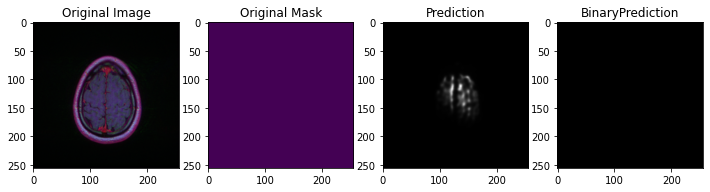

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


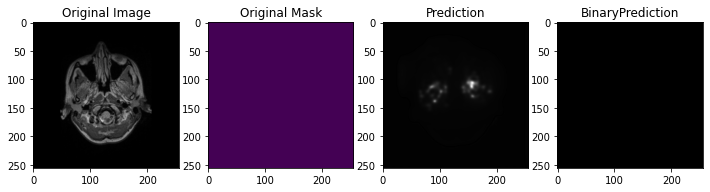

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


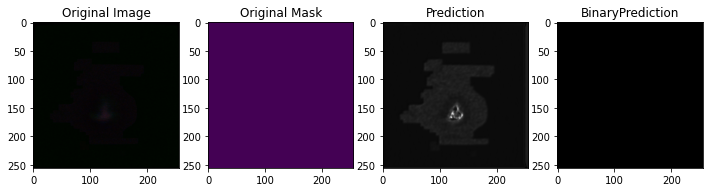

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


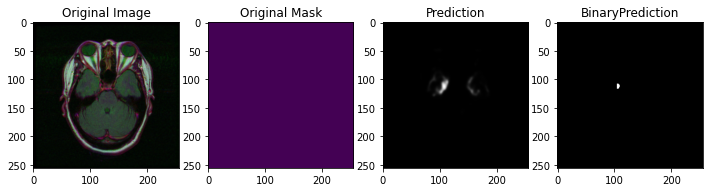

Pred Shape : (256, 256)
38.0
0 0 65498 38
confusion matrix: [[65498    38]
 [    0     0]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:78: RuntimeWarning: invalid value encountered in long_scalars


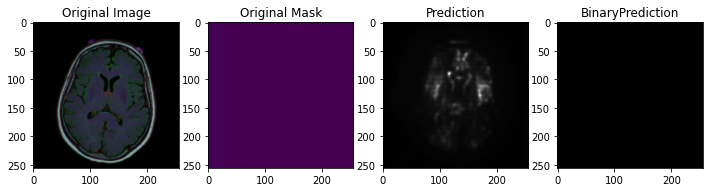

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


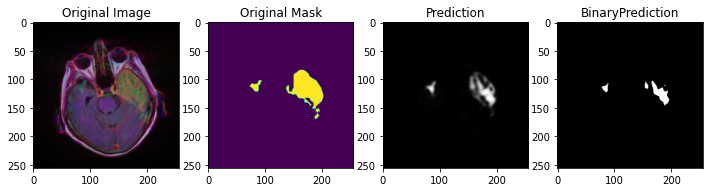

Pred Shape : (256, 256)
3288.0
690 1904 62938 4
confusion matrix: [[62938     4]
 [ 1904   690]]


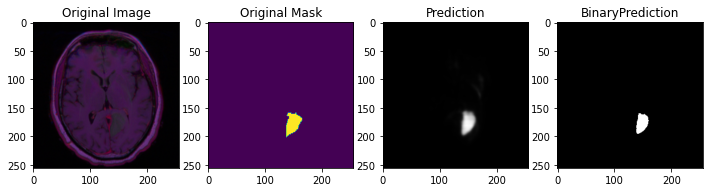

Pred Shape : (256, 256)
1319.0
561 196 64778 1
confusion matrix: [[64778     1]
 [  196   561]]


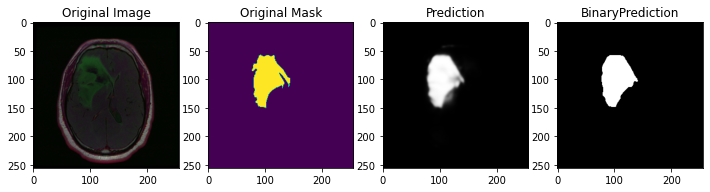

Pred Shape : (256, 256)
7194.0
3321 121 61663 431
confusion matrix: [[61663   431]
 [  121  3321]]


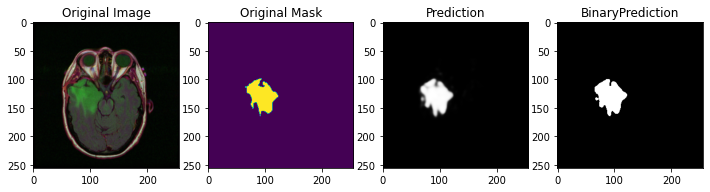

Pred Shape : (256, 256)
4181.0
1935 46 63290 265
confusion matrix: [[63290   265]
 [   46  1935]]


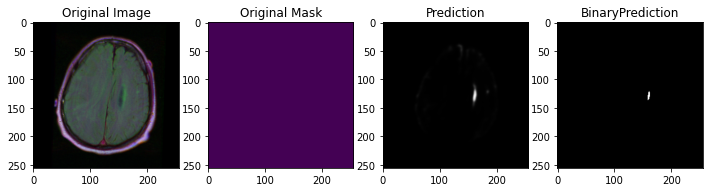

Pred Shape : (256, 256)
44.0
0 0 65492 44
confusion matrix: [[65492    44]
 [    0     0]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:78: RuntimeWarning: invalid value encountered in long_scalars


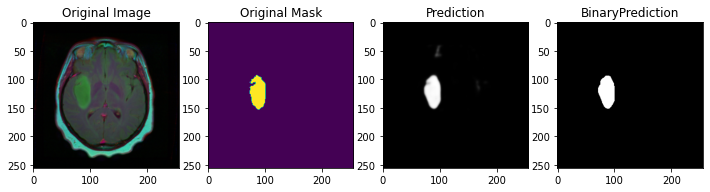

Pred Shape : (256, 256)
2522.0
1190 67 64204 75
confusion matrix: [[64204    75]
 [   67  1190]]


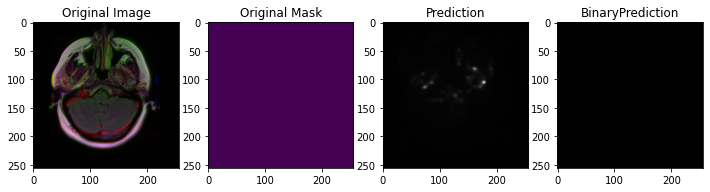

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


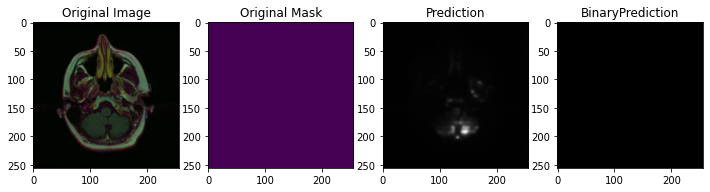

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


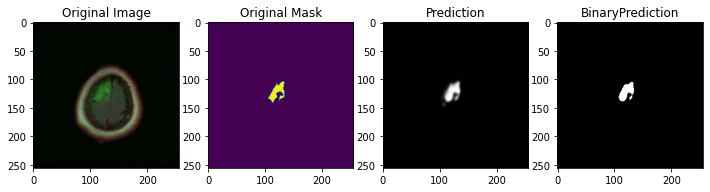

Pred Shape : (256, 256)
1043.0
441 55 64934 106
confusion matrix: [[64934   106]
 [   55   441]]


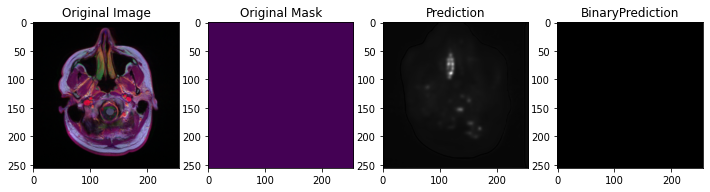

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


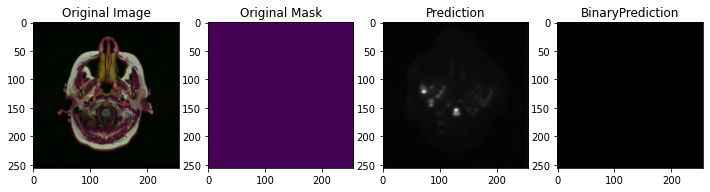

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


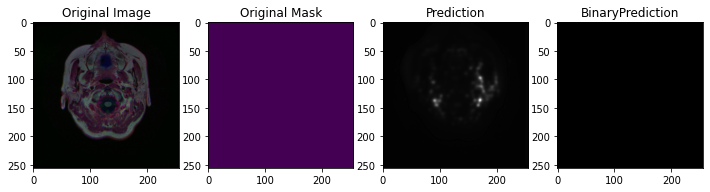

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


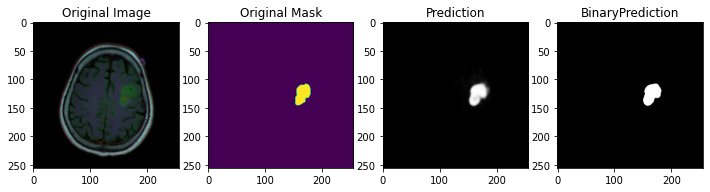

Pred Shape : (256, 256)
1600.0
738 5 64674 119
confusion matrix: [[64674   119]
 [    5   738]]


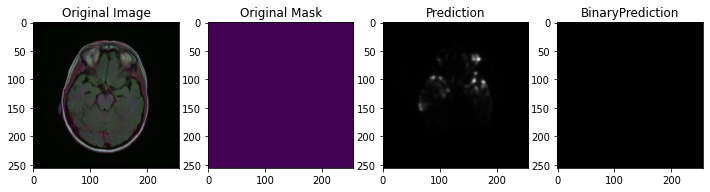

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


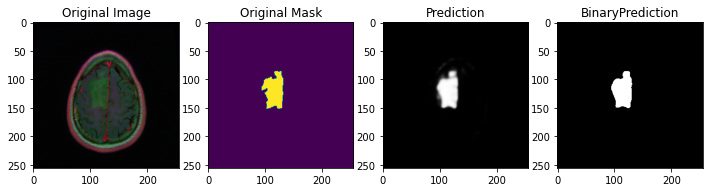

Pred Shape : (256, 256)
3466.0
1617 115 63687 117
confusion matrix: [[63687   117]
 [  115  1617]]


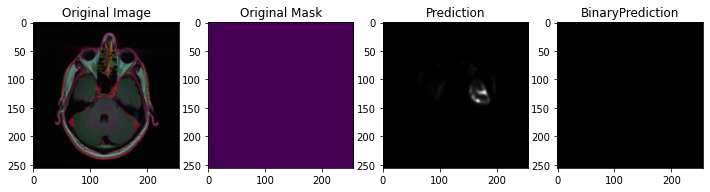

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


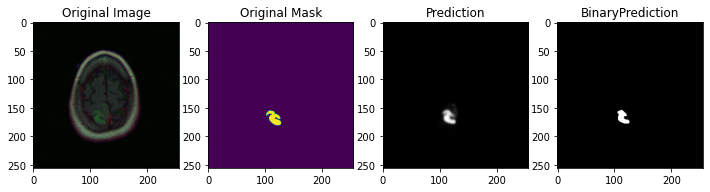

Pred Shape : (256, 256)
686.0
272 110 65122 32
confusion matrix: [[65122    32]
 [  110   272]]


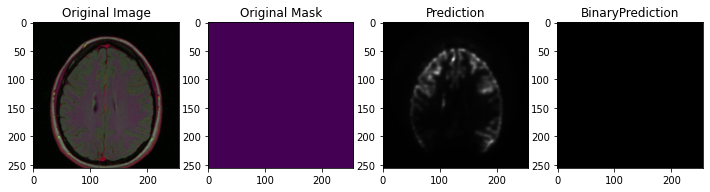

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


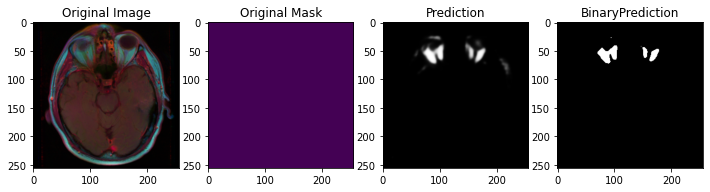

Pred Shape : (256, 256)
979.0
0 0 64557 979
confusion matrix: [[64557   979]
 [    0     0]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:78: RuntimeWarning: invalid value encountered in long_scalars


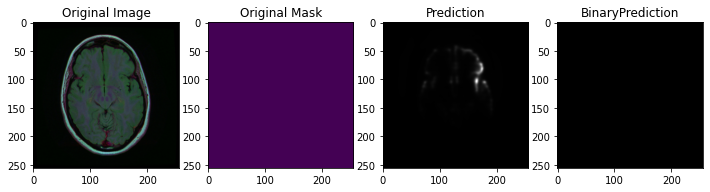

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


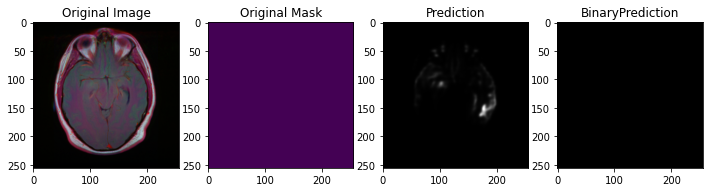

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


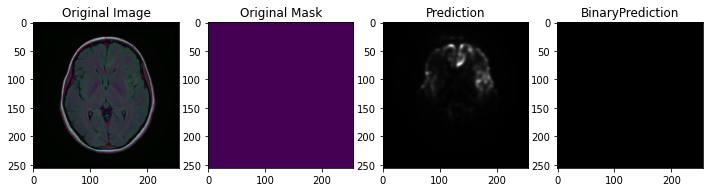

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


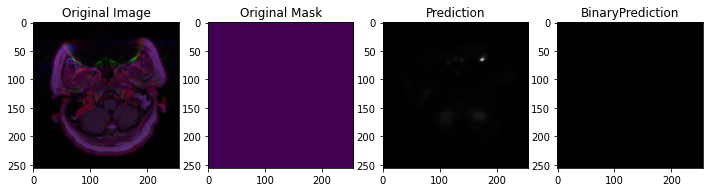

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


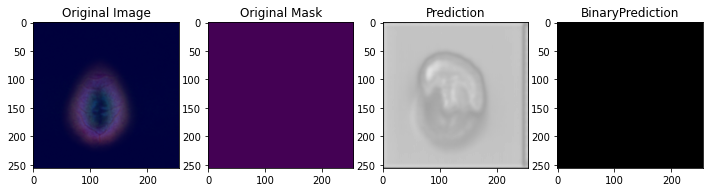

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


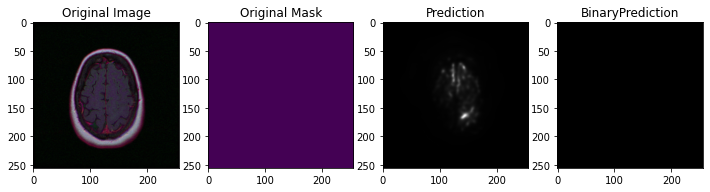

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


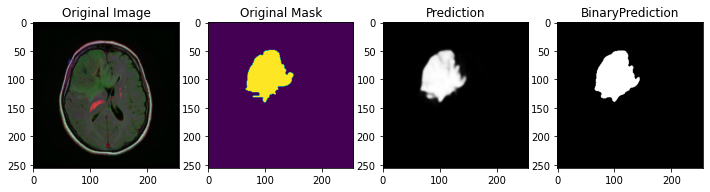

Pred Shape : (256, 256)
9039.0
4265 271 60762 238
confusion matrix: [[60762   238]
 [  271  4265]]


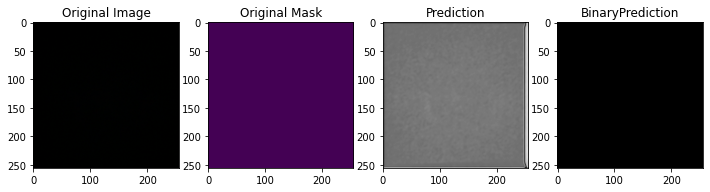

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


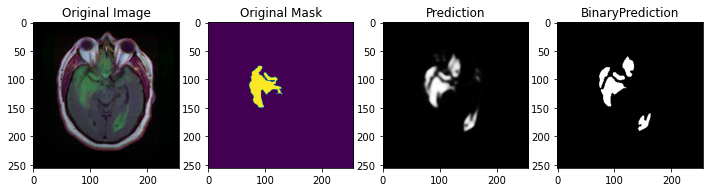

Pred Shape : (256, 256)
4172.0
1376 477 62740 943
confusion matrix: [[62740   943]
 [  477  1376]]


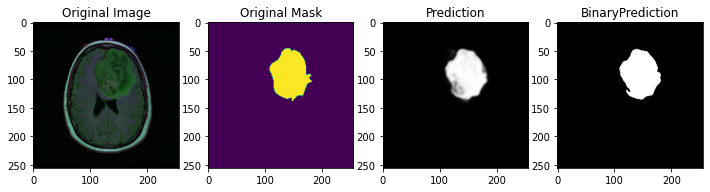

Pred Shape : (256, 256)
8957.0
4236 270 60815 215
confusion matrix: [[60815   215]
 [  270  4236]]


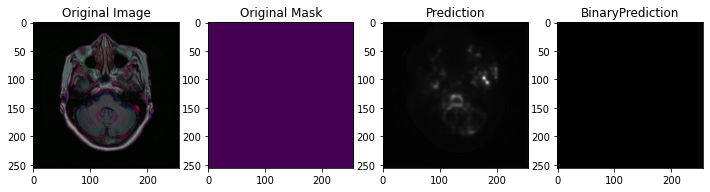

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


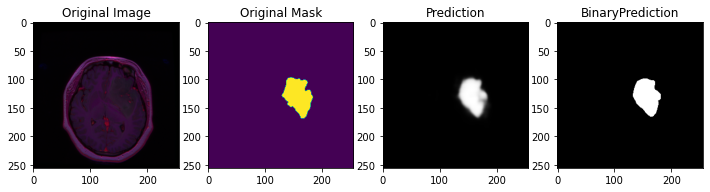

Pred Shape : (256, 256)
4644.0
2162 264 63054 56
confusion matrix: [[63054    56]
 [  264  2162]]


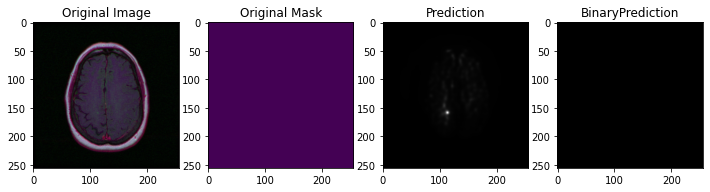

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


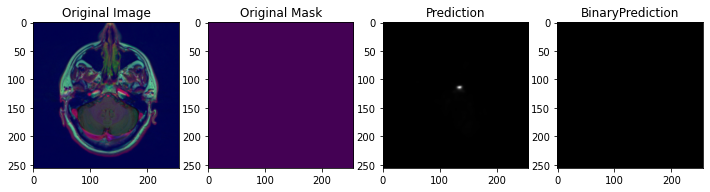

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


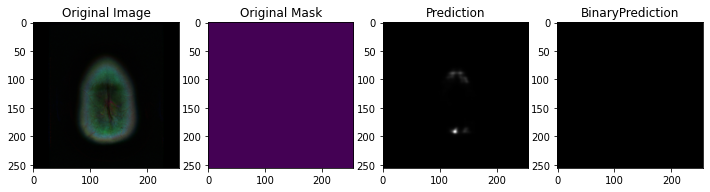

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


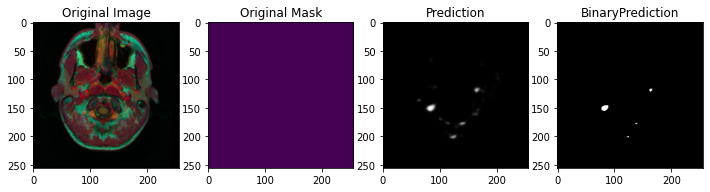

Pred Shape : (256, 256)
125.0
0 0 65411 125
confusion matrix: [[65411   125]
 [    0     0]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:78: RuntimeWarning: invalid value encountered in long_scalars


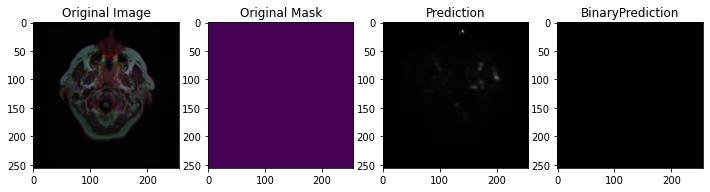

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


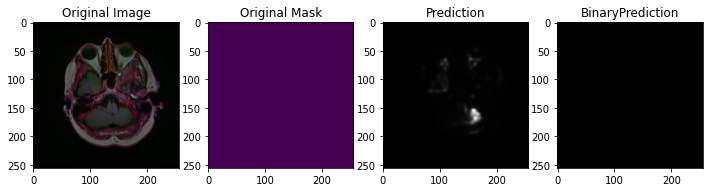

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


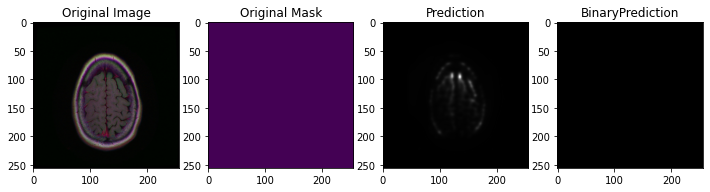

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


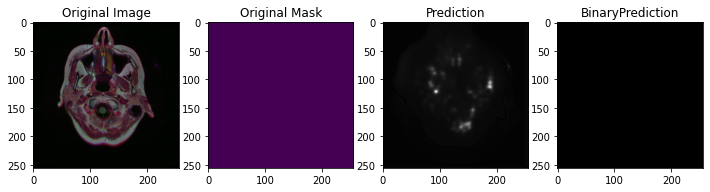

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


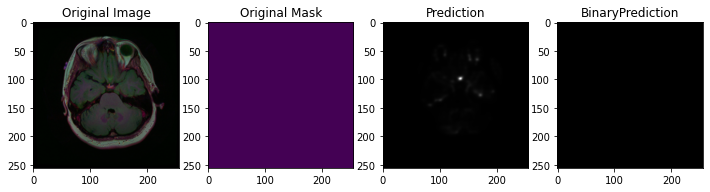

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


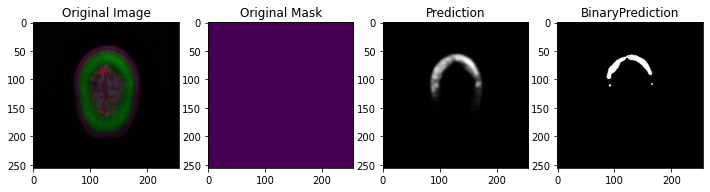

Pred Shape : (256, 256)
949.0
0 0 64587 949
confusion matrix: [[64587   949]
 [    0     0]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:78: RuntimeWarning: invalid value encountered in long_scalars


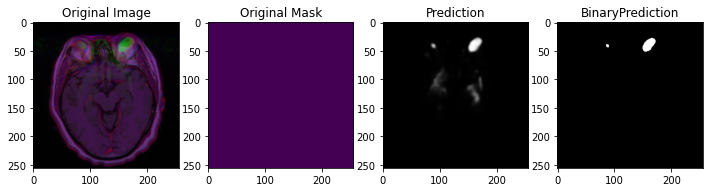

Pred Shape : (256, 256)
382.0
0 0 65154 382
confusion matrix: [[65154   382]
 [    0     0]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:78: RuntimeWarning: invalid value encountered in long_scalars


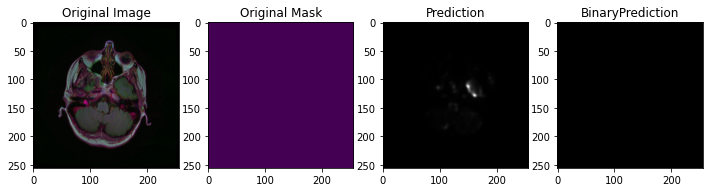

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


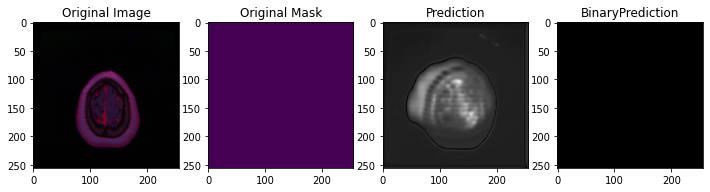

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


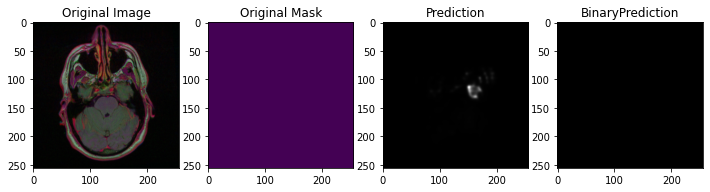

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


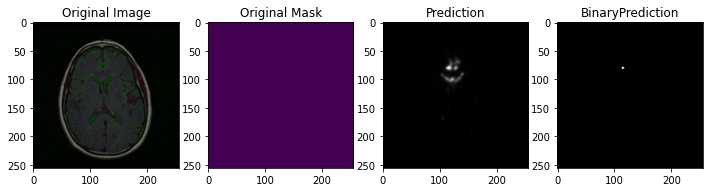

Pred Shape : (256, 256)
13.0
0 0 65523 13
confusion matrix: [[65523    13]
 [    0     0]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:78: RuntimeWarning: invalid value encountered in long_scalars


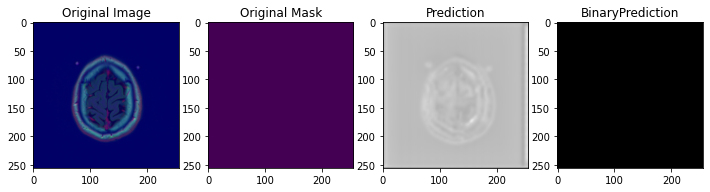

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


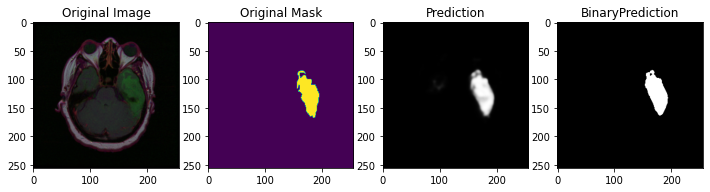

Pred Shape : (256, 256)
3645.0
1650 134 63541 211
confusion matrix: [[63541   211]
 [  134  1650]]


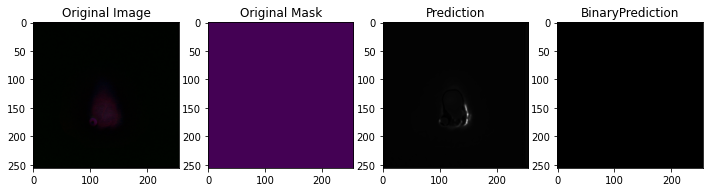

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


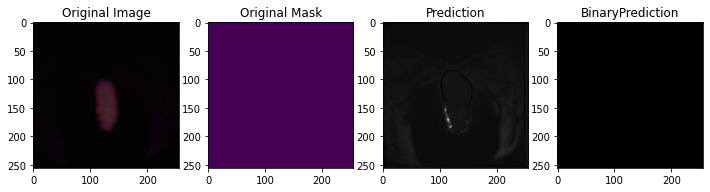

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


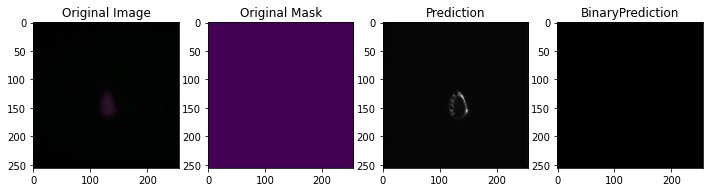

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


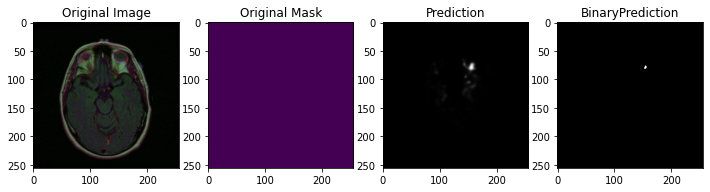

Pred Shape : (256, 256)
18.0
0 0 65518 18
confusion matrix: [[65518    18]
 [    0     0]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:78: RuntimeWarning: invalid value encountered in long_scalars


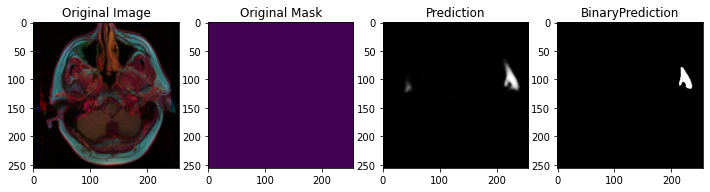

Pred Shape : (256, 256)
458.0
0 0 65078 458
confusion matrix: [[65078   458]
 [    0     0]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:78: RuntimeWarning: invalid value encountered in long_scalars


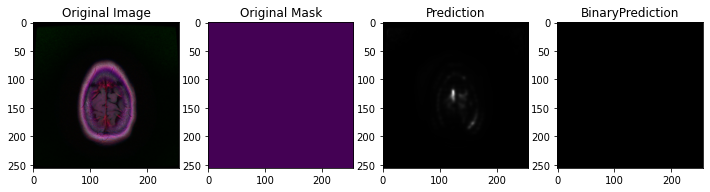

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


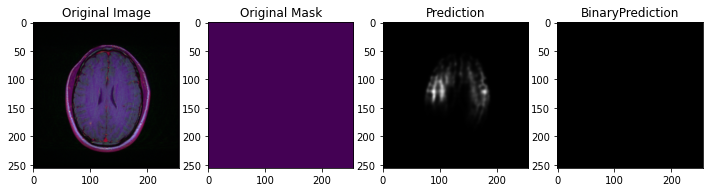

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


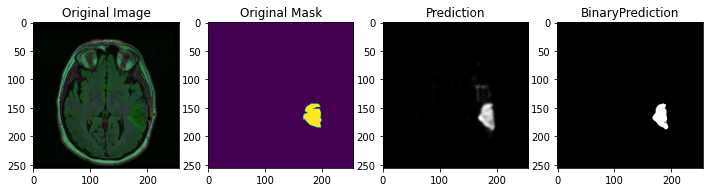

Pred Shape : (256, 256)
1766.0
728 257 64498 53
confusion matrix: [[64498    53]
 [  257   728]]


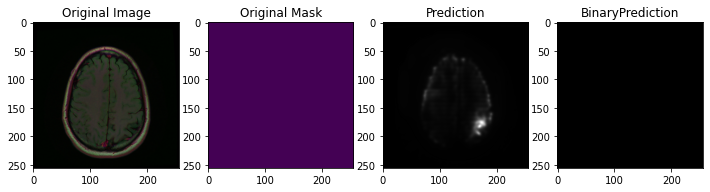

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


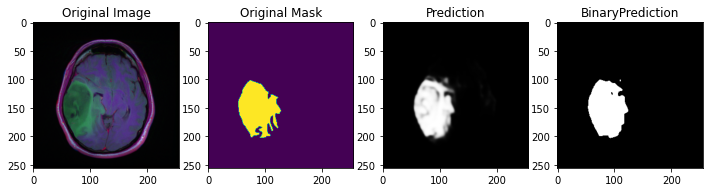

Pred Shape : (256, 256)
10041.0
4623 234 60118 561
confusion matrix: [[60118   561]
 [  234  4623]]


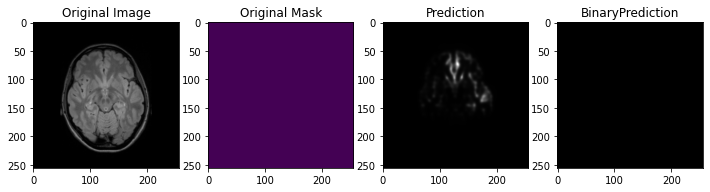

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


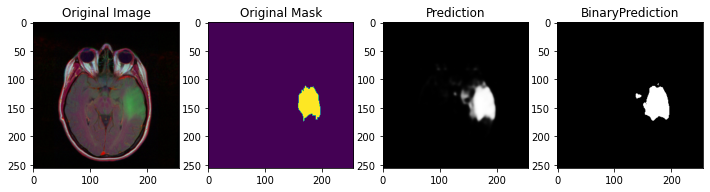

Pred Shape : (256, 256)
3754.0
1660 17 63442 417
confusion matrix: [[63442   417]
 [   17  1660]]


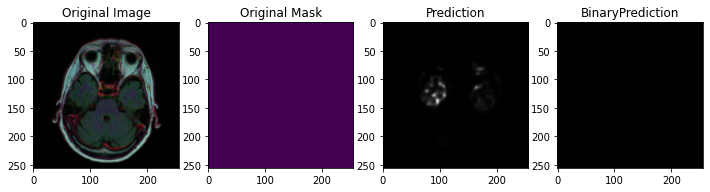

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


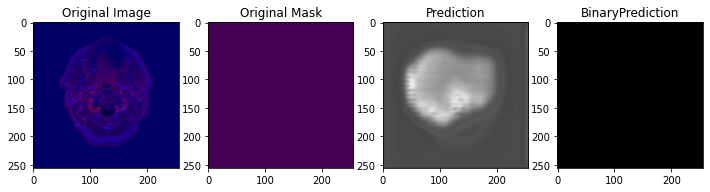

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


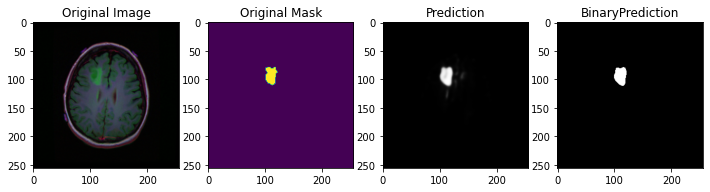

Pred Shape : (256, 256)
1050.0
470 23 64956 87
confusion matrix: [[64956    87]
 [   23   470]]


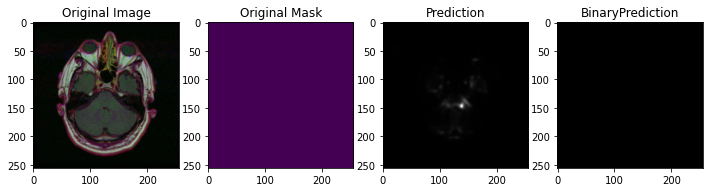

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


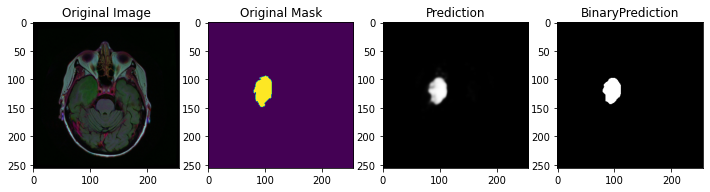

Pred Shape : (256, 256)
2310.0
1058 180 64284 14
confusion matrix: [[64284    14]
 [  180  1058]]


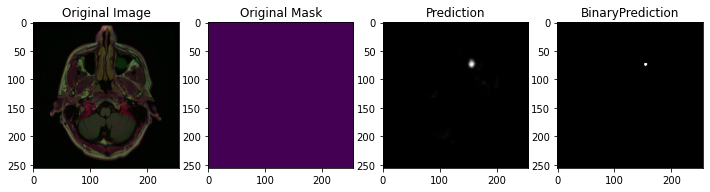

Pred Shape : (256, 256)
22.0
0 0 65514 22
confusion matrix: [[65514    22]
 [    0     0]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:78: RuntimeWarning: invalid value encountered in long_scalars


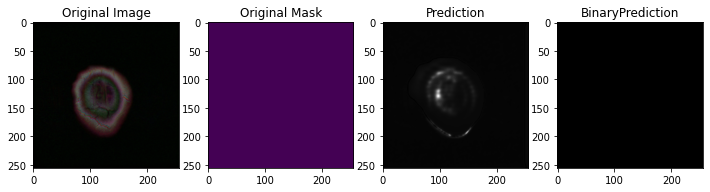

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


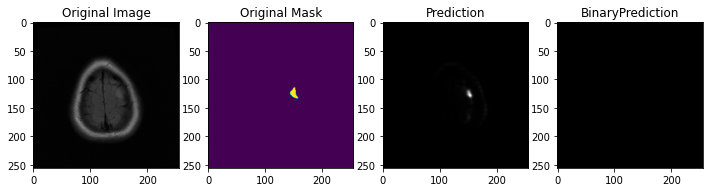

Pred Shape : (256, 256)
147.0
0 147 65389 0
confusion matrix: [[65389     0]
 [  147     0]]


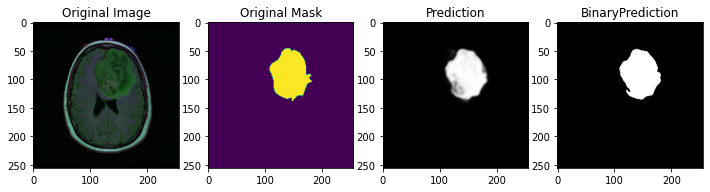

Pred Shape : (256, 256)
8957.0
4236 270 60815 215
confusion matrix: [[60815   215]
 [  270  4236]]


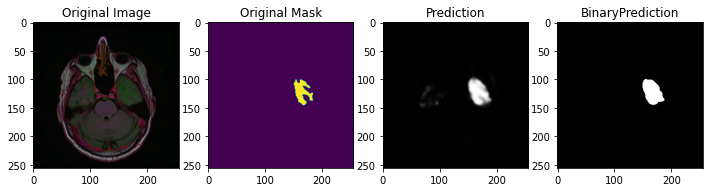

Pred Shape : (256, 256)
1958.0
793 11 64371 361
confusion matrix: [[64371   361]
 [   11   793]]


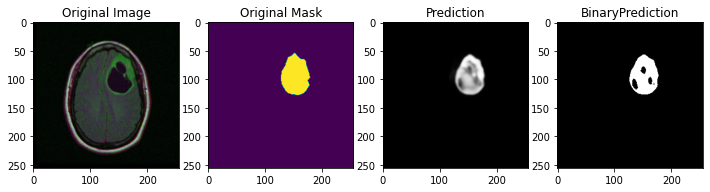

Pred Shape : (256, 256)
5118.0
2344 392 62762 38
confusion matrix: [[62762    38]
 [  392  2344]]


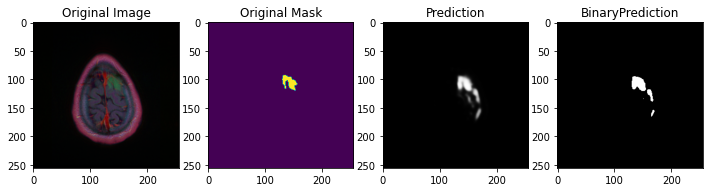

Pred Shape : (256, 256)
1031.0
349 43 64854 290
confusion matrix: [[64854   290]
 [   43   349]]


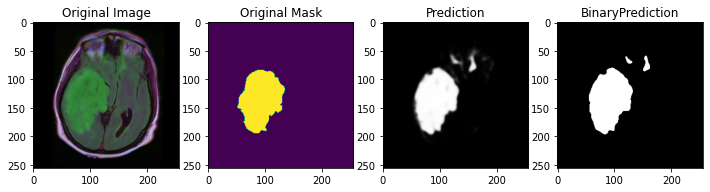

Pred Shape : (256, 256)
12570.0
5888 301 58854 493
confusion matrix: [[58854   493]
 [  301  5888]]


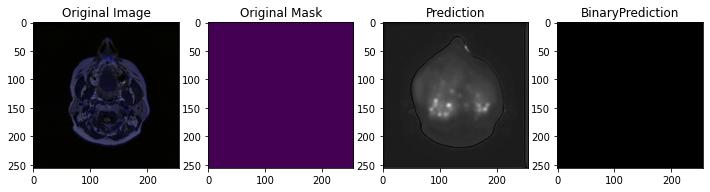

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


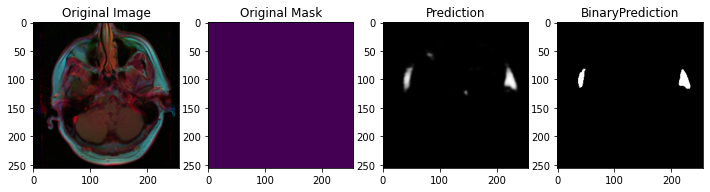

Pred Shape : (256, 256)
673.0
0 0 64863 673
confusion matrix: [[64863   673]
 [    0     0]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:78: RuntimeWarning: invalid value encountered in long_scalars


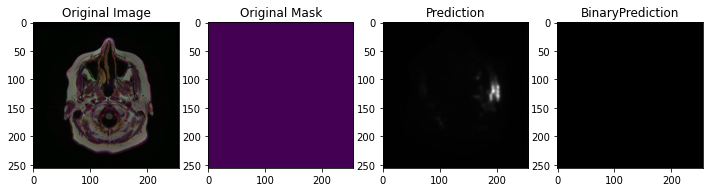

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


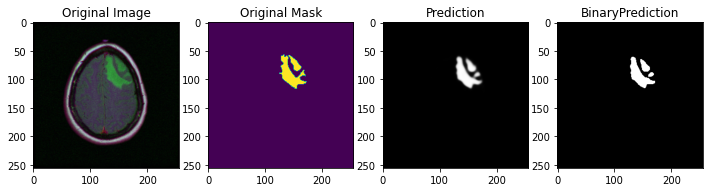

Pred Shape : (256, 256)
2569.0
1146 194 64113 83
confusion matrix: [[64113    83]
 [  194  1146]]


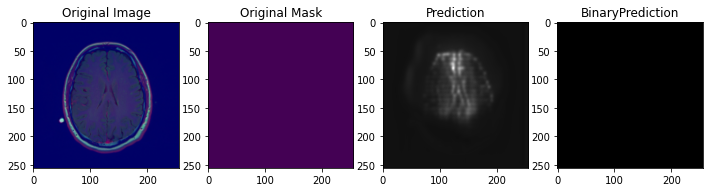

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


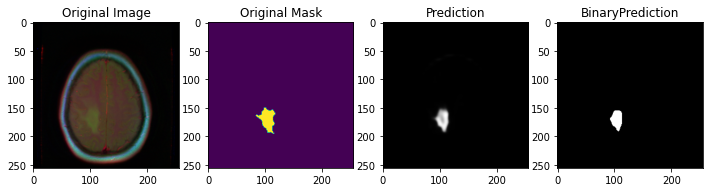

Pred Shape : (256, 256)
1342.0
538 266 64732 0
confusion matrix: [[64732     0]
 [  266   538]]


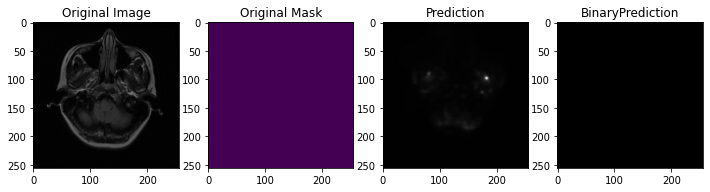

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


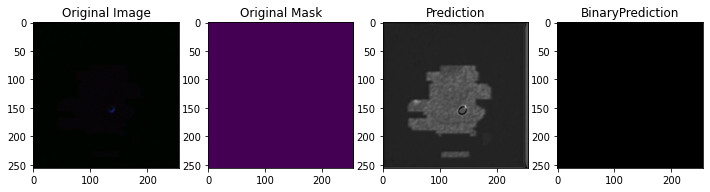

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


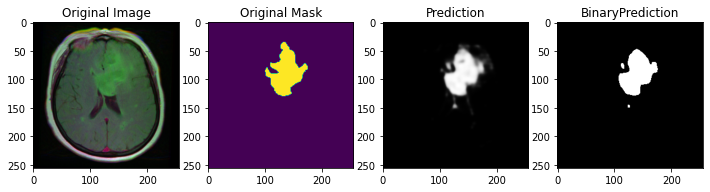

Pred Shape : (256, 256)
6736.0
2956 511 61756 313
confusion matrix: [[61756   313]
 [  511  2956]]


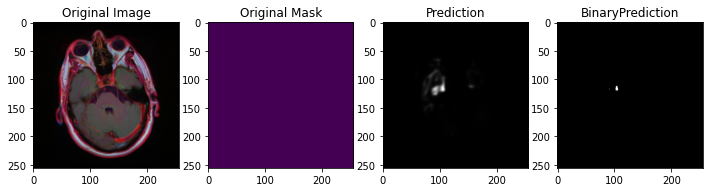

Pred Shape : (256, 256)
30.0
0 0 65506 30
confusion matrix: [[65506    30]
 [    0     0]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:78: RuntimeWarning: invalid value encountered in long_scalars


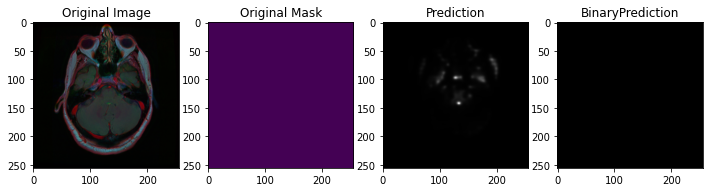

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


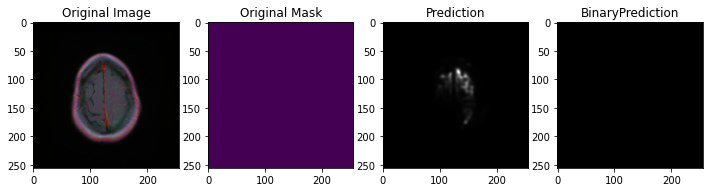

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


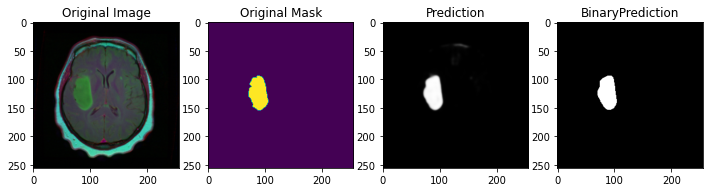

Pred Shape : (256, 256)
3059.0
1475 64 63952 45
confusion matrix: [[63952    45]
 [   64  1475]]


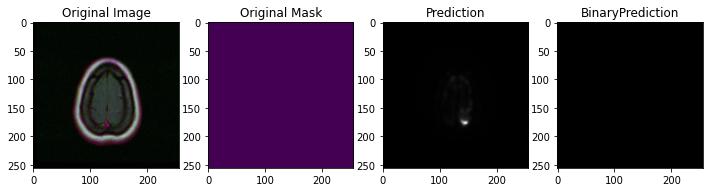

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


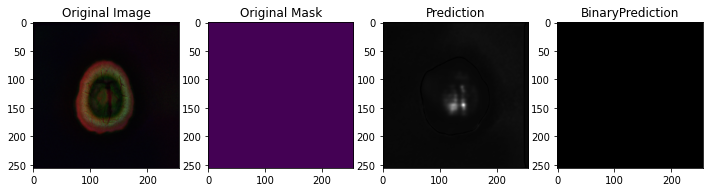

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


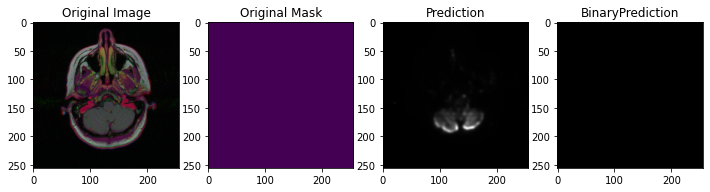

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


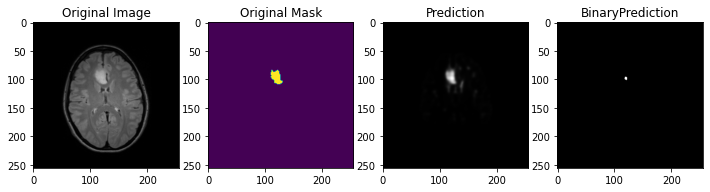

Pred Shape : (256, 256)
363.0
21 321 65194 0
confusion matrix: [[65194     0]
 [  321    21]]


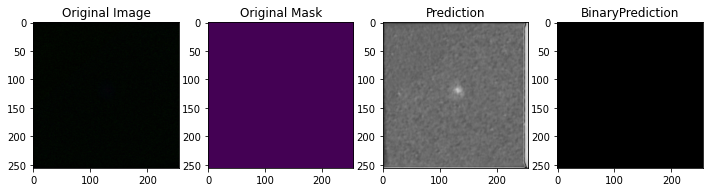

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


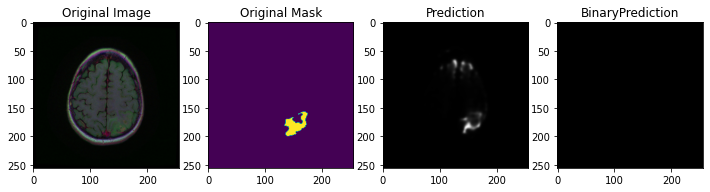

Pred Shape : (256, 256)
831.0
0 831 64705 0
confusion matrix: [[64705     0]
 [  831     0]]


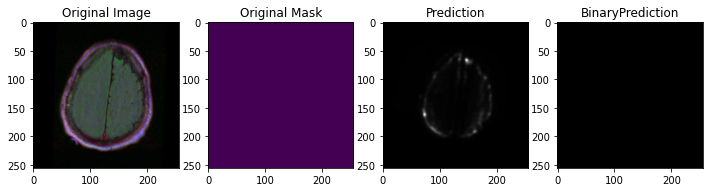

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


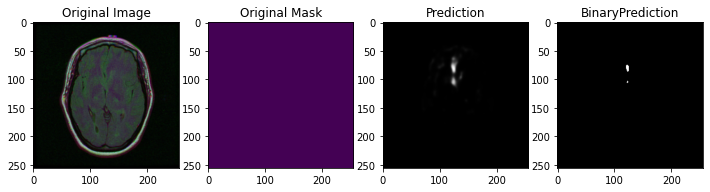

Pred Shape : (256, 256)
55.0
0 0 65481 55
confusion matrix: [[65481    55]
 [    0     0]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:78: RuntimeWarning: invalid value encountered in long_scalars


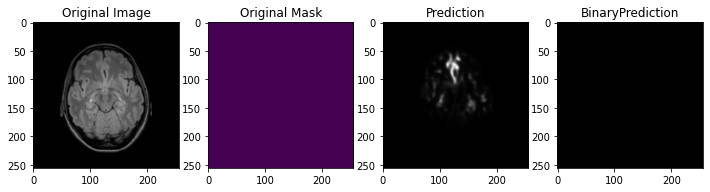

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


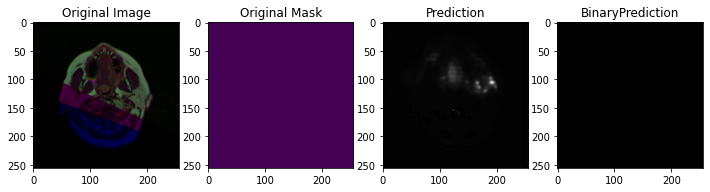

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


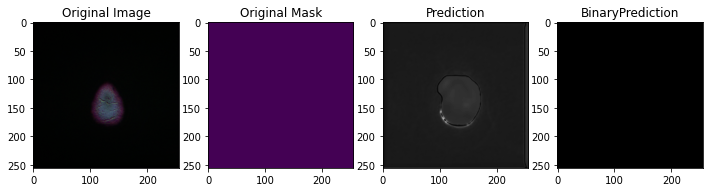

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


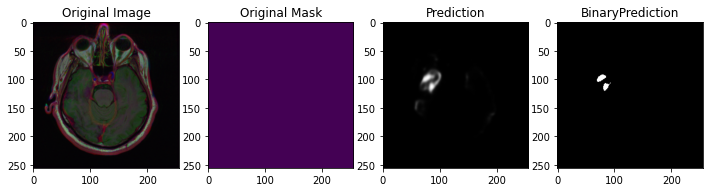

Pred Shape : (256, 256)
225.0
0 0 65311 225
confusion matrix: [[65311   225]
 [    0     0]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:78: RuntimeWarning: invalid value encountered in long_scalars


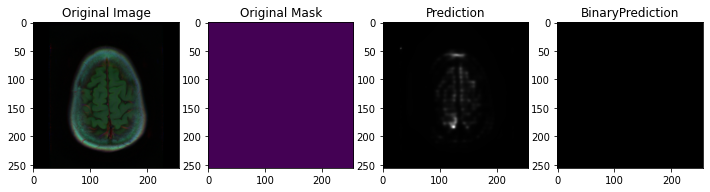

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


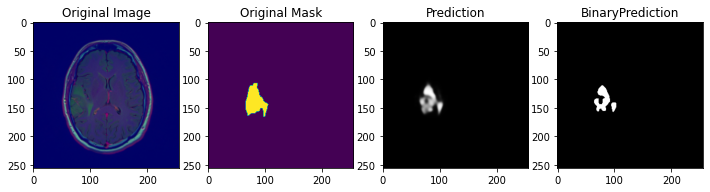

Pred Shape : (256, 256)
2155.0
784 577 64165 10
confusion matrix: [[64165    10]
 [  577   784]]


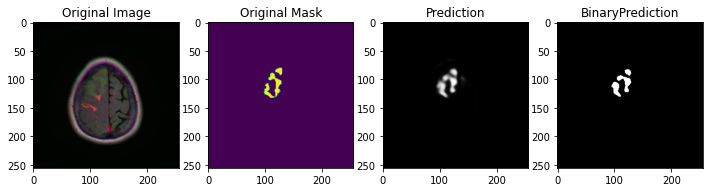

Pred Shape : (256, 256)
1262.0
477 149 64751 159
confusion matrix: [[64751   159]
 [  149   477]]


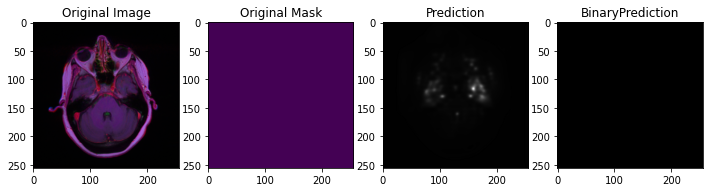

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


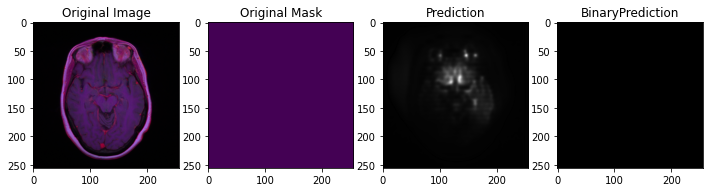

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


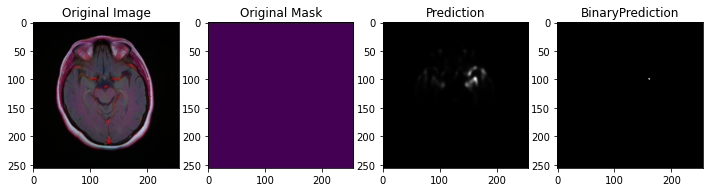

Pred Shape : (256, 256)
6.0
0 0 65530 6
confusion matrix: [[65530     6]
 [    0     0]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:78: RuntimeWarning: invalid value encountered in long_scalars


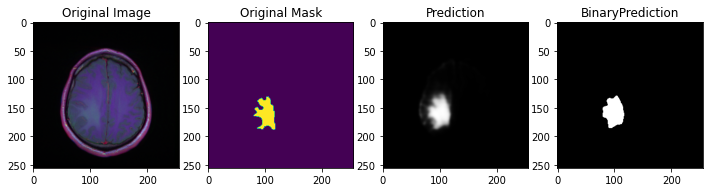

Pred Shape : (256, 256)
2802.0
1190 121 63924 301
confusion matrix: [[63924   301]
 [  121  1190]]


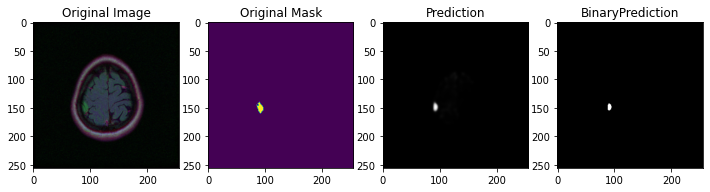

Pred Shape : (256, 256)
198.0
62 71 65400 3
confusion matrix: [[65400     3]
 [   71    62]]


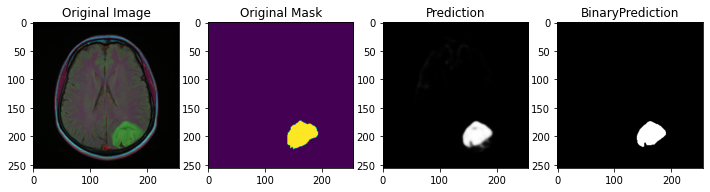

Pred Shape : (256, 256)
3286.0
1509 256 63759 12
confusion matrix: [[63759    12]
 [  256  1509]]


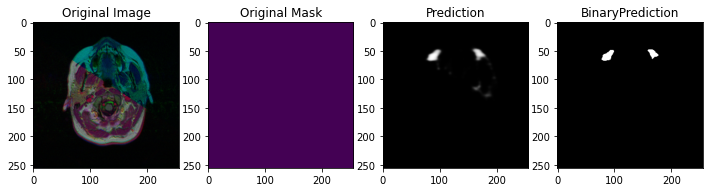

Pred Shape : (256, 256)
417.0
0 0 65119 417
confusion matrix: [[65119   417]
 [    0     0]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:78: RuntimeWarning: invalid value encountered in long_scalars


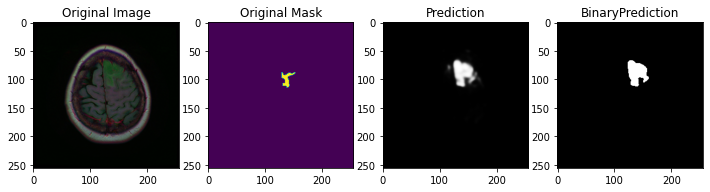

Pred Shape : (256, 256)
1373.0
256 7 64419 854
confusion matrix: [[64419   854]
 [    7   256]]


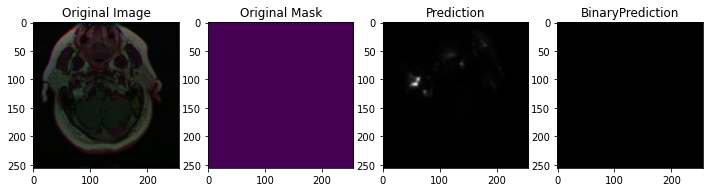

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


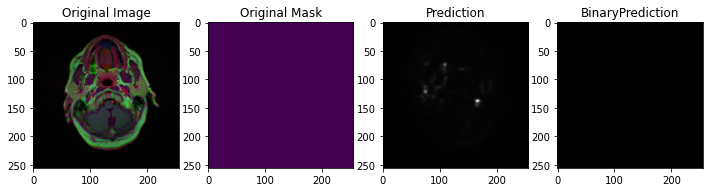

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


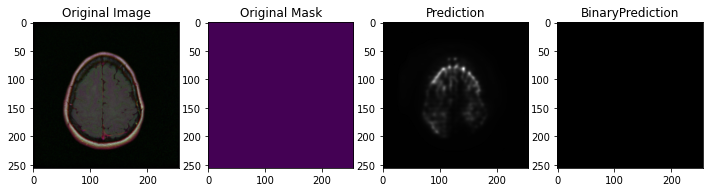

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


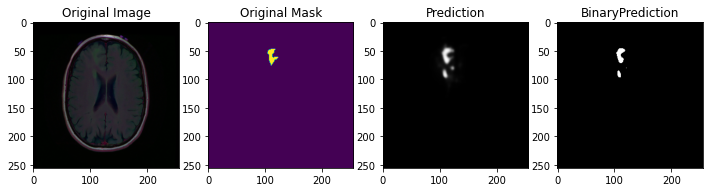

Pred Shape : (256, 256)
553.0
204 54 65187 91
confusion matrix: [[65187    91]
 [   54   204]]


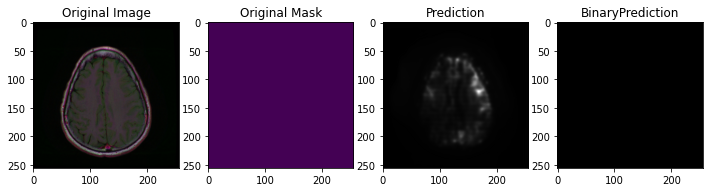

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


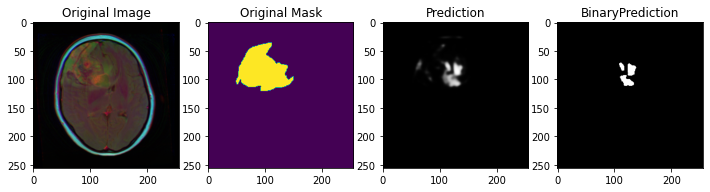

Pred Shape : (256, 256)
5678.0
598 4479 60456 3
confusion matrix: [[60456     3]
 [ 4479   598]]


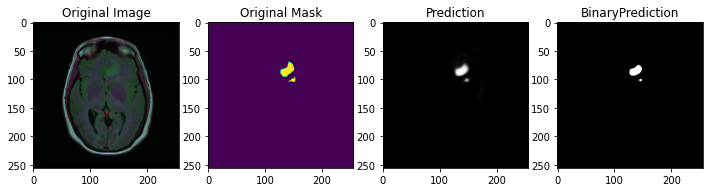

Pred Shape : (256, 256)
703.0
287 121 65120 8
confusion matrix: [[65120     8]
 [  121   287]]


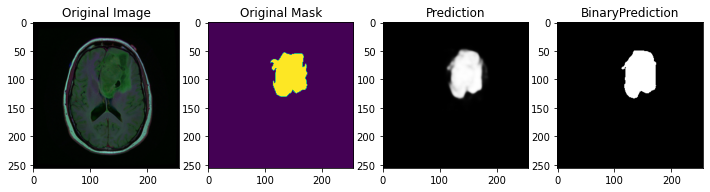

Pred Shape : (256, 256)
7519.0
3482 246 61499 309
confusion matrix: [[61499   309]
 [  246  3482]]


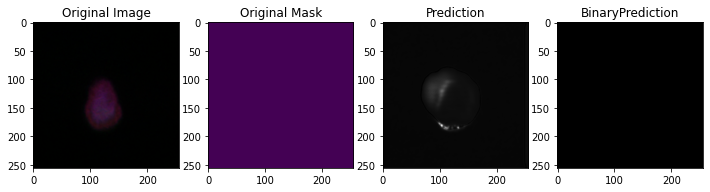

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


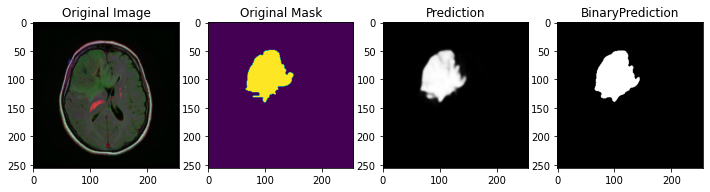

Pred Shape : (256, 256)
9039.0
4265 271 60762 238
confusion matrix: [[60762   238]
 [  271  4265]]


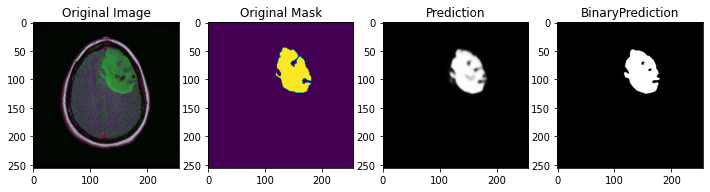

Pred Shape : (256, 256)
6422.0
2994 155 62108 279
confusion matrix: [[62108   279]
 [  155  2994]]


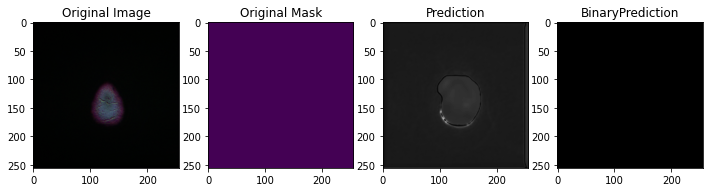

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


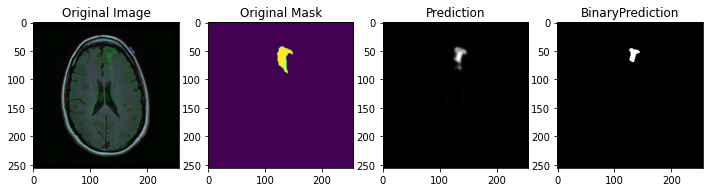

Pred Shape : (256, 256)
917.0
256 405 64875 0
confusion matrix: [[64875     0]
 [  405   256]]


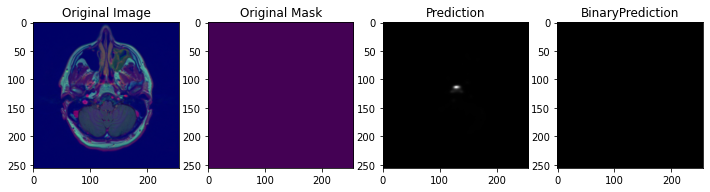

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


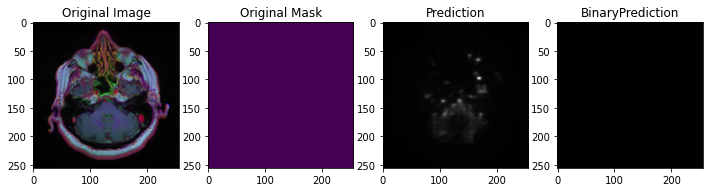

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


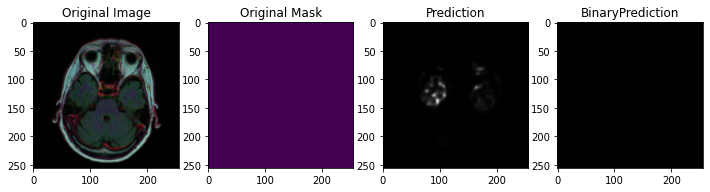

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


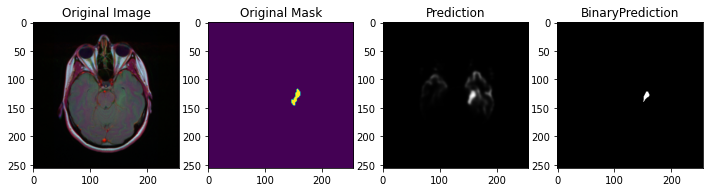

Pred Shape : (256, 256)
302.0
93 113 65327 3
confusion matrix: [[65327     3]
 [  113    93]]


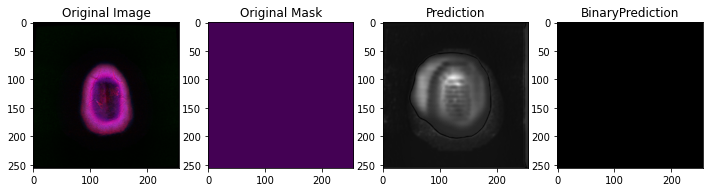

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


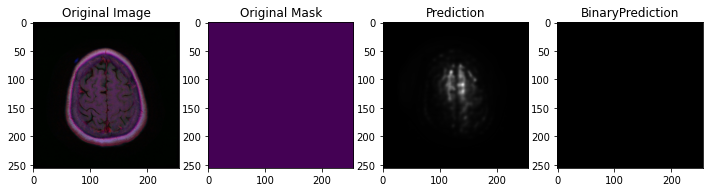

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


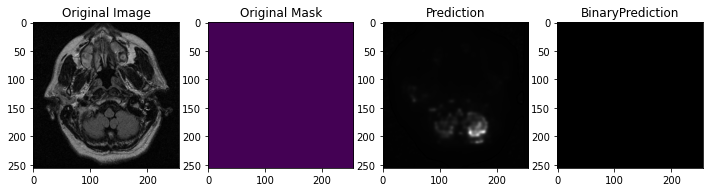

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


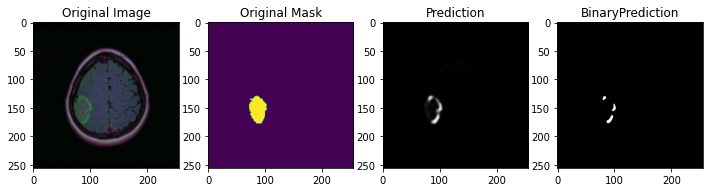

Pred Shape : (256, 256)
1251.0
152 945 64437 2
confusion matrix: [[64437     2]
 [  945   152]]


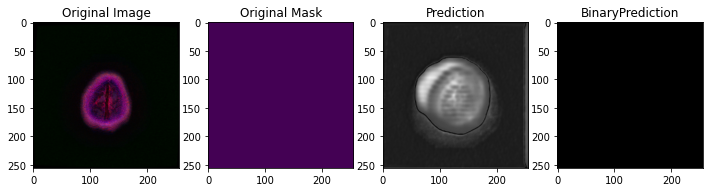

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


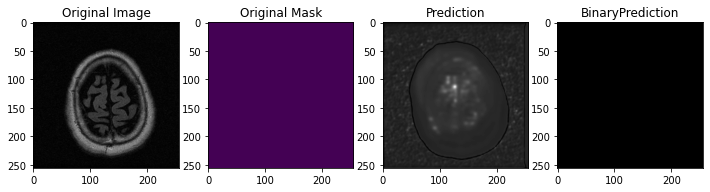

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


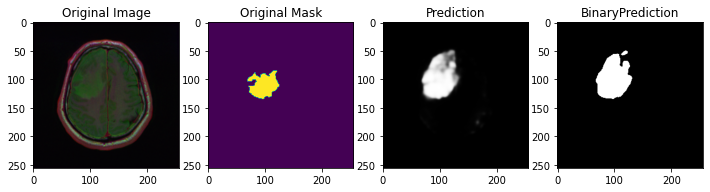

Pred Shape : (256, 256)
5306.0
1765 3 61995 1773
confusion matrix: [[61995  1773]
 [    3  1765]]


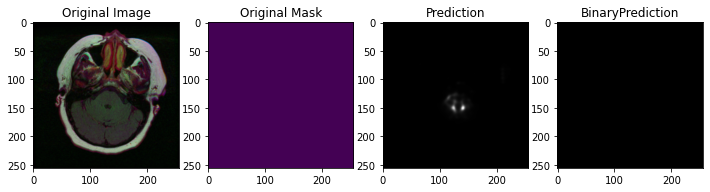

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


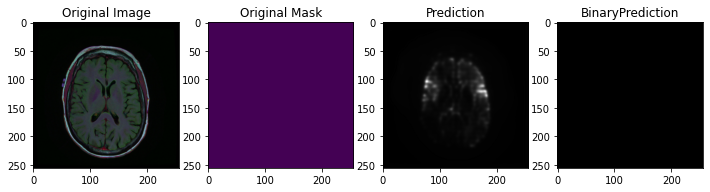

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


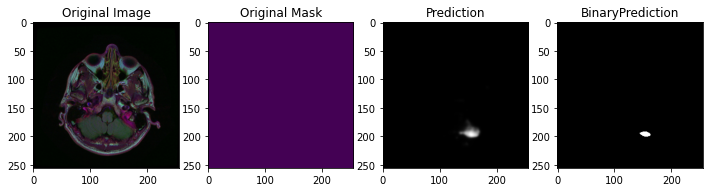

Pred Shape : (256, 256)
126.0
0 0 65410 126
confusion matrix: [[65410   126]
 [    0     0]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:78: RuntimeWarning: invalid value encountered in long_scalars


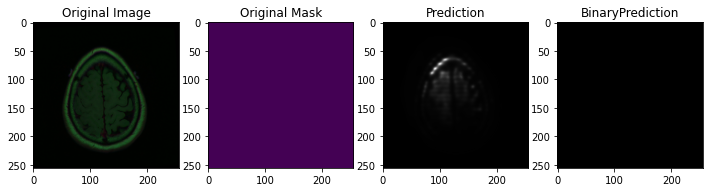

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


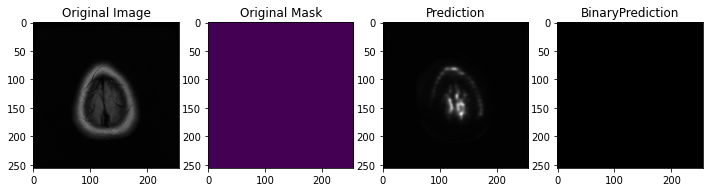

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


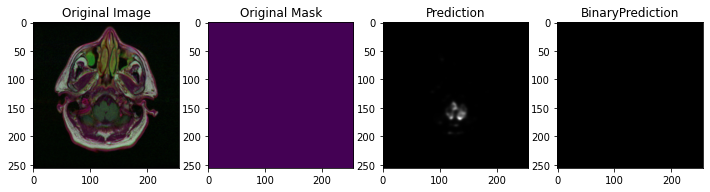

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


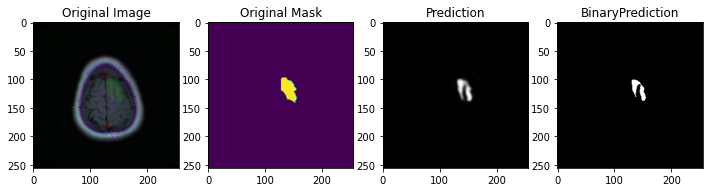

Pred Shape : (256, 256)
1205.0
409 377 64740 10
confusion matrix: [[64740    10]
 [  377   409]]


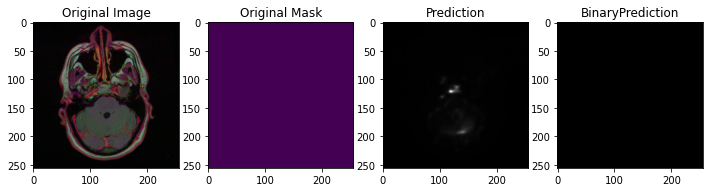

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


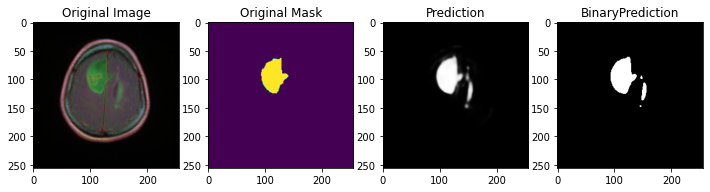

Pred Shape : (256, 256)
4039.0
1838 35 63335 328
confusion matrix: [[63335   328]
 [   35  1838]]


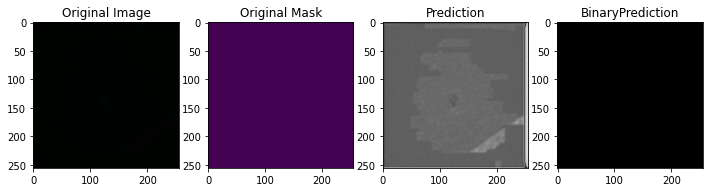

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


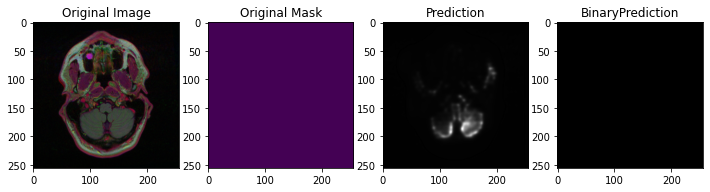

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


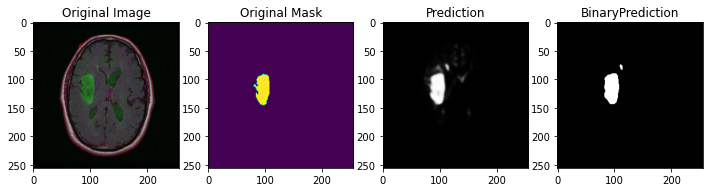

Pred Shape : (256, 256)
2266.0
1028 41 64298 169
confusion matrix: [[64298   169]
 [   41  1028]]


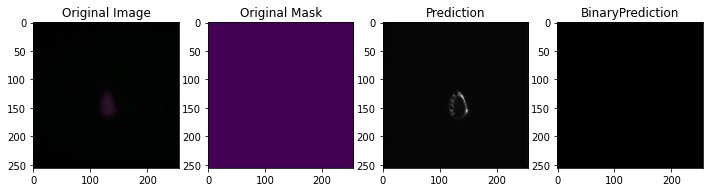

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


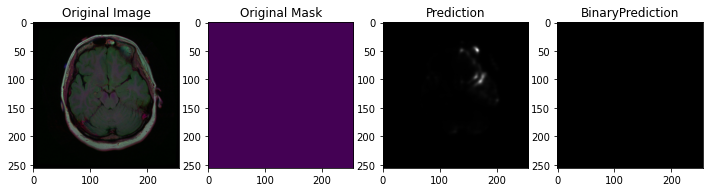

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


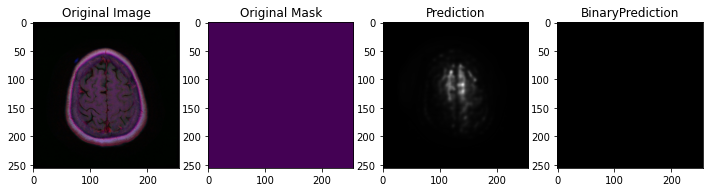

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


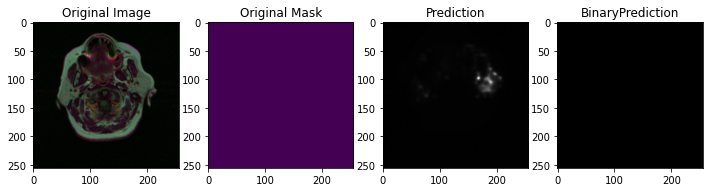

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


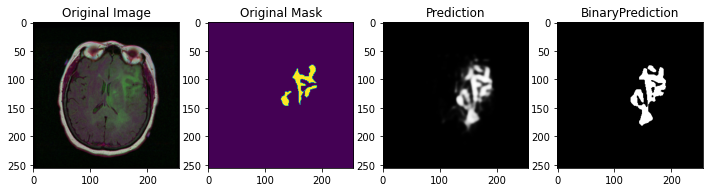

Pred Shape : (256, 256)
3878.0
1183 99 62841 1413
confusion matrix: [[62841  1413]
 [   99  1183]]


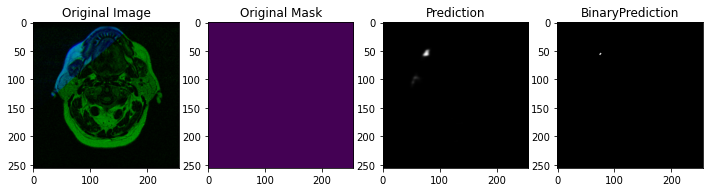

Pred Shape : (256, 256)
8.0
0 0 65528 8
confusion matrix: [[65528     8]
 [    0     0]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:78: RuntimeWarning: invalid value encountered in long_scalars


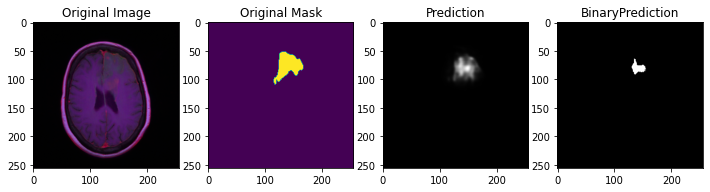

Pred Shape : (256, 256)
1839.0
323 1180 64020 13
confusion matrix: [[64020    13]
 [ 1180   323]]


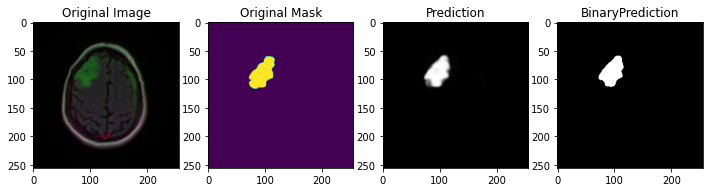

Pred Shape : (256, 256)
3091.0
1392 226 63837 81
confusion matrix: [[63837    81]
 [  226  1392]]


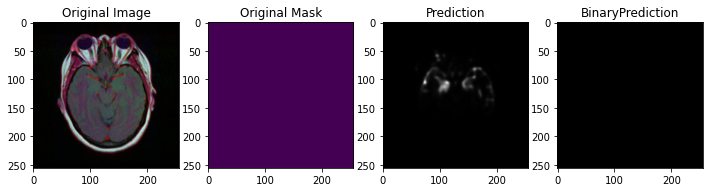

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


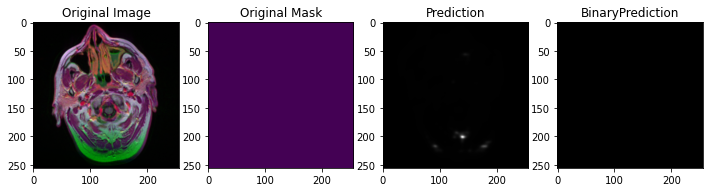

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


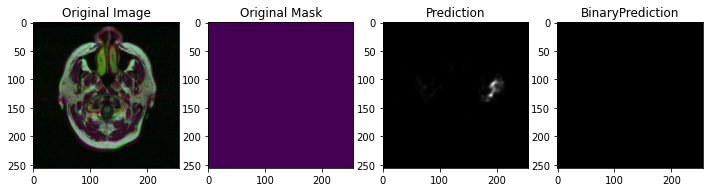

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


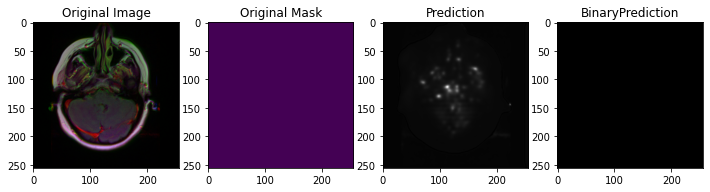

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


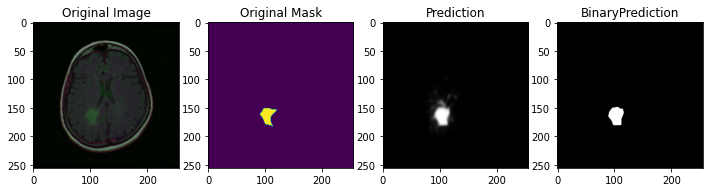

Pred Shape : (256, 256)
1150.0
485 20 64871 160
confusion matrix: [[64871   160]
 [   20   485]]


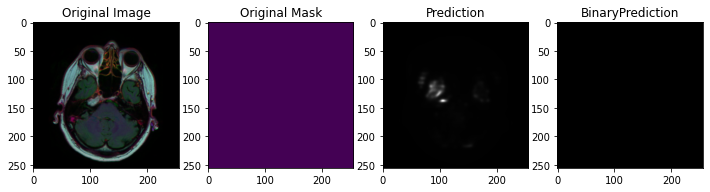

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


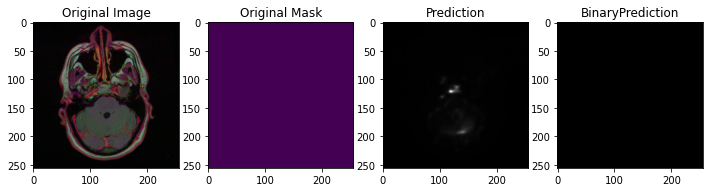

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


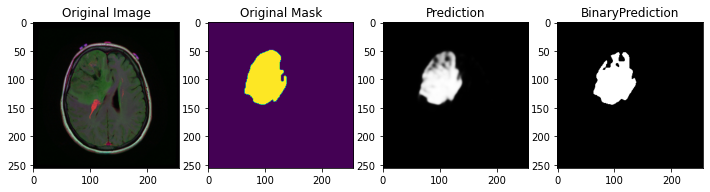

Pred Shape : (256, 256)
9331.0
4287 649 60492 108
confusion matrix: [[60492   108]
 [  649  4287]]


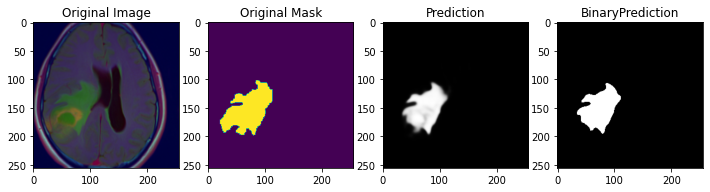

Pred Shape : (256, 256)
8586.0
3659 1240 60609 28
confusion matrix: [[60609    28]
 [ 1240  3659]]


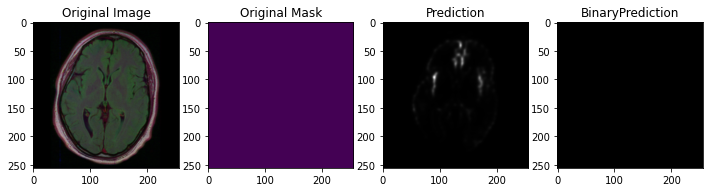

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


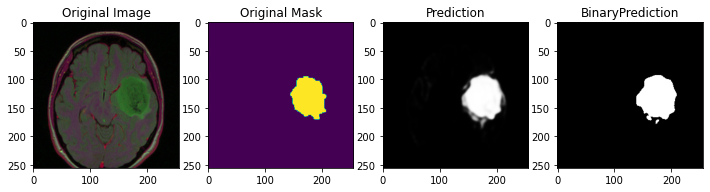

Pred Shape : (256, 256)
7450.0
3353 14 61439 730
confusion matrix: [[61439   730]
 [   14  3353]]


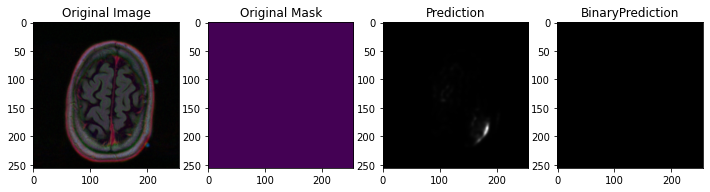

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


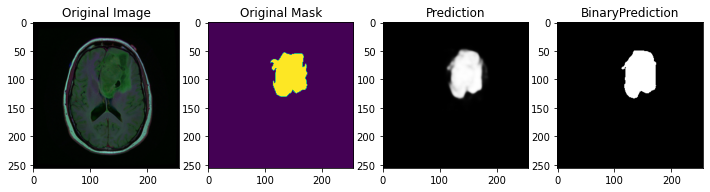

Pred Shape : (256, 256)
7519.0
3482 246 61499 309
confusion matrix: [[61499   309]
 [  246  3482]]


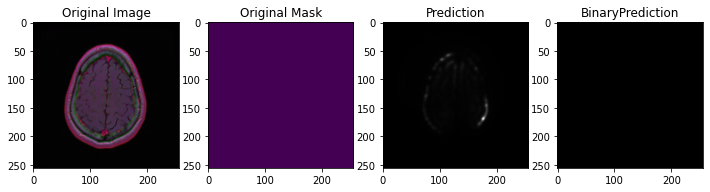

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


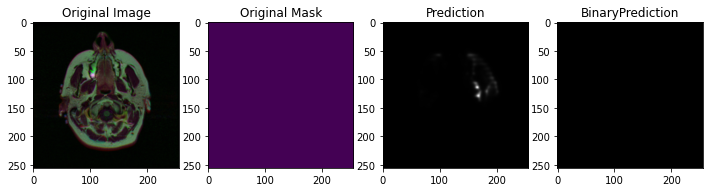

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


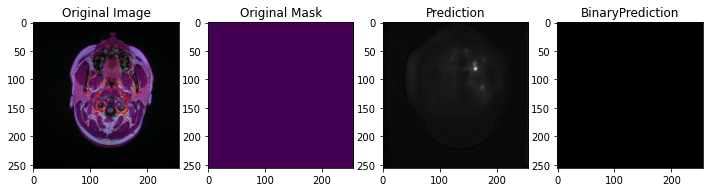

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


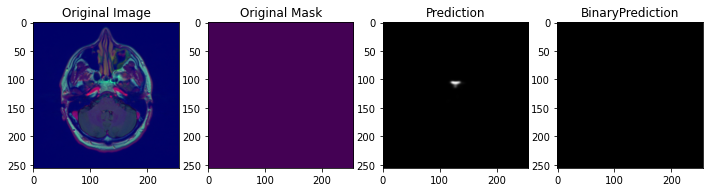

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


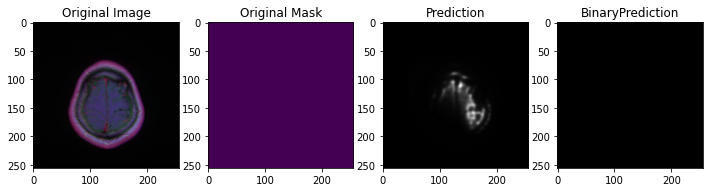

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


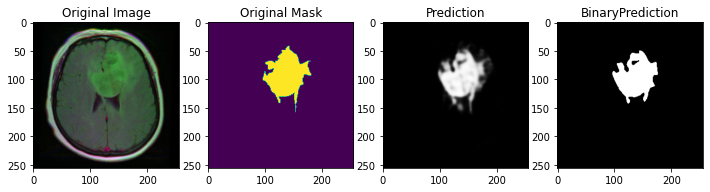

Pred Shape : (256, 256)
8759.0
3957 577 60734 268
confusion matrix: [[60734   268]
 [  577  3957]]


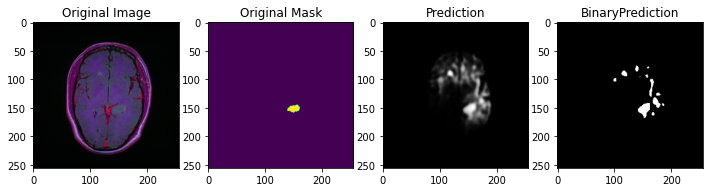

Pred Shape : (256, 256)
1064.0
184 30 64656 666
confusion matrix: [[64656   666]
 [   30   184]]


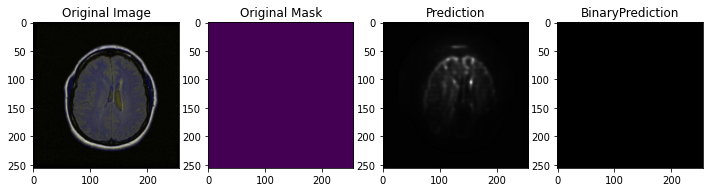

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


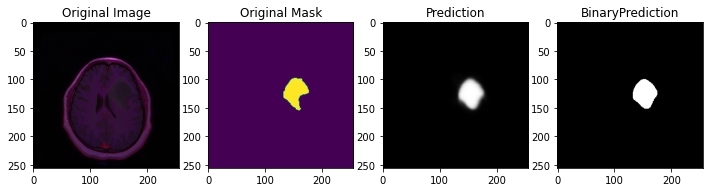

Pred Shape : (256, 256)
3041.0
1328 150 63823 235
confusion matrix: [[63823   235]
 [  150  1328]]


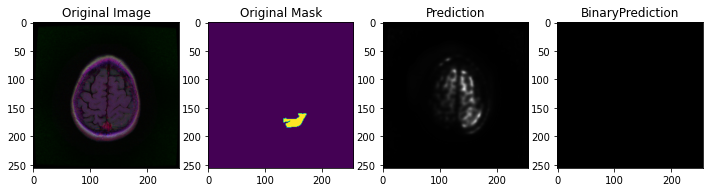

Pred Shape : (256, 256)
536.0
0 536 65000 0
confusion matrix: [[65000     0]
 [  536     0]]


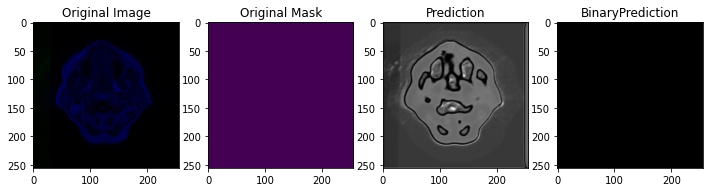

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


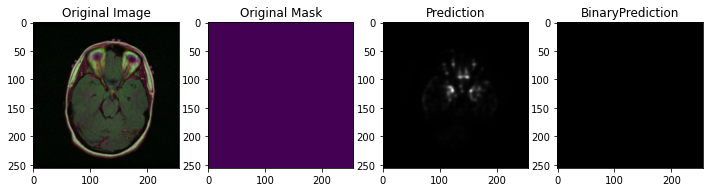

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


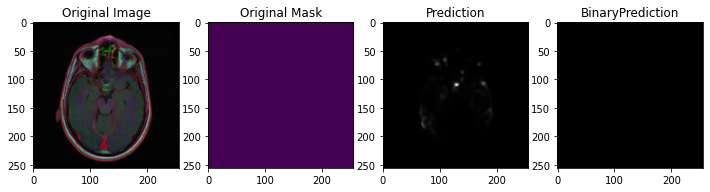

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


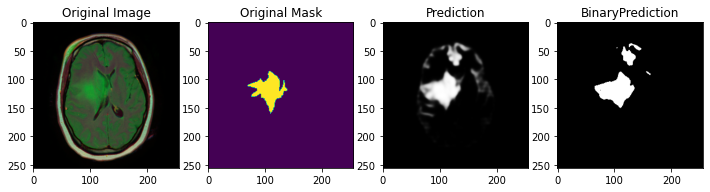

Pred Shape : (256, 256)
4976.0
1865 223 62425 1023
confusion matrix: [[62425  1023]
 [  223  1865]]


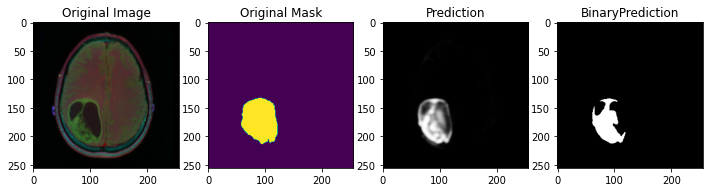

Pred Shape : (256, 256)
6375.0
2354 1627 61515 40
confusion matrix: [[61515    40]
 [ 1627  2354]]


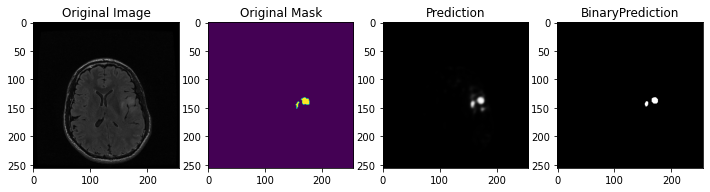

Pred Shape : (256, 256)
326.0
125 56 65335 20
confusion matrix: [[65335    20]
 [   56   125]]


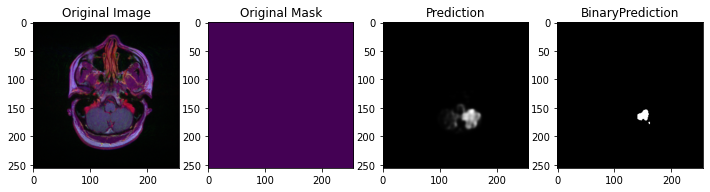

Pred Shape : (256, 256)
283.0
0 0 65253 283
confusion matrix: [[65253   283]
 [    0     0]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:78: RuntimeWarning: invalid value encountered in long_scalars


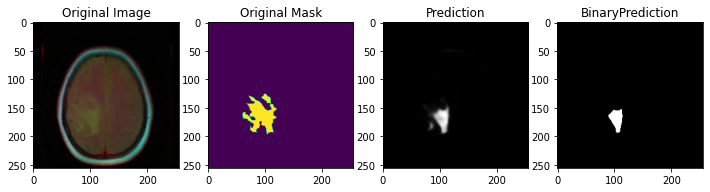

Pred Shape : (256, 256)
2710.0
634 1439 63460 3
confusion matrix: [[63460     3]
 [ 1439   634]]


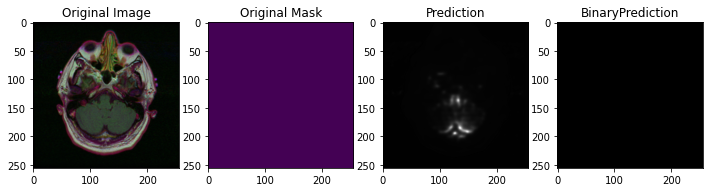

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


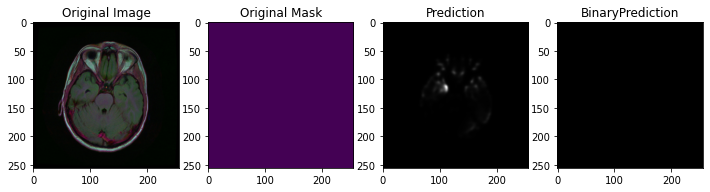

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


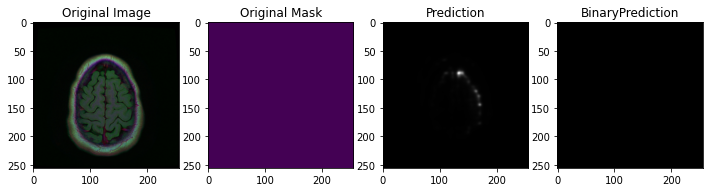

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


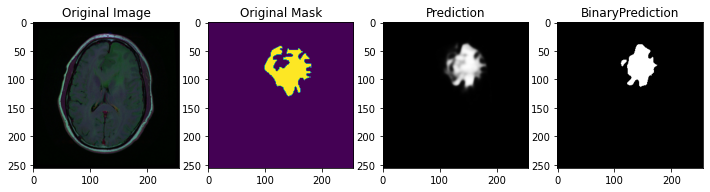

Pred Shape : (256, 256)
6145.0
1973 1646 61364 553
confusion matrix: [[61364   553]
 [ 1646  1973]]


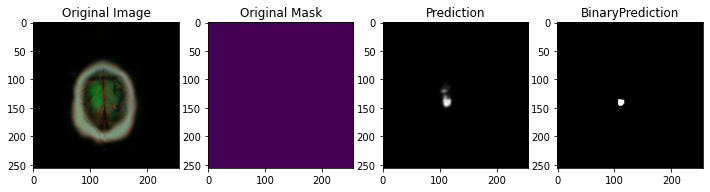

Pred Shape : (256, 256)
111.0
0 0 65425 111
confusion matrix: [[65425   111]
 [    0     0]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:78: RuntimeWarning: invalid value encountered in long_scalars


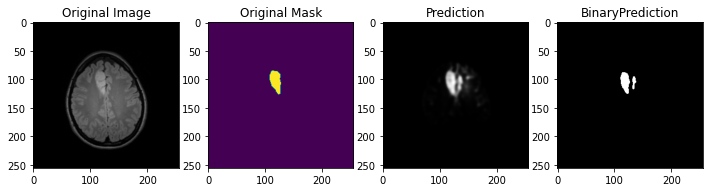

Pred Shape : (256, 256)
1134.0
436 151 64838 111
confusion matrix: [[64838   111]
 [  151   436]]


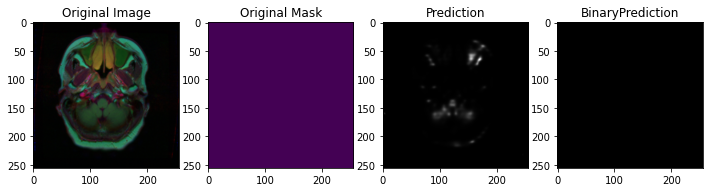

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


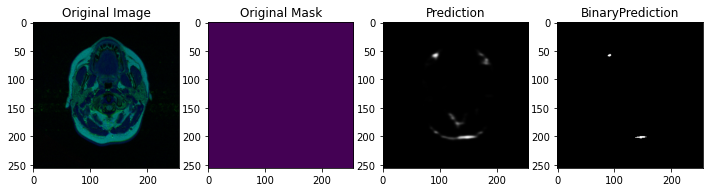

Pred Shape : (256, 256)
66.0
0 0 65470 66
confusion matrix: [[65470    66]
 [    0     0]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:78: RuntimeWarning: invalid value encountered in long_scalars


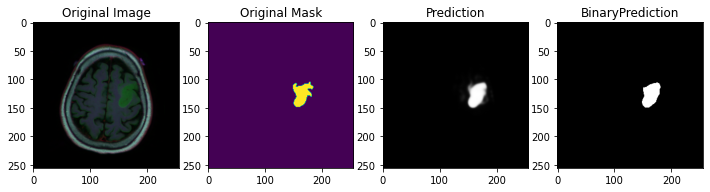

Pred Shape : (256, 256)
1960.0
867 94 64443 132
confusion matrix: [[64443   132]
 [   94   867]]


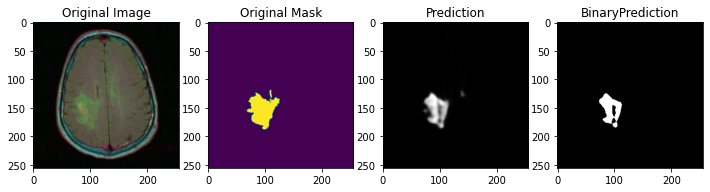

Pred Shape : (256, 256)
3274.0
1211 843 63473 9
confusion matrix: [[63473     9]
 [  843  1211]]


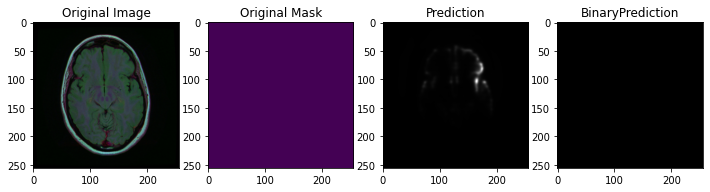

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


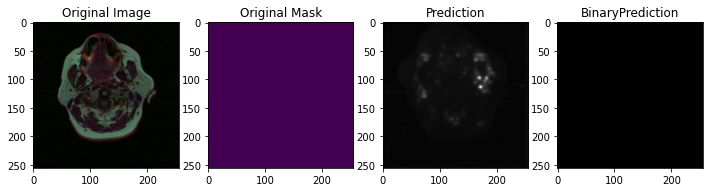

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


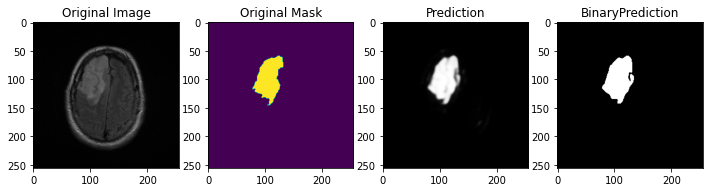

Pred Shape : (256, 256)
5552.0
2574 66 62558 338
confusion matrix: [[62558   338]
 [   66  2574]]


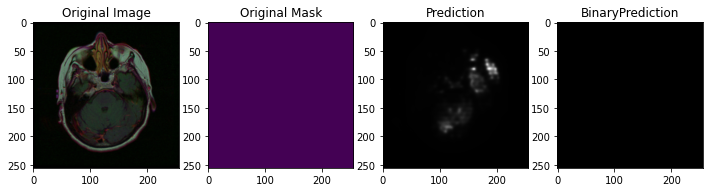

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


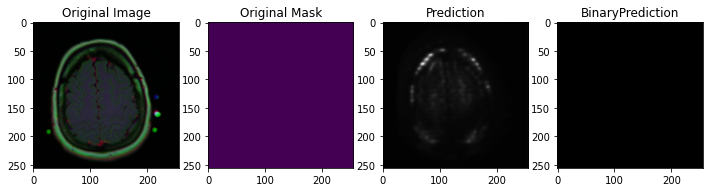

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


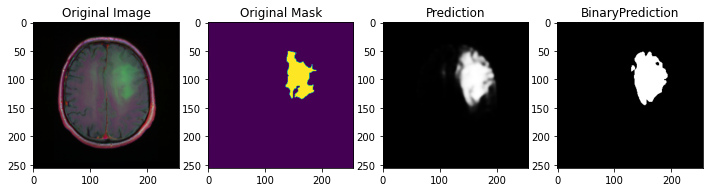

Pred Shape : (256, 256)
6349.0
2474 42 61661 1359
confusion matrix: [[61661  1359]
 [   42  2474]]


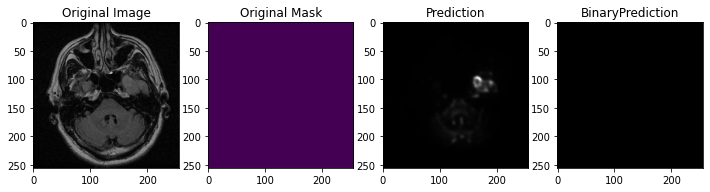

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


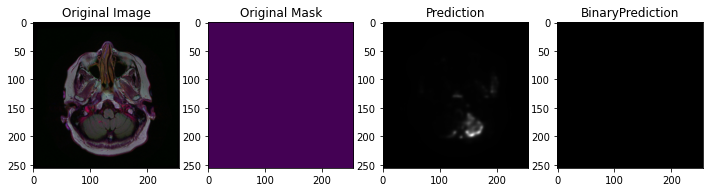

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


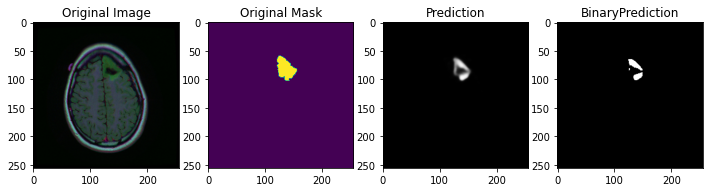

Pred Shape : (256, 256)
1320.0
375 566 64591 4
confusion matrix: [[64591     4]
 [  566   375]]


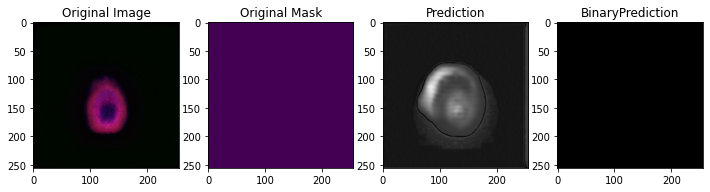

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


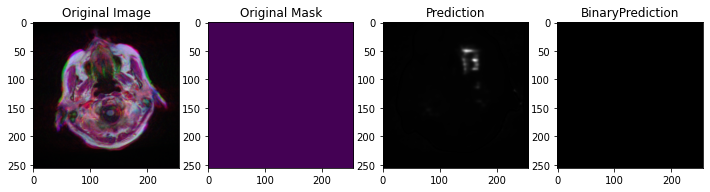

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


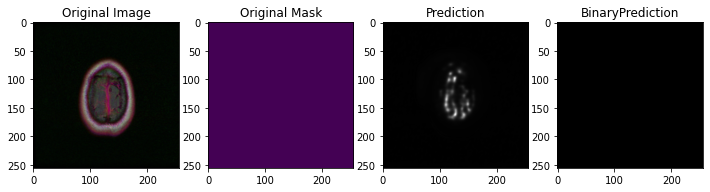

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


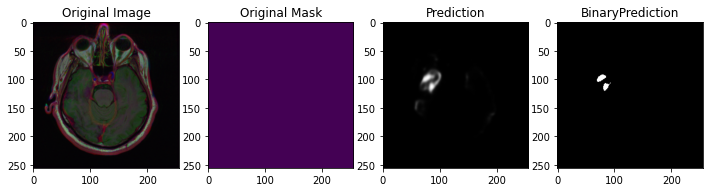

Pred Shape : (256, 256)
225.0
0 0 65311 225
confusion matrix: [[65311   225]
 [    0     0]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:78: RuntimeWarning: invalid value encountered in long_scalars


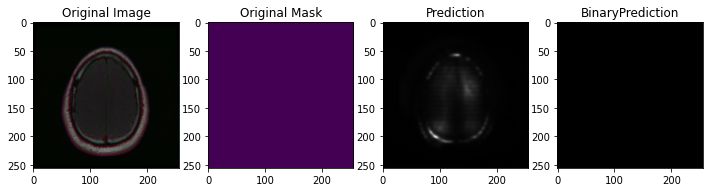

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


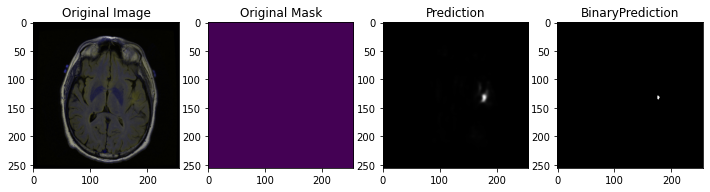

Pred Shape : (256, 256)
20.0
0 0 65516 20
confusion matrix: [[65516    20]
 [    0     0]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:78: RuntimeWarning: invalid value encountered in long_scalars


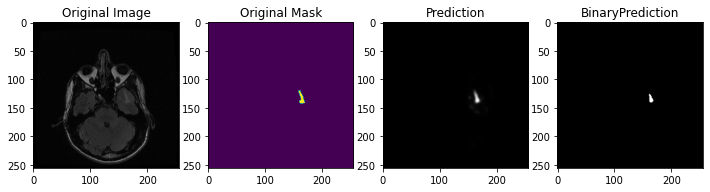

Pred Shape : (256, 256)
196.0
66 59 65406 5
confusion matrix: [[65406     5]
 [   59    66]]


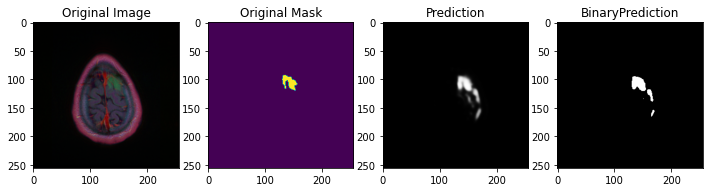

Pred Shape : (256, 256)
1031.0
349 43 64854 290
confusion matrix: [[64854   290]
 [   43   349]]


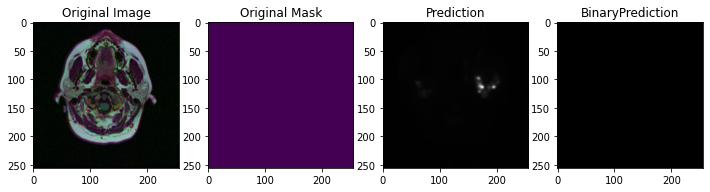

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


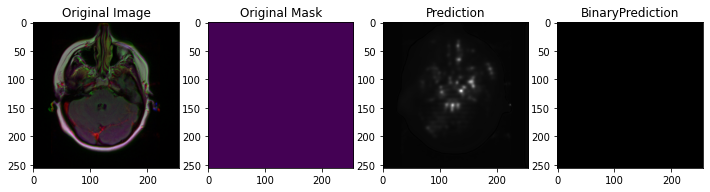

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


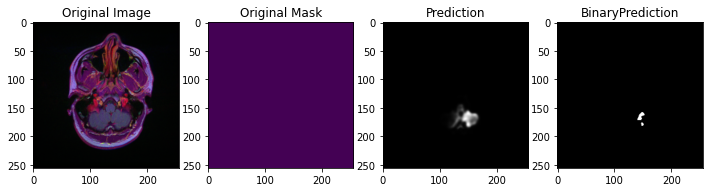

Pred Shape : (256, 256)
115.0
0 0 65421 115
confusion matrix: [[65421   115]
 [    0     0]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:78: RuntimeWarning: invalid value encountered in long_scalars


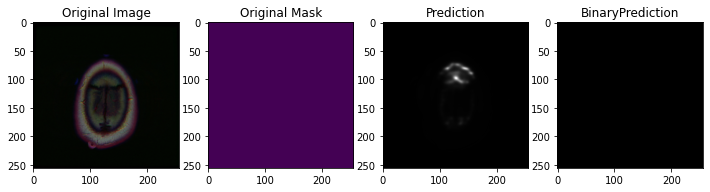

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


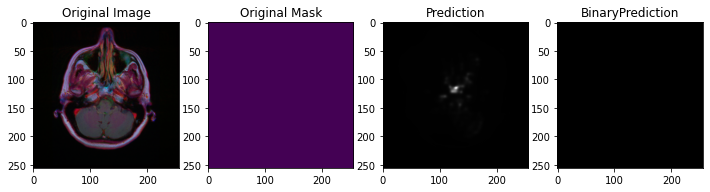

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


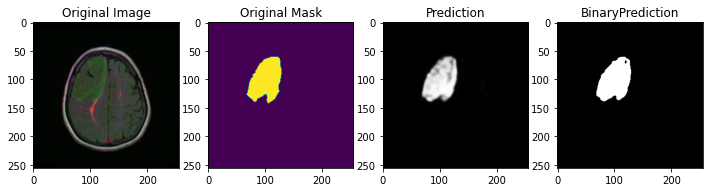

Pred Shape : (256, 256)
6708.0
3200 198 62028 110
confusion matrix: [[62028   110]
 [  198  3200]]


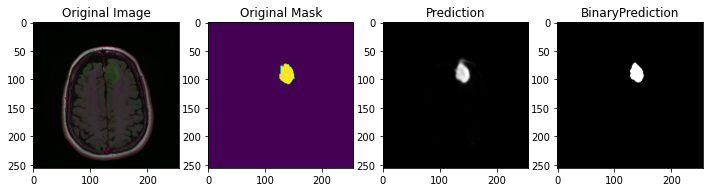

Pred Shape : (256, 256)
1286.0
559 139 64809 29
confusion matrix: [[64809    29]
 [  139   559]]


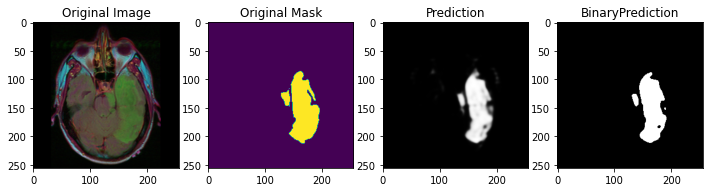

Pred Shape : (256, 256)
8790.0
3919 762 60665 190
confusion matrix: [[60665   190]
 [  762  3919]]


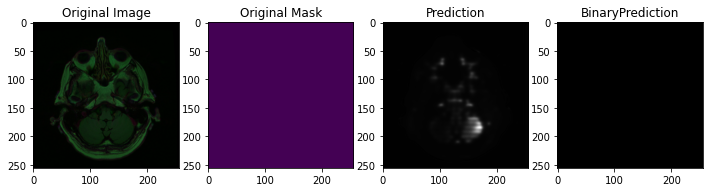

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


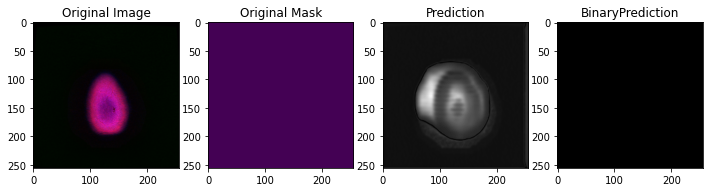

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


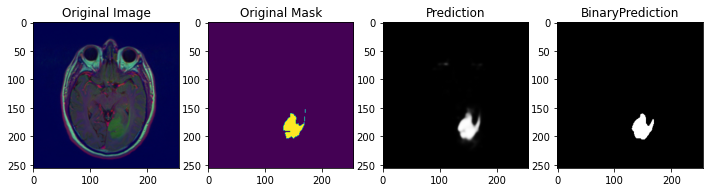

Pred Shape : (256, 256)
1968.0
880 44 64448 164
confusion matrix: [[64448   164]
 [   44   880]]


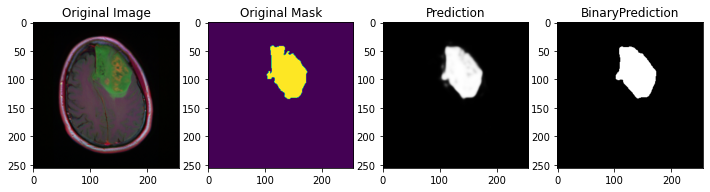

Pred Shape : (256, 256)
8482.0
4095 87 61149 205
confusion matrix: [[61149   205]
 [   87  4095]]


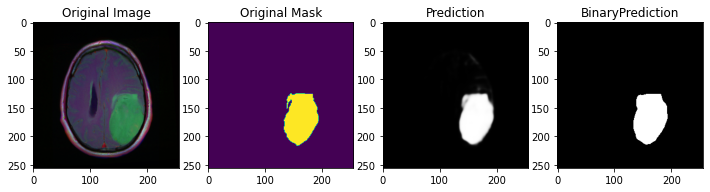

Pred Shape : (256, 256)
8363.0
4060 131 61233 112
confusion matrix: [[61233   112]
 [  131  4060]]


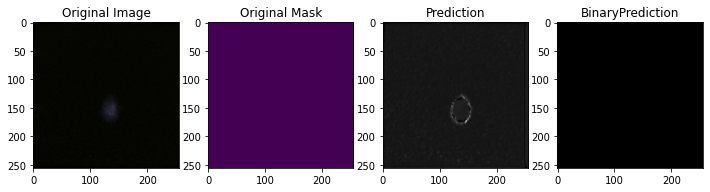

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


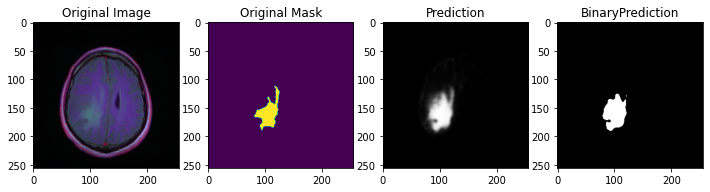

Pred Shape : (256, 256)
3187.0
1204 174 63553 605
confusion matrix: [[63553   605]
 [  174  1204]]


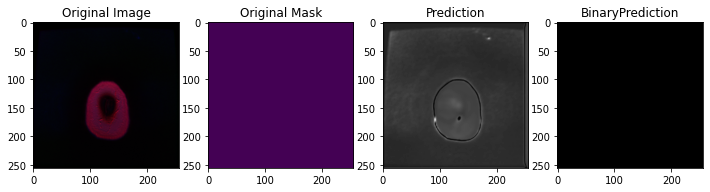

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


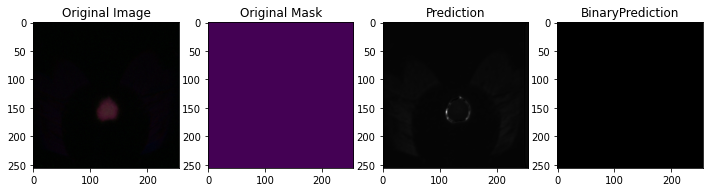

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


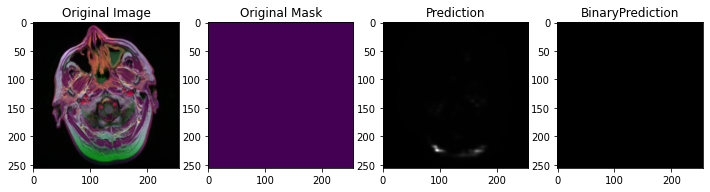

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


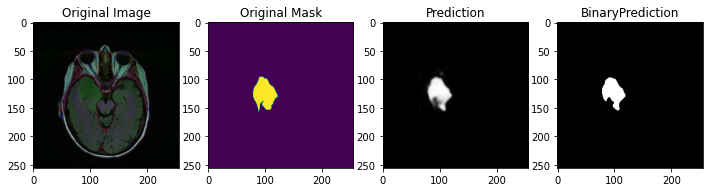

Pred Shape : (256, 256)
2999.0
1323 311 63860 42
confusion matrix: [[63860    42]
 [  311  1323]]


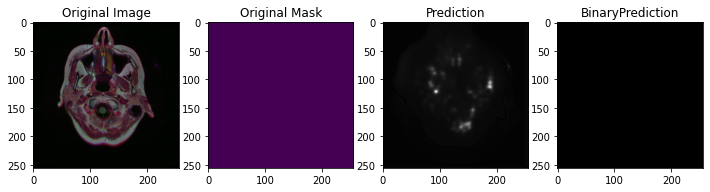

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


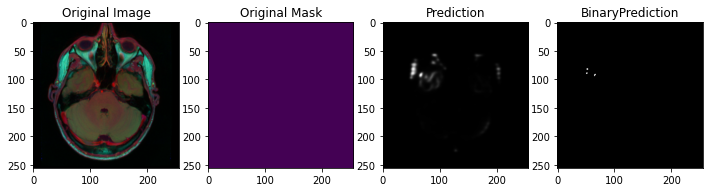

Pred Shape : (256, 256)
21.0
0 0 65515 21
confusion matrix: [[65515    21]
 [    0     0]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:78: RuntimeWarning: invalid value encountered in long_scalars


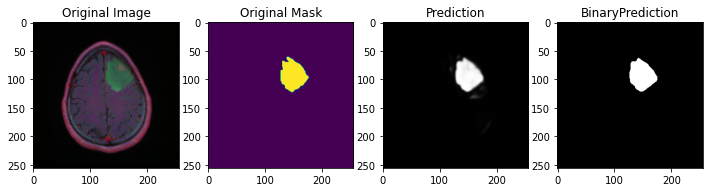

Pred Shape : (256, 256)
3913.0
1883 97 63506 50
confusion matrix: [[63506    50]
 [   97  1883]]


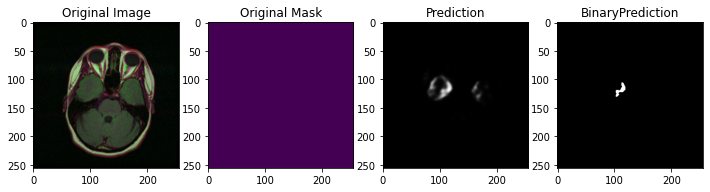

Pred Shape : (256, 256)
169.0
0 0 65367 169
confusion matrix: [[65367   169]
 [    0     0]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:78: RuntimeWarning: invalid value encountered in long_scalars


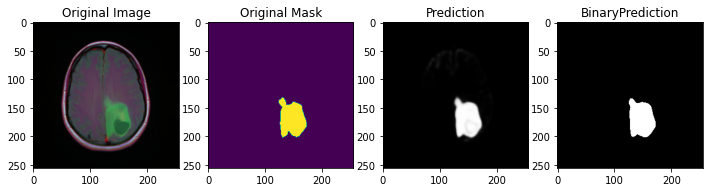

Pred Shape : (256, 256)
4831.0
2323 69 63028 116
confusion matrix: [[63028   116]
 [   69  2323]]


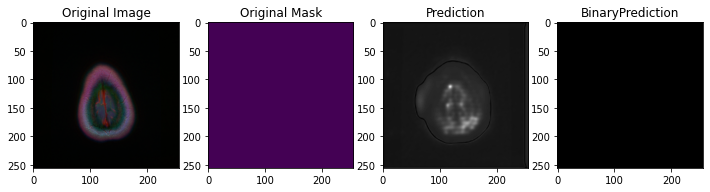

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


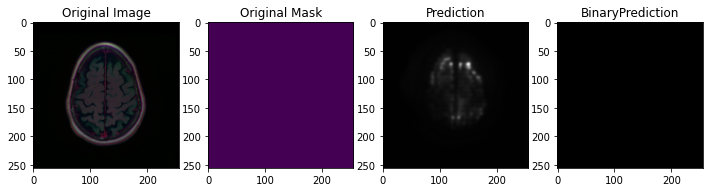

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


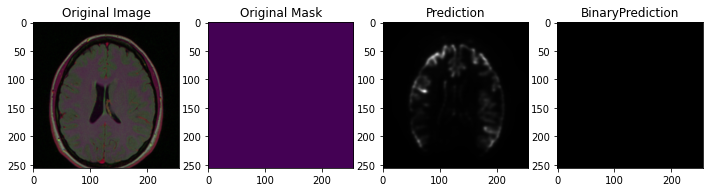

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


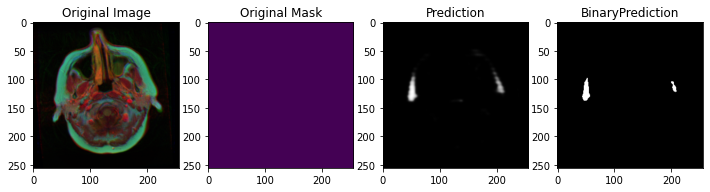

Pred Shape : (256, 256)
424.0
0 0 65112 424
confusion matrix: [[65112   424]
 [    0     0]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:78: RuntimeWarning: invalid value encountered in long_scalars


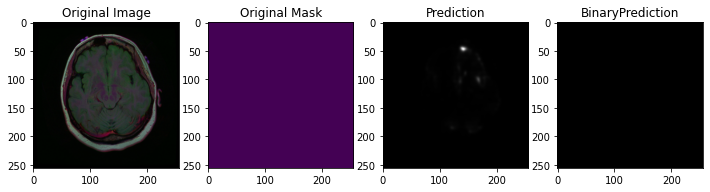

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


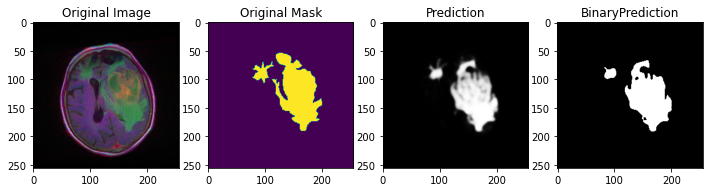

Pred Shape : (256, 256)
12780.0
5444 1384 58200 508
confusion matrix: [[58200   508]
 [ 1384  5444]]


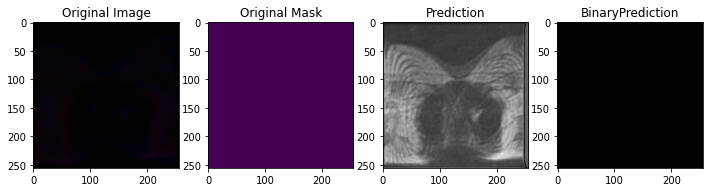

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


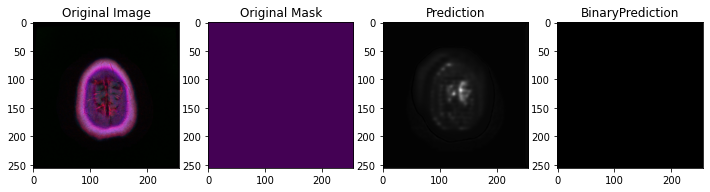

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


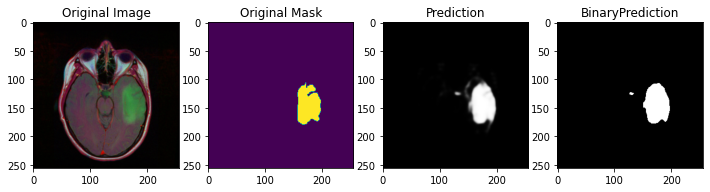

Pred Shape : (256, 256)
4799.0
2223 71 62960 282
confusion matrix: [[62960   282]
 [   71  2223]]


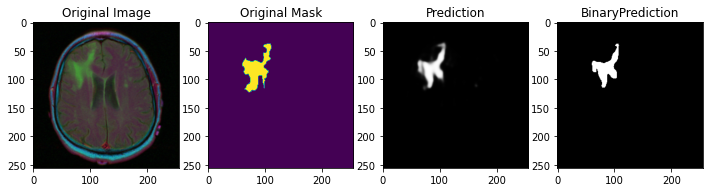

Pred Shape : (256, 256)
3225.0
1309 519 63620 88
confusion matrix: [[63620    88]
 [  519  1309]]


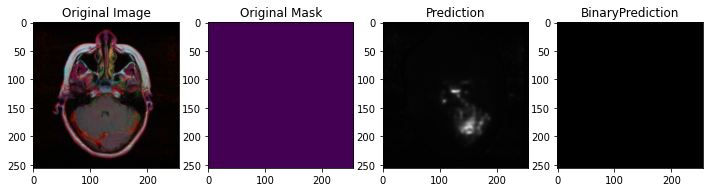

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


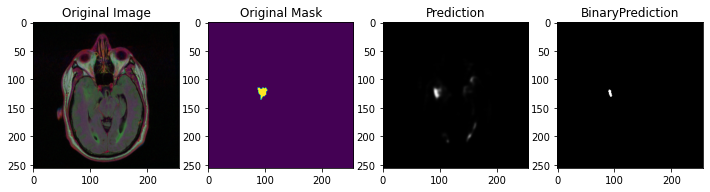

Pred Shape : (256, 256)
266.0
52 162 65322 0
confusion matrix: [[65322     0]
 [  162    52]]


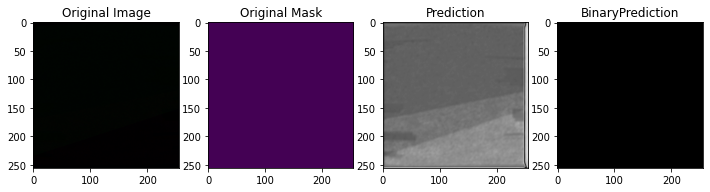

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


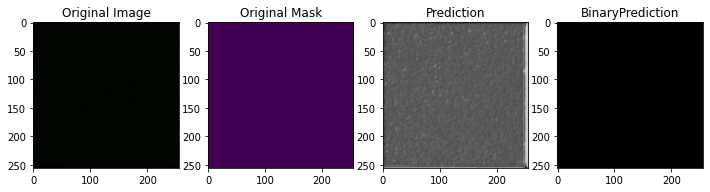

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


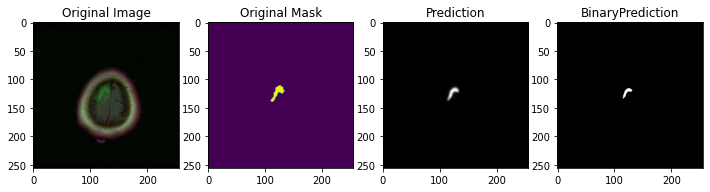

Pred Shape : (256, 256)
373.0
108 157 65271 0
confusion matrix: [[65271     0]
 [  157   108]]


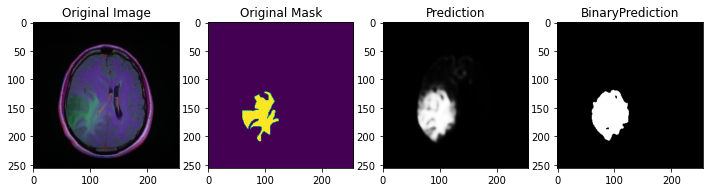

Pred Shape : (256, 256)
6448.0
2419 28 61507 1582
confusion matrix: [[61507  1582]
 [   28  2419]]


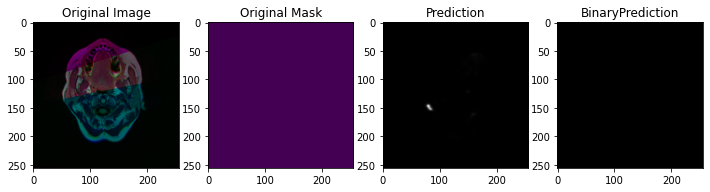

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


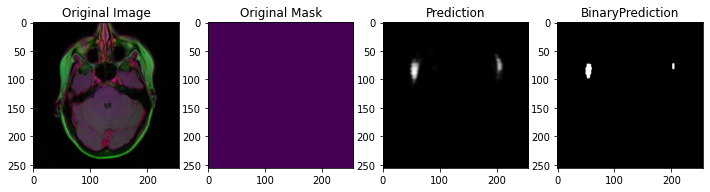

Pred Shape : (256, 256)
258.0
0 0 65278 258
confusion matrix: [[65278   258]
 [    0     0]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:78: RuntimeWarning: invalid value encountered in long_scalars


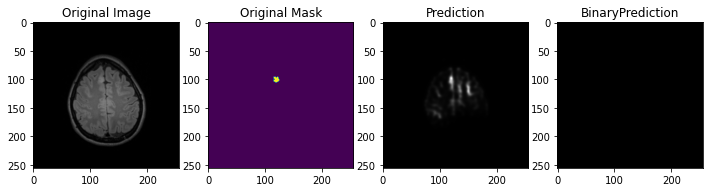

Pred Shape : (256, 256)
79.0
0 79 65457 0
confusion matrix: [[65457     0]
 [   79     0]]


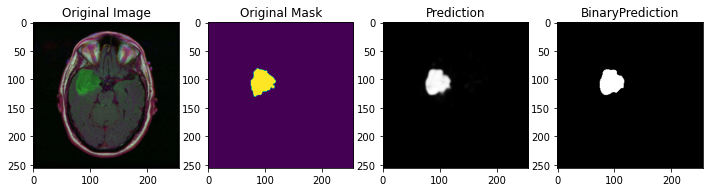

Pred Shape : (256, 256)
2872.0
1374 52 64038 72
confusion matrix: [[64038    72]
 [   52  1374]]


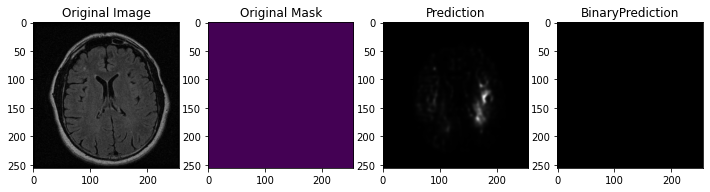

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


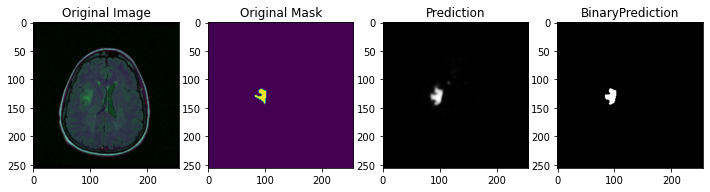

Pred Shape : (256, 256)
616.0
237 26 65157 116
confusion matrix: [[65157   116]
 [   26   237]]


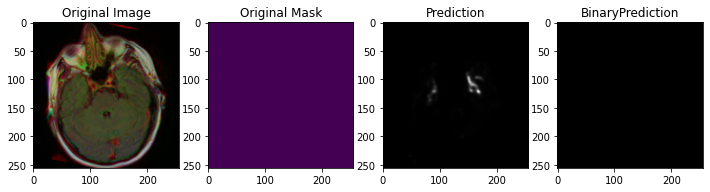

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


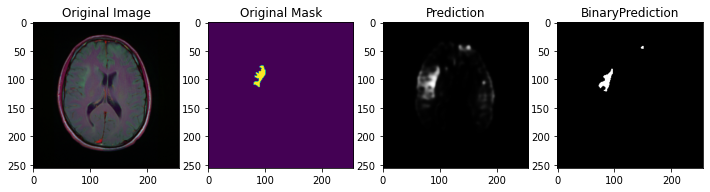

Pred Shape : (256, 256)
776.0
237 127 64997 175
confusion matrix: [[64997   175]
 [  127   237]]


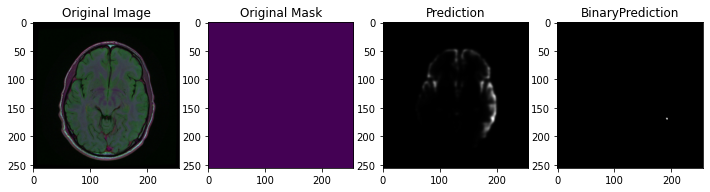

Pred Shape : (256, 256)
7.0
0 0 65529 7
confusion matrix: [[65529     7]
 [    0     0]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:78: RuntimeWarning: invalid value encountered in long_scalars


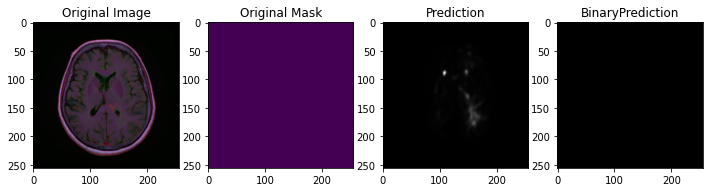

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


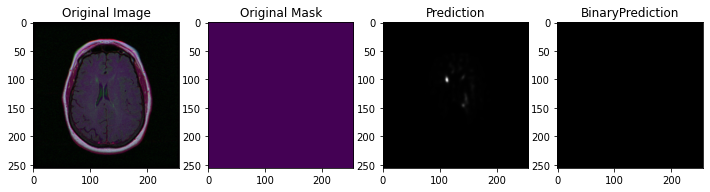

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


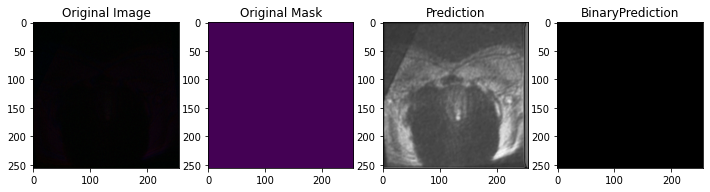

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


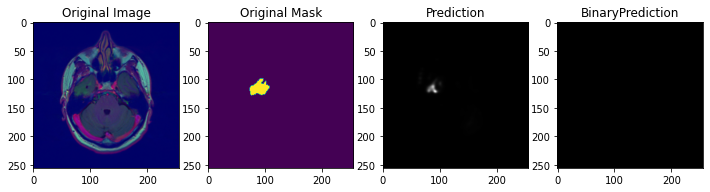

Pred Shape : (256, 256)
649.0
0 649 64887 0
confusion matrix: [[64887     0]
 [  649     0]]


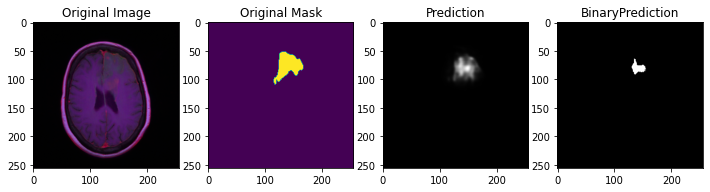

Pred Shape : (256, 256)
1839.0
323 1180 64020 13
confusion matrix: [[64020    13]
 [ 1180   323]]


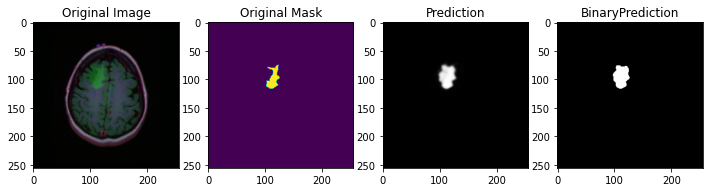

Pred Shape : (256, 256)
1410.0
513 15 64639 369
confusion matrix: [[64639   369]
 [   15   513]]


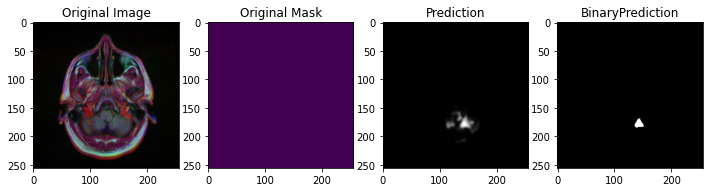

Pred Shape : (256, 256)
165.0
0 0 65371 165
confusion matrix: [[65371   165]
 [    0     0]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:78: RuntimeWarning: invalid value encountered in long_scalars


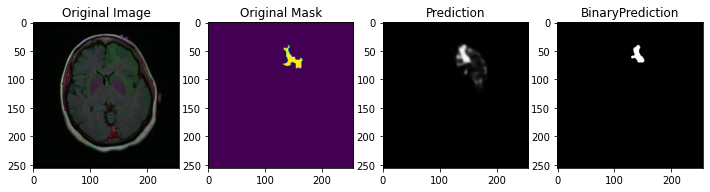

Pred Shape : (256, 256)
850.0
240 256 64926 114
confusion matrix: [[64926   114]
 [  256   240]]


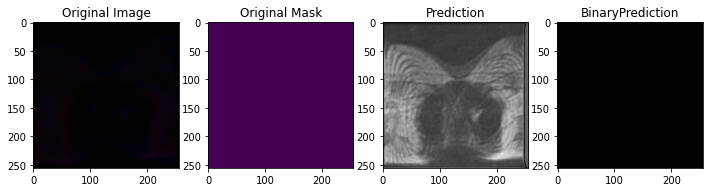

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


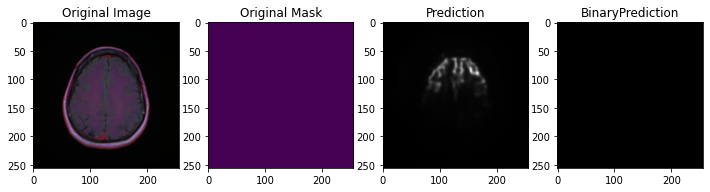

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


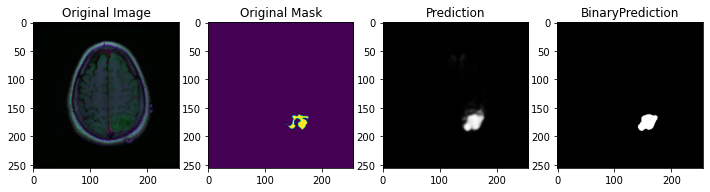

Pred Shape : (256, 256)
1102.0
395 25 64829 287
confusion matrix: [[64829   287]
 [   25   395]]


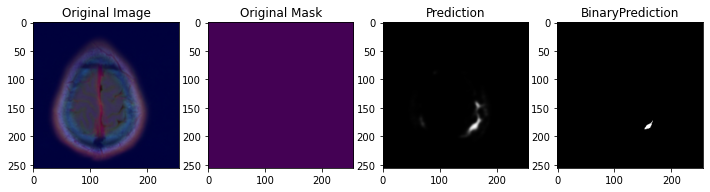

Pred Shape : (256, 256)
79.0
0 0 65457 79
confusion matrix: [[65457    79]
 [    0     0]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:78: RuntimeWarning: invalid value encountered in long_scalars


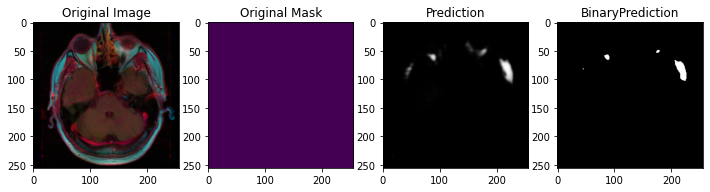

Pred Shape : (256, 256)
511.0
0 0 65025 511
confusion matrix: [[65025   511]
 [    0     0]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:78: RuntimeWarning: invalid value encountered in long_scalars


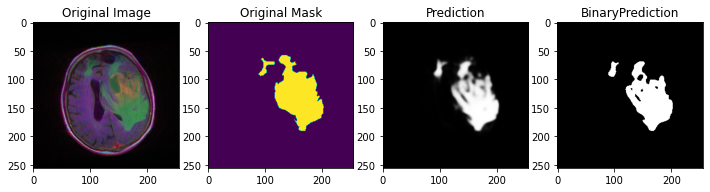

Pred Shape : (256, 256)
12193.0
5308 1339 58651 238
confusion matrix: [[58651   238]
 [ 1339  5308]]


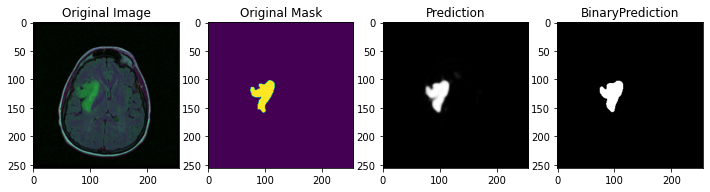

Pred Shape : (256, 256)
2531.0
1176 53 64181 126
confusion matrix: [[64181   126]
 [   53  1176]]


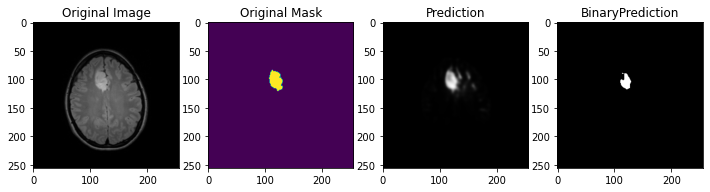

Pred Shape : (256, 256)
942.0
330 281 64924 1
confusion matrix: [[64924     1]
 [  281   330]]


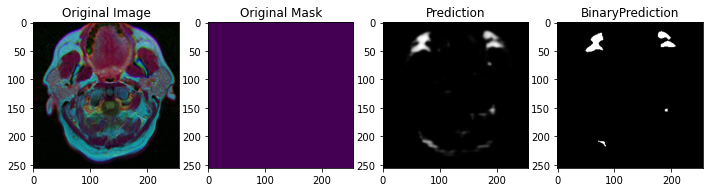

Pred Shape : (256, 256)
1010.0
0 0 64526 1010
confusion matrix: [[64526  1010]
 [    0     0]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:78: RuntimeWarning: invalid value encountered in long_scalars


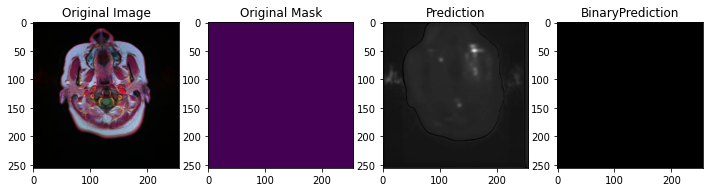

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


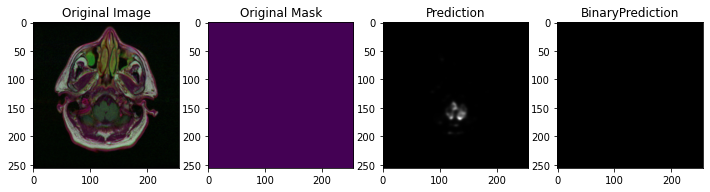

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


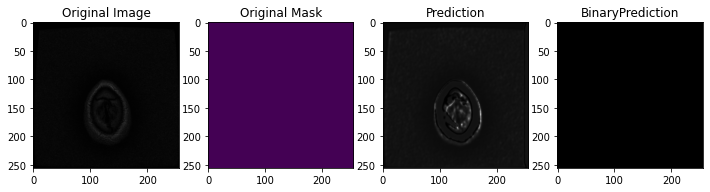

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


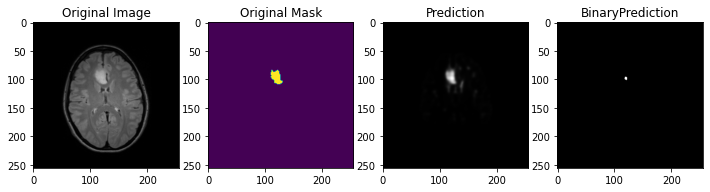

Pred Shape : (256, 256)
363.0
21 321 65194 0
confusion matrix: [[65194     0]
 [  321    21]]


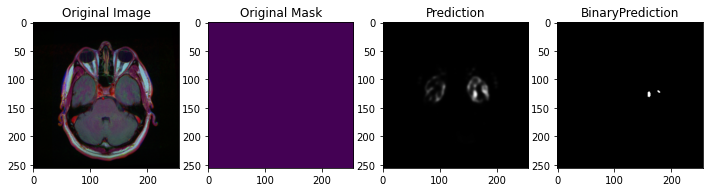

Pred Shape : (256, 256)
56.0
0 0 65480 56
confusion matrix: [[65480    56]
 [    0     0]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:78: RuntimeWarning: invalid value encountered in long_scalars


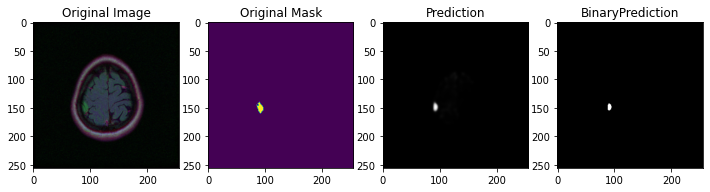

Pred Shape : (256, 256)
198.0
62 71 65400 3
confusion matrix: [[65400     3]
 [   71    62]]


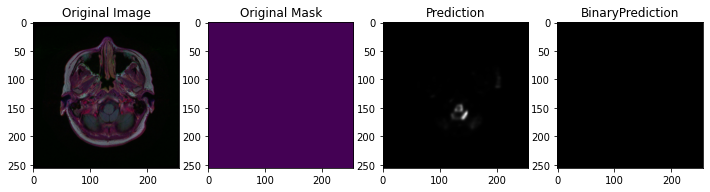

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


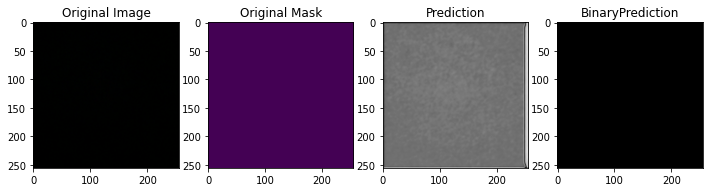

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


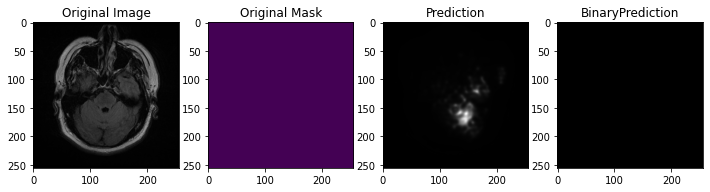

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


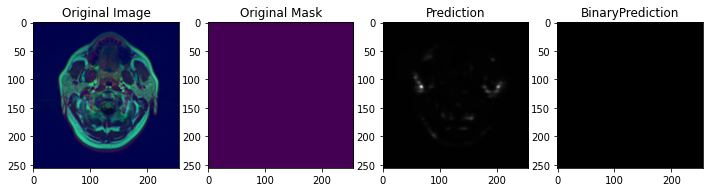

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


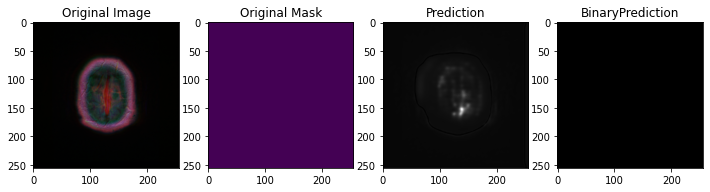

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


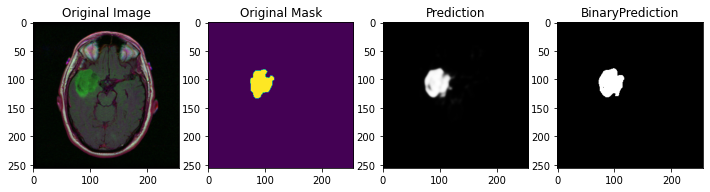

Pred Shape : (256, 256)
3058.0
1382 29 63860 265
confusion matrix: [[63860   265]
 [   29  1382]]


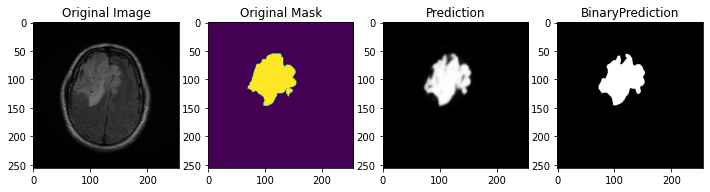

Pred Shape : (256, 256)
8982.0
4131 596 60685 124
confusion matrix: [[60685   124]
 [  596  4131]]


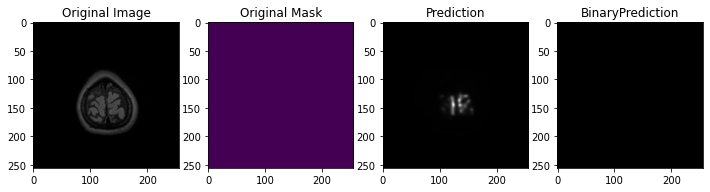

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


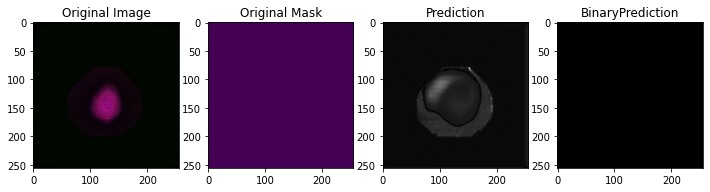

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


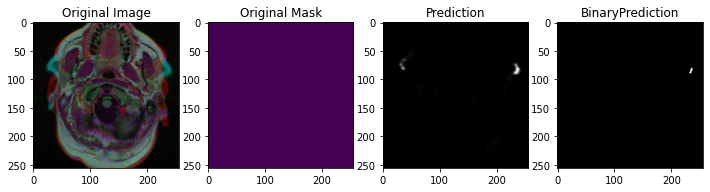

Pred Shape : (256, 256)
30.0
0 0 65506 30
confusion matrix: [[65506    30]
 [    0     0]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:78: RuntimeWarning: invalid value encountered in long_scalars


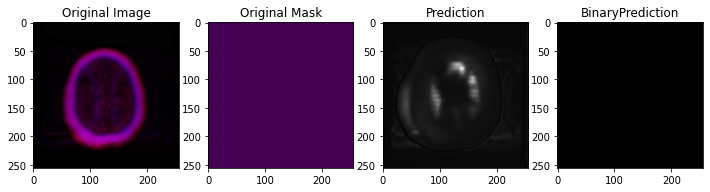

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


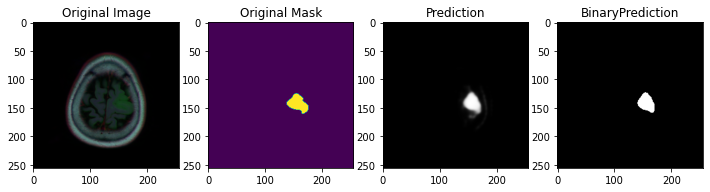

Pred Shape : (256, 256)
1498.0
667 117 64705 47
confusion matrix: [[64705    47]
 [  117   667]]


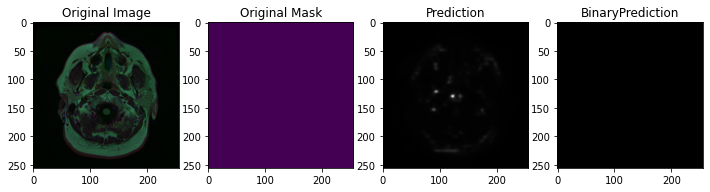

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


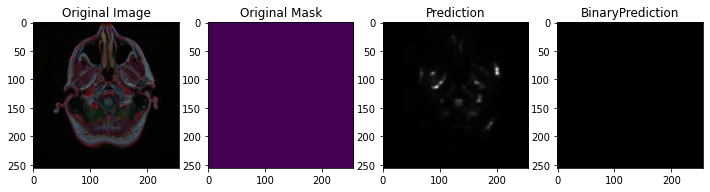

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


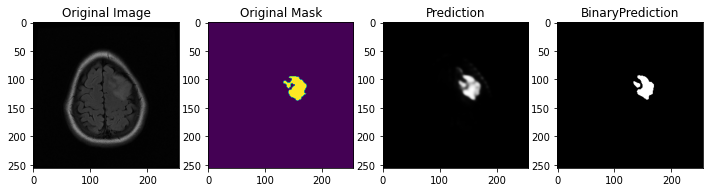

Pred Shape : (256, 256)
1836.0
797 191 64497 51
confusion matrix: [[64497    51]
 [  191   797]]


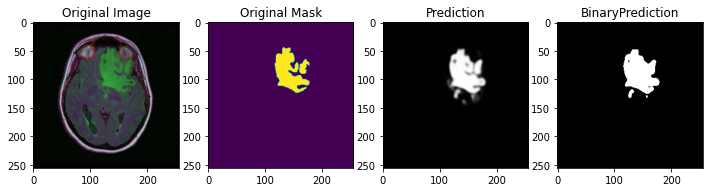

Pred Shape : (256, 256)
6040.0
2628 157 62124 627
confusion matrix: [[62124   627]
 [  157  2628]]


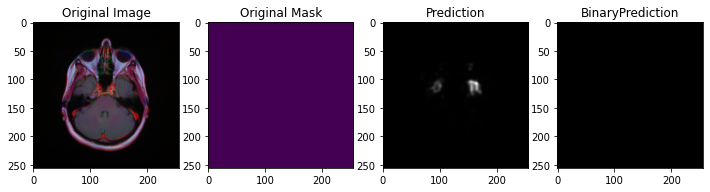

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


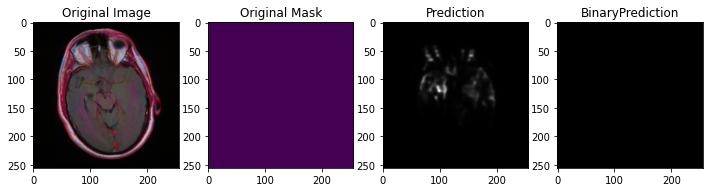

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


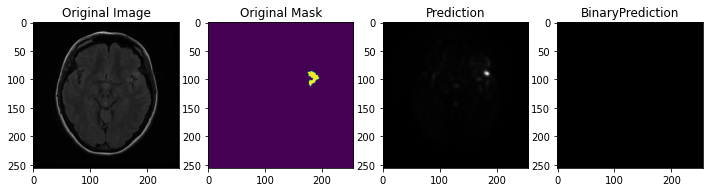

Pred Shape : (256, 256)
267.0
0 267 65269 0
confusion matrix: [[65269     0]
 [  267     0]]


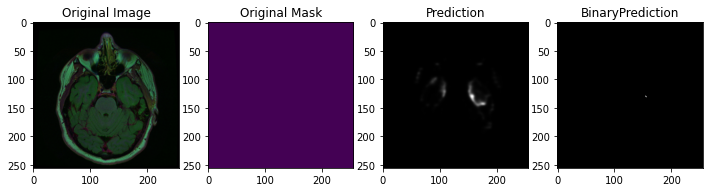

Pred Shape : (256, 256)
4.0
0 0 65532 4
confusion matrix: [[65532     4]
 [    0     0]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:78: RuntimeWarning: invalid value encountered in long_scalars


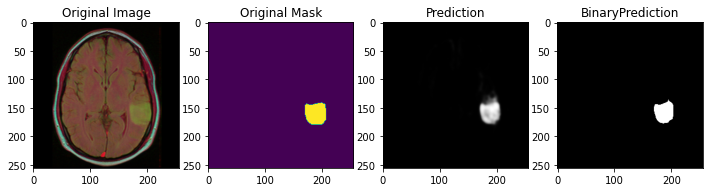

Pred Shape : (256, 256)
2292.0
1010 237 64254 35
confusion matrix: [[64254    35]
 [  237  1010]]


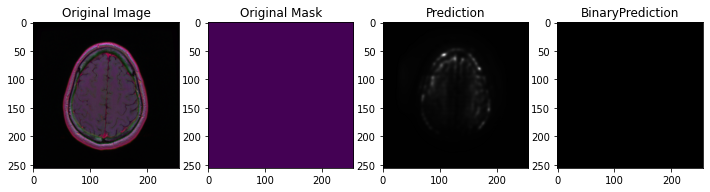

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


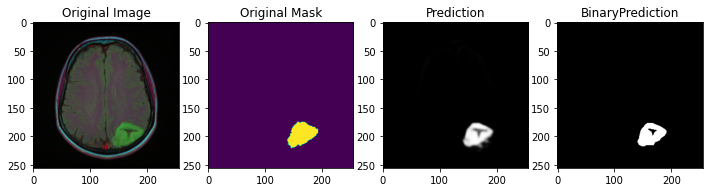

Pred Shape : (256, 256)
2908.0
1319 246 63947 24
confusion matrix: [[63947    24]
 [  246  1319]]


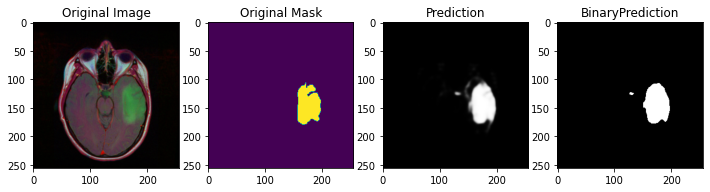

Pred Shape : (256, 256)
4799.0
2223 71 62960 282
confusion matrix: [[62960   282]
 [   71  2223]]


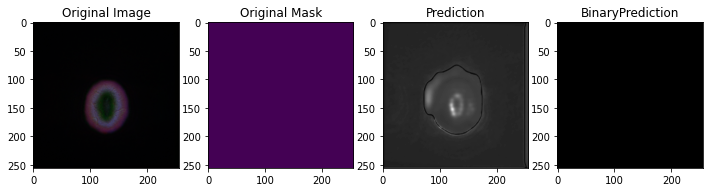

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


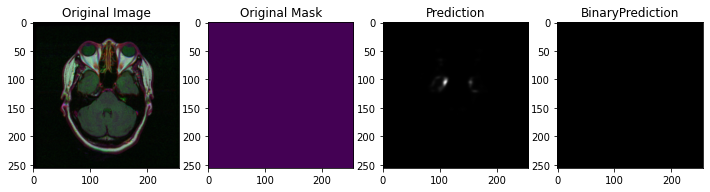

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


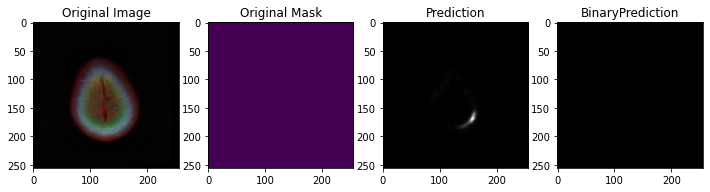

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


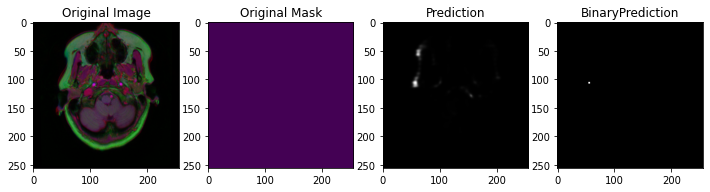

Pred Shape : (256, 256)
9.0
0 0 65527 9
confusion matrix: [[65527     9]
 [    0     0]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:78: RuntimeWarning: invalid value encountered in long_scalars


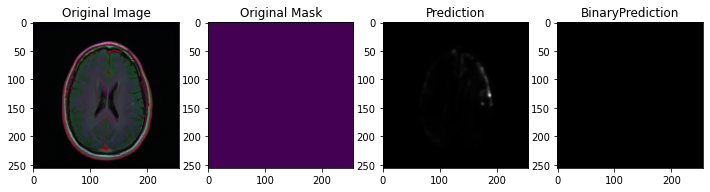

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


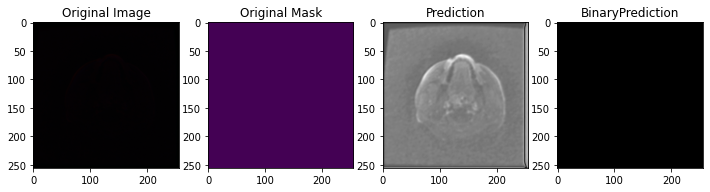

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


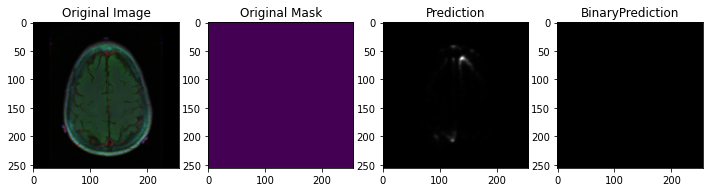

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


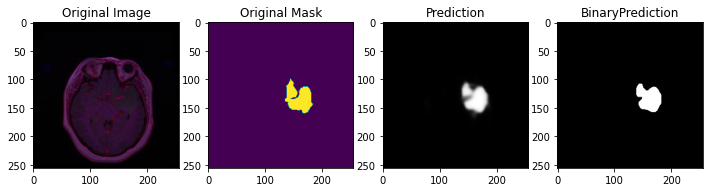

Pred Shape : (256, 256)
3276.0
1446 284 63706 100
confusion matrix: [[63706   100]
 [  284  1446]]


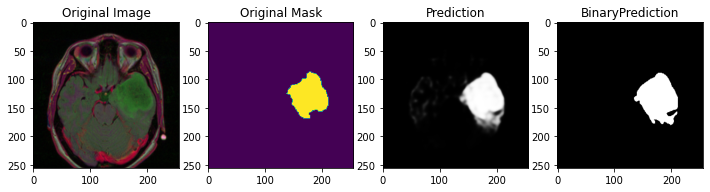

Pred Shape : (256, 256)
8141.0
3599 63 60994 880
confusion matrix: [[60994   880]
 [   63  3599]]


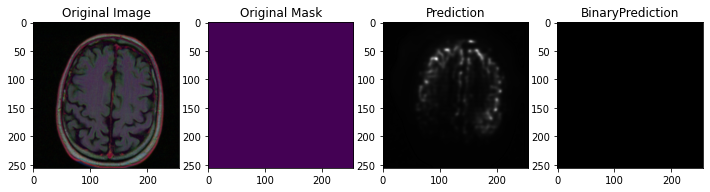

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


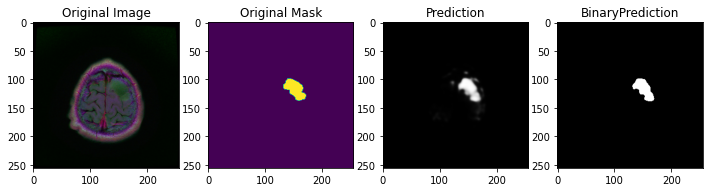

Pred Shape : (256, 256)
1734.0
789 114 64591 42
confusion matrix: [[64591    42]
 [  114   789]]


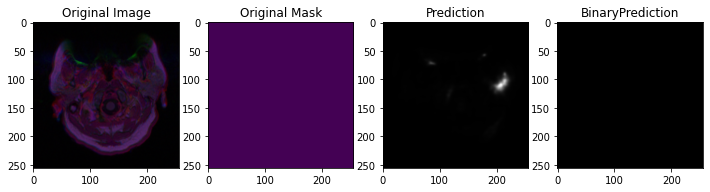

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


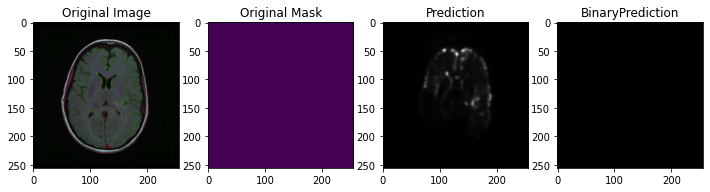

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


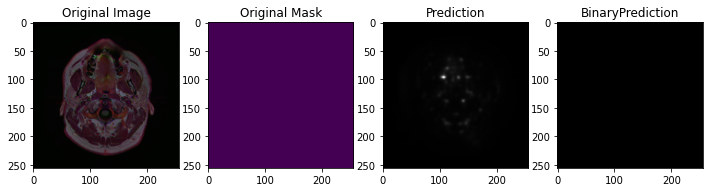

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


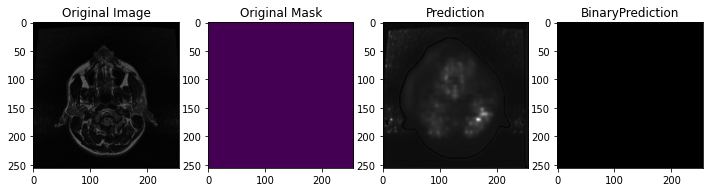

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


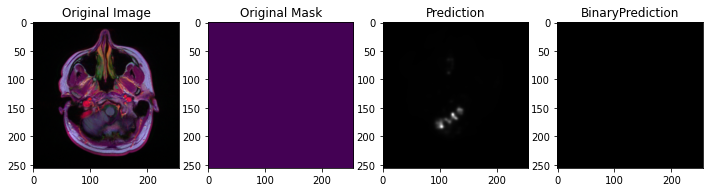

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


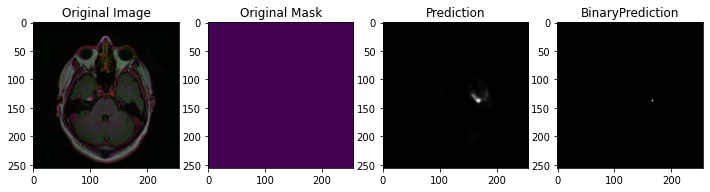

Pred Shape : (256, 256)
6.0
0 0 65530 6
confusion matrix: [[65530     6]
 [    0     0]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:78: RuntimeWarning: invalid value encountered in long_scalars


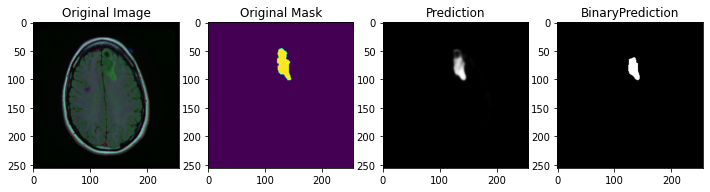

Pred Shape : (256, 256)
1418.0
523 354 64641 18
confusion matrix: [[64641    18]
 [  354   523]]


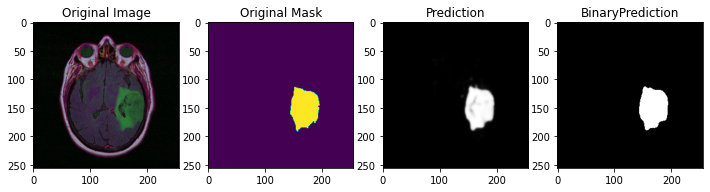

Pred Shape : (256, 256)
5790.0
2803 60 62549 124
confusion matrix: [[62549   124]
 [   60  2803]]


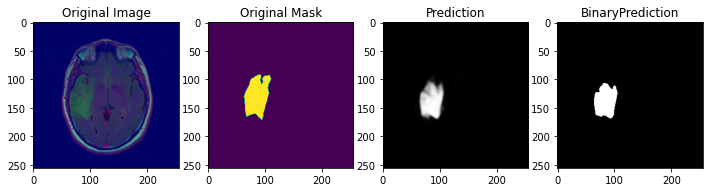

Pred Shape : (256, 256)
4425.0
1822 700 62933 81
confusion matrix: [[62933    81]
 [  700  1822]]


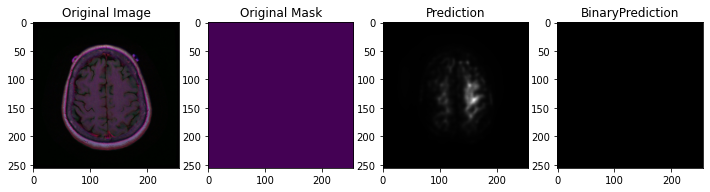

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


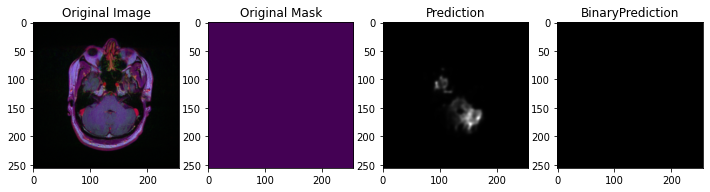

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


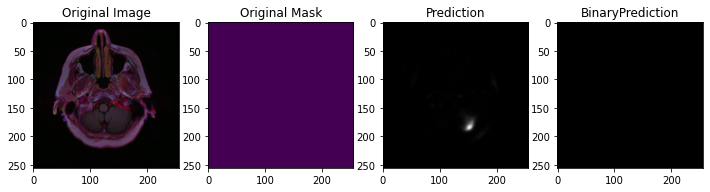

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


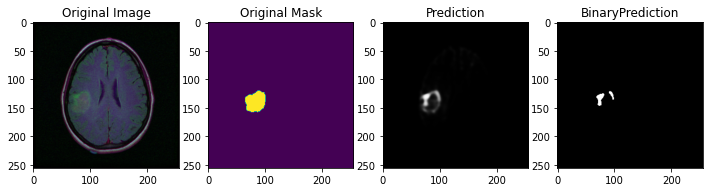

Pred Shape : (256, 256)
1288.0
223 833 64471 9
confusion matrix: [[64471     9]
 [  833   223]]


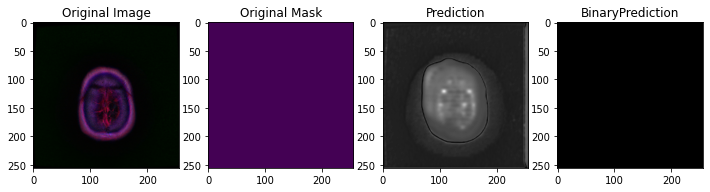

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


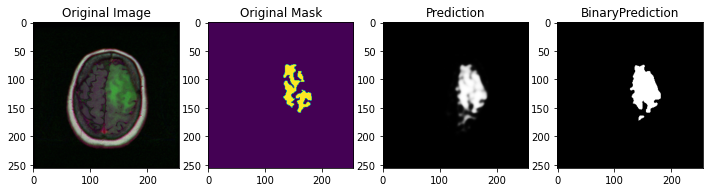

Pred Shape : (256, 256)
4669.0
1752 111 62619 1054
confusion matrix: [[62619  1054]
 [  111  1752]]


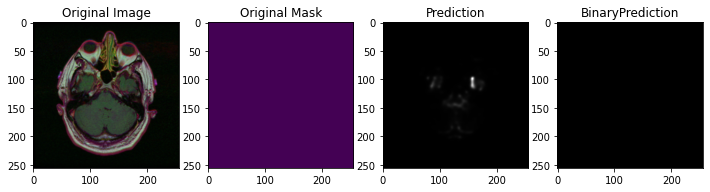

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


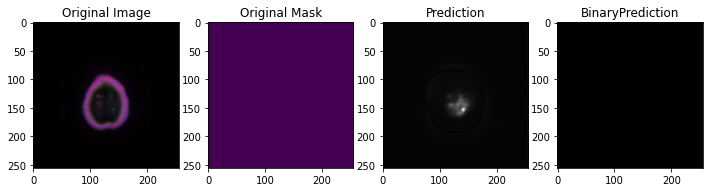

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


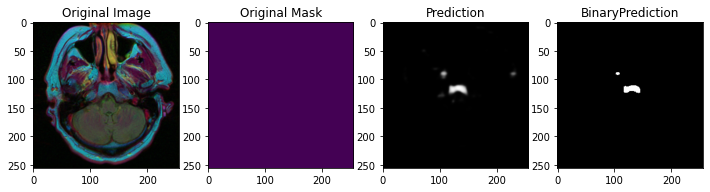

Pred Shape : (256, 256)
333.0
0 0 65203 333
confusion matrix: [[65203   333]
 [    0     0]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:78: RuntimeWarning: invalid value encountered in long_scalars


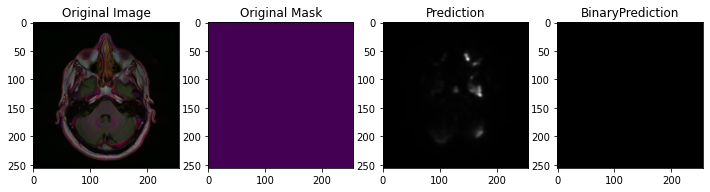

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


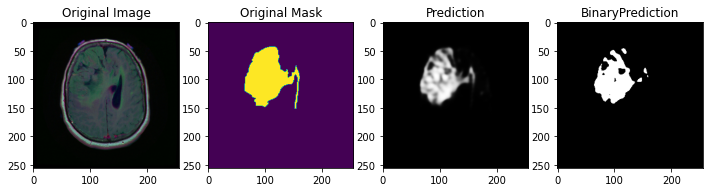

Pred Shape : (256, 256)
9599.0
3806 1973 59743 14
confusion matrix: [[59743    14]
 [ 1973  3806]]


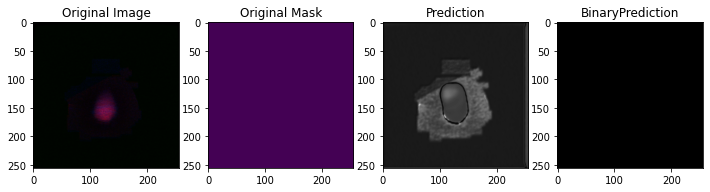

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


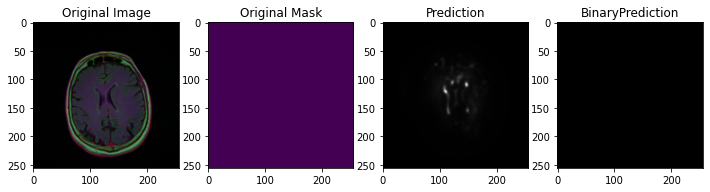

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


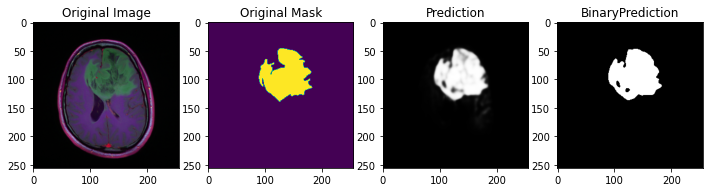

Pred Shape : (256, 256)
10933.0
5116 217 59719 484
confusion matrix: [[59719   484]
 [  217  5116]]


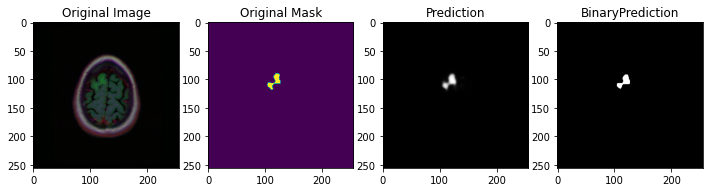

Pred Shape : (256, 256)
525.0
218 46 65229 43
confusion matrix: [[65229    43]
 [   46   218]]


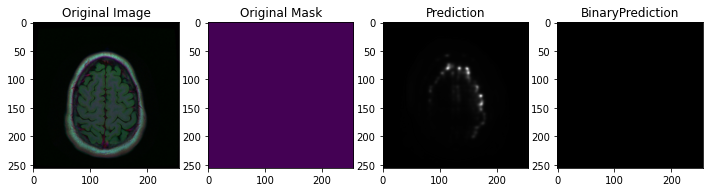

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


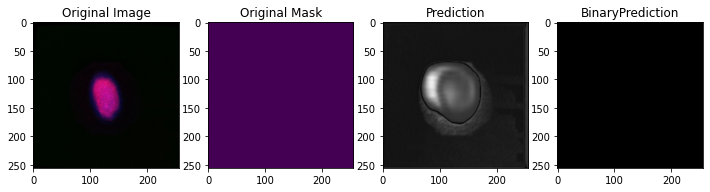

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


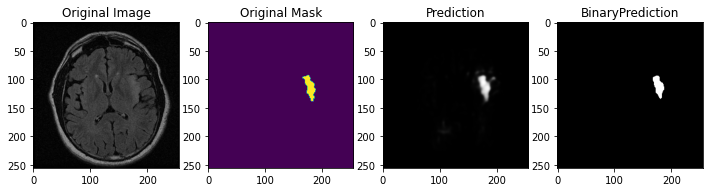

Pred Shape : (256, 256)
989.0
435 82 64982 37
confusion matrix: [[64982    37]
 [   82   435]]


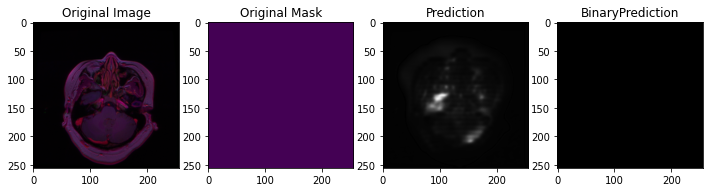

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


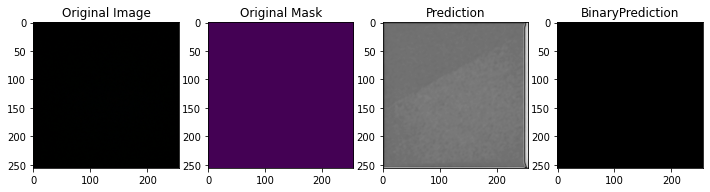

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


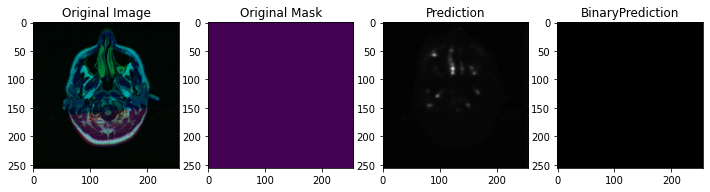

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


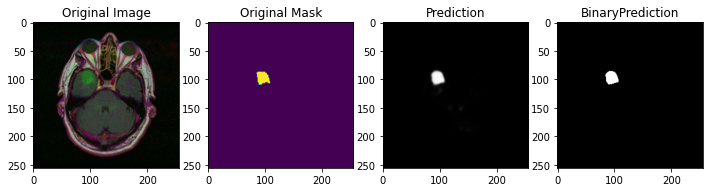

Pred Shape : (256, 256)
816.0
380 21 65100 35
confusion matrix: [[65100    35]
 [   21   380]]


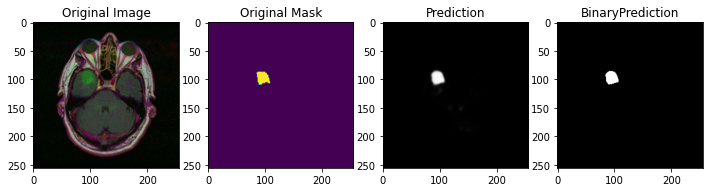

Pred Shape : (256, 256)
816.0
380 21 65100 35
confusion matrix: [[65100    35]
 [   21   380]]


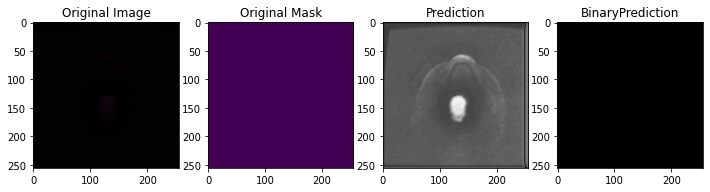

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


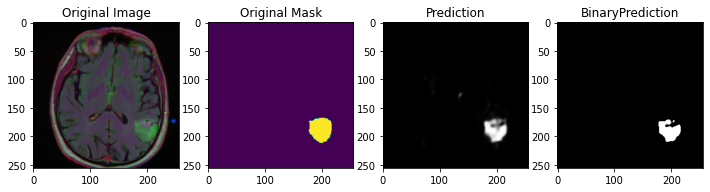

Pred Shape : (256, 256)
2371.0
979 409 64144 4
confusion matrix: [[64144     4]
 [  409   979]]


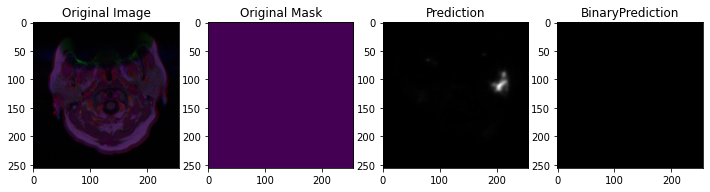

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


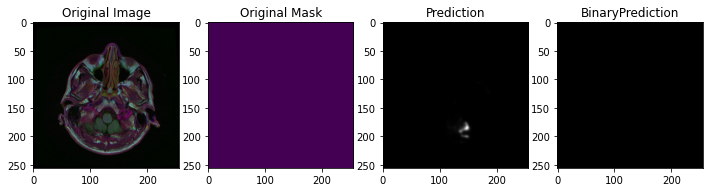

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


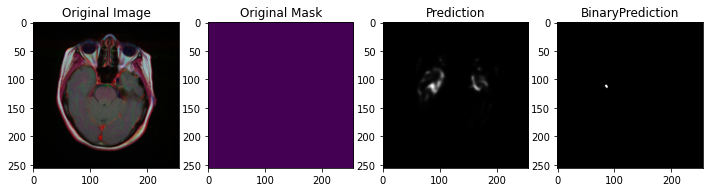

Pred Shape : (256, 256)
20.0
0 0 65516 20
confusion matrix: [[65516    20]
 [    0     0]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:78: RuntimeWarning: invalid value encountered in long_scalars


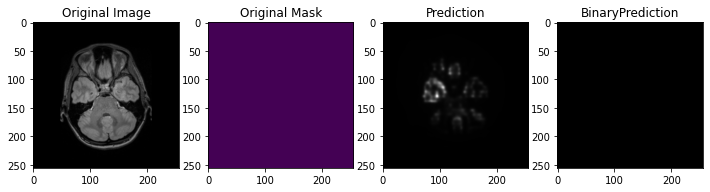

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


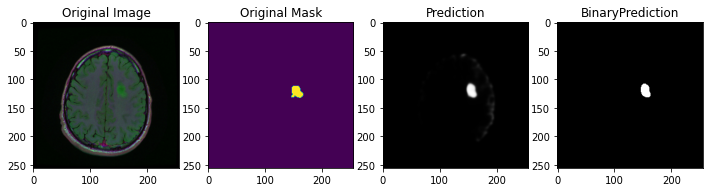

Pred Shape : (256, 256)
644.0
274 53 65166 43
confusion matrix: [[65166    43]
 [   53   274]]


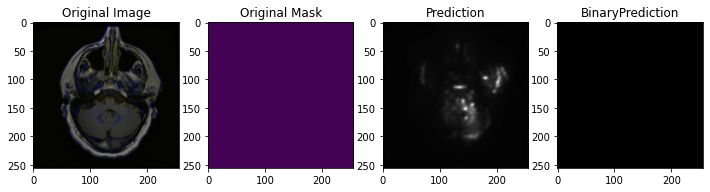

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


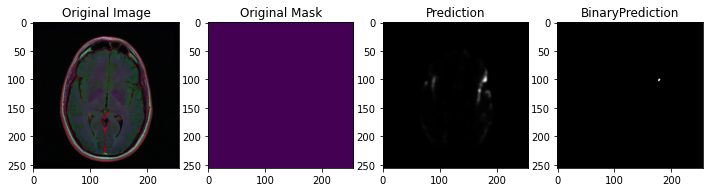

Pred Shape : (256, 256)
12.0
0 0 65524 12
confusion matrix: [[65524    12]
 [    0     0]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:78: RuntimeWarning: invalid value encountered in long_scalars


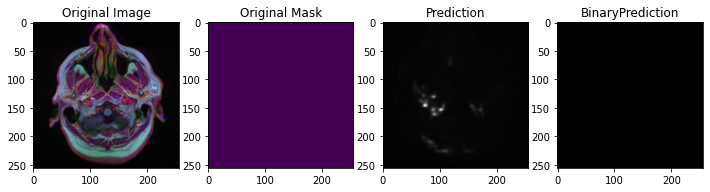

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


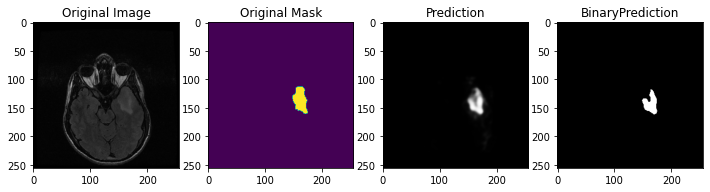

Pred Shape : (256, 256)
1498.0
553 300 64591 92
confusion matrix: [[64591    92]
 [  300   553]]


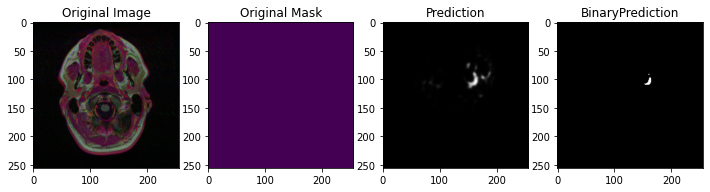

Pred Shape : (256, 256)
73.0
0 0 65463 73
confusion matrix: [[65463    73]
 [    0     0]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:78: RuntimeWarning: invalid value encountered in long_scalars


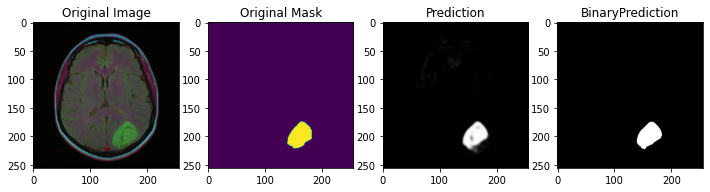

Pred Shape : (256, 256)
2702.0
1298 72 64132 34
confusion matrix: [[64132    34]
 [   72  1298]]


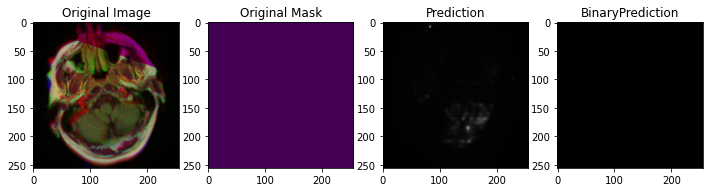

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


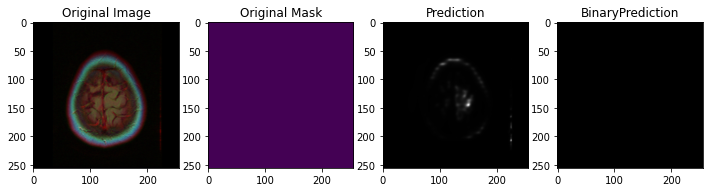

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


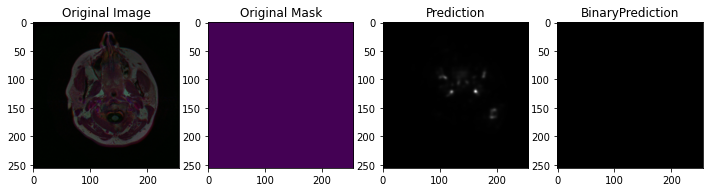

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


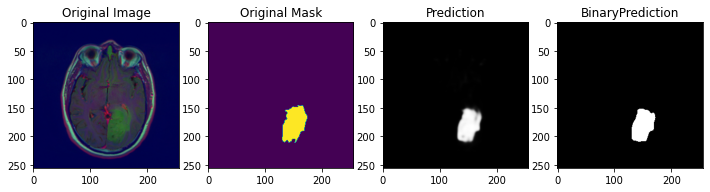

Pred Shape : (256, 256)
3765.0
1725 276 63496 39
confusion matrix: [[63496    39]
 [  276  1725]]


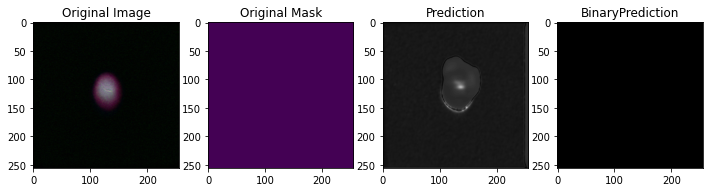

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


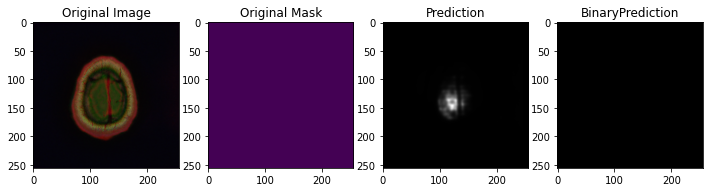

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


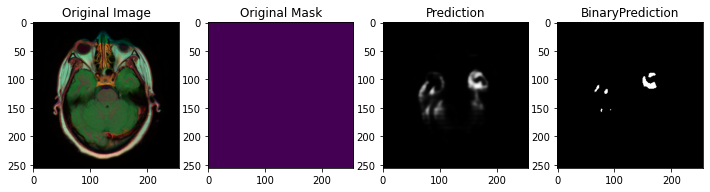

Pred Shape : (256, 256)
437.0
0 0 65099 437
confusion matrix: [[65099   437]
 [    0     0]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:78: RuntimeWarning: invalid value encountered in long_scalars


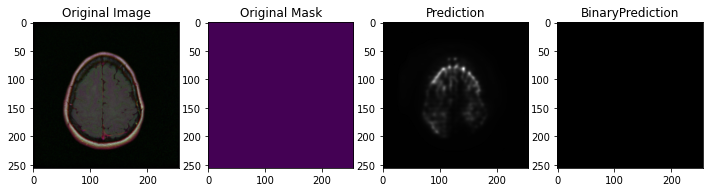

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


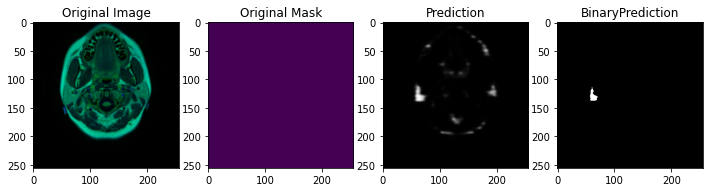

Pred Shape : (256, 256)
166.0
0 0 65370 166
confusion matrix: [[65370   166]
 [    0     0]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:78: RuntimeWarning: invalid value encountered in long_scalars


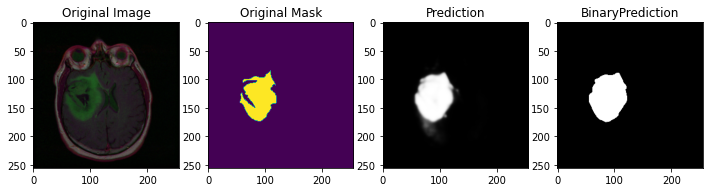

Pred Shape : (256, 256)
7643.0
3375 34 61268 859
confusion matrix: [[61268   859]
 [   34  3375]]


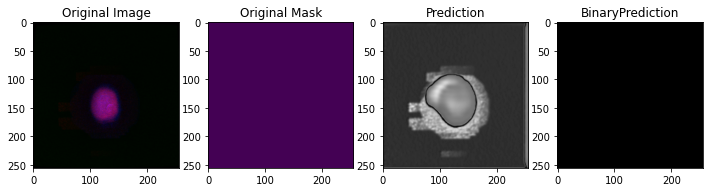

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


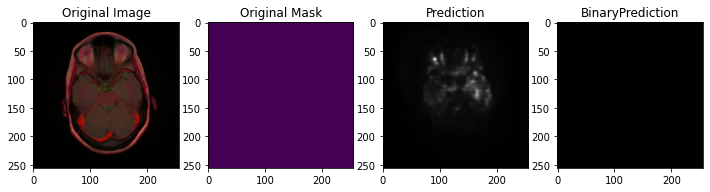

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


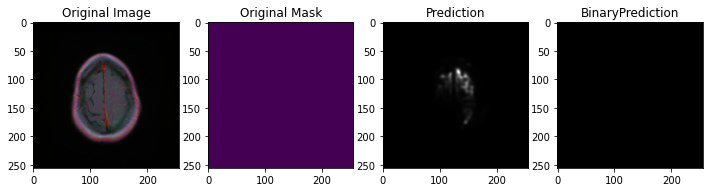

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


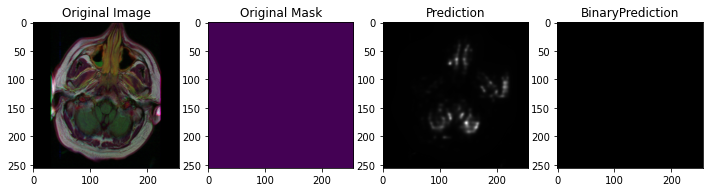

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


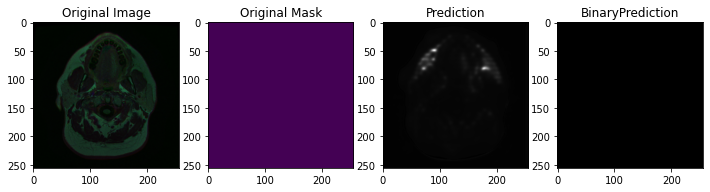

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


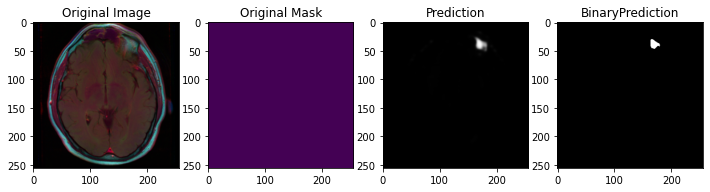

Pred Shape : (256, 256)
180.0
0 0 65356 180
confusion matrix: [[65356   180]
 [    0     0]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:78: RuntimeWarning: invalid value encountered in long_scalars


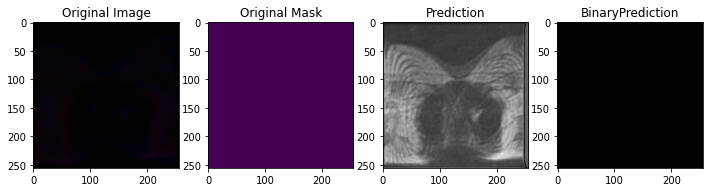

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


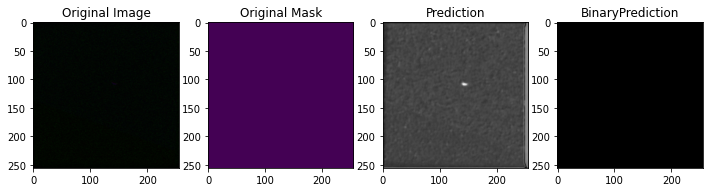

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


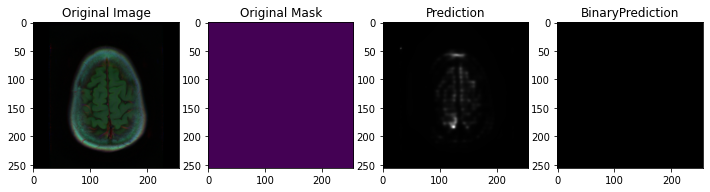

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


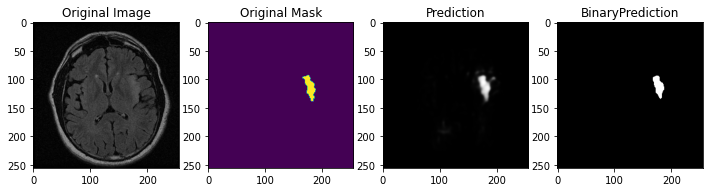

Pred Shape : (256, 256)
989.0
435 82 64982 37
confusion matrix: [[64982    37]
 [   82   435]]


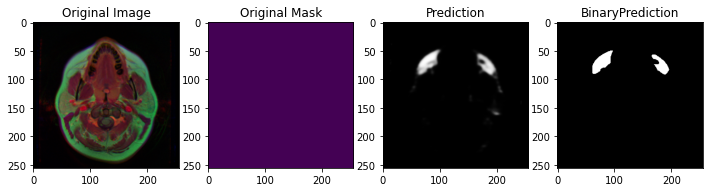

Pred Shape : (256, 256)
1284.0
0 0 64252 1284
confusion matrix: [[64252  1284]
 [    0     0]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:78: RuntimeWarning: invalid value encountered in long_scalars


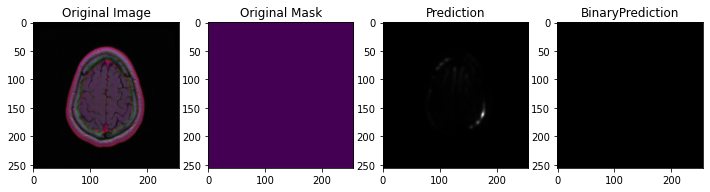

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


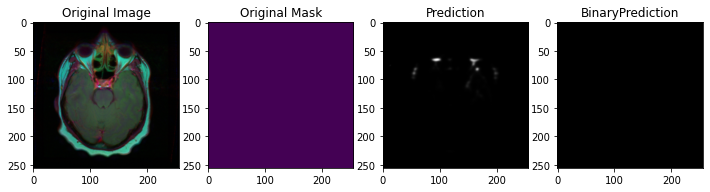

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


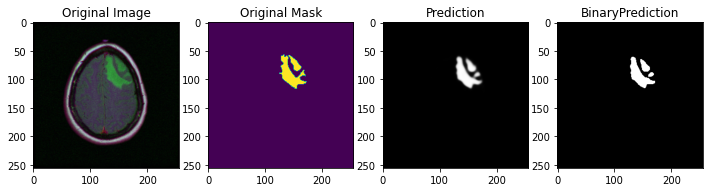

Pred Shape : (256, 256)
2569.0
1146 194 64113 83
confusion matrix: [[64113    83]
 [  194  1146]]


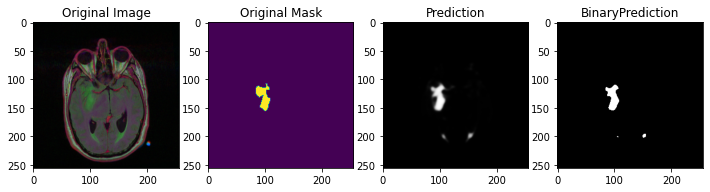

Pred Shape : (256, 256)
1322.0
557 97 64771 111
confusion matrix: [[64771   111]
 [   97   557]]


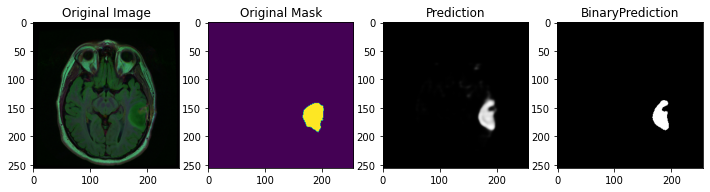

Pred Shape : (256, 256)
2317.0
913 418 64132 73
confusion matrix: [[64132    73]
 [  418   913]]


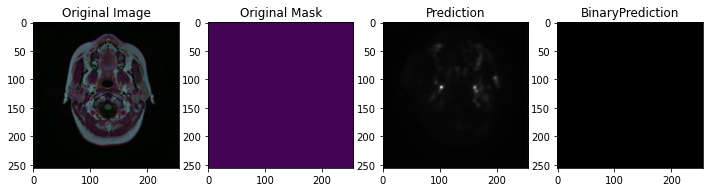

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


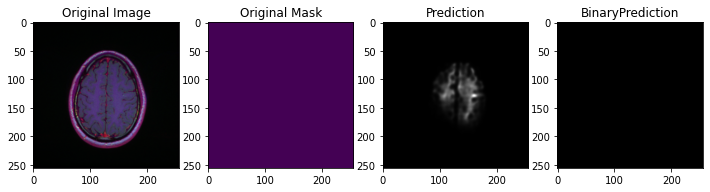

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


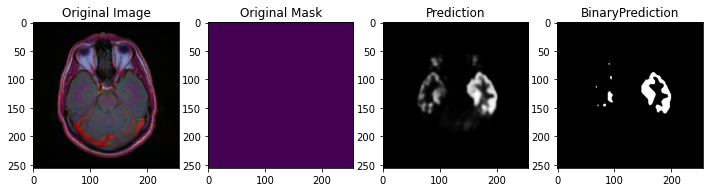

Pred Shape : (256, 256)
1767.0
0 0 63769 1767
confusion matrix: [[63769  1767]
 [    0     0]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:78: RuntimeWarning: invalid value encountered in long_scalars


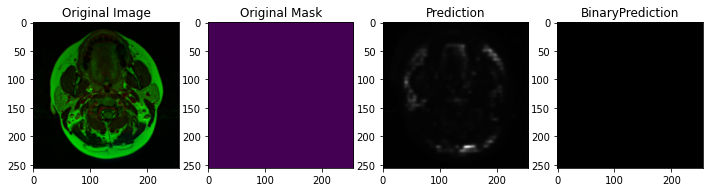

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


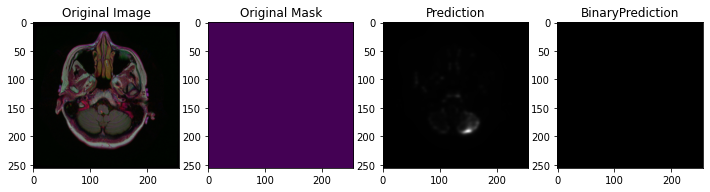

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


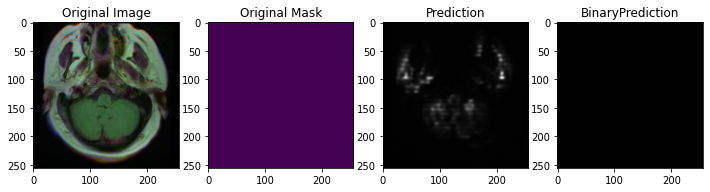

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


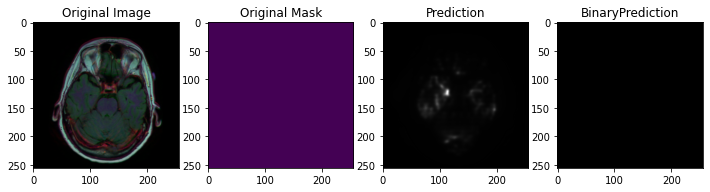

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


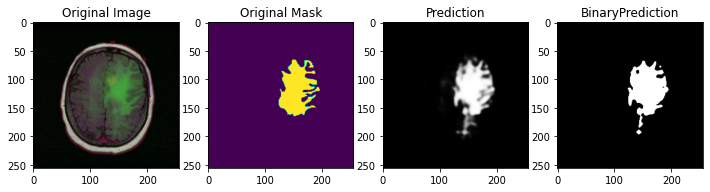

Pred Shape : (256, 256)
8708.0
3647 480 60475 934
confusion matrix: [[60475   934]
 [  480  3647]]


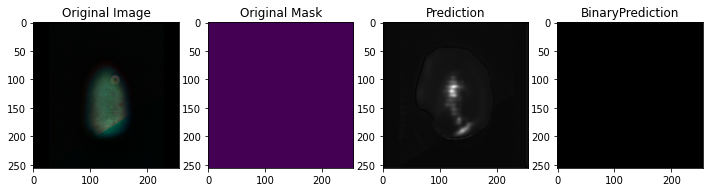

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


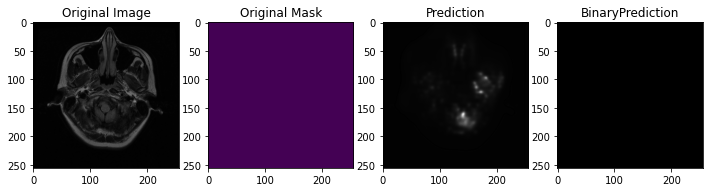

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


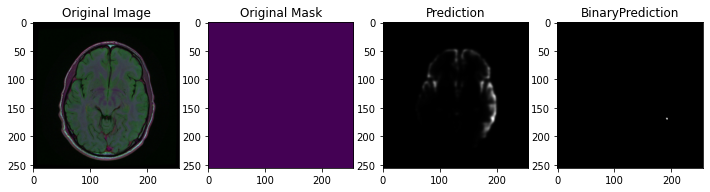

Pred Shape : (256, 256)
7.0
0 0 65529 7
confusion matrix: [[65529     7]
 [    0     0]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:78: RuntimeWarning: invalid value encountered in long_scalars


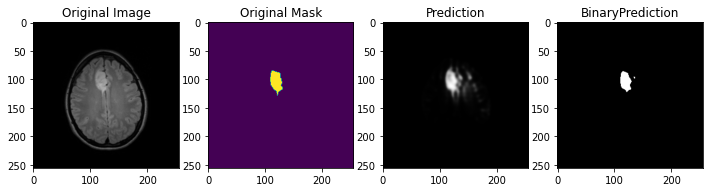

Pred Shape : (256, 256)
1133.0
504 113 64907 12
confusion matrix: [[64907    12]
 [  113   504]]


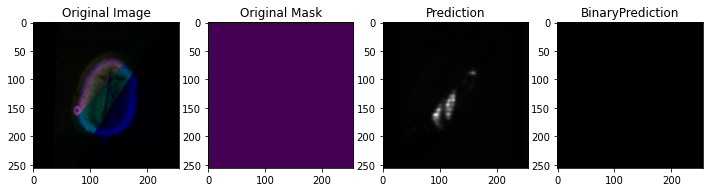

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


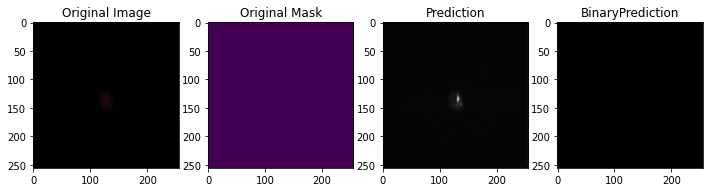

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


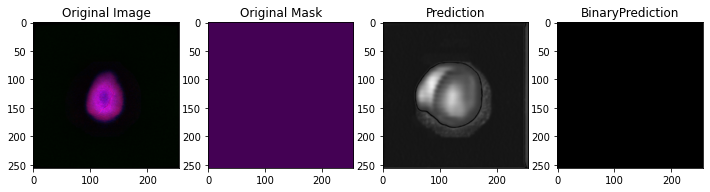

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


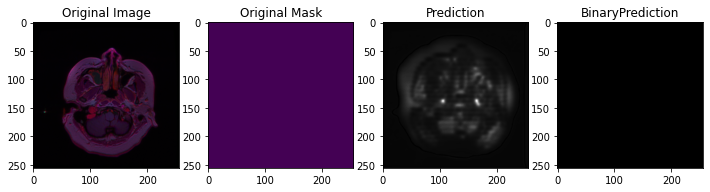

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


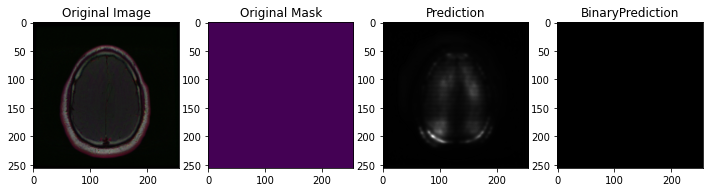

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


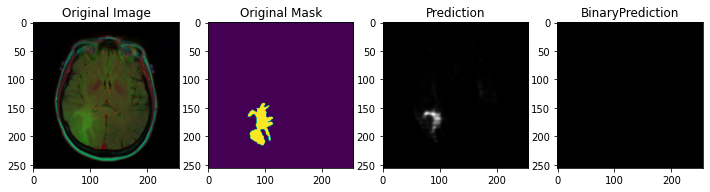

Pred Shape : (256, 256)
1615.0
0 1615 63921 0
confusion matrix: [[63921     0]
 [ 1615     0]]


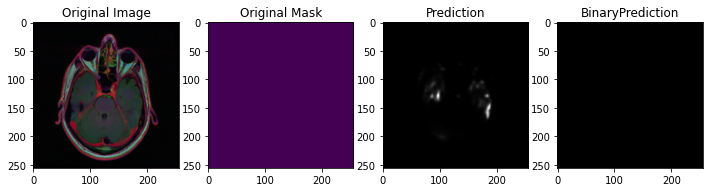

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


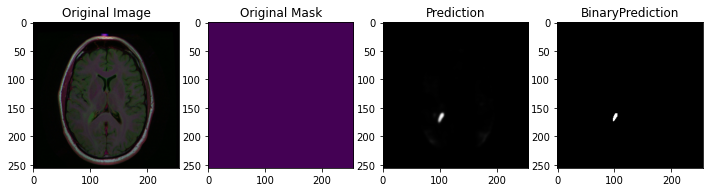

Pred Shape : (256, 256)
68.0
0 0 65468 68
confusion matrix: [[65468    68]
 [    0     0]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:78: RuntimeWarning: invalid value encountered in long_scalars


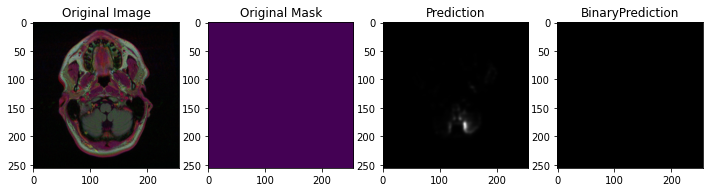

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


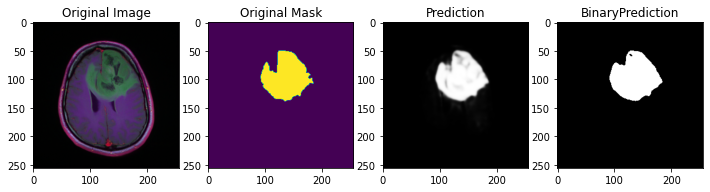

Pred Shape : (256, 256)
10466.0
5026 58 60096 356
confusion matrix: [[60096   356]
 [   58  5026]]


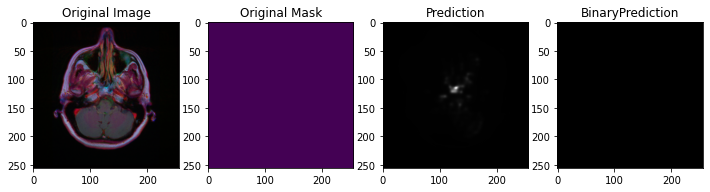

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


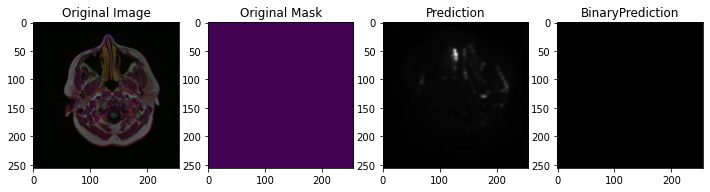

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


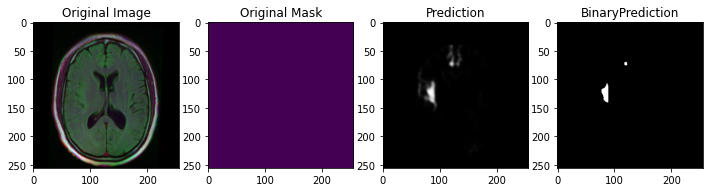

Pred Shape : (256, 256)
293.0
0 0 65243 293
confusion matrix: [[65243   293]
 [    0     0]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:78: RuntimeWarning: invalid value encountered in long_scalars


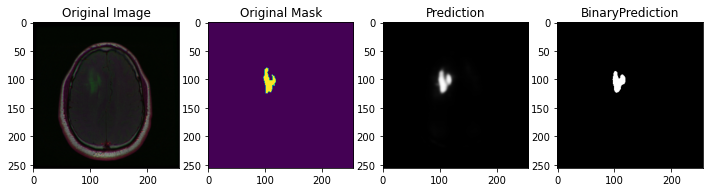

Pred Shape : (256, 256)
1041.0
442 71 64937 86
confusion matrix: [[64937    86]
 [   71   442]]


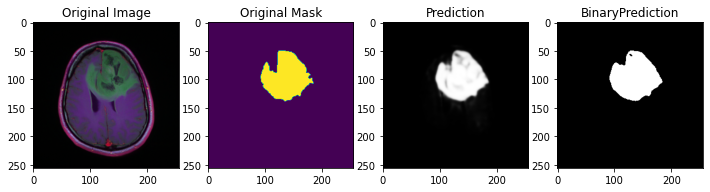

Pred Shape : (256, 256)
10466.0
5026 58 60096 356
confusion matrix: [[60096   356]
 [   58  5026]]


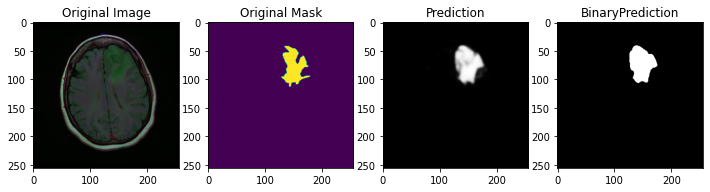

Pred Shape : (256, 256)
3984.0
1654 183 63206 493
confusion matrix: [[63206   493]
 [  183  1654]]


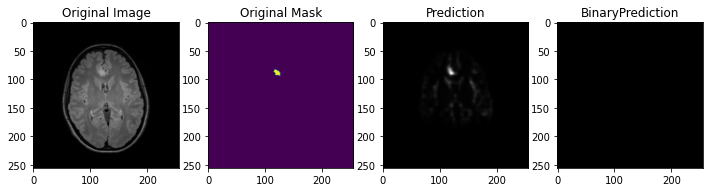

Pred Shape : (256, 256)
79.0
0 79 65457 0
confusion matrix: [[65457     0]
 [   79     0]]


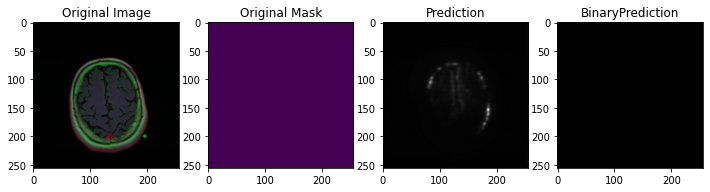

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


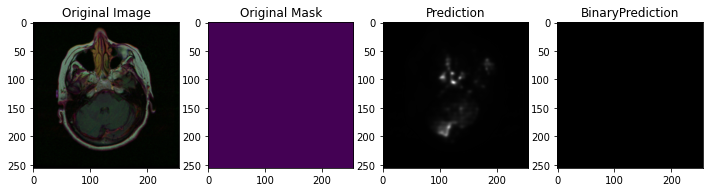

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


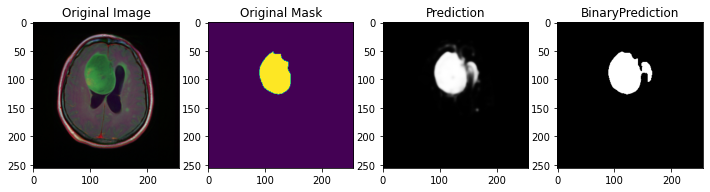

Pred Shape : (256, 256)
6756.0
3049 6 61829 652
confusion matrix: [[61829   652]
 [    6  3049]]


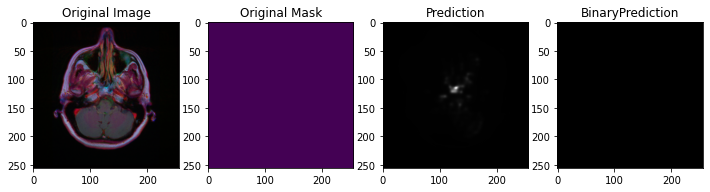

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


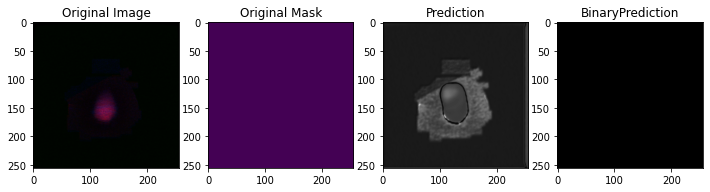

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


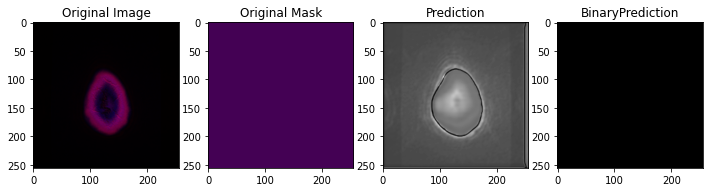

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


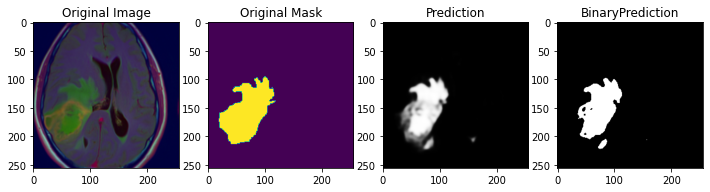

Pred Shape : (256, 256)
11514.0
4779 1746 58801 210
confusion matrix: [[58801   210]
 [ 1746  4779]]


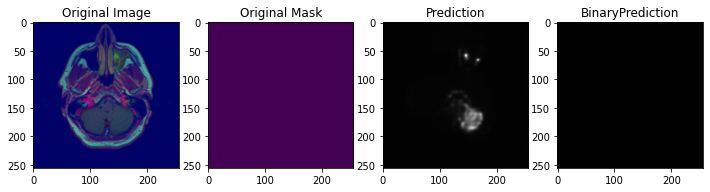

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


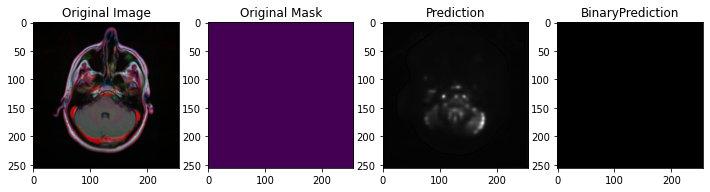

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


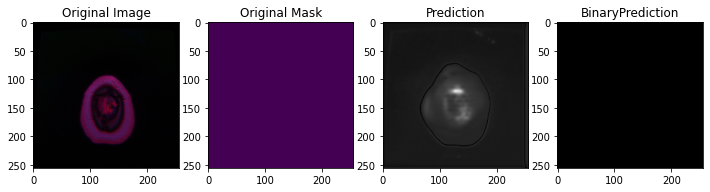

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


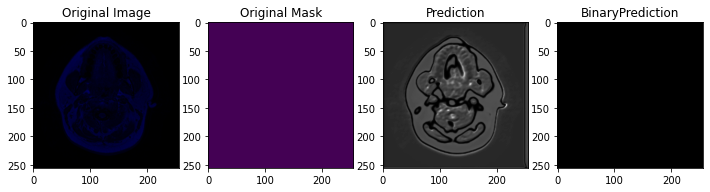

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


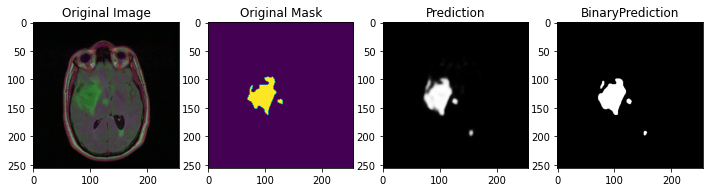

Pred Shape : (256, 256)
3794.0
1664 144 63406 322
confusion matrix: [[63406   322]
 [  144  1664]]


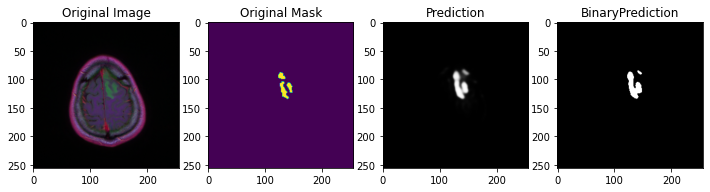

Pred Shape : (256, 256)
1118.0
433 7 64851 245
confusion matrix: [[64851   245]
 [    7   433]]


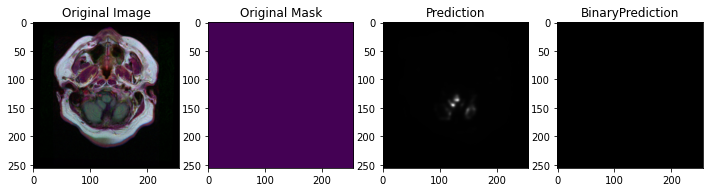

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


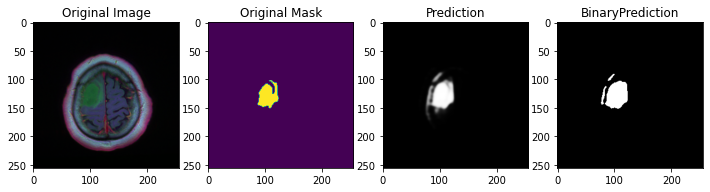

Pred Shape : (256, 256)
2781.0
1131 5 63886 514
confusion matrix: [[63886   514]
 [    5  1131]]


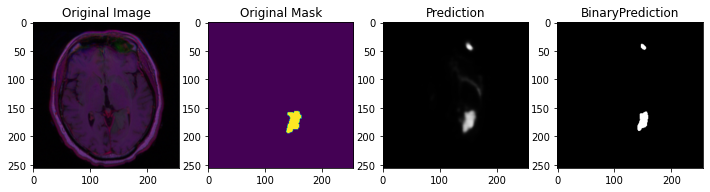

Pred Shape : (256, 256)
1188.0
429 260 64777 70
confusion matrix: [[64777    70]
 [  260   429]]


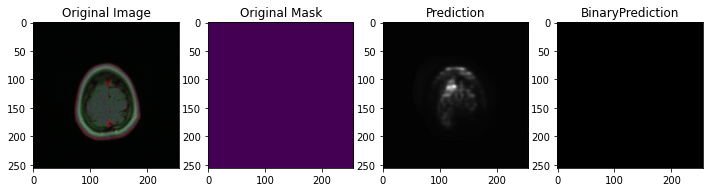

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


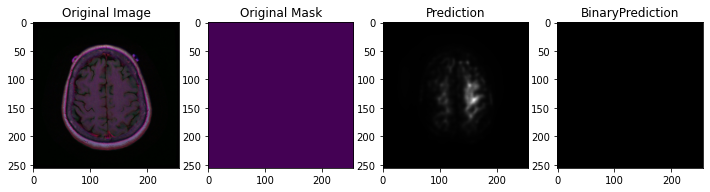

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


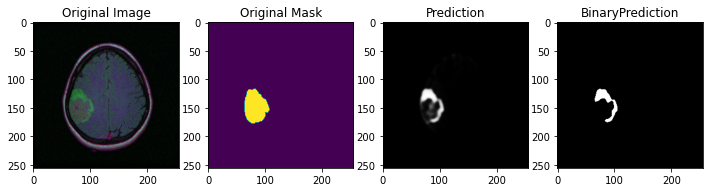

Pred Shape : (256, 256)
2642.0
703 1219 63597 17
confusion matrix: [[63597    17]
 [ 1219   703]]


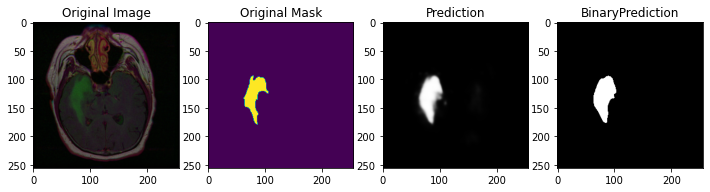

Pred Shape : (256, 256)
3539.0
1480 82 63477 497
confusion matrix: [[63477   497]
 [   82  1480]]


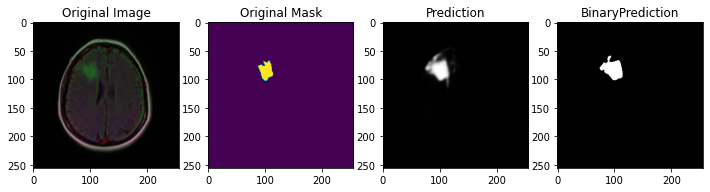

Pred Shape : (256, 256)
1546.0
569 6 64559 402
confusion matrix: [[64559   402]
 [    6   569]]


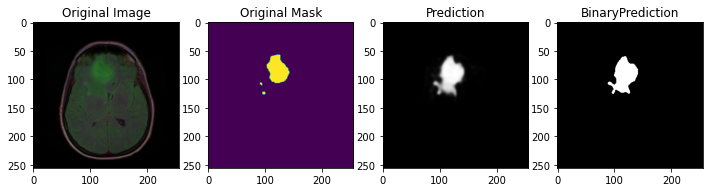

Pred Shape : (256, 256)
3304.0
1248 136 63480 672
confusion matrix: [[63480   672]
 [  136  1248]]


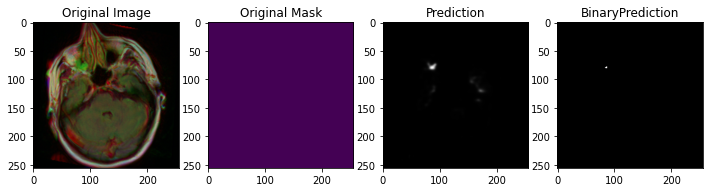

Pred Shape : (256, 256)
9.0
0 0 65527 9
confusion matrix: [[65527     9]
 [    0     0]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:78: RuntimeWarning: invalid value encountered in long_scalars


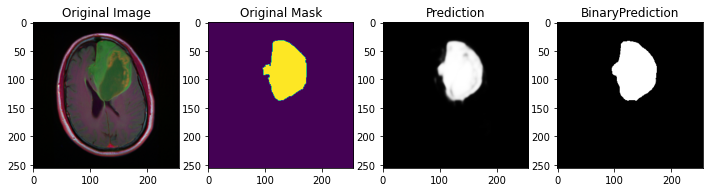

Pred Shape : (256, 256)
11418.0
5486 94 59604 352
confusion matrix: [[59604   352]
 [   94  5486]]


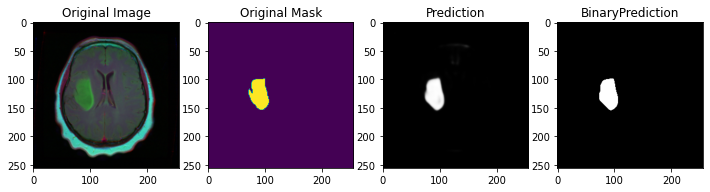

Pred Shape : (256, 256)
2773.0
1313 70 64076 77
confusion matrix: [[64076    77]
 [   70  1313]]


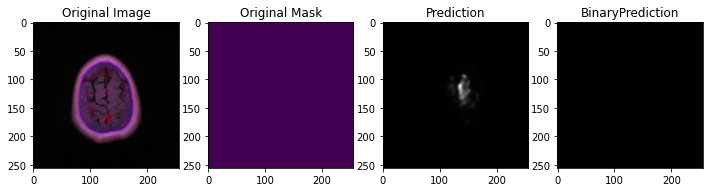

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


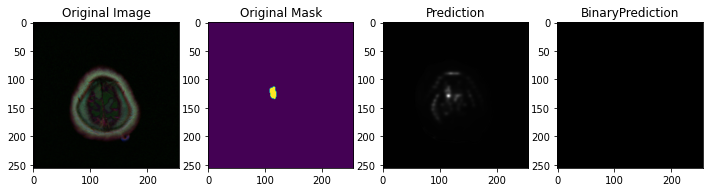

Pred Shape : (256, 256)
204.0
0 204 65332 0
confusion matrix: [[65332     0]
 [  204     0]]


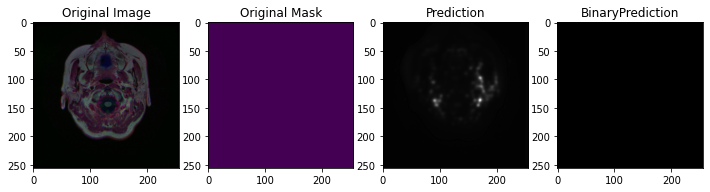

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


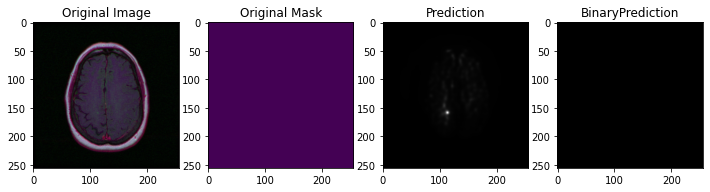

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


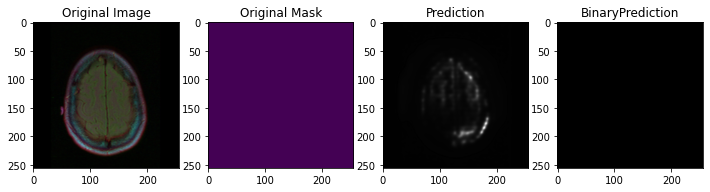

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


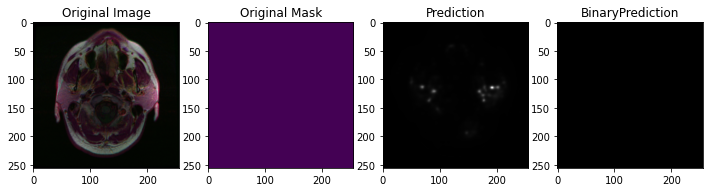

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


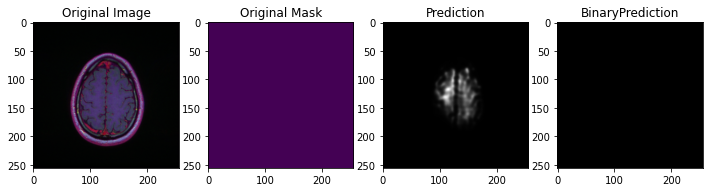

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


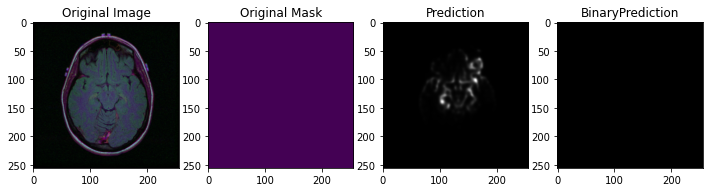

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


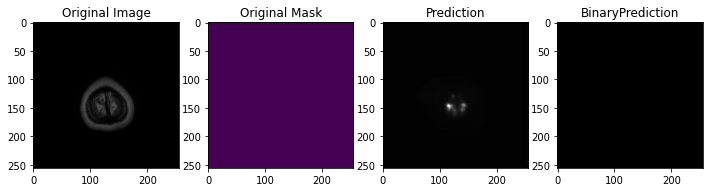

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


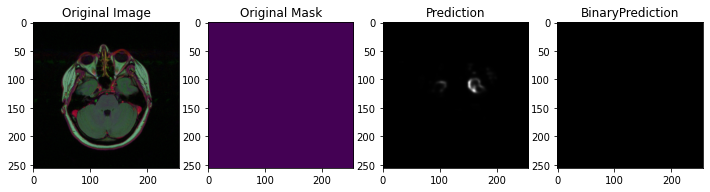

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


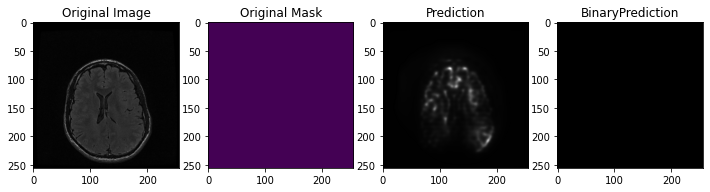

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


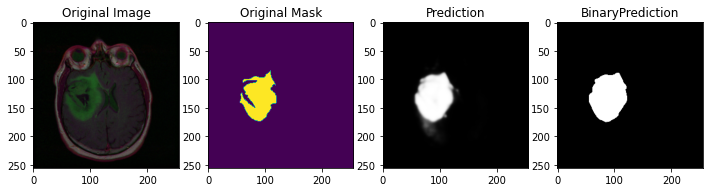

Pred Shape : (256, 256)
7643.0
3375 34 61268 859
confusion matrix: [[61268   859]
 [   34  3375]]


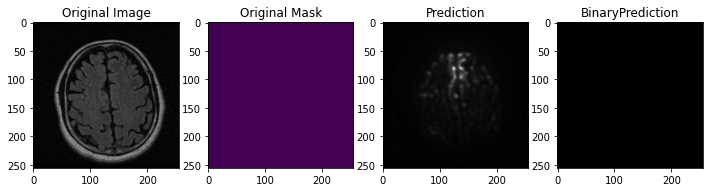

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


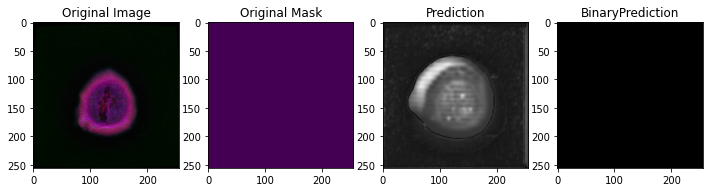

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


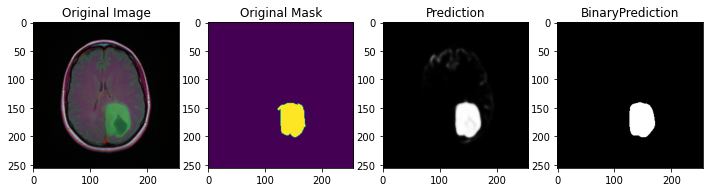

Pred Shape : (256, 256)
4554.0
2200 64 63182 90
confusion matrix: [[63182    90]
 [   64  2200]]


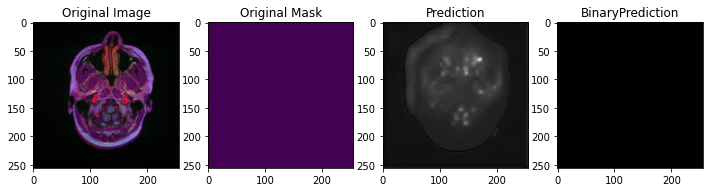

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


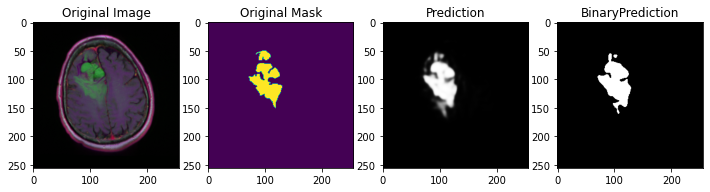

Pred Shape : (256, 256)
5362.0
2250 215 62424 647
confusion matrix: [[62424   647]
 [  215  2250]]


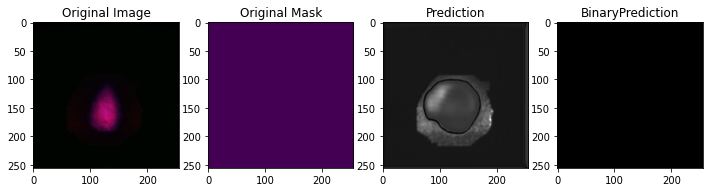

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


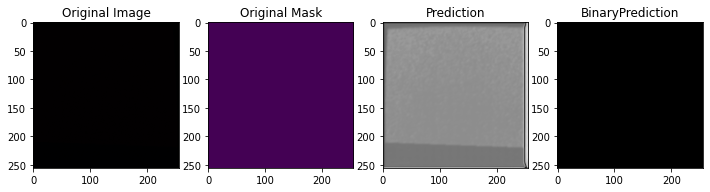

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


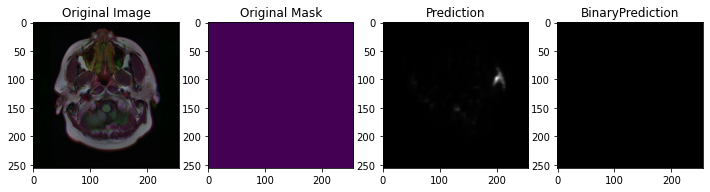

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


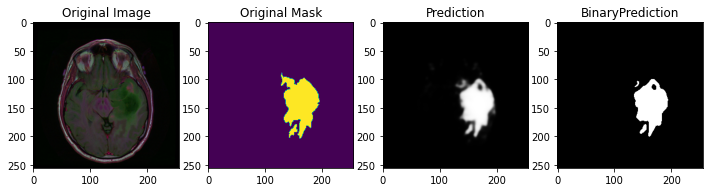

Pred Shape : (256, 256)
8028.0
3537 865 61045 89
confusion matrix: [[61045    89]
 [  865  3537]]


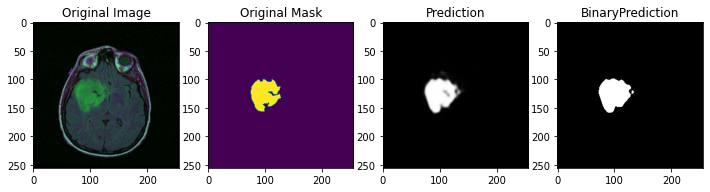

Pred Shape : (256, 256)
4452.0
2028 4 63112 392
confusion matrix: [[63112   392]
 [    4  2028]]


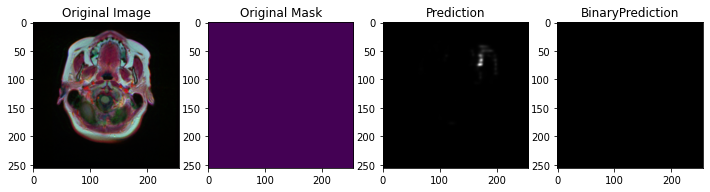

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


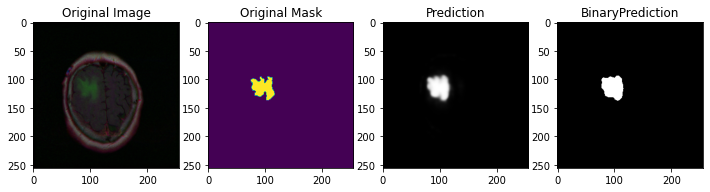

Pred Shape : (256, 256)
2359.0
1017 61 64194 264
confusion matrix: [[64194   264]
 [   61  1017]]


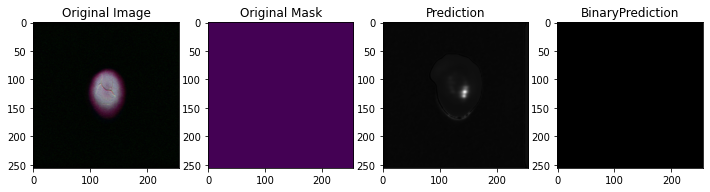

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


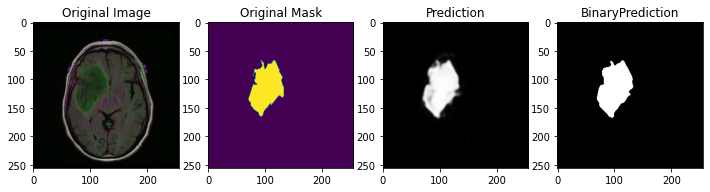

Pred Shape : (256, 256)
7743.0
3600 89 61393 454
confusion matrix: [[61393   454]
 [   89  3600]]


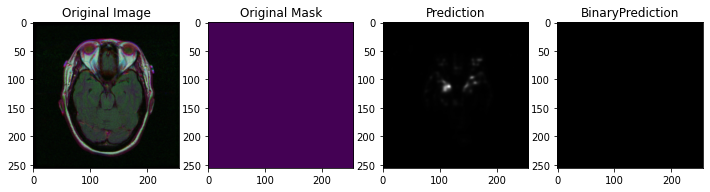

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


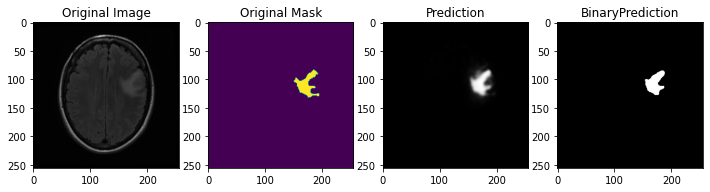

Pred Shape : (256, 256)
1750.0
724 165 64510 137
confusion matrix: [[64510   137]
 [  165   724]]


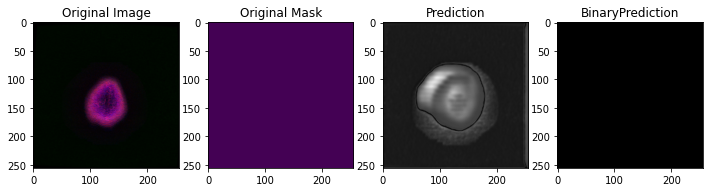

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


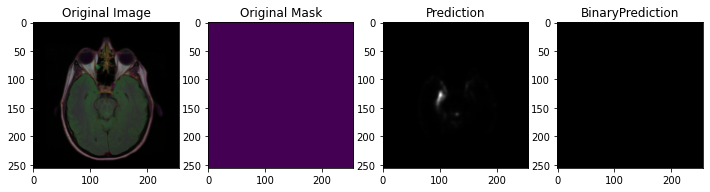

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


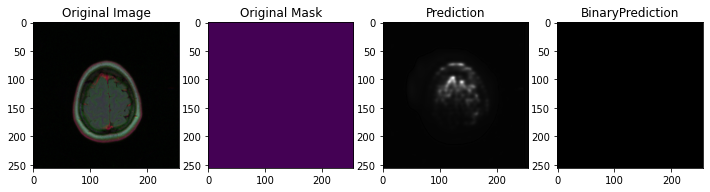

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


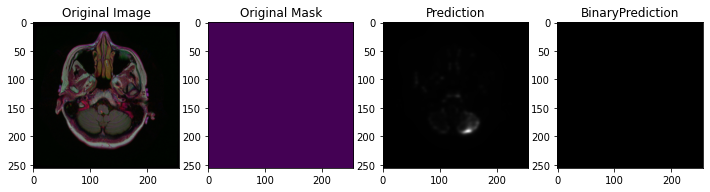

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


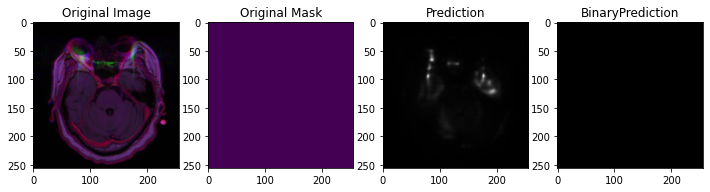

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


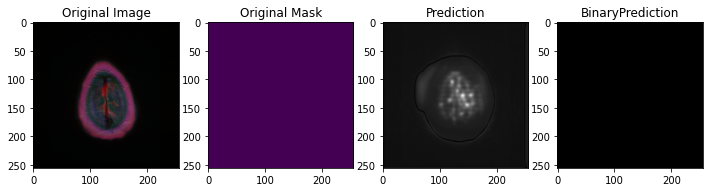

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


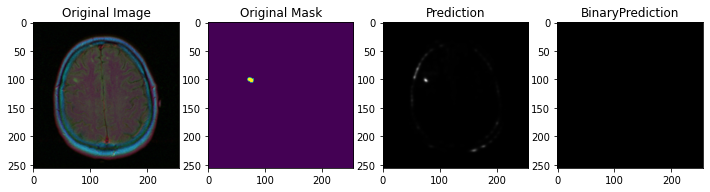

Pred Shape : (256, 256)
74.0
0 74 65462 0
confusion matrix: [[65462     0]
 [   74     0]]


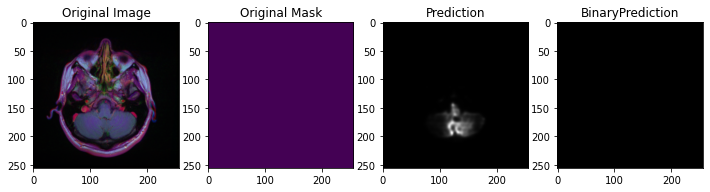

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


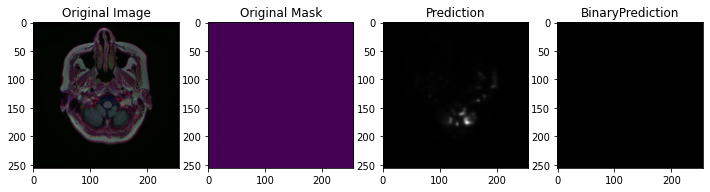

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


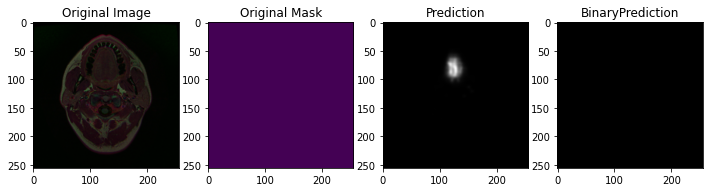

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


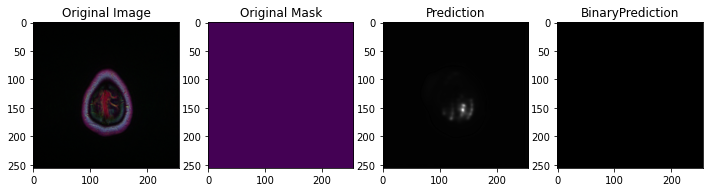

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


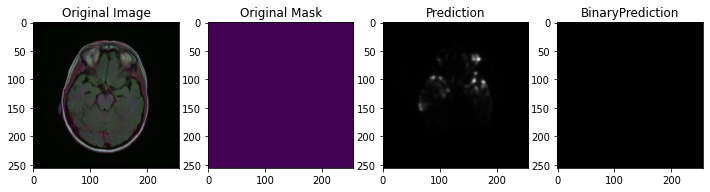

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


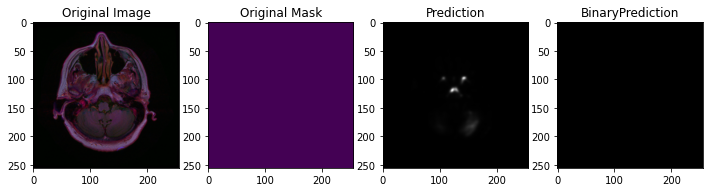

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


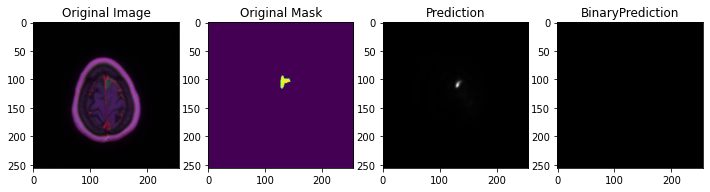

Pred Shape : (256, 256)
205.0
0 205 65331 0
confusion matrix: [[65331     0]
 [  205     0]]


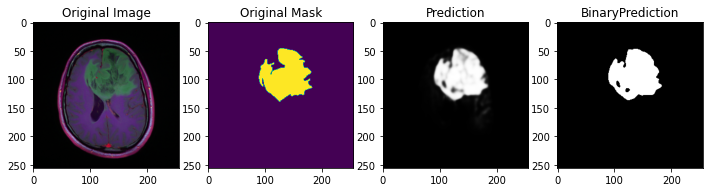

Pred Shape : (256, 256)
10933.0
5116 217 59719 484
confusion matrix: [[59719   484]
 [  217  5116]]


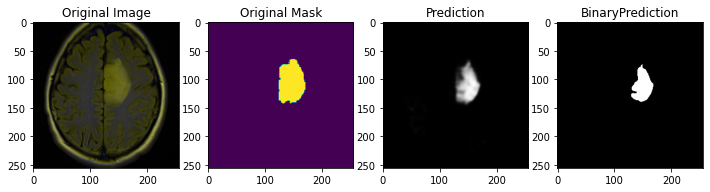

Pred Shape : (256, 256)
4384.0
1520 1344 62672 0
confusion matrix: [[62672     0]
 [ 1344  1520]]


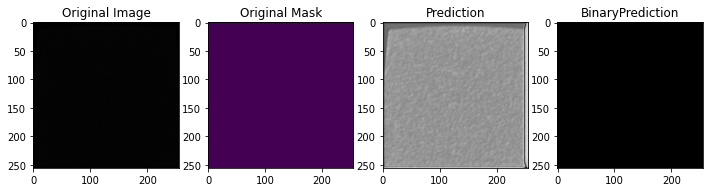

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


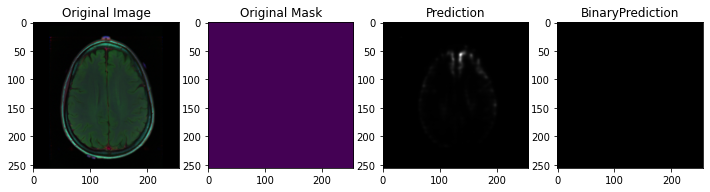

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


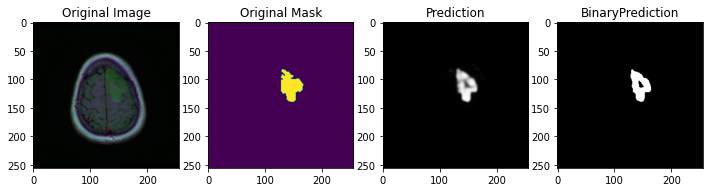

Pred Shape : (256, 256)
2532.0
1115 241 64119 61
confusion matrix: [[64119    61]
 [  241  1115]]


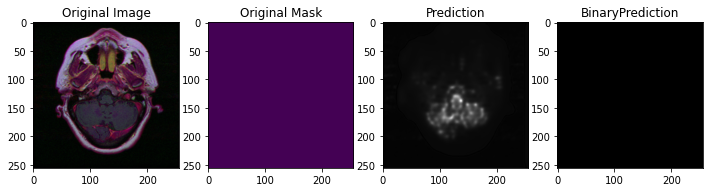

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


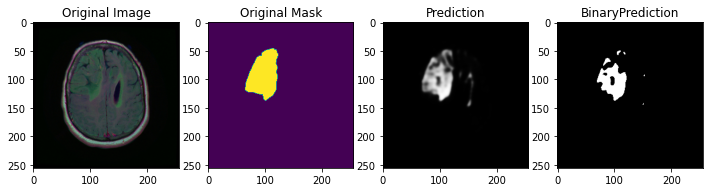

Pred Shape : (256, 256)
5589.0
2004 1552 61951 29
confusion matrix: [[61951    29]
 [ 1552  2004]]


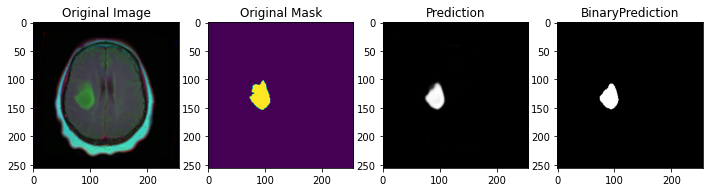

Pred Shape : (256, 256)
2194.0
976 240 64318 2
confusion matrix: [[64318     2]
 [  240   976]]


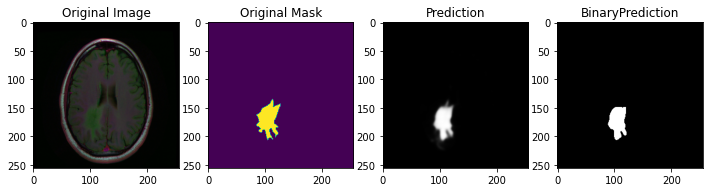

Pred Shape : (256, 256)
2906.0
1217 364 63847 108
confusion matrix: [[63847   108]
 [  364  1217]]


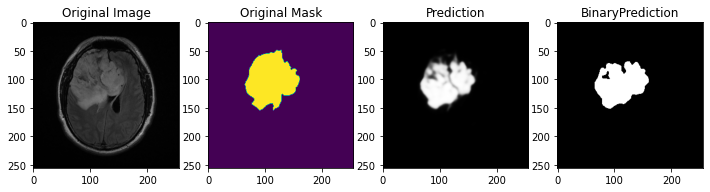

Pred Shape : (256, 256)
11801.0
5145 1459 58880 52
confusion matrix: [[58880    52]
 [ 1459  5145]]


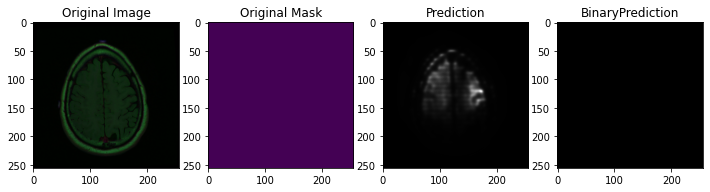

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


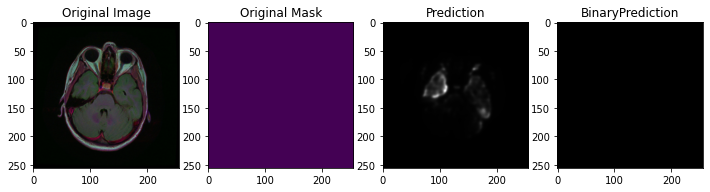

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


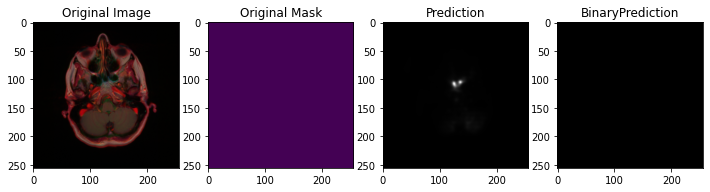

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


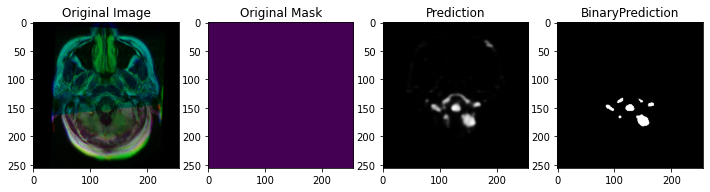

Pred Shape : (256, 256)
732.0
0 0 64804 732
confusion matrix: [[64804   732]
 [    0     0]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:78: RuntimeWarning: invalid value encountered in long_scalars


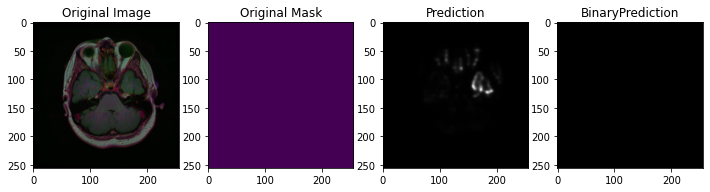

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


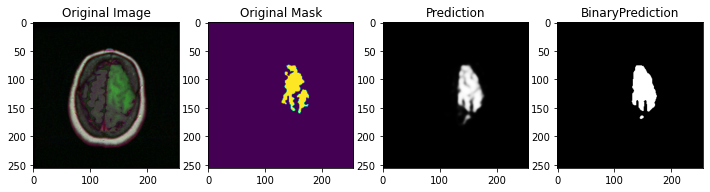

Pred Shape : (256, 256)
4374.0
1808 98 62970 660
confusion matrix: [[62970   660]
 [   98  1808]]


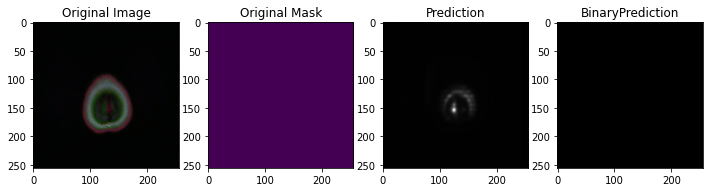

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


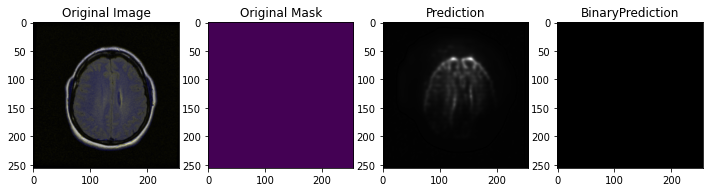

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


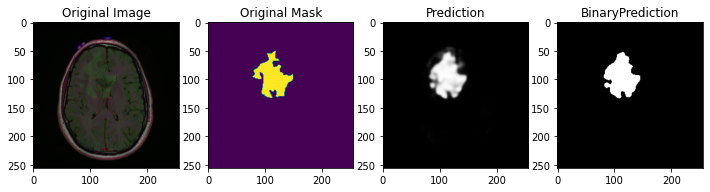

Pred Shape : (256, 256)
5803.0
2566 149 62299 522
confusion matrix: [[62299   522]
 [  149  2566]]


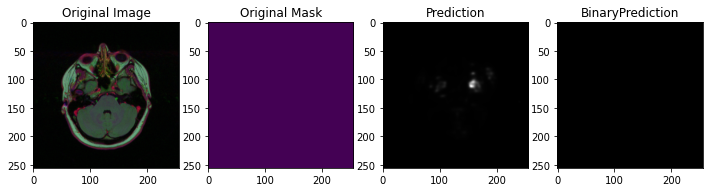

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


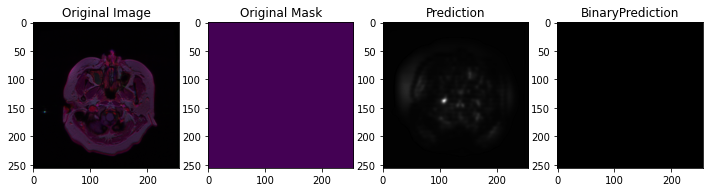

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


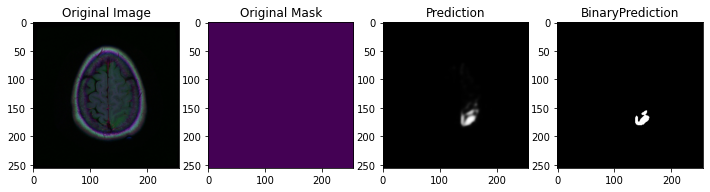

Pred Shape : (256, 256)
339.0
0 0 65197 339
confusion matrix: [[65197   339]
 [    0     0]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:78: RuntimeWarning: invalid value encountered in long_scalars


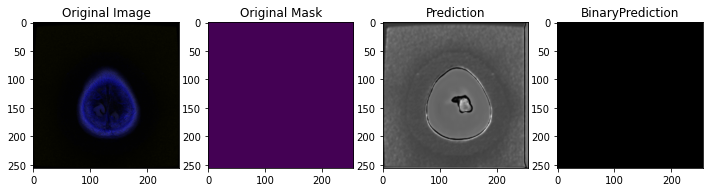

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


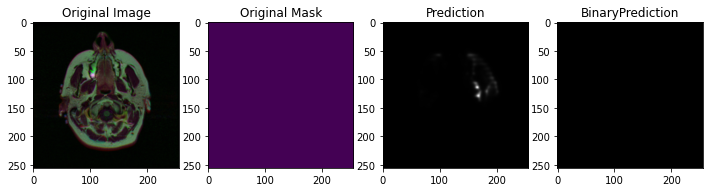

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


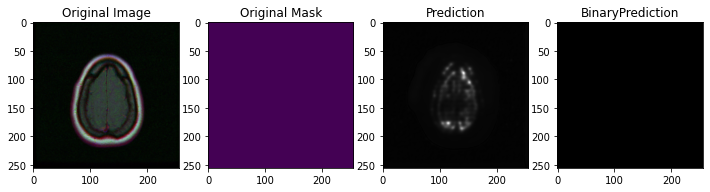

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


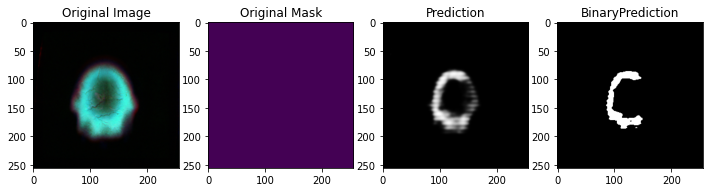

Pred Shape : (256, 256)
2078.0
0 0 63458 2078
confusion matrix: [[63458  2078]
 [    0     0]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:78: RuntimeWarning: invalid value encountered in long_scalars


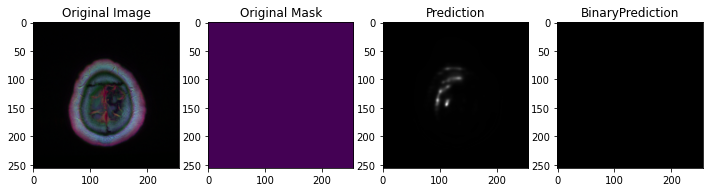

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


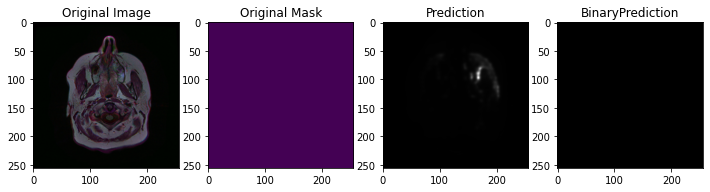

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


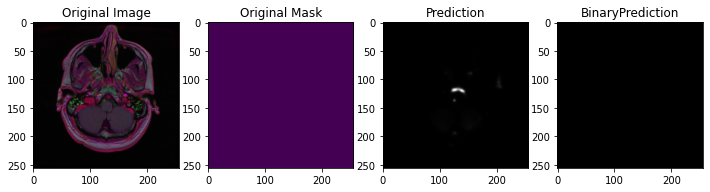

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


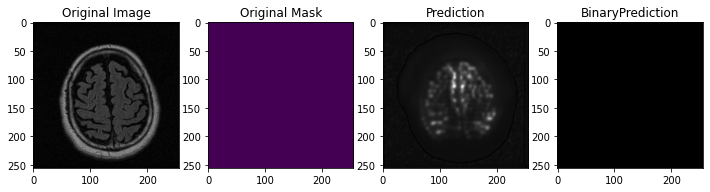

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


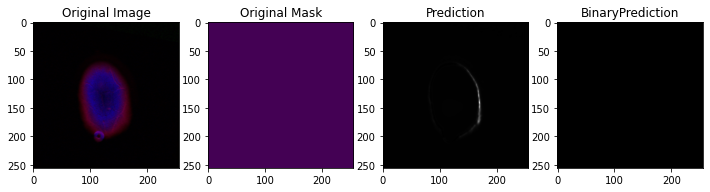

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


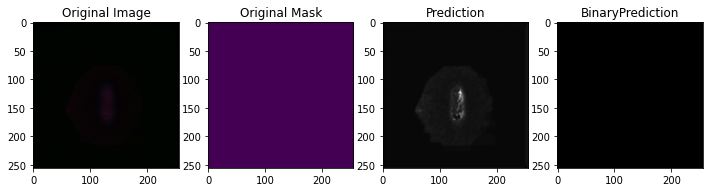

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


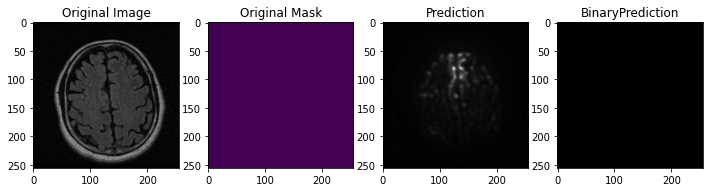

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


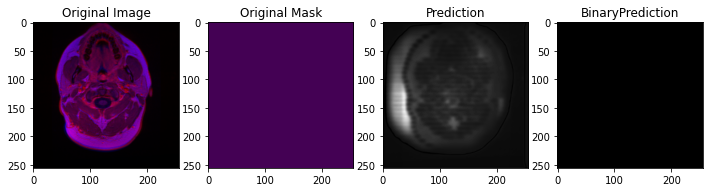

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


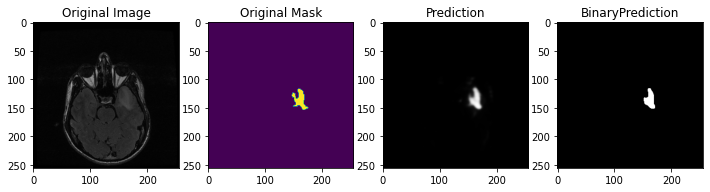

Pred Shape : (256, 256)
914.0
368 116 64990 62
confusion matrix: [[64990    62]
 [  116   368]]


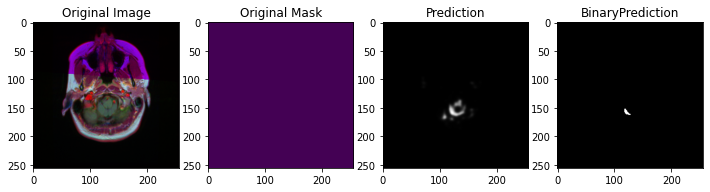

Pred Shape : (256, 256)
58.0
0 0 65478 58
confusion matrix: [[65478    58]
 [    0     0]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:78: RuntimeWarning: invalid value encountered in long_scalars


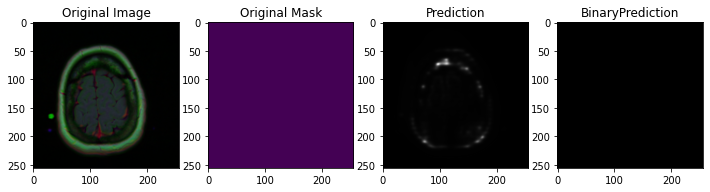

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


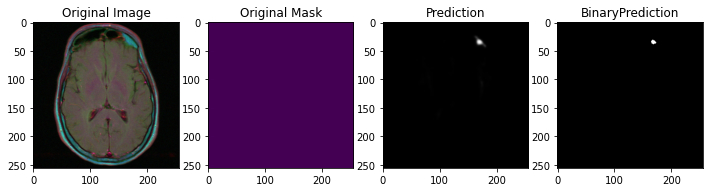

Pred Shape : (256, 256)
48.0
0 0 65488 48
confusion matrix: [[65488    48]
 [    0     0]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:78: RuntimeWarning: invalid value encountered in long_scalars


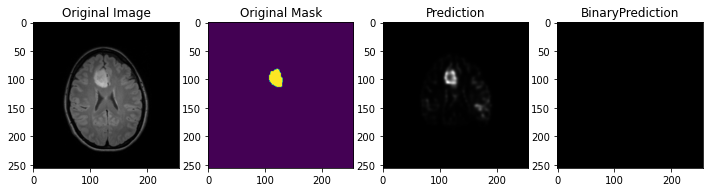

Pred Shape : (256, 256)
577.0
0 577 64959 0
confusion matrix: [[64959     0]
 [  577     0]]


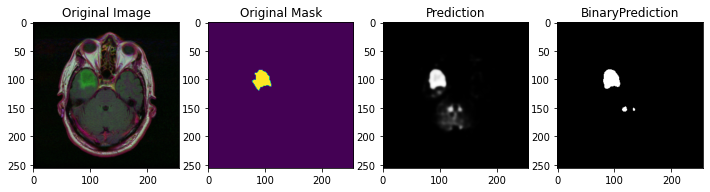

Pred Shape : (256, 256)
1570.0
681 43 64647 165
confusion matrix: [[64647   165]
 [   43   681]]


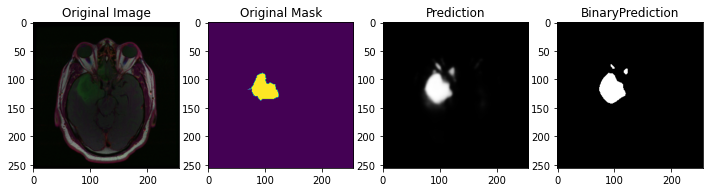

Pred Shape : (256, 256)
3152.0
1317 102 63701 416
confusion matrix: [[63701   416]
 [  102  1317]]


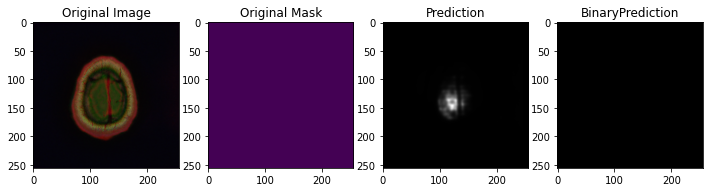

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


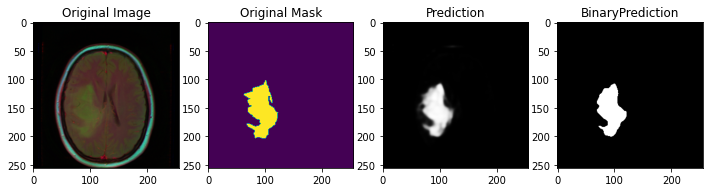

Pred Shape : (256, 256)
6131.0
2774 532 62179 51
confusion matrix: [[62179    51]
 [  532  2774]]


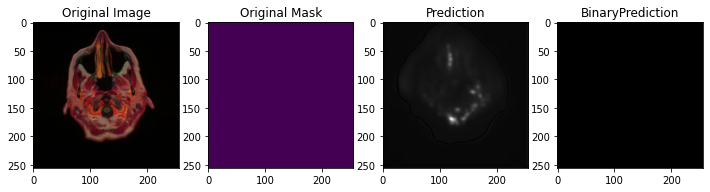

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


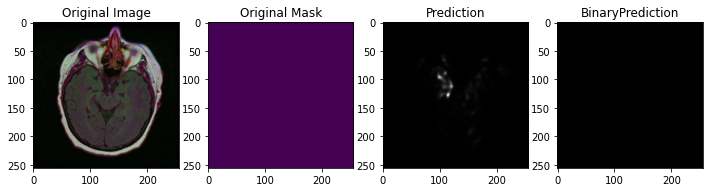

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


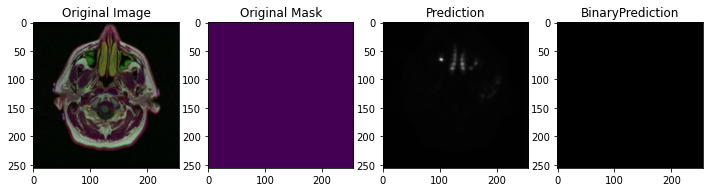

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


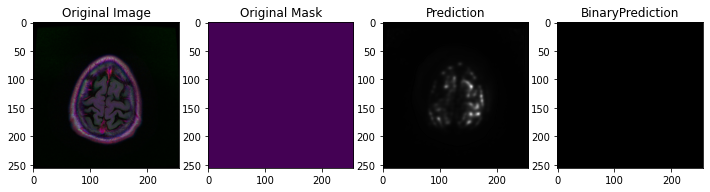

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


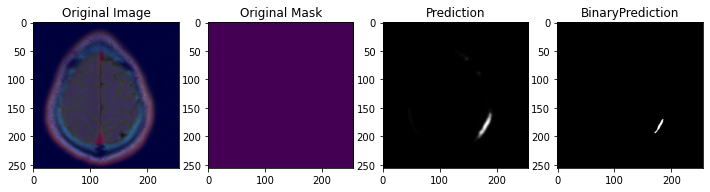

Pred Shape : (256, 256)
87.0
0 0 65449 87
confusion matrix: [[65449    87]
 [    0     0]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:78: RuntimeWarning: invalid value encountered in long_scalars


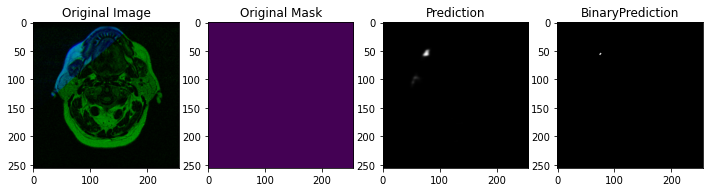

Pred Shape : (256, 256)
8.0
0 0 65528 8
confusion matrix: [[65528     8]
 [    0     0]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:78: RuntimeWarning: invalid value encountered in long_scalars


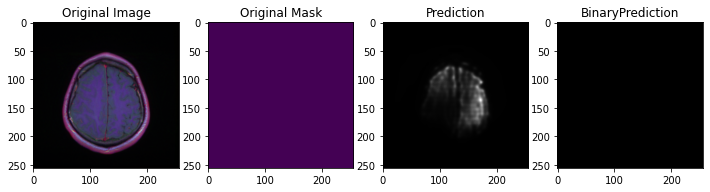

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


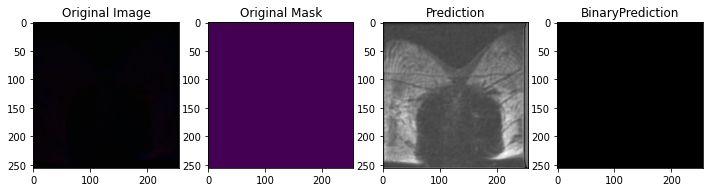

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


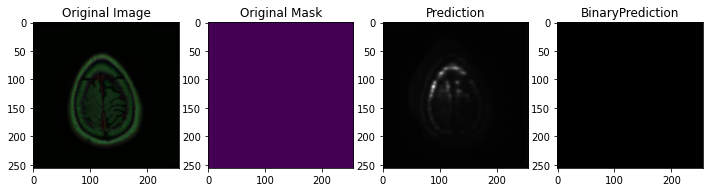

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


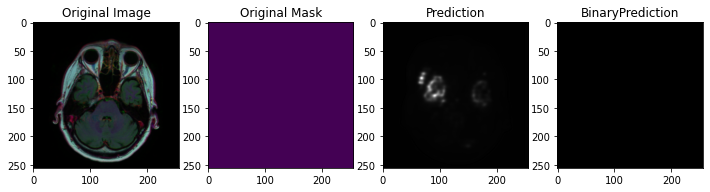

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


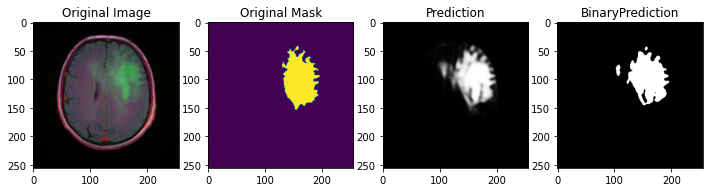

Pred Shape : (256, 256)
8891.0
3936 484 60581 535
confusion matrix: [[60581   535]
 [  484  3936]]


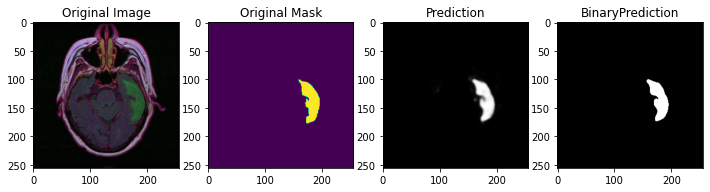

Pred Shape : (256, 256)
2918.0
1342 130 63960 104
confusion matrix: [[63960   104]
 [  130  1342]]


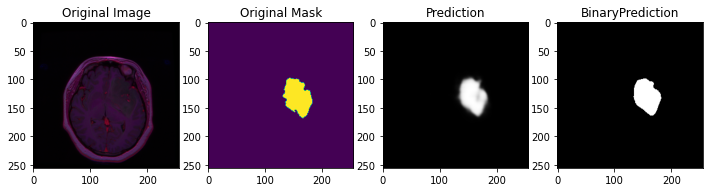

Pred Shape : (256, 256)
4548.0
2106 263 63094 73
confusion matrix: [[63094    73]
 [  263  2106]]


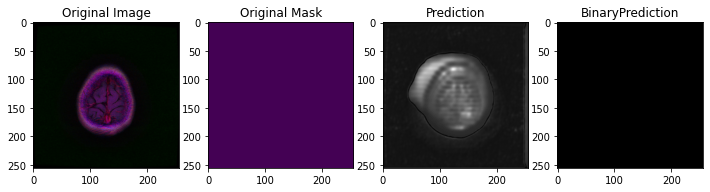

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


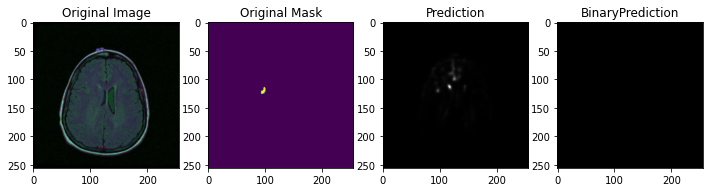

Pred Shape : (256, 256)
59.0
0 59 65477 0
confusion matrix: [[65477     0]
 [   59     0]]


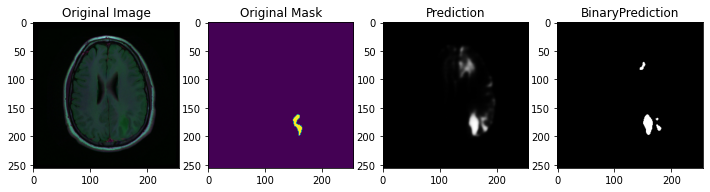

Pred Shape : (256, 256)
814.0
219 38 64941 338
confusion matrix: [[64941   338]
 [   38   219]]


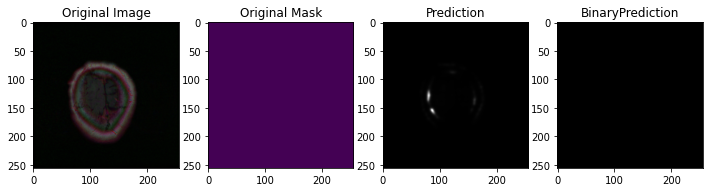

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


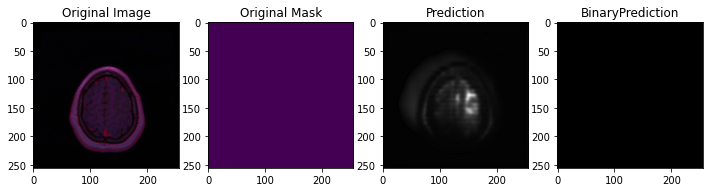

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


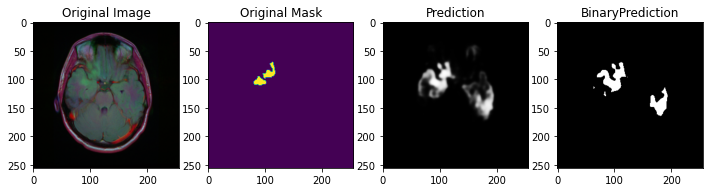

Pred Shape : (256, 256)
2424.0
479 30 63591 1436
confusion matrix: [[63591  1436]
 [   30   479]]


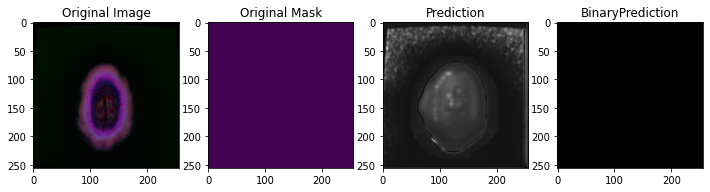

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


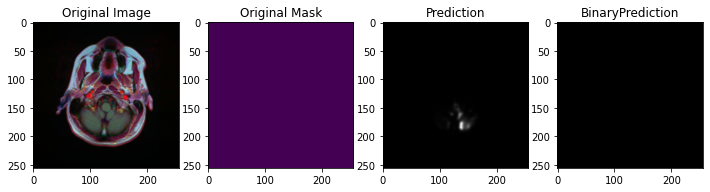

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


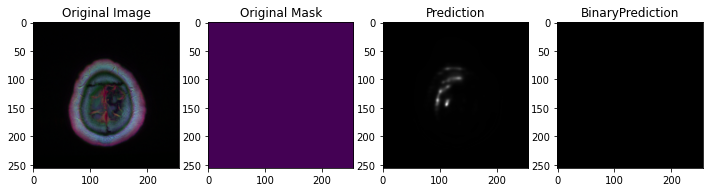

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


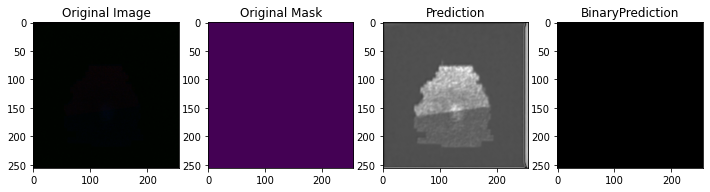

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


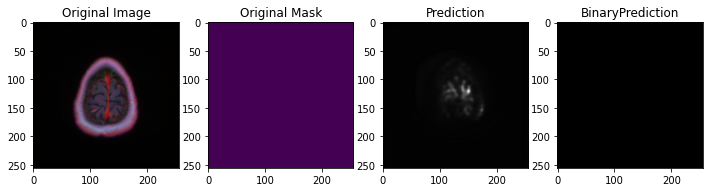

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


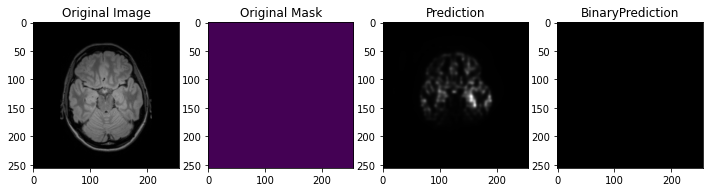

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


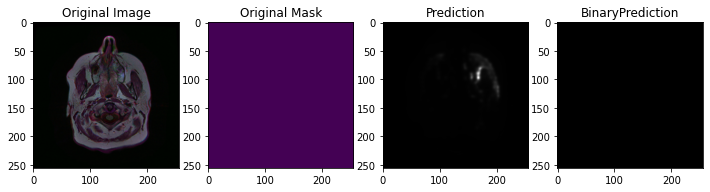

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


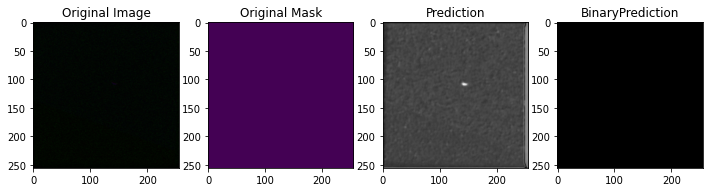

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


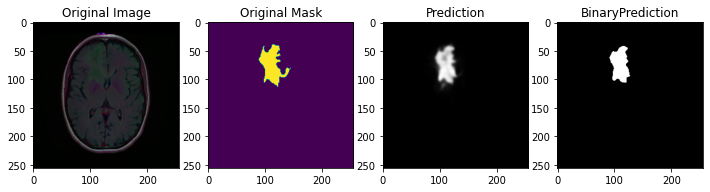

Pred Shape : (256, 256)
3389.0
1452 408 63599 77
confusion matrix: [[63599    77]
 [  408  1452]]


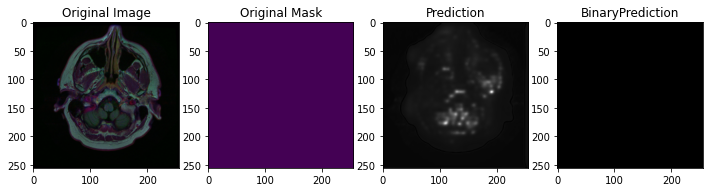

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


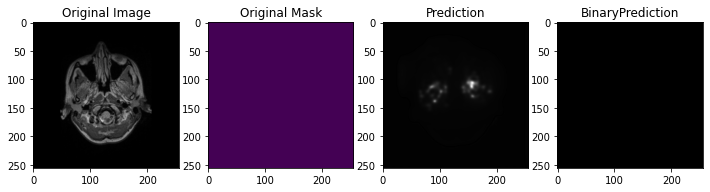

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


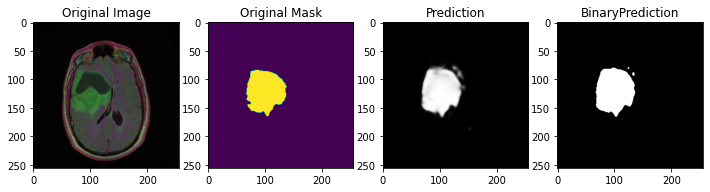

Pred Shape : (256, 256)
8592.0
4074 86 61018 358
confusion matrix: [[61018   358]
 [   86  4074]]


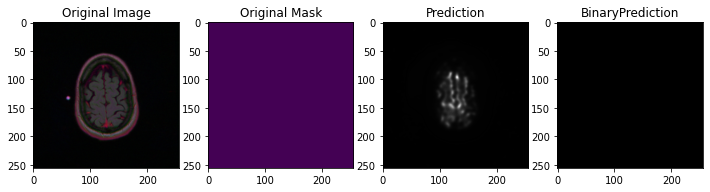

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


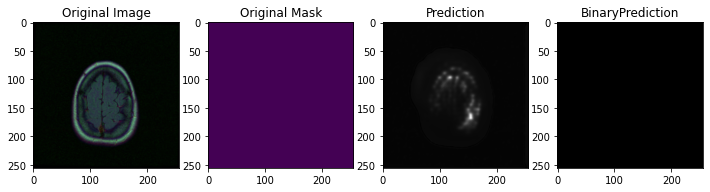

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


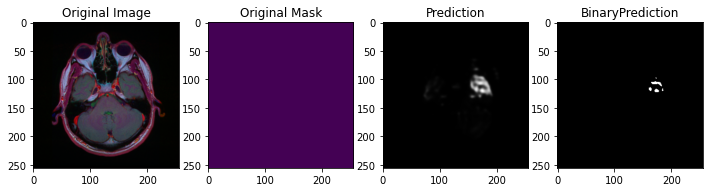

Pred Shape : (256, 256)
152.0
0 0 65384 152
confusion matrix: [[65384   152]
 [    0     0]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:78: RuntimeWarning: invalid value encountered in long_scalars


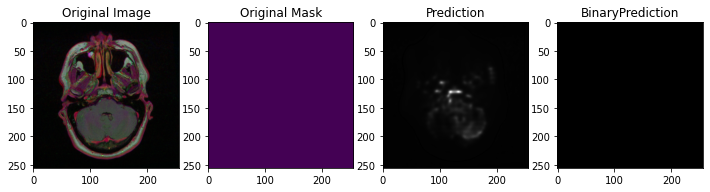

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


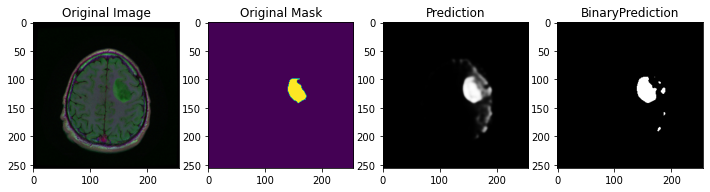

Pred Shape : (256, 256)
2138.0
901 1 64299 335
confusion matrix: [[64299   335]
 [    1   901]]


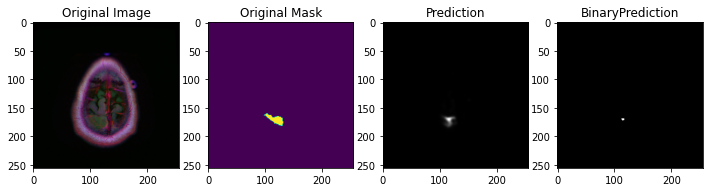

Pred Shape : (256, 256)
347.0
15 317 65204 0
confusion matrix: [[65204     0]
 [  317    15]]


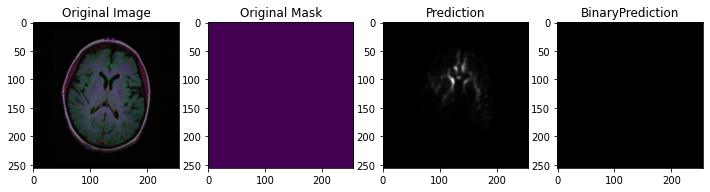

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


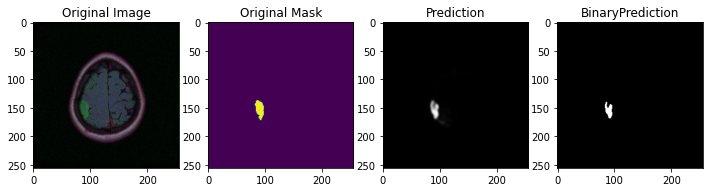

Pred Shape : (256, 256)
608.0
234 138 65162 2
confusion matrix: [[65162     2]
 [  138   234]]


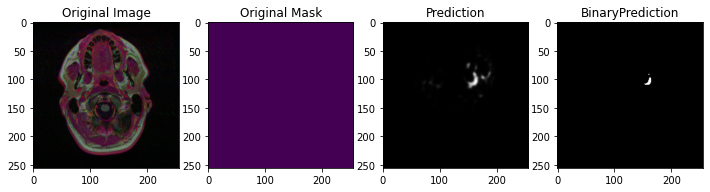

Pred Shape : (256, 256)
73.0
0 0 65463 73
confusion matrix: [[65463    73]
 [    0     0]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:78: RuntimeWarning: invalid value encountered in long_scalars


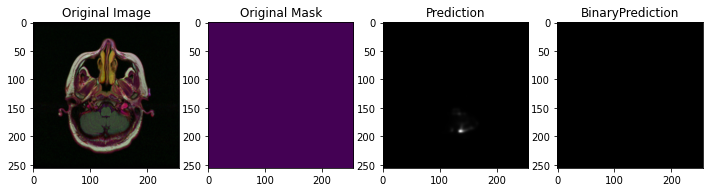

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


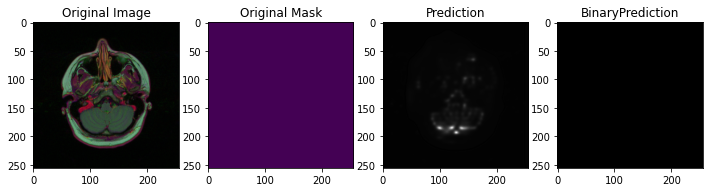

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


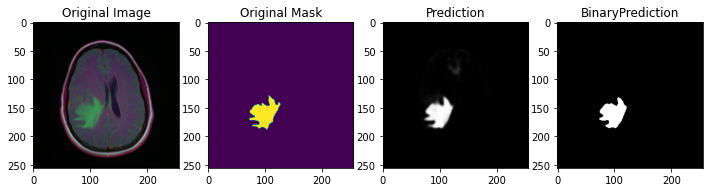

Pred Shape : (256, 256)
3136.0
1461 162 63861 52
confusion matrix: [[63861    52]
 [  162  1461]]


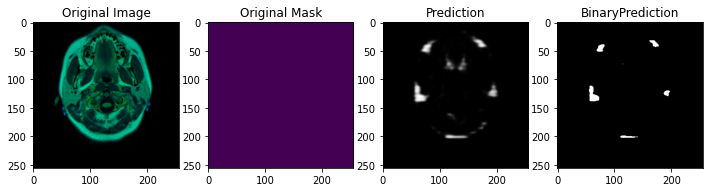

Pred Shape : (256, 256)
681.0
0 0 64855 681
confusion matrix: [[64855   681]
 [    0     0]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:78: RuntimeWarning: invalid value encountered in long_scalars


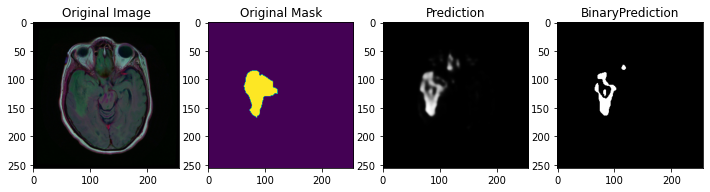

Pred Shape : (256, 256)
3724.0
1105 1445 62917 69
confusion matrix: [[62917    69]
 [ 1445  1105]]


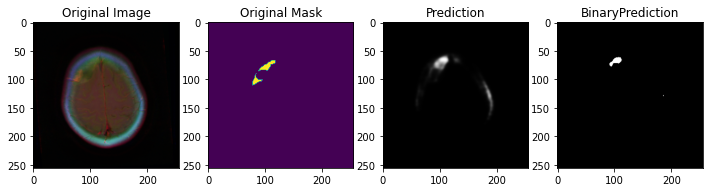

Pred Shape : (256, 256)
525.0
19 328 65030 159
confusion matrix: [[65030   159]
 [  328    19]]


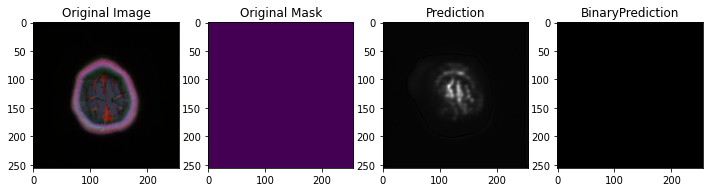

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


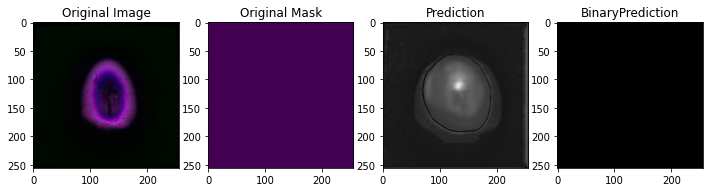

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


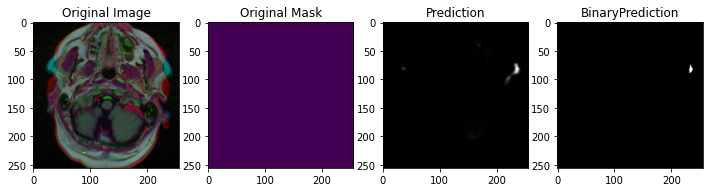

Pred Shape : (256, 256)
53.0
0 0 65483 53
confusion matrix: [[65483    53]
 [    0     0]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:78: RuntimeWarning: invalid value encountered in long_scalars


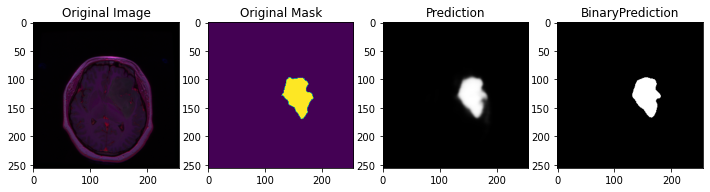

Pred Shape : (256, 256)
4622.0
2171 186 63085 94
confusion matrix: [[63085    94]
 [  186  2171]]


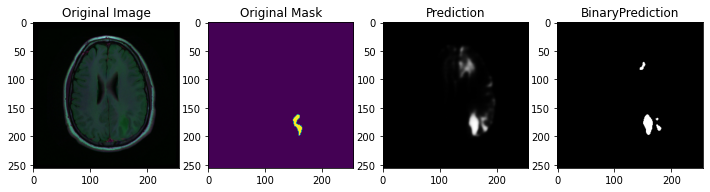

Pred Shape : (256, 256)
814.0
219 38 64941 338
confusion matrix: [[64941   338]
 [   38   219]]


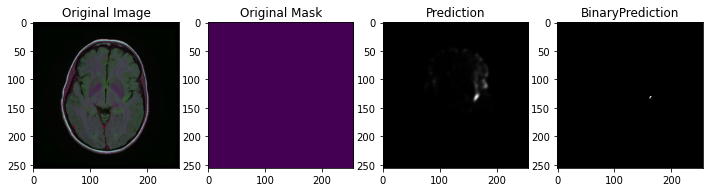

Pred Shape : (256, 256)
9.0
0 0 65527 9
confusion matrix: [[65527     9]
 [    0     0]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:78: RuntimeWarning: invalid value encountered in long_scalars


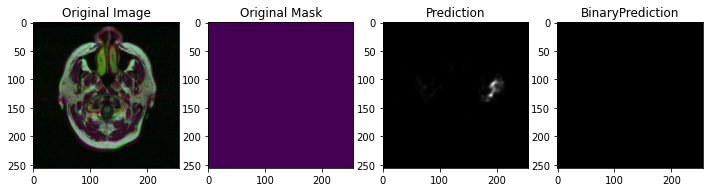

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


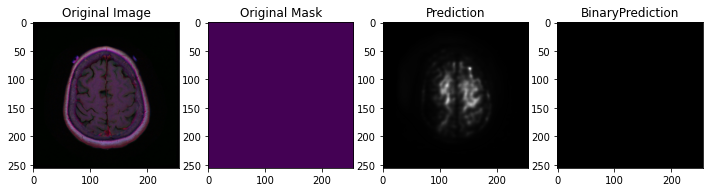

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


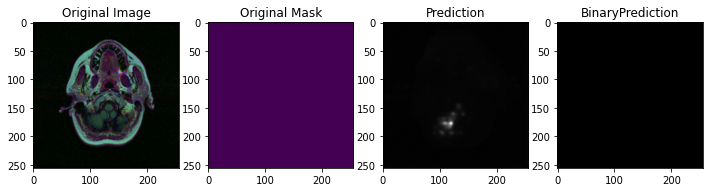

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


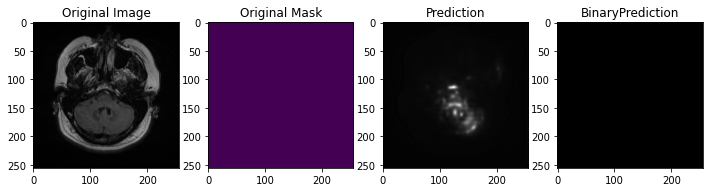

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


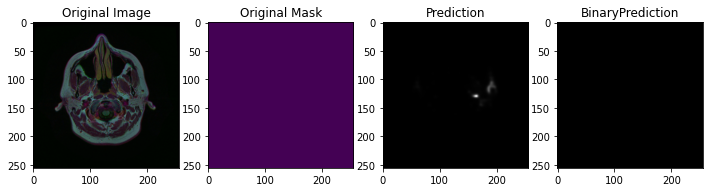

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


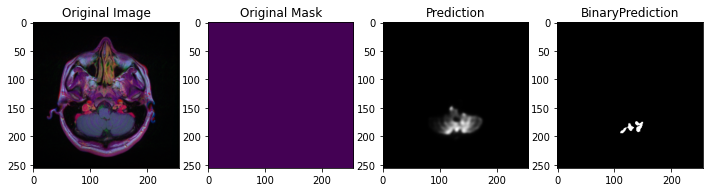

Pred Shape : (256, 256)
296.0
0 0 65240 296
confusion matrix: [[65240   296]
 [    0     0]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:78: RuntimeWarning: invalid value encountered in long_scalars


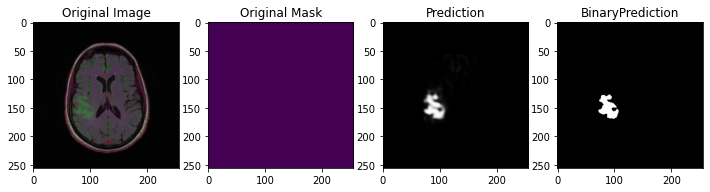

Pred Shape : (256, 256)
854.0
0 0 64682 854
confusion matrix: [[64682   854]
 [    0     0]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:78: RuntimeWarning: invalid value encountered in long_scalars


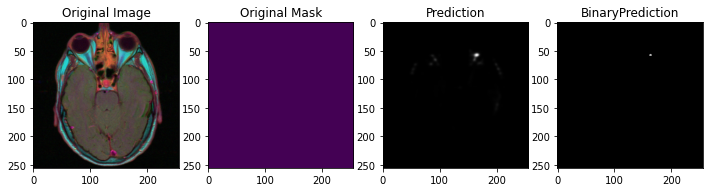

Pred Shape : (256, 256)
9.0
0 0 65527 9
confusion matrix: [[65527     9]
 [    0     0]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:78: RuntimeWarning: invalid value encountered in long_scalars


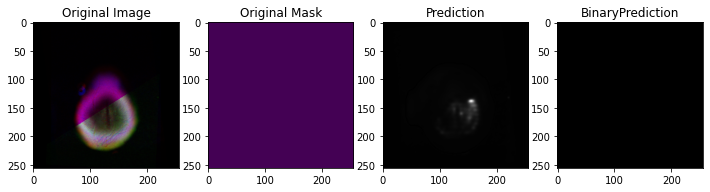

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


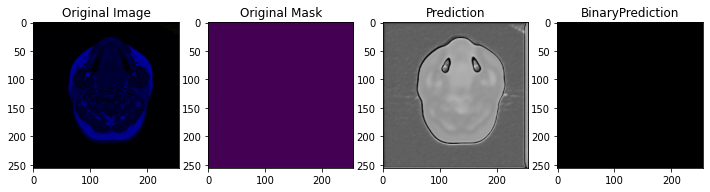

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


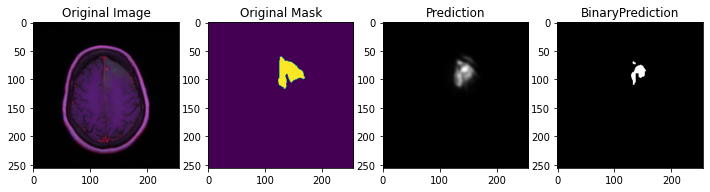

Pred Shape : (256, 256)
1826.0
443 927 64153 13
confusion matrix: [[64153    13]
 [  927   443]]


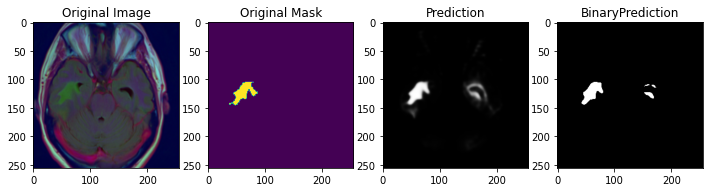

Pred Shape : (256, 256)
1740.0
719 102 64515 200
confusion matrix: [[64515   200]
 [  102   719]]


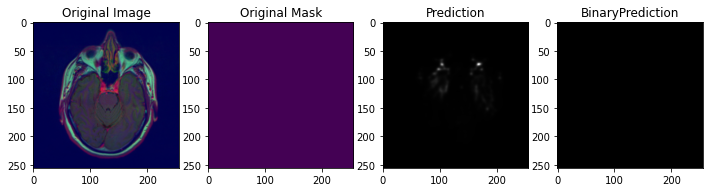

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


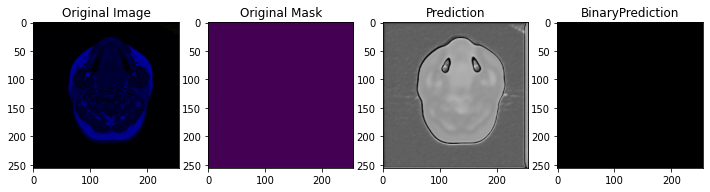

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


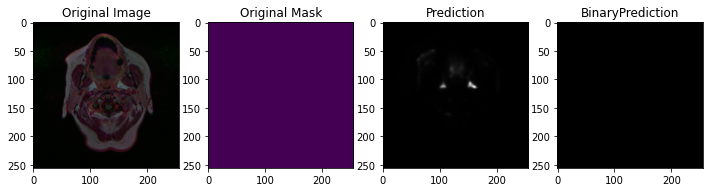

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


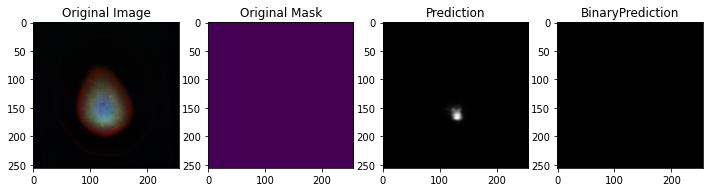

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


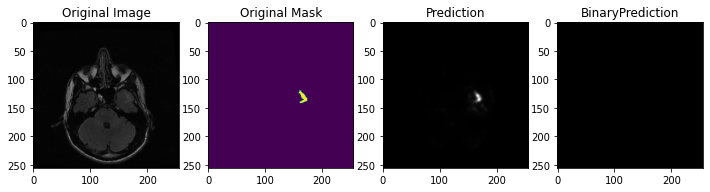

Pred Shape : (256, 256)
155.0
0 155 65381 0
confusion matrix: [[65381     0]
 [  155     0]]


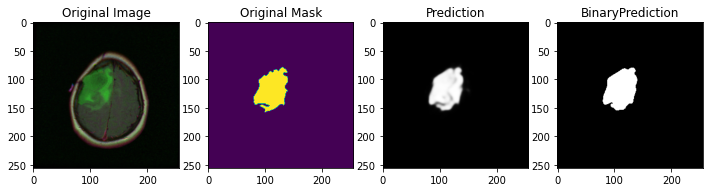

Pred Shape : (256, 256)
6312.0
2989 90 62213 244
confusion matrix: [[62213   244]
 [   90  2989]]


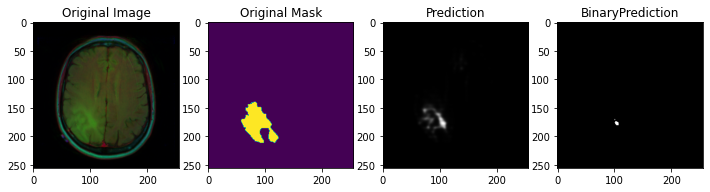

Pred Shape : (256, 256)
2382.0
38 2306 63192 0
confusion matrix: [[63192     0]
 [ 2306    38]]


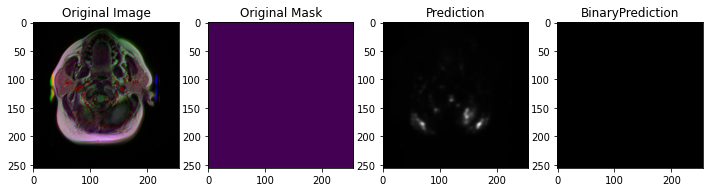

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


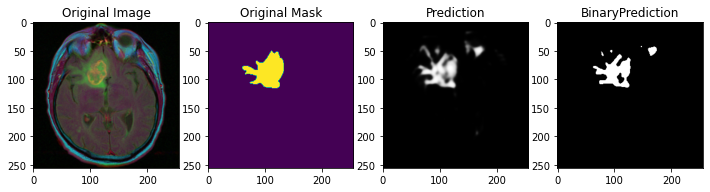

Pred Shape : (256, 256)
4752.0
1856 790 62640 250
confusion matrix: [[62640   250]
 [  790  1856]]


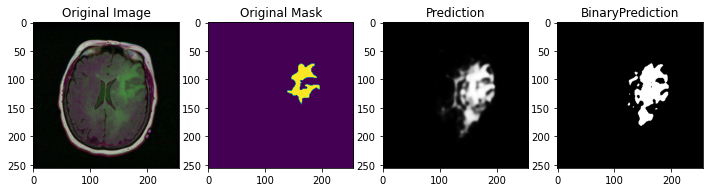

Pred Shape : (256, 256)
5121.0
1587 29 62002 1918
confusion matrix: [[62002  1918]
 [   29  1587]]


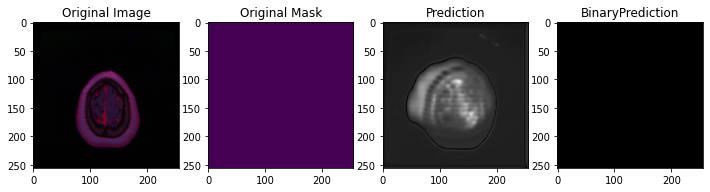

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


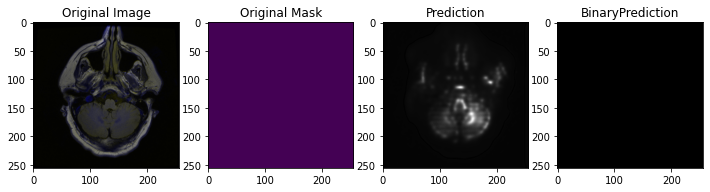

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


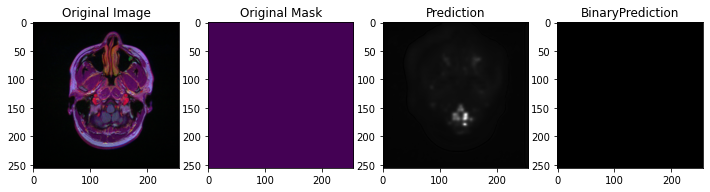

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


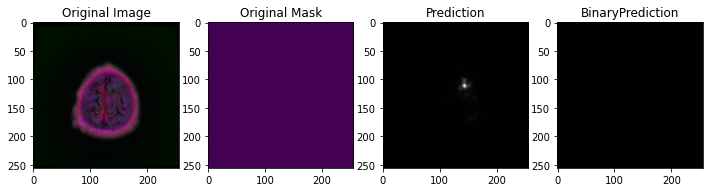

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


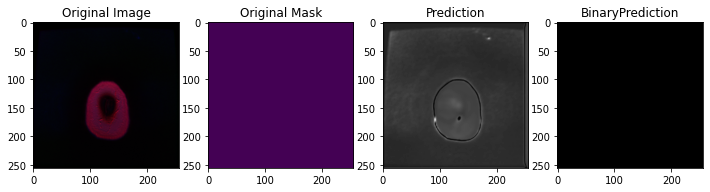

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


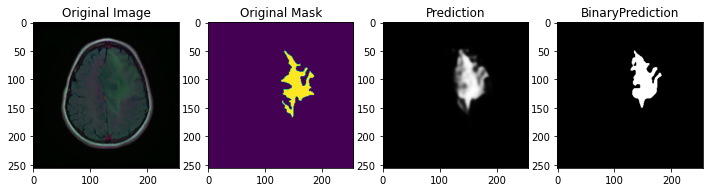

Pred Shape : (256, 256)
5082.0
2010 464 62464 598
confusion matrix: [[62464   598]
 [  464  2010]]


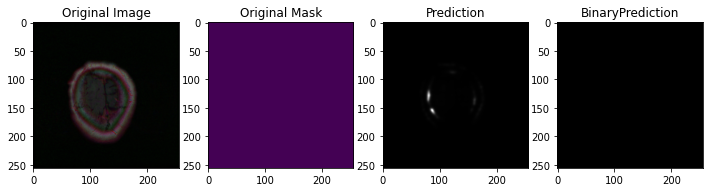

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


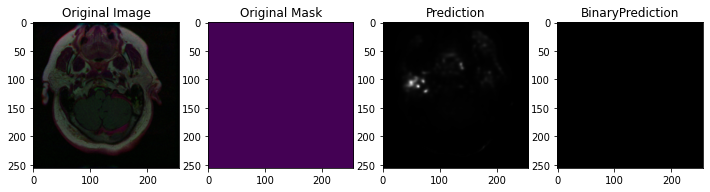

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


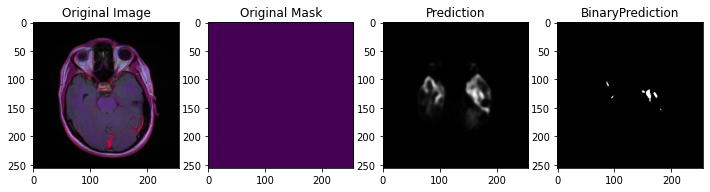

Pred Shape : (256, 256)
192.0
0 0 65344 192
confusion matrix: [[65344   192]
 [    0     0]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:78: RuntimeWarning: invalid value encountered in long_scalars


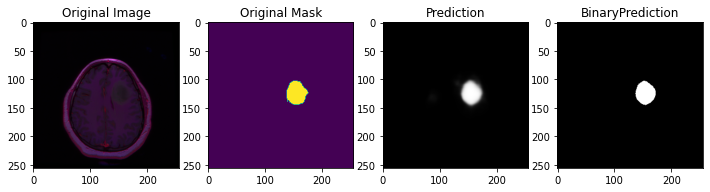

Pred Shape : (256, 256)
2277.0
1090 85 64349 12
confusion matrix: [[64349    12]
 [   85  1090]]


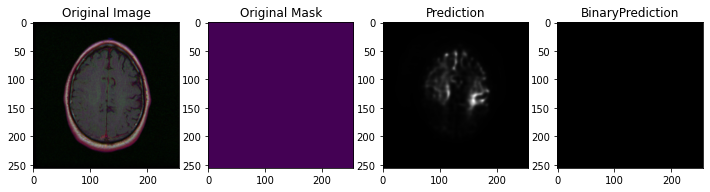

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


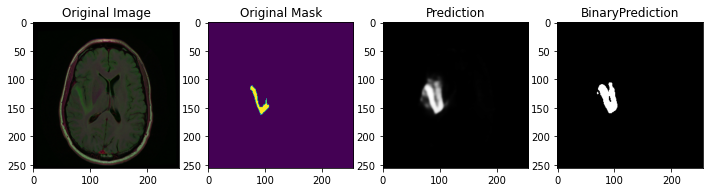

Pred Shape : (256, 256)
1492.0
408 15 64452 661
confusion matrix: [[64452   661]
 [   15   408]]


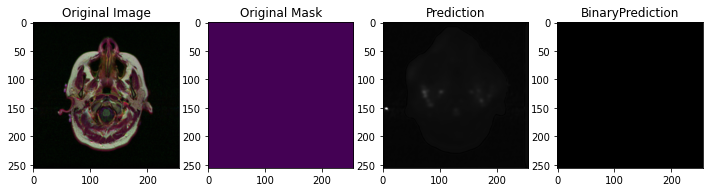

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


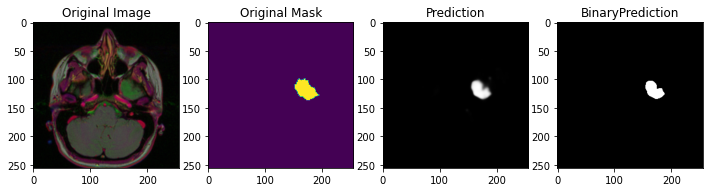

Pred Shape : (256, 256)
1648.0
686 275 64574 1
confusion matrix: [[64574     1]
 [  275   686]]


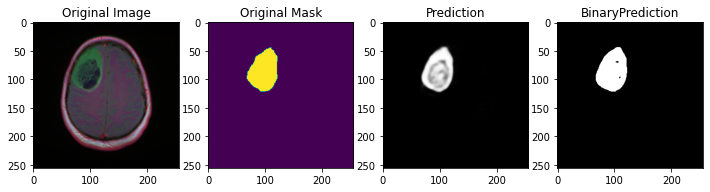

Pred Shape : (256, 256)
6061.0
2904 44 62379 209
confusion matrix: [[62379   209]
 [   44  2904]]


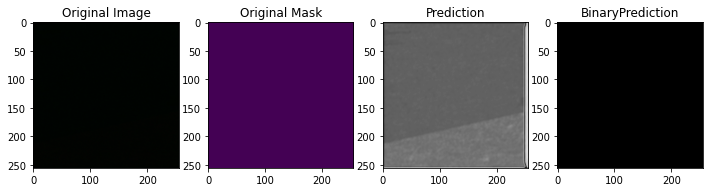

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


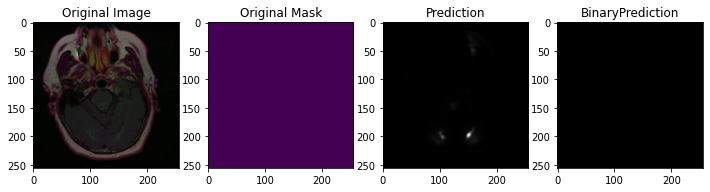

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


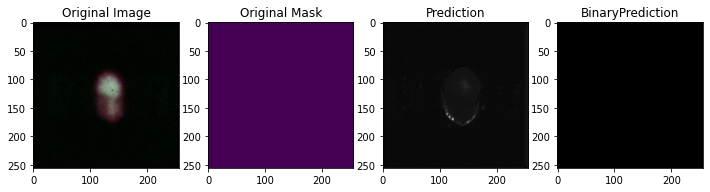

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


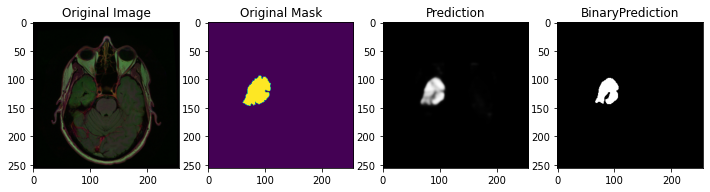

Pred Shape : (256, 256)
2907.0
1207 448 63836 45
confusion matrix: [[63836    45]
 [  448  1207]]


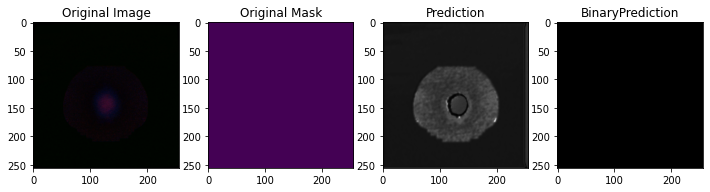

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


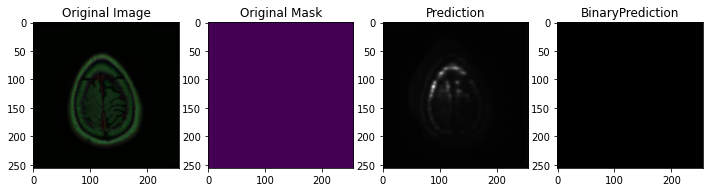

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


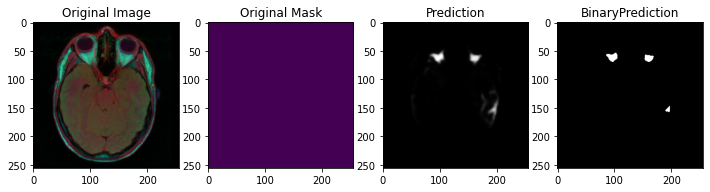

Pred Shape : (256, 256)
406.0
0 0 65130 406
confusion matrix: [[65130   406]
 [    0     0]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:78: RuntimeWarning: invalid value encountered in long_scalars


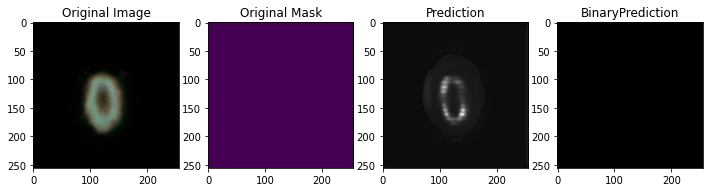

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


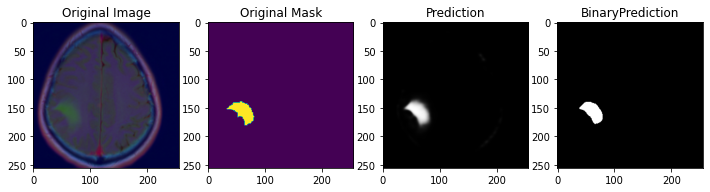

Pred Shape : (256, 256)
1875.0
871 110 64532 23
confusion matrix: [[64532    23]
 [  110   871]]


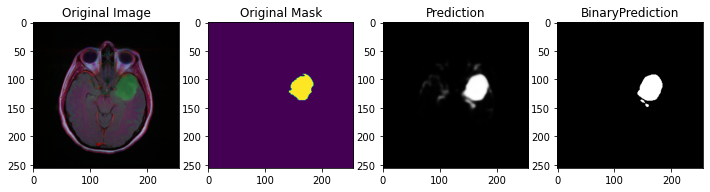

Pred Shape : (256, 256)
2851.0
1301 19 63986 230
confusion matrix: [[63986   230]
 [   19  1301]]


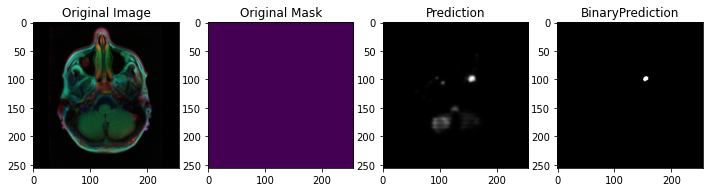

Pred Shape : (256, 256)
59.0
0 0 65477 59
confusion matrix: [[65477    59]
 [    0     0]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:78: RuntimeWarning: invalid value encountered in long_scalars


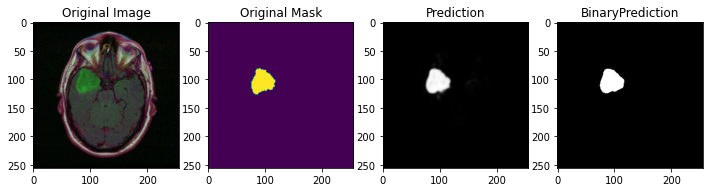

Pred Shape : (256, 256)
2629.0
1258 45 64165 68
confusion matrix: [[64165    68]
 [   45  1258]]


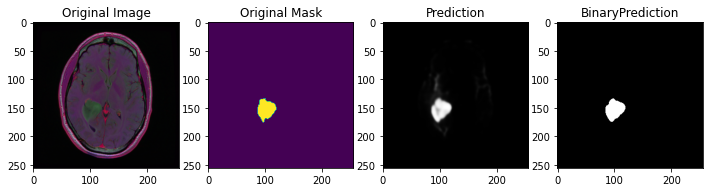

Pred Shape : (256, 256)
1827.0
853 43 64562 78
confusion matrix: [[64562    78]
 [   43   853]]


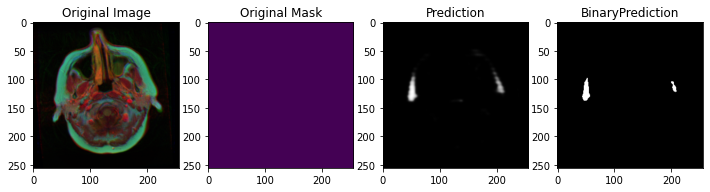

Pred Shape : (256, 256)
424.0
0 0 65112 424
confusion matrix: [[65112   424]
 [    0     0]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:78: RuntimeWarning: invalid value encountered in long_scalars


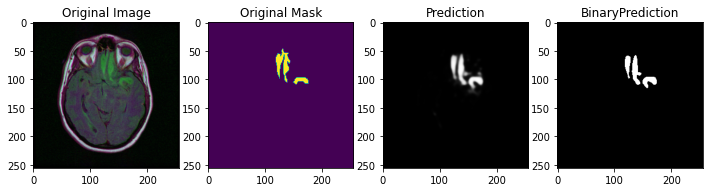

Pred Shape : (256, 256)
1924.0
722 177 64334 303
confusion matrix: [[64334   303]
 [  177   722]]


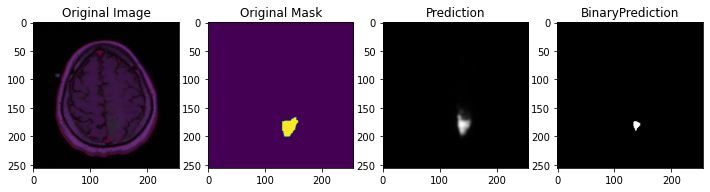

Pred Shape : (256, 256)
753.0
130 493 64913 0
confusion matrix: [[64913     0]
 [  493   130]]


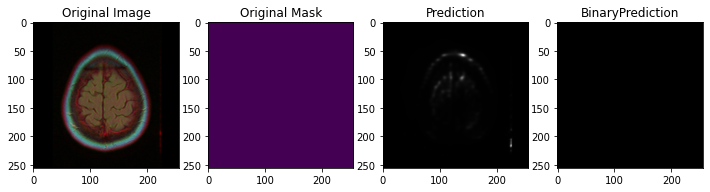

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


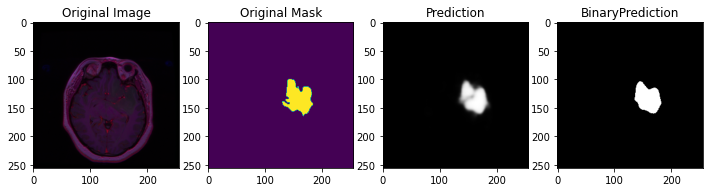

Pred Shape : (256, 256)
3797.0
1703 314 63442 77
confusion matrix: [[63442    77]
 [  314  1703]]


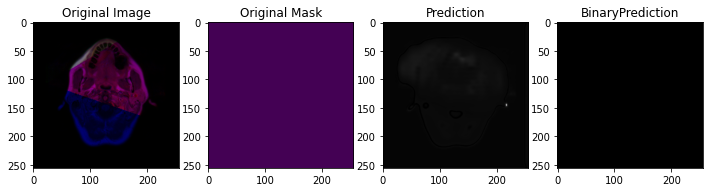

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


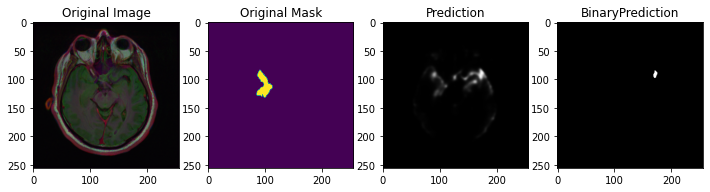

Pred Shape : (256, 256)
722.0
0 660 64814 62
confusion matrix: [[64814    62]
 [  660     0]]


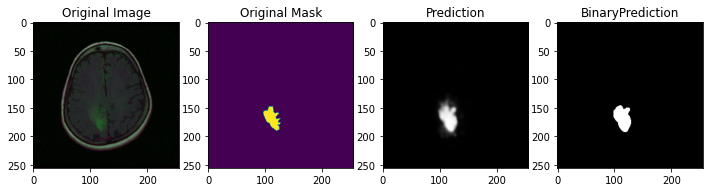

Pred Shape : (256, 256)
1705.0
673 24 64504 335
confusion matrix: [[64504   335]
 [   24   673]]


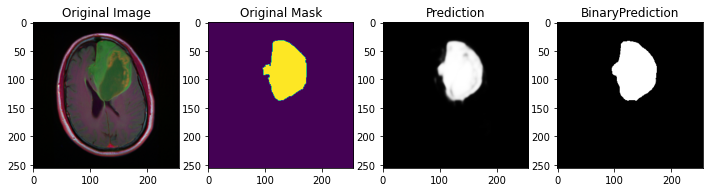

Pred Shape : (256, 256)
11418.0
5486 94 59604 352
confusion matrix: [[59604   352]
 [   94  5486]]


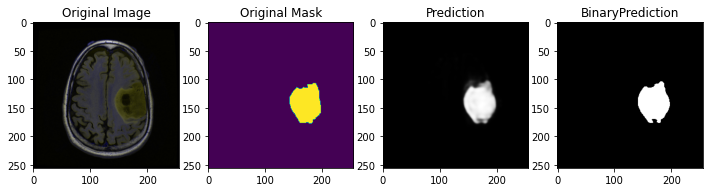

Pred Shape : (256, 256)
5802.0
2697 216 62431 192
confusion matrix: [[62431   192]
 [  216  2697]]


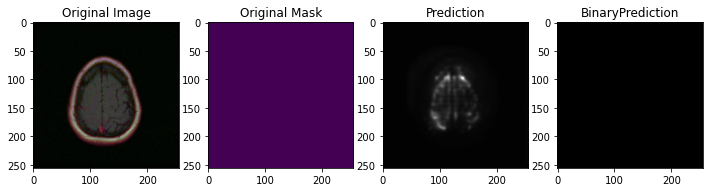

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


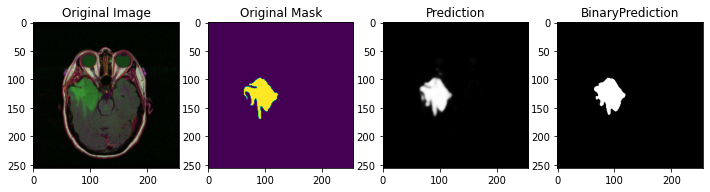

Pred Shape : (256, 256)
4012.0
1830 152 63354 200
confusion matrix: [[63354   200]
 [  152  1830]]


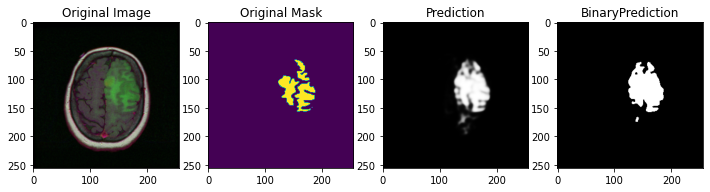

Pred Shape : (256, 256)
5952.0
2237 111 61821 1367
confusion matrix: [[61821  1367]
 [  111  2237]]


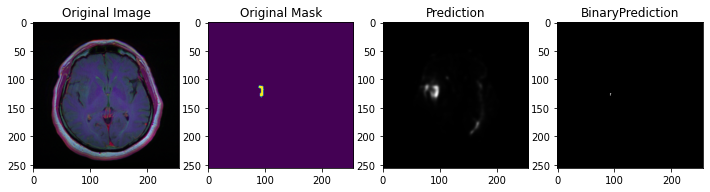

Pred Shape : (256, 256)
109.0
5 99 65432 0
confusion matrix: [[65432     0]
 [   99     5]]


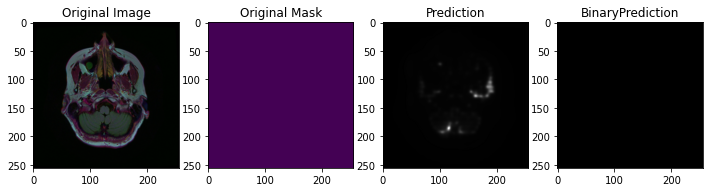

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


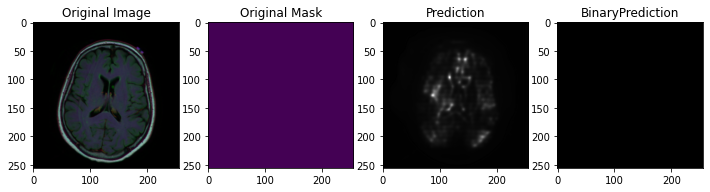

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


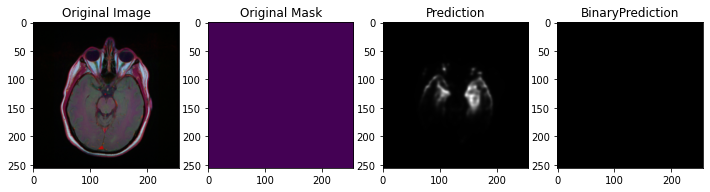

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


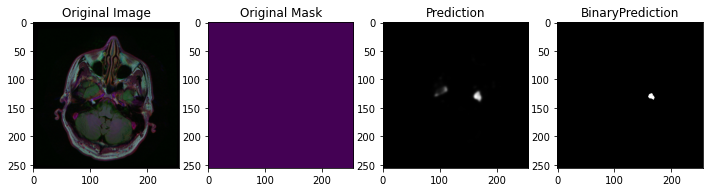

Pred Shape : (256, 256)
79.0
0 0 65457 79
confusion matrix: [[65457    79]
 [    0     0]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:78: RuntimeWarning: invalid value encountered in long_scalars


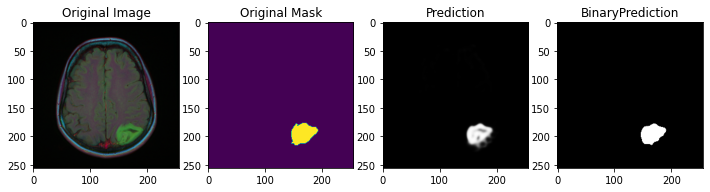

Pred Shape : (256, 256)
2399.0
1115 154 64252 15
confusion matrix: [[64252    15]
 [  154  1115]]


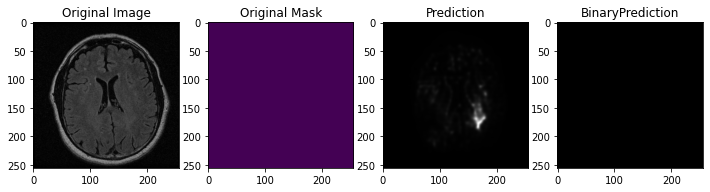

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


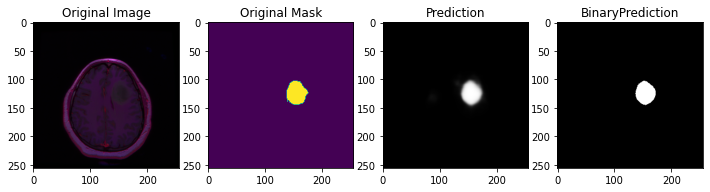

Pred Shape : (256, 256)
2277.0
1090 85 64349 12
confusion matrix: [[64349    12]
 [   85  1090]]


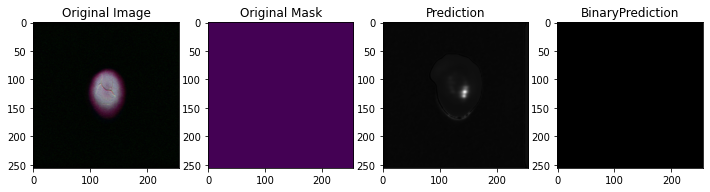

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


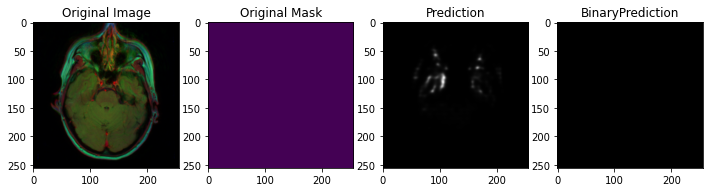

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


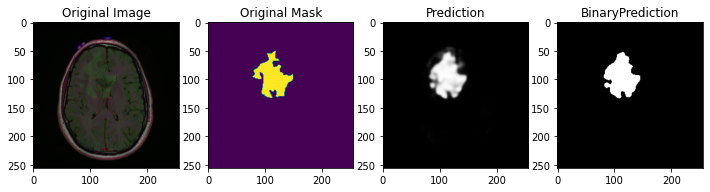

Pred Shape : (256, 256)
5803.0
2566 149 62299 522
confusion matrix: [[62299   522]
 [  149  2566]]


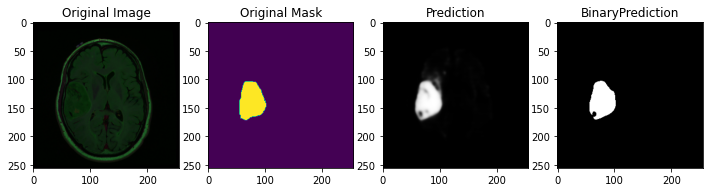

Pred Shape : (256, 256)
4652.0
2108 297 62992 139
confusion matrix: [[62992   139]
 [  297  2108]]


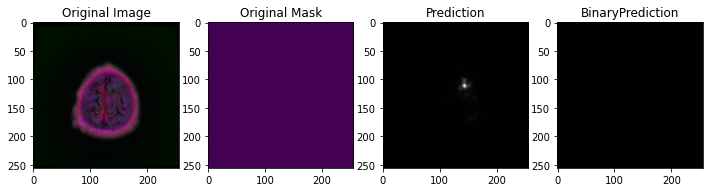

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


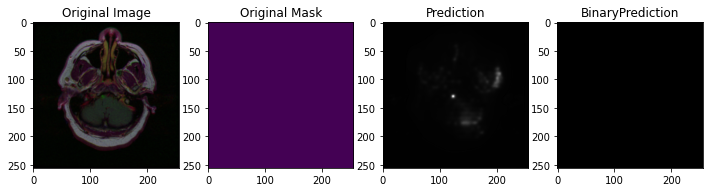

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


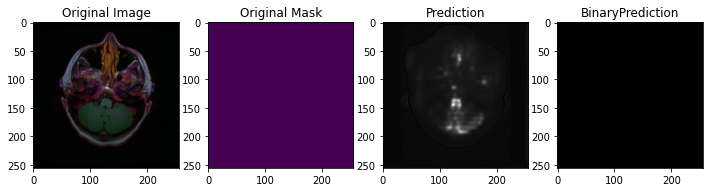

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


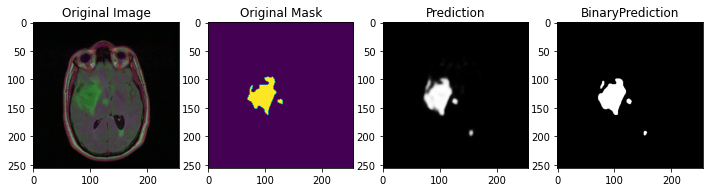

Pred Shape : (256, 256)
3794.0
1664 144 63406 322
confusion matrix: [[63406   322]
 [  144  1664]]


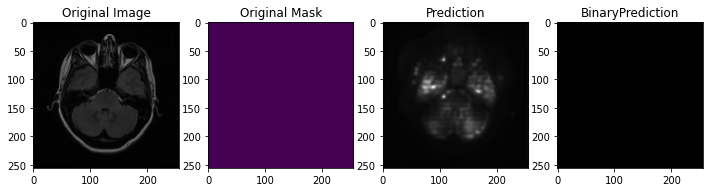

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


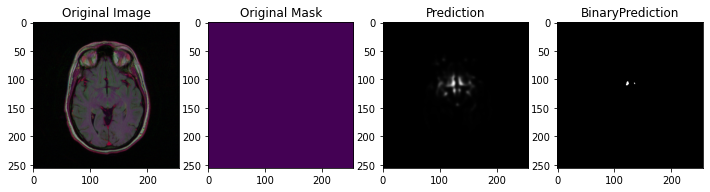

Pred Shape : (256, 256)
29.0
0 0 65507 29
confusion matrix: [[65507    29]
 [    0     0]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:78: RuntimeWarning: invalid value encountered in long_scalars


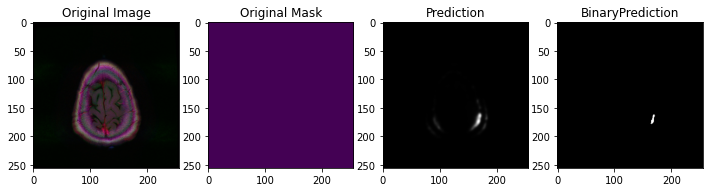

Pred Shape : (256, 256)
59.0
0 0 65477 59
confusion matrix: [[65477    59]
 [    0     0]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:78: RuntimeWarning: invalid value encountered in long_scalars


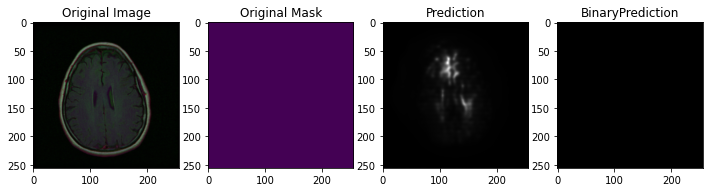

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


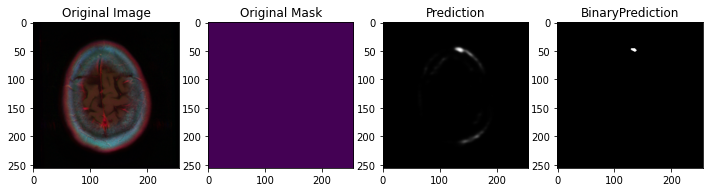

Pred Shape : (256, 256)
43.0
0 0 65493 43
confusion matrix: [[65493    43]
 [    0     0]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:78: RuntimeWarning: invalid value encountered in long_scalars


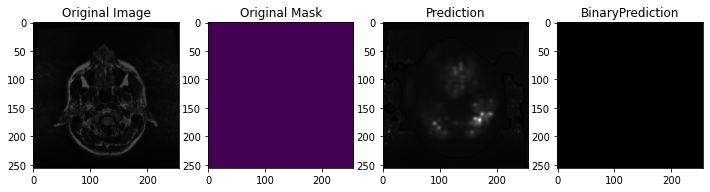

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


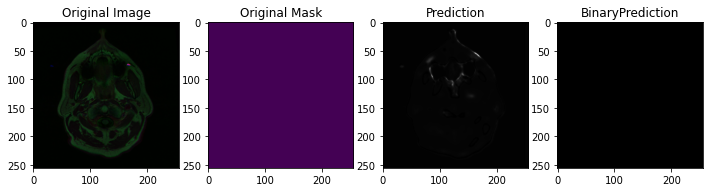

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


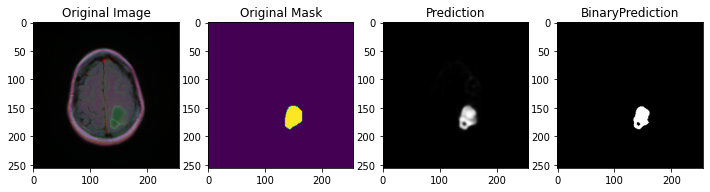

Pred Shape : (256, 256)
1737.0
774 171 64573 18
confusion matrix: [[64573    18]
 [  171   774]]


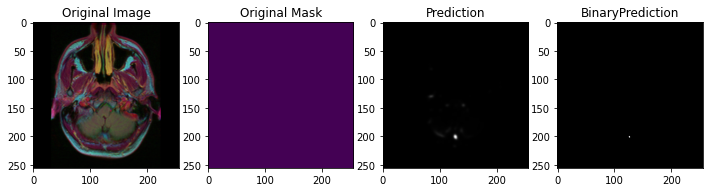

Pred Shape : (256, 256)
5.0
0 0 65531 5
confusion matrix: [[65531     5]
 [    0     0]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:78: RuntimeWarning: invalid value encountered in long_scalars


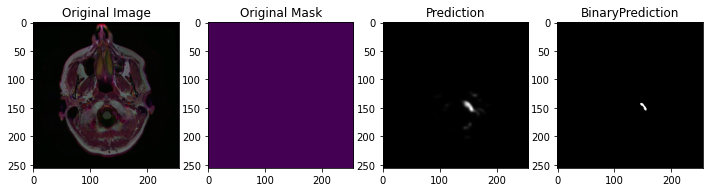

Pred Shape : (256, 256)
58.0
0 0 65478 58
confusion matrix: [[65478    58]
 [    0     0]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:78: RuntimeWarning: invalid value encountered in long_scalars


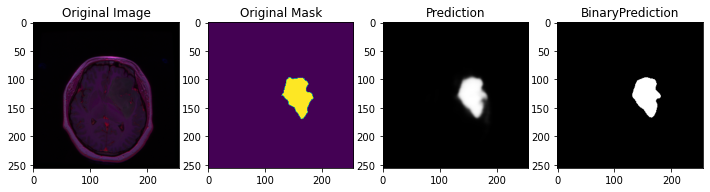

Pred Shape : (256, 256)
4622.0
2171 186 63085 94
confusion matrix: [[63085    94]
 [  186  2171]]


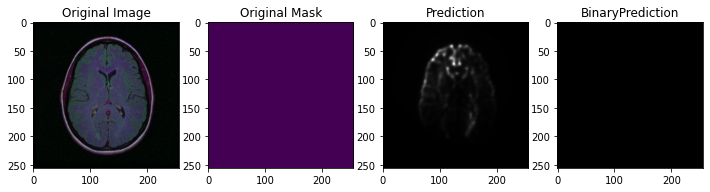

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


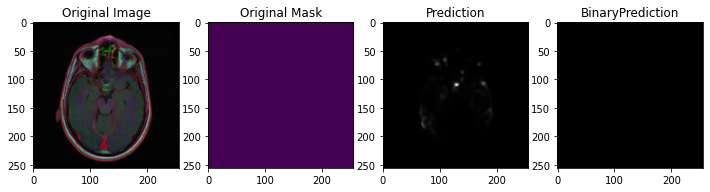

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


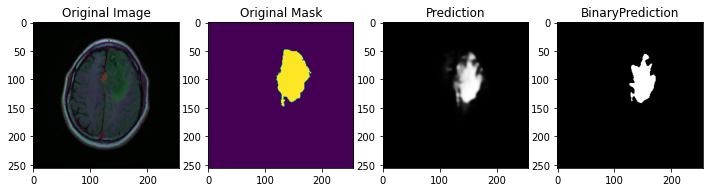

Pred Shape : (256, 256)
6016.0
2222 1504 61742 68
confusion matrix: [[61742    68]
 [ 1504  2222]]


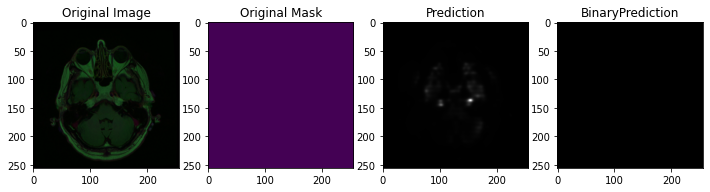

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


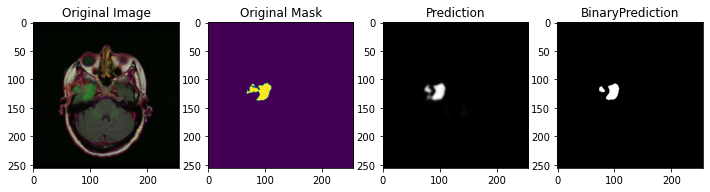

Pred Shape : (256, 256)
1202.0
500 182 64834 20
confusion matrix: [[64834    20]
 [  182   500]]


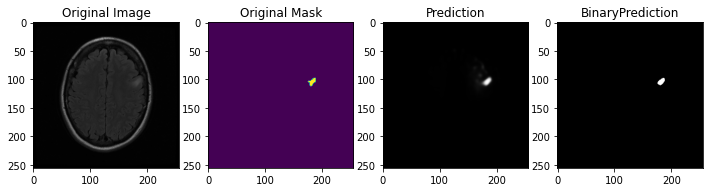

Pred Shape : (256, 256)
213.0
93 16 65416 11
confusion matrix: [[65416    11]
 [   16    93]]


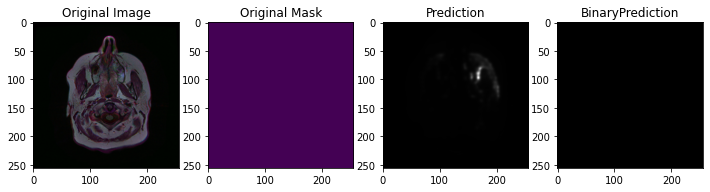

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


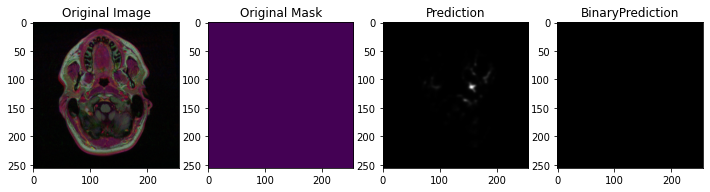

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


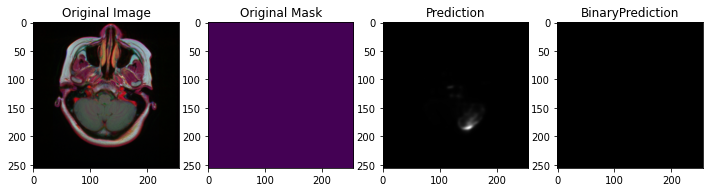

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


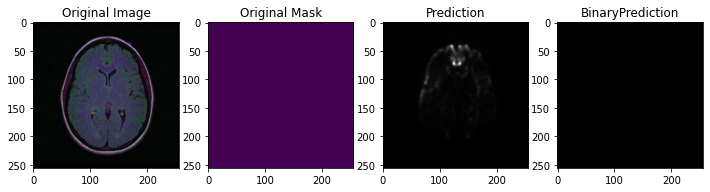

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


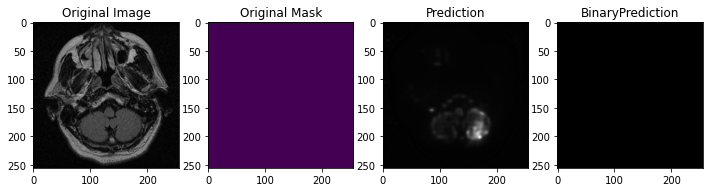

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


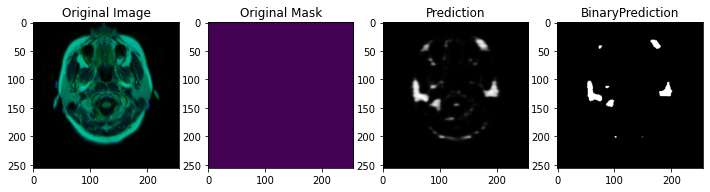

Pred Shape : (256, 256)
1136.0
0 0 64400 1136
confusion matrix: [[64400  1136]
 [    0     0]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:78: RuntimeWarning: invalid value encountered in long_scalars


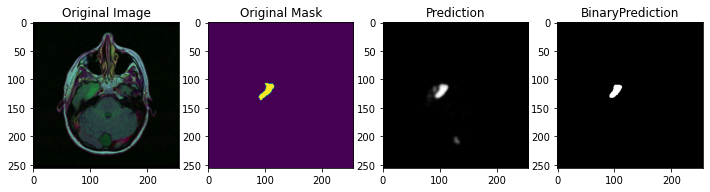

Pred Shape : (256, 256)
654.0
265 94 65147 30
confusion matrix: [[65147    30]
 [   94   265]]


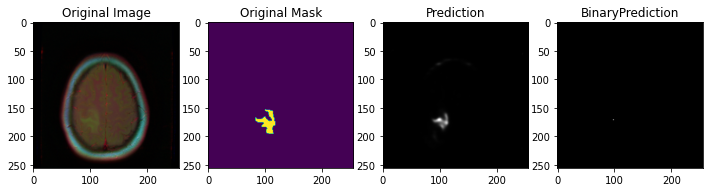

Pred Shape : (256, 256)
639.0
2 635 64899 0
confusion matrix: [[64899     0]
 [  635     2]]


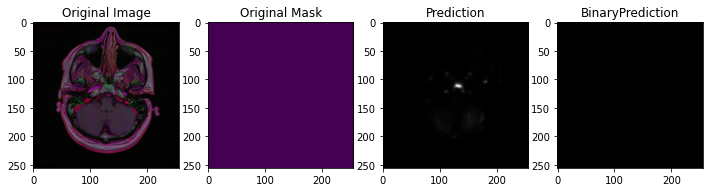

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


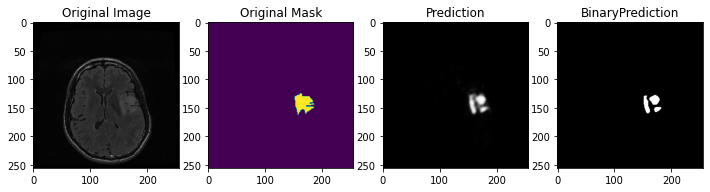

Pred Shape : (256, 256)
1294.0
475 303 64717 41
confusion matrix: [[64717    41]
 [  303   475]]


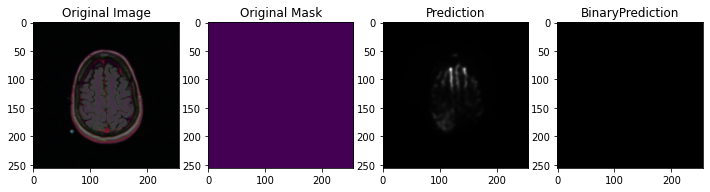

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


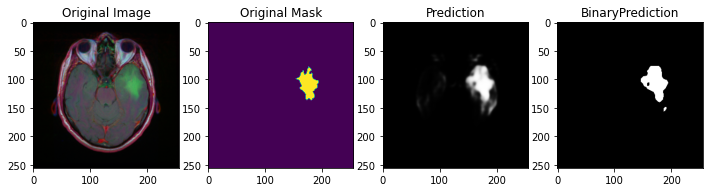

Pred Shape : (256, 256)
2816.0
1122 15 63842 557
confusion matrix: [[63842   557]
 [   15  1122]]


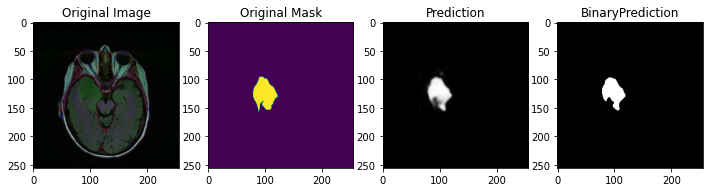

Pred Shape : (256, 256)
2999.0
1323 311 63860 42
confusion matrix: [[63860    42]
 [  311  1323]]


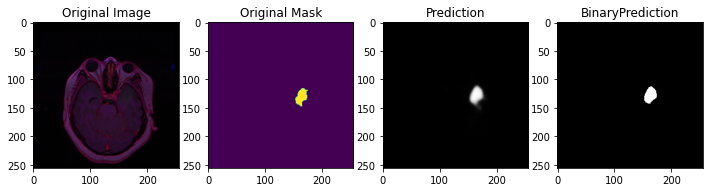

Pred Shape : (256, 256)
897.0
379 52 65018 87
confusion matrix: [[65018    87]
 [   52   379]]


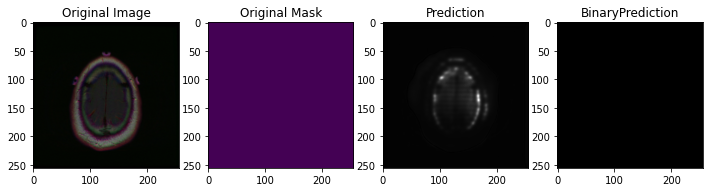

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


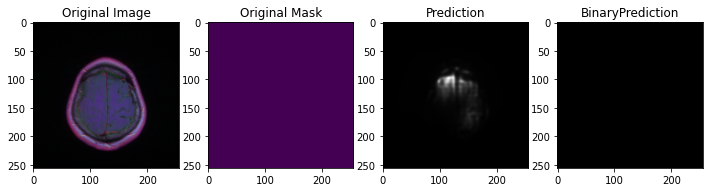

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


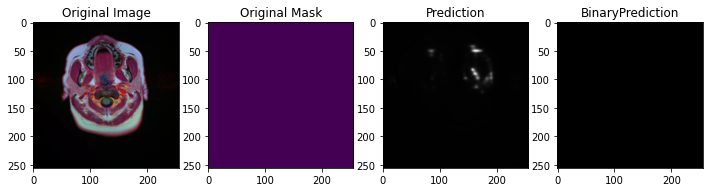

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


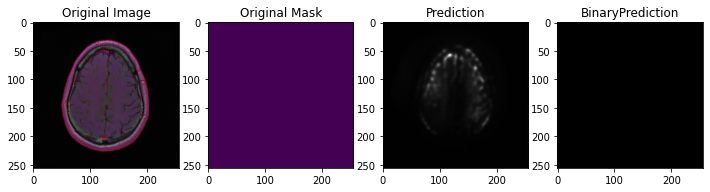

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


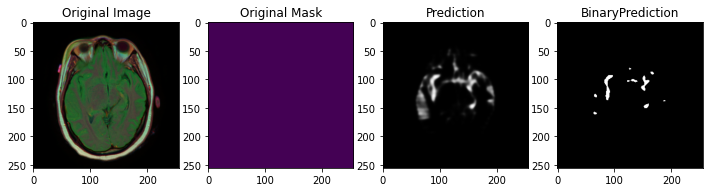

Pred Shape : (256, 256)
594.0
0 0 64942 594
confusion matrix: [[64942   594]
 [    0     0]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:78: RuntimeWarning: invalid value encountered in long_scalars


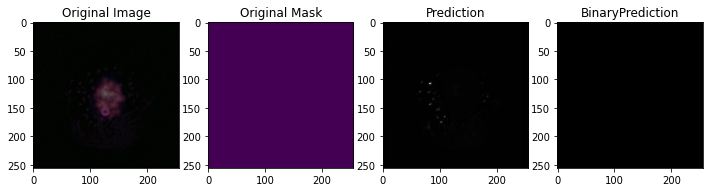

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


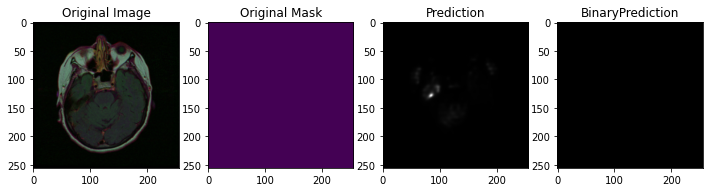

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


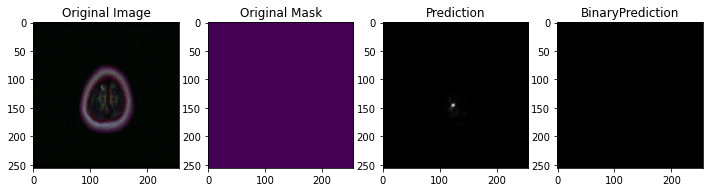

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


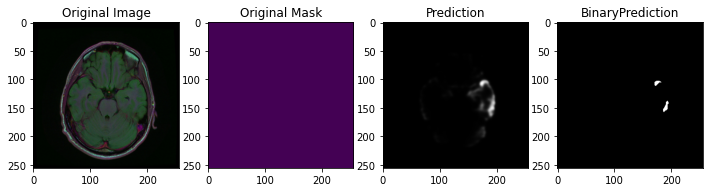

Pred Shape : (256, 256)
151.0
0 0 65385 151
confusion matrix: [[65385   151]
 [    0     0]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:78: RuntimeWarning: invalid value encountered in long_scalars


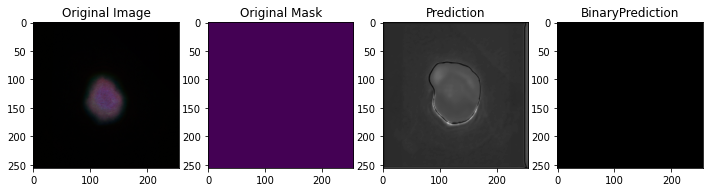

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


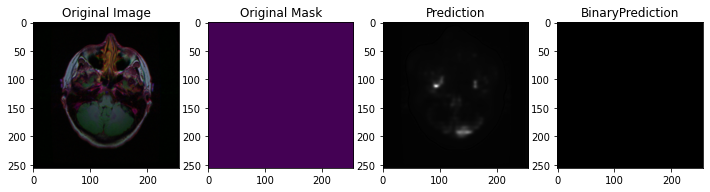

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


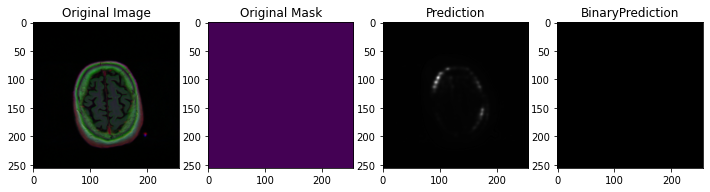

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


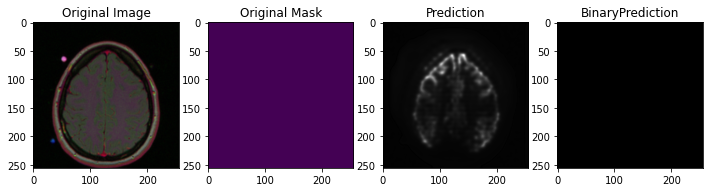

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


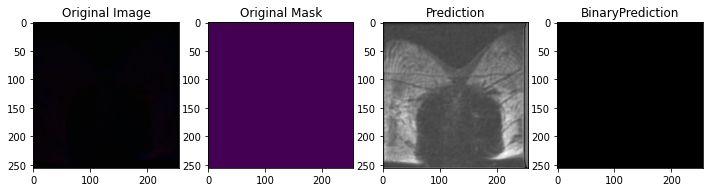

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


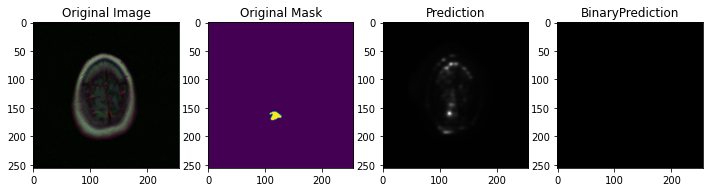

Pred Shape : (256, 256)
196.0
0 196 65340 0
confusion matrix: [[65340     0]
 [  196     0]]


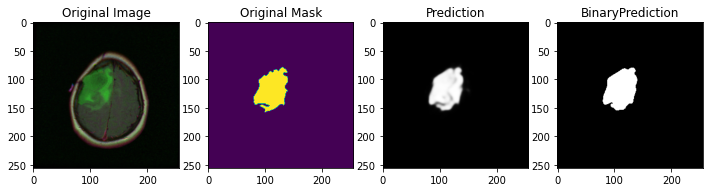

Pred Shape : (256, 256)
6312.0
2989 90 62213 244
confusion matrix: [[62213   244]
 [   90  2989]]


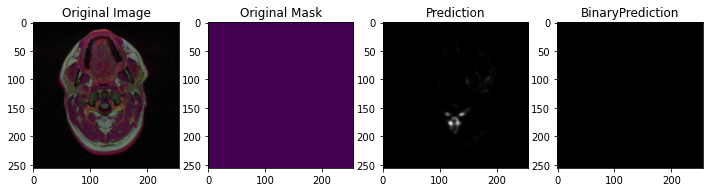

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


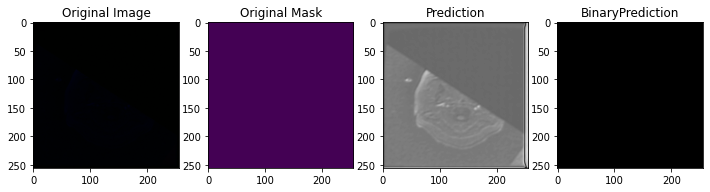

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


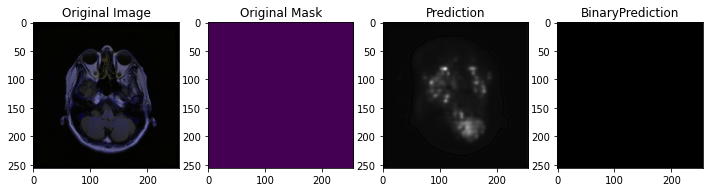

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


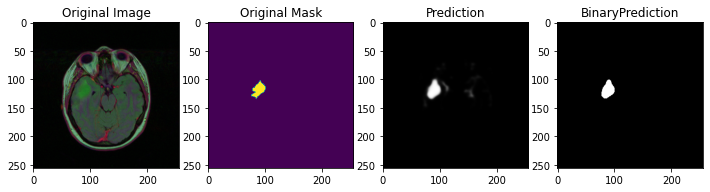

Pred Shape : (256, 256)
920.0
389 21 65005 121
confusion matrix: [[65005   121]
 [   21   389]]


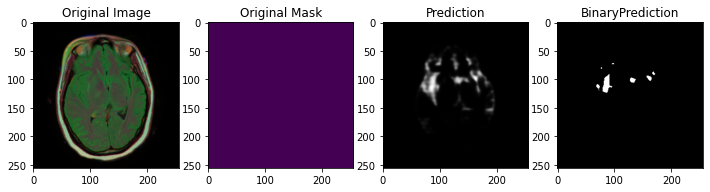

Pred Shape : (256, 256)
480.0
0 0 65056 480
confusion matrix: [[65056   480]
 [    0     0]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:78: RuntimeWarning: invalid value encountered in long_scalars


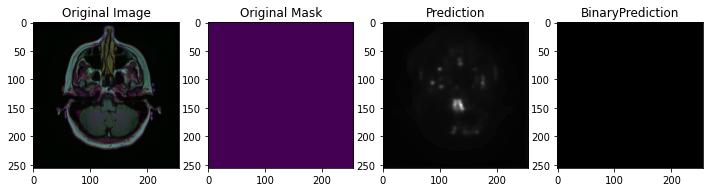

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


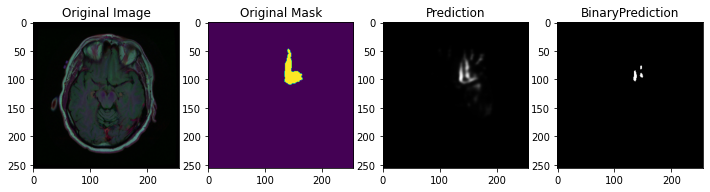

Pred Shape : (256, 256)
1068.0
112 826 64580 18
confusion matrix: [[64580    18]
 [  826   112]]


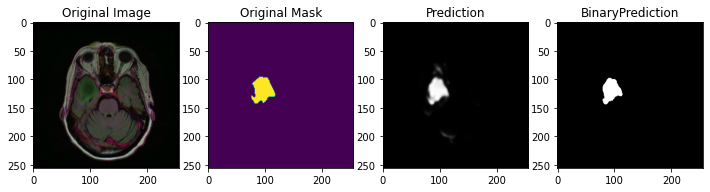

Pred Shape : (256, 256)
2324.0
1003 285 64215 33
confusion matrix: [[64215    33]
 [  285  1003]]


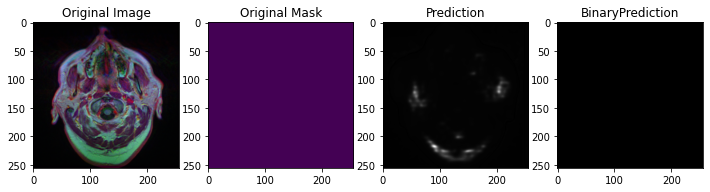

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


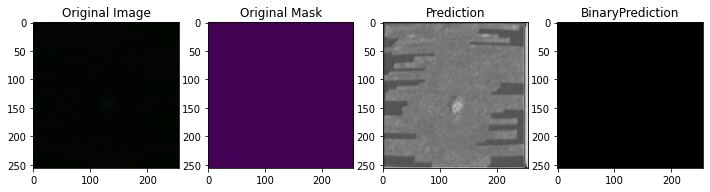

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


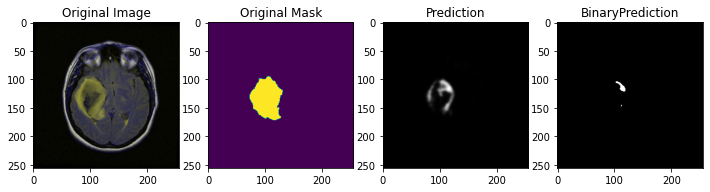

Pred Shape : (256, 256)
3157.0
125 2907 62504 0
confusion matrix: [[62504     0]
 [ 2907   125]]


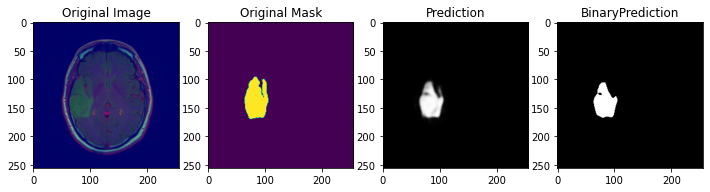

Pred Shape : (256, 256)
4002.0
1691 619 63225 1
confusion matrix: [[63225     1]
 [  619  1691]]


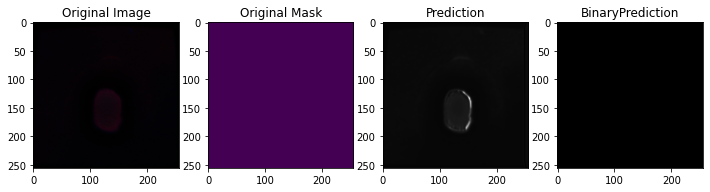

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


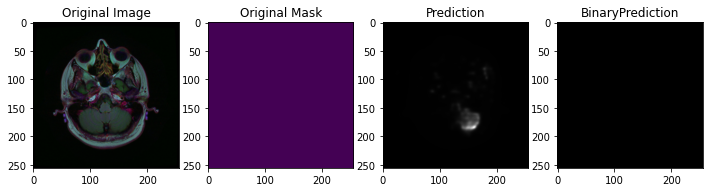

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


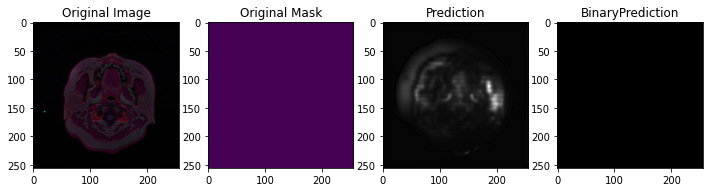

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


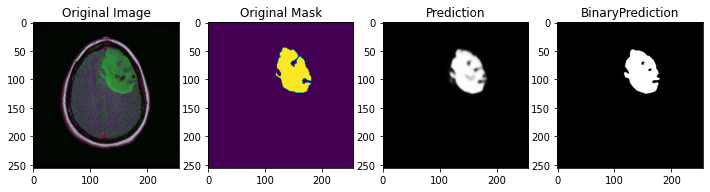

Pred Shape : (256, 256)
6422.0
2994 155 62108 279
confusion matrix: [[62108   279]
 [  155  2994]]


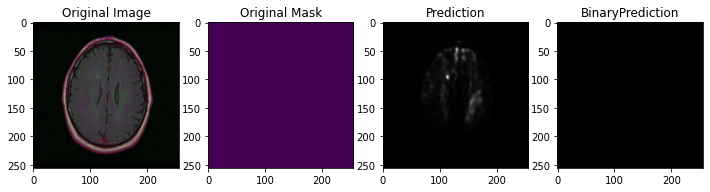

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


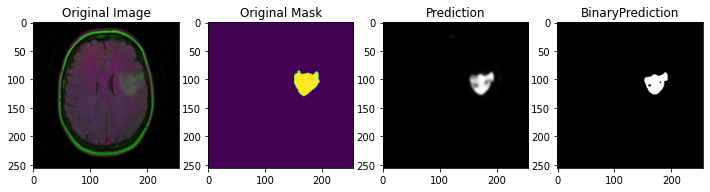

Pred Shape : (256, 256)
2363.0
989 380 64162 5
confusion matrix: [[64162     5]
 [  380   989]]


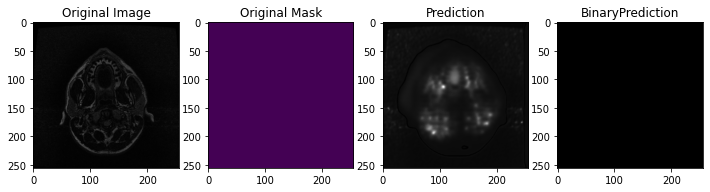

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


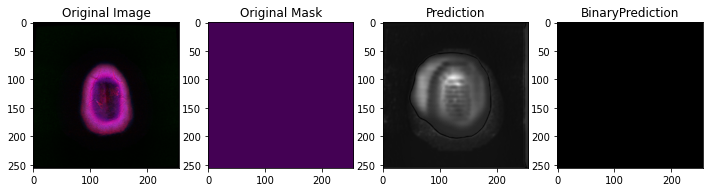

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


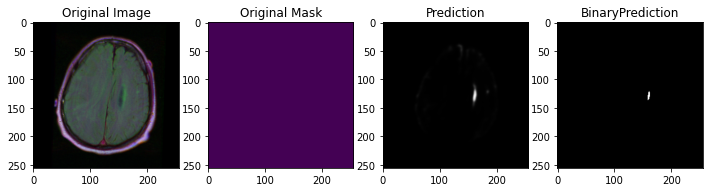

Pred Shape : (256, 256)
44.0
0 0 65492 44
confusion matrix: [[65492    44]
 [    0     0]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:78: RuntimeWarning: invalid value encountered in long_scalars


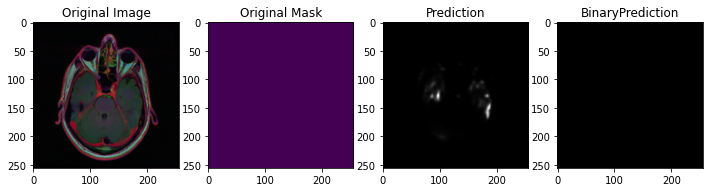

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


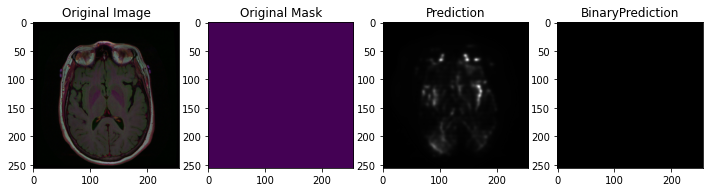

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


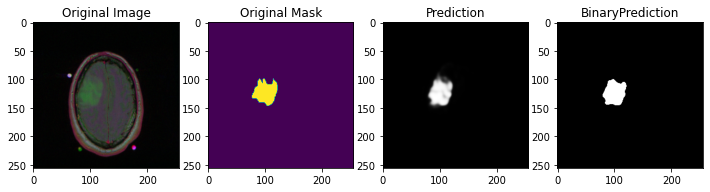

Pred Shape : (256, 256)
2812.0
1276 137 64000 123
confusion matrix: [[64000   123]
 [  137  1276]]


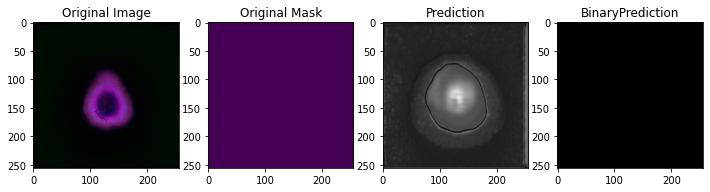

Pred Shape : (256, 256)
0.0
confusion matrix: [[65536]]


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


In [34]:
#     print("Mask Values:", mask )
#     0-1
#     print("Pred Values:", pred )
#    probabilities
Iou = np.array([], dtype=np.float64)
Dice = np.array([], dtype=np.float64)
index = np.array([], dtype=np.int)
accuracy = np.array([], dtype=np.int)
precision = np.array([], dtype=np.int)
Sens=np.array([], dtype=np.float64)
Spec=np.array([], dtype=np.float64)
# Dice2=np.array([], dtype=np.float64)

for i in range(800):
    
    idx = random.randint(0,len(imagePath_df['directory']))
    index=np.append(index,idx)
    imagePath = os.path.join(DataPath, imagePath_df['directory'].iloc[idx], imagePath_df['images'].iloc[idx])
    maskPath = os.path.join(DataPath, imagePath_df['directory'].iloc[idx], imagePath_df['masks'].iloc[idx])
    

    
    image = cv2.imread(imagePath)
    mask = cv2.imread(maskPath)
    img = cv2.resize(image,(ImgHeight,ImgWidth))
    img = img/255
    img = img[np.newaxis,:,:,:]
#     print("Image Shape :",img.shape )
    
    """The first dimension is the batch size. If you are feeding 1 image at a time you can simply make the first dimension 1 and 
    it doesn't change your data any, just changes the indexing to 4"""
    pred = model.predict(img)
    
#     pred = np.asarray(pred)
    bpred = np.array(np.squeeze(pred) > 0.5,dtype = np.uint8)
    
#     Visualize images

    mask = np.asarray(mask) #(1,256, 256, 3)
    mask = np.squeeze(np.squeeze(mask))#(256, 256, 3)\
    mask = cv2.cvtColor(mask, cv2.COLOR_BGR2GRAY)
    mask=mask/255
    
    pred = np.squeeze(pred)
    bpred = np.asarray(bpred) #(256, 256)
    #Make a binary prediction     
    pred = cv2.normalize(pred, None, alpha = 0, beta = 255, norm_type = cv2.NORM_MINMAX, dtype = cv2.CV_32F)    
    #     pred = cv2.cvtColor(pred, cv2.COLOR_BGR2GRAY)
    
    plots()

    iou,dice = intersection_mats(mask, bpred)
    
    Iou = np.append(Iou, iou)
    Dice = np.append(Dice,dice)

    
    a =  confusion_matrs(mask,bpred)
    
    if np.size(a)==1:
        
        accu=0;
        pre=0;
        sens=0;
        spec=1;

    else:


        TN = a[0][0];
        FN = a[1][0];
        TP = a[1][1];
        FP = a[0][1];


        pre = (TP)/(TP+FP+0.001)
        accu = (TP+TN)/(TN+TP+FP+FN+0.001)
        sens = (TP)/(TP+FN)
        spec = (TN)/(TN+FP)

        accu =round(accu,2)
        pre = round(pre,2)
        sens = round(sens,2)
        spec = round(spec,2)
        print(TP,FN,TN,FP)
    
    
    accuracy = np.append(accuracy,accu)
    precision = np.append(precision,pre)
    Spec = np.append(Spec,spec)
    Sens = np.append(Sens,sens)


    print("confusion matrix:",a)

#     Dice2 = np.append(Dice2,dice2)
#     prints()

## Boxplots

In [35]:
df = pd.DataFrame({'Jacard':Iou, 'Dice_Coef':Dice, 'Accuracy':accuracy,'Precision':precision, 'Specificity':Spec,'Sensitivity':Sens})
# 
# 'Dice_Coef_2':Dice2,
df = df.dropna()
indice = df[(df['Jacard']==0)].index
df.drop(indice, inplace=True)

print("Jacard Mean: {m}. Jacard STD: {s}.".format(m = round(df['Jacard'].mean(),2) ,s = round(df['Jacard'].std(),2)))
print("Dice_Coef Mean: {m}. Dice_Coef STD: {s}.".format(m = round(df['Dice_Coef'].mean(),2),s = round(df['Dice_Coef'].std(),2)))
print("Accuracy Mean: {m}. Accuracy STD: {s}.".format(m = round(df['Accuracy'].mean(),2),s = round(df['Accuracy'].std(),2)))
print("Precision Mean: {m}. Precision STD: {s}.".format(m = round(df['Precision'].mean(),2),s = round(df['Precision'].std(),2)))
print("Specificity: {m}. Specificity STD: {s}.".format(m = round(df['Specificity'].mean(),2),s = round(df['Specificity'].std(),2)))
print("Sensitivity: {m}. Sensitivity STD: {s}.".format(m = round(df['Sensitivity'].mean(),2),s = round(df['Sensitivity'].std(),2)))


# sthlh (1-MASKA) / (0-OXI MASKA) +++ PLHROFORIA APO DATA.CSV +++
# df.to_csv("metric-results_v2.csv",index=False)
df

Jacard Mean: 0.68. Jacard STD: 0.22.
Dice_Coef Mean: 0.78. Dice_Coef STD: 0.2.
Accuracy Mean: 0.99. Accuracy STD: 0.01.
Precision Mean: 0.87. Precision STD: 0.16.
Specificity: 1.0. Specificity STD: 0.01.
Sensitivity: 0.79. Sensitivity STD: 0.24.


,Jacard,Dice_Coef,Accuracy,Precision,Specificity,Sensitivity
1,0.14,0.24,0.99,0.99,1.00,0.14
3,0.66,0.79,1.00,0.89,1.00,0.71
4,0.92,0.96,1.00,0.97,1.00,0.95
5,0.65,0.79,0.99,0.67,0.99,0.97
9,0.93,0.96,1.00,0.97,1.00,0.95
...,...,...,...,...,...,...
785,0.04,0.08,0.96,1.00,1.00,0.04
786,0.73,0.85,0.99,1.00,1.00,0.73
790,0.87,0.93,0.99,0.91,1.00,0.95
792,0.72,0.84,0.99,0.99,1.00,0.72


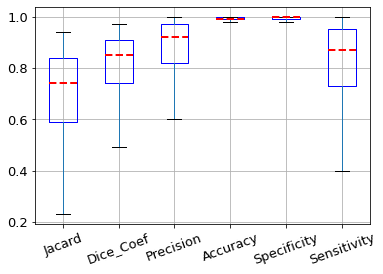

In [36]:
# Plot boxplot
boxprops = dict(linestyle='-', color='blue')
medianprops = dict(linestyle= '--',linewidth='2', color='r')
fig,ax  = plt.subplots()

boxplot = df.boxplot(column=['Jacard','Dice_Coef','Precision', 'Accuracy','Specificity','Sensitivity'],rot=20, fontsize=13,
                    medianprops=medianprops, boxprops=boxprops,showfliers=False, showmeans=False)
plt.show()
